<a href="https://colab.research.google.com/github/mokakrishna21/Stock-Prediction/blob/main/StockPrediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Importing all the required libaries

In [ ]:
from datetime import datetime
import os
import plotly.graph_objects as go
import plotly.express as ex
import plotly.figure_factory as ff
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.neighbors import LocalOutlierFactor
import webbrowser
import seaborn as sns
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error
from plotly.subplots import make_subplots
import plotly.express as px

In [ ]:
!pip install nbformat

In [ ]:
import tensorflow as tf
import tensorflow

from tensorflow import keras
from keras.layers import Dense

In [ ]:
import tensorflow as tf
tf.__version__

!sudo pip3 install keras

from tensorflow.python.keras.engine.sequential import Sequential

from tensorflow.python.keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D



In [ ]:
!pip install -q kaggle

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"mokakris","key":"b202fda5d6fba5fdceabdd92245406e1"}'}

In [ ]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d rohanrao/nifty50-stock-market-data

 92% 17.0M/18.4M [00:00<00:00, 50.0MB/s]
100% 18.4M/18.4M [00:00<00:00, 48.6MB/s]


In [ ]:
!unzip nifty50-stock-market-data

Archive:  nifty50-stock-market-data.zip
  inflating: ADANIPORTS.csv          
  inflating: ASIANPAINT.csv          
  inflating: AXISBANK.csv            
  inflating: BAJAJ-AUTO.csv          
  inflating: BAJAJFINSV.csv          
  inflating: BAJFINANCE.csv          
  inflating: BHARTIARTL.csv          
  inflating: BPCL.csv                
  inflating: BRITANNIA.csv           
  inflating: CIPLA.csv               
  inflating: COALINDIA.csv           
  inflating: DRREDDY.csv             
  inflating: EICHERMOT.csv           
  inflating: GAIL.csv                
  inflating: GRASIM.csv              
  inflating: HCLTECH.csv             
  inflating: HDFC.csv                
  inflating: HDFCBANK.csv            
  inflating: HEROMOTOCO.csv          
  inflating: HINDALCO.csv            
  inflating: HINDUNILVR.csv          
  inflating: ICICIBANK.csv           
  inflating: INDUSINDBK.csv          
  inflating: INFRATEL.csv            
  inflating: INFY.csv                
  inflatin

In [ ]:
stonks_df = pd.read_csv('NIFTY50_all.csv')
stonks_df['Date'] = pd.to_datetime(stonks_df['Date'] )

In [ ]:
import numpy
print(numpy.__version__)

1.22.4


In [ ]:
stonks_df.dtypes

Date                  datetime64[ns]
Symbol                        object
Series                        object
Prev Close                   float64
Open                         float64
High                         float64
Low                          float64
Last                         float64
Close                        float64
VWAP                         float64
Volume                         int64
Turnover                     float64
Trades                       float64
Deliverable Volume           float64
%Deliverble                  float64
dtype: object

In [ ]:
stonks_df.set_index('Date',inplace=True)

In [ ]:
stonks_df.loc[stonks_df['Symbol'] == 'MUNDRAPORT','Symbol'] = 'ADANIPORTS'
stonks_df.loc[stonks_df['Symbol'] == 'BAJAUTOFIN','Symbol'] = 'BAJFINANCE'
stonks_df.loc[stonks_df['Symbol'] == 'HINDALC0','Symbol'] = 'HINDALCO'
stonks_df.loc[stonks_df['Symbol'] == 'KOTAKMAH','Symbol'] = 'KOTAKBANK'
stonks_df.loc[stonks_df['Symbol'] == 'UTIBANK','Symbol'] = 'AXISBANK'
stonks_df.loc[stonks_df['Symbol'] == 'ZEETELE','Symbol'] = 'ZEEL'
stonks_df.loc[stonks_df['Symbol'] == 'INFOSYSTCH','Symbol'] = 'INFY'
stonks_df.loc[stonks_df['Symbol'] == 'BHARTI','Symbol'] = 'BHARTIARTL'
stonks_df.loc[stonks_df['Symbol'] == 'SESAGOA','Symbol'] = 'VEDL'
stonks_df.loc[stonks_df['Symbol'] == 'HEROHONDA','Symbol'] = 'HEROMOTOCO'
stonks_df.loc[stonks_df['Symbol'] == 'TELCO','Symbol'] = 'TATAMOTORS'
stonks_df.loc[stonks_df['Symbol'] == 'TISCO','Symbol'] = 'TATASTEEL'
stonks_df.loc[stonks_df['Symbol'] == 'HINDLEVER','Symbol'] = 'HINDUNILVR'
stonks_df.loc[stonks_df['Symbol'] == 'JSWSTL','Symbol'] = 'JSWSTEEL'
stonks_df.loc[stonks_df['Symbol'] == 'SSLT','Symbol'] = 'VEDL'

In [ ]:
stonks_df.head()

,Symbol,Series,Prev Close,Open,High,Low,Last,Close,VWAP,Volume,Turnover,Trades,Deliverable Volume,%Deliverble
Date,,,,,,,,,,,,,,
2007-11-27,ADANIPORTS,EQ,440.00,770.00,1050.00,770.0,959.0,962.90,984.72,27294366,2.687719e+15,NaN,9859619.0,0.3612
2007-11-28,ADANIPORTS,EQ,962.90,984.00,990.00,874.0,885.0,893.90,941.38,4581338,4.312765e+14,NaN,1453278.0,0.3172
2007-11-29,ADANIPORTS,EQ,893.90,909.00,914.75,841.0,887.0,884.20,888.09,5124121,4.550658e+14,NaN,1069678.0,0.2088
2007-11-30,ADANIPORTS,EQ,884.20,890.00,958.00,890.0,929.0,921.55,929.17,4609762,4.283257e+14,NaN,1260913.0,0.2735
2007-12-03,ADANIPORTS,EQ,921.55,939.75,995.00,922.0,980.0,969.30,965.65,2977470,2.875200e+14,NaN,816123.0,0.2741


In [ ]:
#No. of companines in the dataset

In [ ]:
len(stonks_df['Symbol'].unique())

50

In [ ]:
Stonks_df1 = pd.DataFrame()
for name in stonks_df['Symbol'].unique():
    Stonks_df1.loc[:,name] = stonks_df[stonks_df['Symbol'] == name]['Close']

In [ ]:
Stonks_df1.head()

,ADANIPORTS,ASIANPAINT,AXISBANK,BAJAJ-AUTO,BAJAJFINSV,BAJFINANCE,BHARTIARTL,BPCL,BRITANNIA,CIPLA,...,TATASTEEL,TCS,TECHM,TITAN,ULTRACEMCO,UNIPHOS,UPL,VEDL,WIPRO,ZEEL
Date,,,,,,,,,,,,,,,,,,,,,
2007-11-27,962.90,998.15,932.10,NaN,NaN,317.30,915.85,406.90,1516.45,183.60,...,848.90,995.95,1040.00,1530.50,1000.65,337.10,NaN,3386.95,457.80,299.60
2007-11-28,893.90,1006.45,905.70,NaN,NaN,321.55,910.05,384.50,1482.90,182.85,...,816.60,976.50,1035.45,1471.35,989.10,334.80,NaN,3332.45,449.75,292.75
2007-11-29,884.20,998.10,918.85,NaN,NaN,322.75,914.75,382.30,1493.35,182.00,...,798.25,966.05,986.15,1463.40,976.85,334.10,NaN,3260.70,448.10,281.25
2007-11-30,921.55,990.00,930.65,NaN,NaN,330.35,939.50,386.35,1492.35,183.10,...,825.90,1012.20,1026.70,1534.25,984.25,342.95,NaN,3450.70,460.65,287.90
2007-12-03,969.30,986.60,942.35,NaN,NaN,332.90,923.95,402.85,1468.10,185.25,...,842.20,1049.90,1058.15,1548.65,999.15,344.20,NaN,3500.65,492.10,303.80


In [ ]:
Stonks_df1.isnull().sum()

ADANIPORTS       0
ASIANPAINT       0
AXISBANK         0
BAJAJ-AUTO     120
BAJAJFINSV     121
BAJFINANCE       1
BHARTIARTL       0
BPCL             0
BRITANNIA        1
CIPLA            0
COALINDIA      724
DRREDDY          0
EICHERMOT        0
GAIL             0
GRASIM           0
HCLTECH          0
HDFC             0
HDFCBANK         0
HEROMOTOCO       0
HINDALCO         0
HINDUNILVR       0
ICICIBANK        0
INDUSINDBK       0
INFY             0
IOC              0
ITC              0
JSWSTEEL         0
KOTAKBANK        0
LT               0
M&M              0
MARUTI           0
NESTLEIND      516
NTPC             0
ONGC             0
POWERGRID        0
RELIANCE         0
SBIN             0
SHREECEM         0
SUNPHARMA        0
TATAMOTORS       0
TATASTEEL        0
TCS              0
TECHM            0
TITAN            0
ULTRACEMCO       0
UNIPHOS       1858
UPL           1464
VEDL             0
WIPRO            0
ZEEL             0
dtype: int64

In [ ]:
#Count missing values in each row and column

In [ ]:
Stonks_df1['BAJAJ-AUTO'] = Stonks_df1['BAJAJ-AUTO'].fillna(method='bfill')
Stonks_df1['BAJAJFINSV'] = Stonks_df1['BAJAJFINSV'].fillna(method='bfill')
Stonks_df1['COALINDIA'] = Stonks_df1['COALINDIA'].fillna(method='bfill')
Stonks_df1['NESTLEIND'] = Stonks_df1['NESTLEIND'].fillna(method='bfill')
Stonks_df1['UNIPHOS'] = Stonks_df1['UNIPHOS'].fillna(method='ffill')
Stonks_df1['UPL'] = Stonks_df1['UPL'].fillna(method='bfill')
Stonks_df1['BAJFINANCE'] = Stonks_df1['BAJFINANCE'].fillna(method='bfill')
Stonks_df1['BRITANNIA'] = Stonks_df1['BRITANNIA'].fillna(method='bfill')

In [ ]:
Stonks_df1.isnull().sum()

ADANIPORTS    0
ASIANPAINT    0
AXISBANK      0
BAJAJ-AUTO    0
BAJAJFINSV    0
BAJFINANCE    0
BHARTIARTL    0
BPCL          0
BRITANNIA     0
CIPLA         0
COALINDIA     0
DRREDDY       0
EICHERMOT     0
GAIL          0
GRASIM        0
HCLTECH       0
HDFC          0
HDFCBANK      0
HEROMOTOCO    0
HINDALCO      0
HINDUNILVR    0
ICICIBANK     0
INDUSINDBK    0
INFY          0
IOC           0
ITC           0
JSWSTEEL      0
KOTAKBANK     0
LT            0
M&M           0
MARUTI        0
NESTLEIND     0
NTPC          0
ONGC          0
POWERGRID     0
RELIANCE      0
SBIN          0
SHREECEM      0
SUNPHARMA     0
TATAMOTORS    0
TATASTEEL     0
TCS           0
TECHM         0
TITAN         0
ULTRACEMCO    0
UNIPHOS       0
UPL           0
VEDL          0
WIPRO         0
ZEEL          0
dtype: int64

In [ ]:
Stonks_df1.index

DatetimeIndex(['2007-11-27', '2007-11-28', '2007-11-29', '2007-11-30',
               '2007-12-03', '2007-12-04', '2007-12-05', '2007-12-06',
               '2007-12-07', '2007-12-10',
               ...
               '2021-04-16', '2021-04-19', '2021-04-20', '2021-04-22',
               '2021-04-23', '2021-04-26', '2021-04-27', '2021-04-28',
               '2021-04-29', '2021-04-30'],
              dtype='datetime64[ns]', name='Date', length=3322, freq=None)

In [ ]:
df =Stonks_df1.resample('M').mean()

In [ ]:
df.tail(2)

,ADANIPORTS,ASIANPAINT,AXISBANK,BAJAJ-AUTO,BAJAJFINSV,BAJFINANCE,BHARTIARTL,BPCL,BRITANNIA,CIPLA,...,TATASTEEL,TCS,TECHM,TITAN,ULTRACEMCO,UNIPHOS,UPL,VEDL,WIPRO,ZEEL
Date,,,,,,,,,,,,,,,,,,,,,
2021-03-31,718.066667,2426.780952,727.390476,3723.400000,9679.8,5364.876190,527.226190,445.045238,3491.085714,794.297619,...,738.797619,3070.069048,991.523810,1481.909524,6666.523810,157.8,614.088095,222.745238,419.078571,212.911905
2021-04-30,756.023684,2582.092105,680.065789,3677.294737,9895.2,4894.331579,533.876316,419.276316,3672.234211,894.755263,...,915.247368,3178.250000,992.547368,1520.634211,6518.552632,157.8,615.813158,233.481579,457.531579,193.465789


In [ ]:
import plotly.express as px

In [ ]:
df1 = df.reset_index()

In [ ]:
df1.head(1)

,Date,ADANIPORTS,ASIANPAINT,AXISBANK,BAJAJ-AUTO,BAJAJFINSV,BAJFINANCE,BHARTIARTL,BPCL,BRITANNIA,...,TATASTEEL,TCS,TECHM,TITAN,ULTRACEMCO,UNIPHOS,UPL,VEDL,WIPRO,ZEEL
0,2007-11-30,915.6375,998.175,921.825,604.75,509.1,322.9875,920.0375,390.0125,1496.2625,...,822.4125,987.675,1022.075,1499.875,987.7125,337.2375,153.8,3357.7,454.075,290.375


#Visualization

In [ ]:
for i in df.columns:
    fig = px.line(df1, x='Date', y=i, title=i+' stocks')

    fig.update_xaxes(
        rangeslider_visible=True,
        rangeselector=dict(
            buttons=list([
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(count=2, label="3y", step="year", stepmode="backward"),
            dict(count=3, label="5y", step="year", stepmode="backward"),
            dict(step="all")


            ])
        )
    )
    fig.show()

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
#Plotting all the graph to visualize random distributions of the arranged dataset of each companies whose established date of start is 2007-11-30.

In [ ]:
str(df1['Date'][0])

'2007-11-30 00:00:00'

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




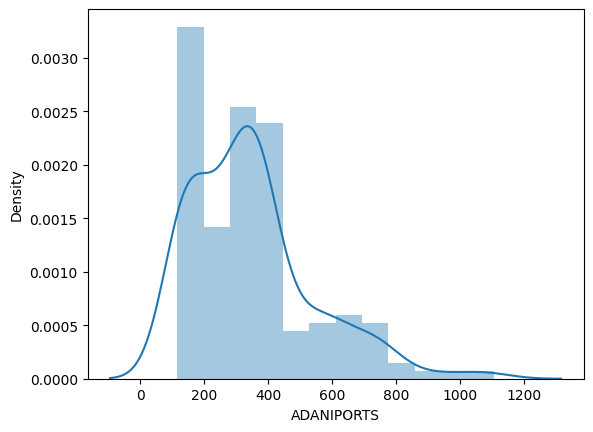

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




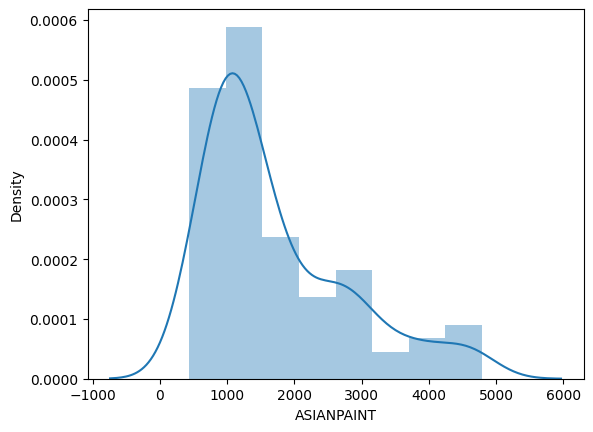

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




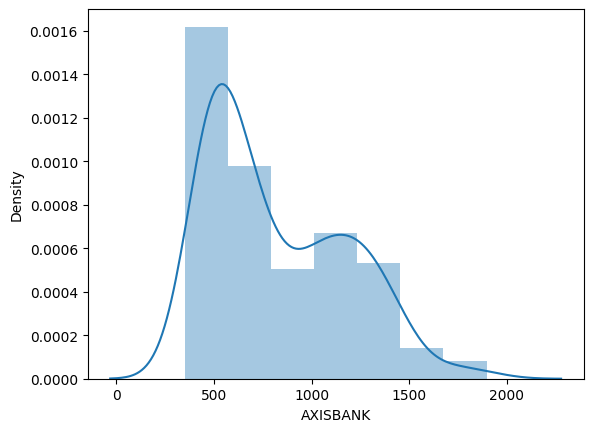

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




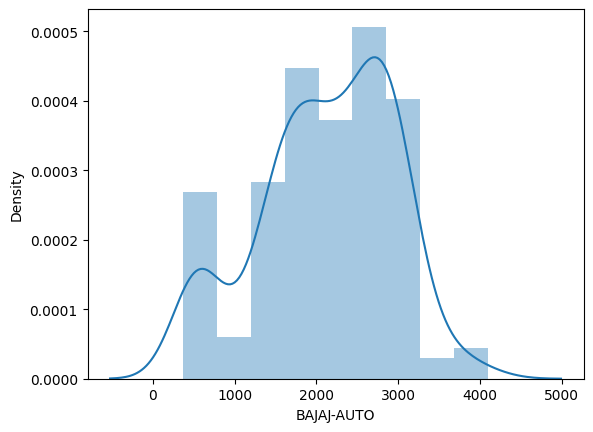

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




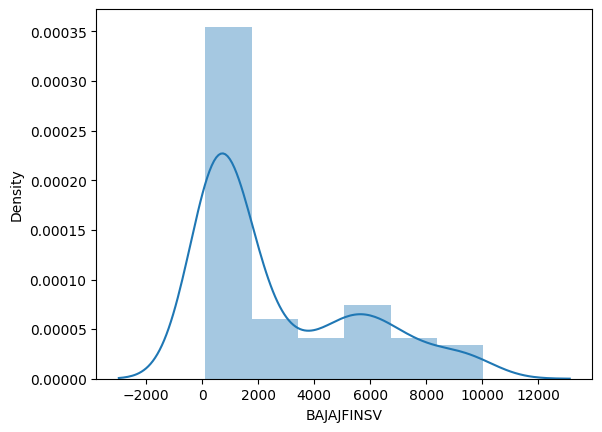

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




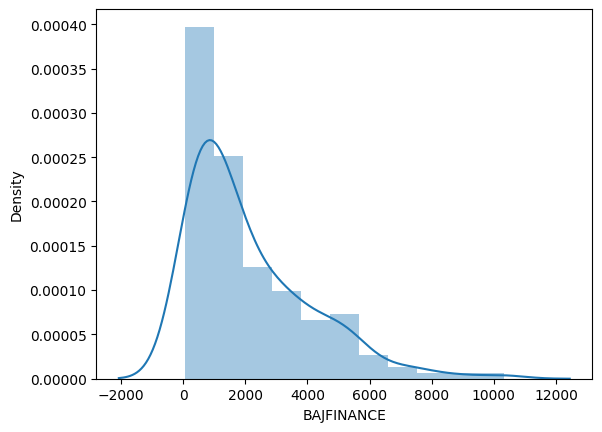

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




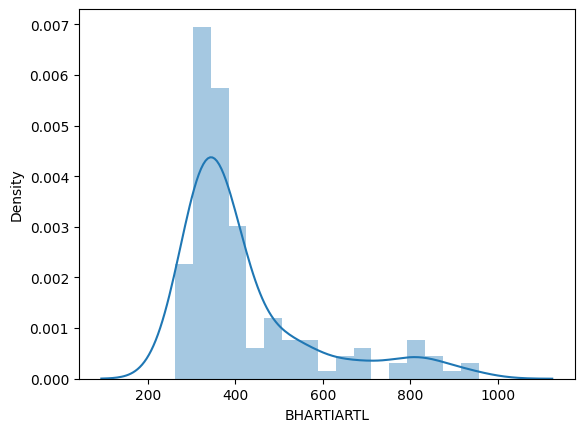

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




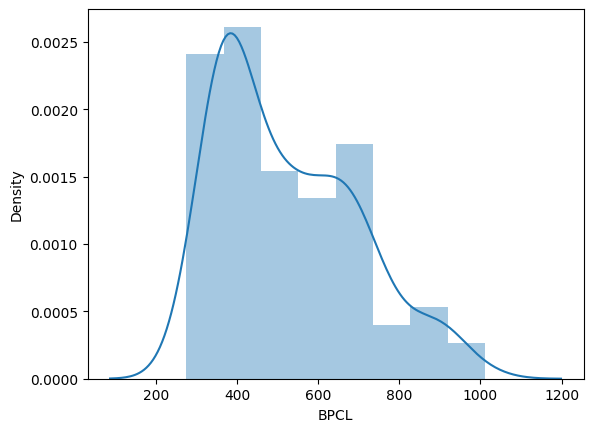

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




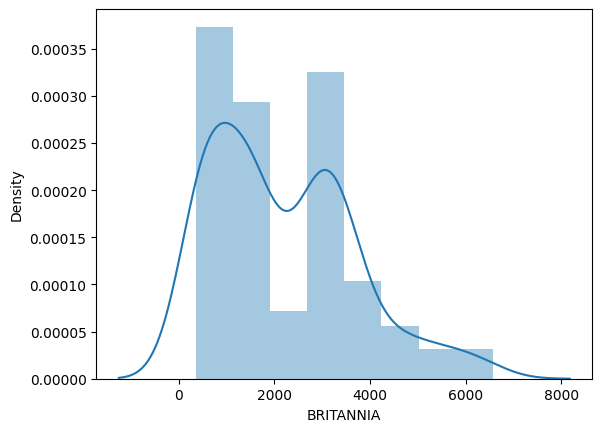

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




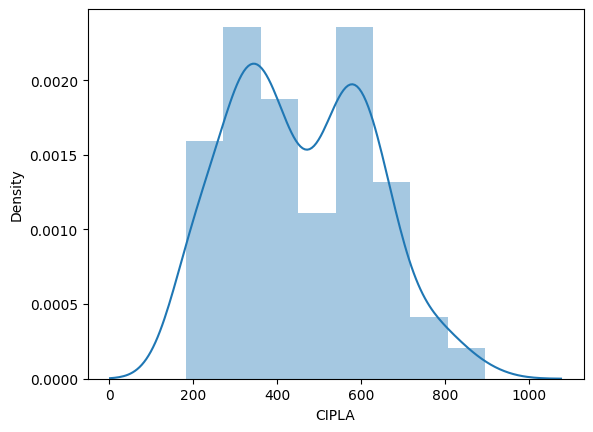

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




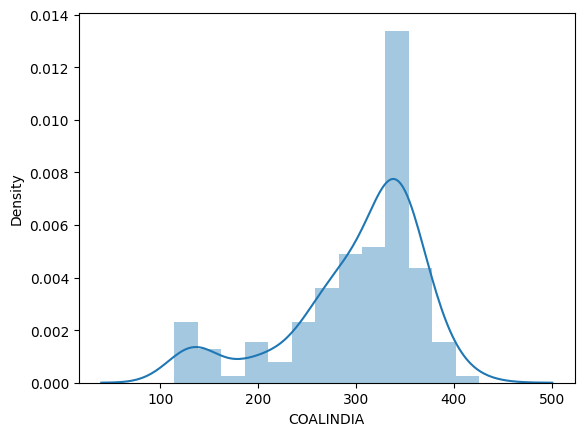

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




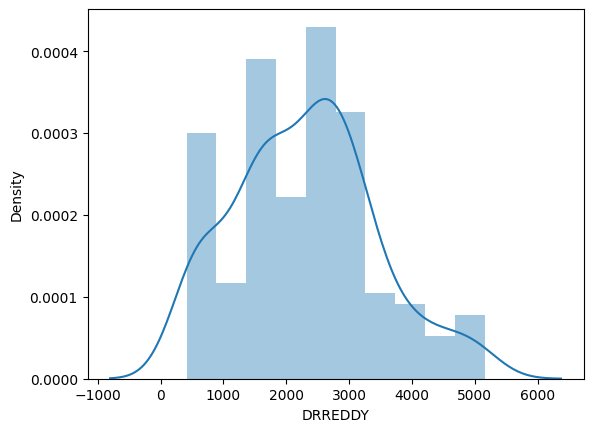

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




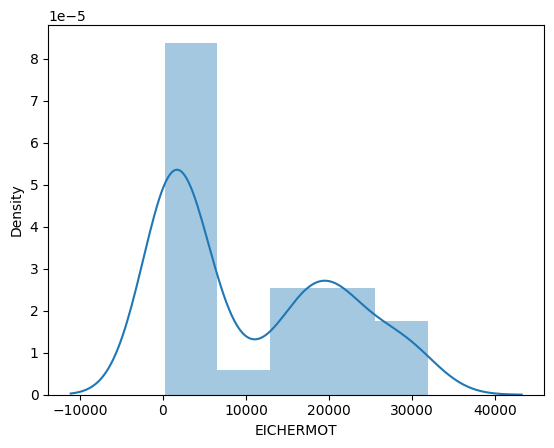

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




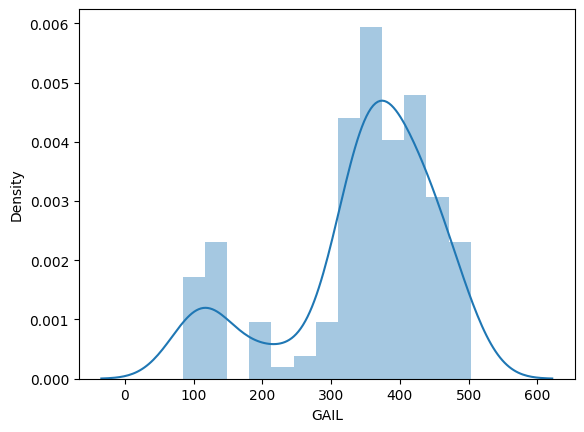

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




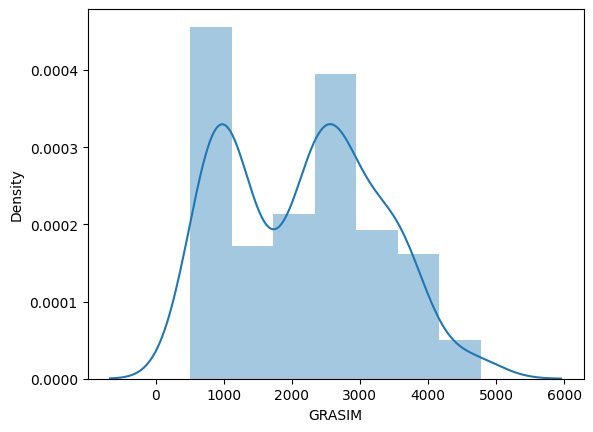

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




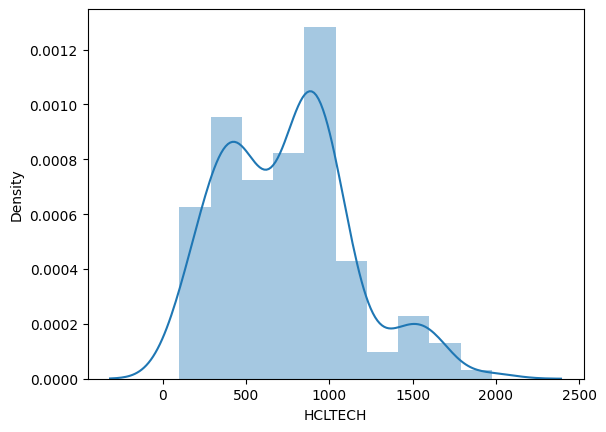

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




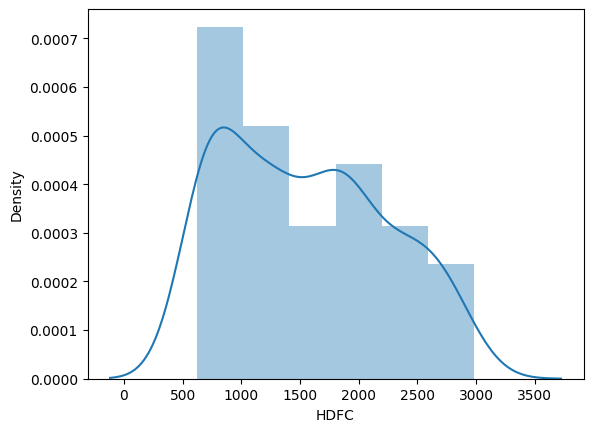

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




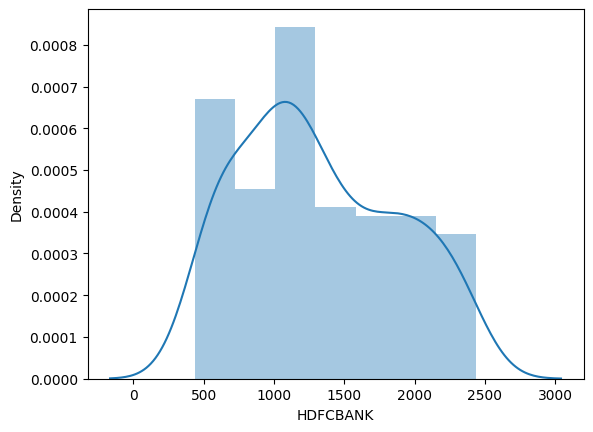

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




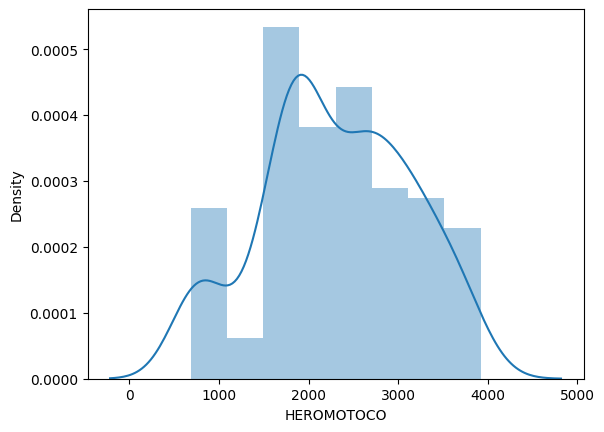

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




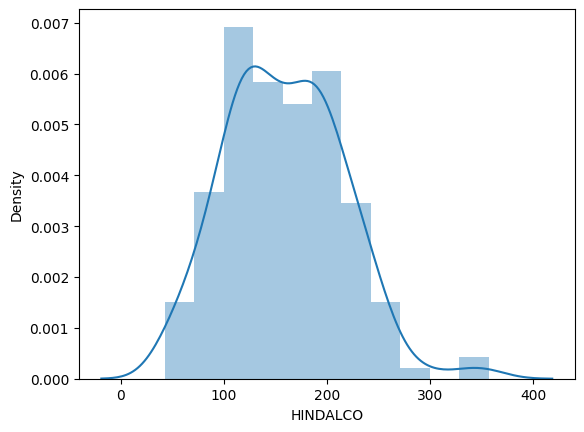

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




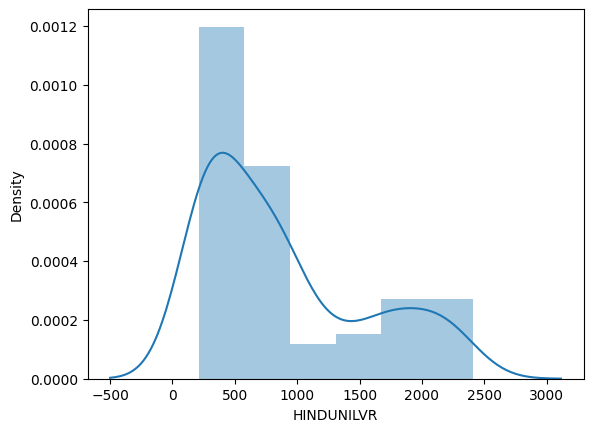

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




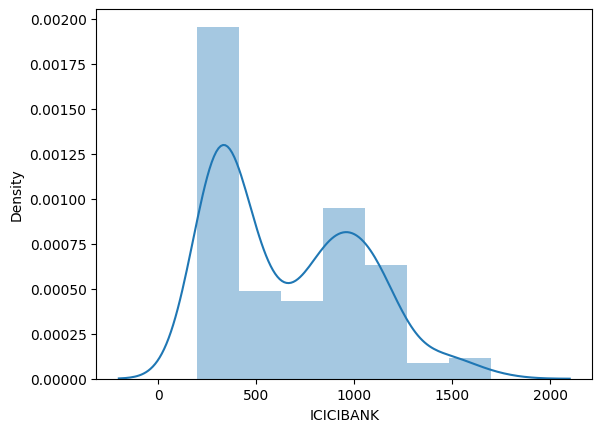

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




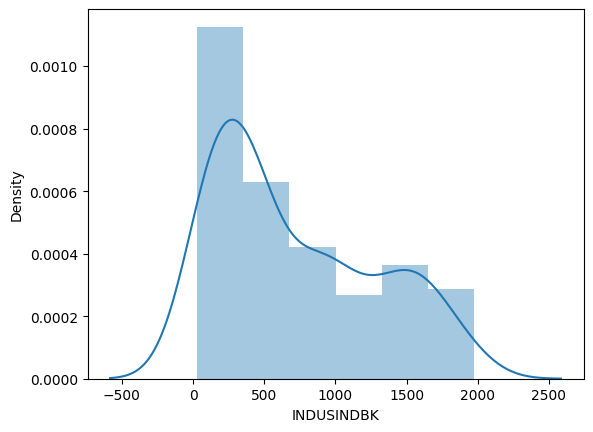

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




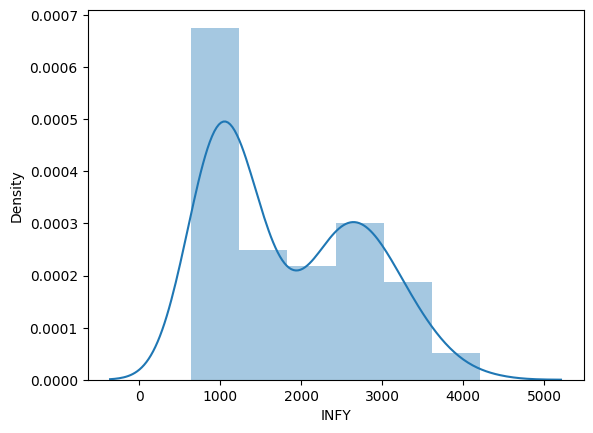

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




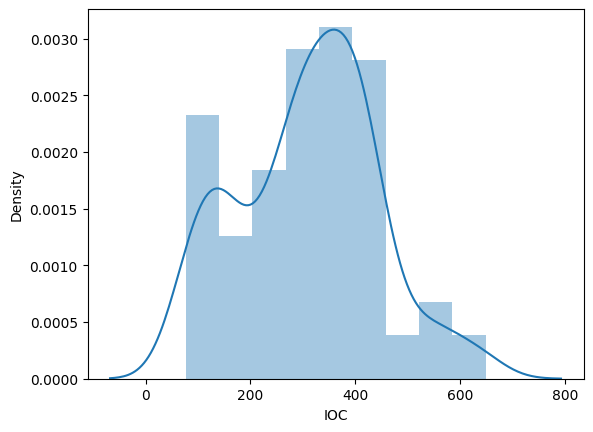

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




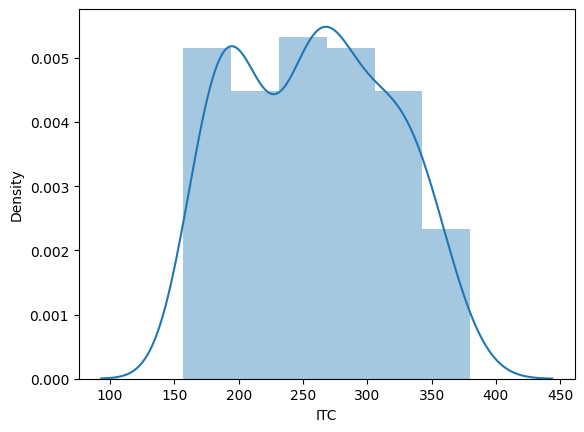

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




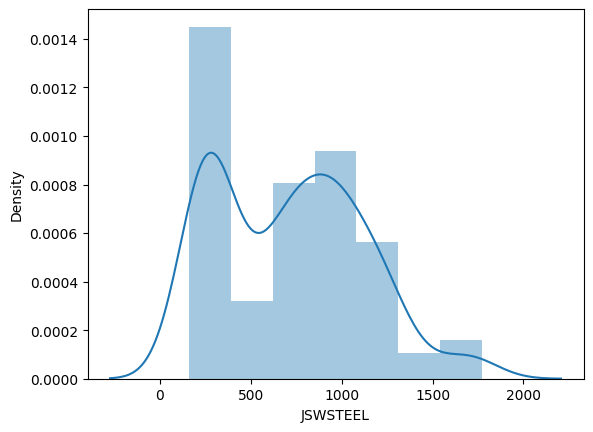

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




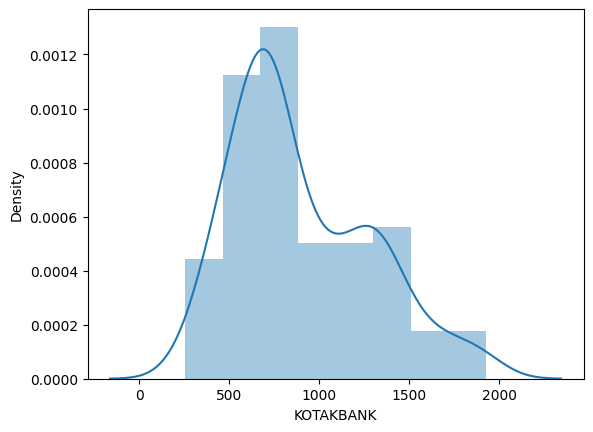

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




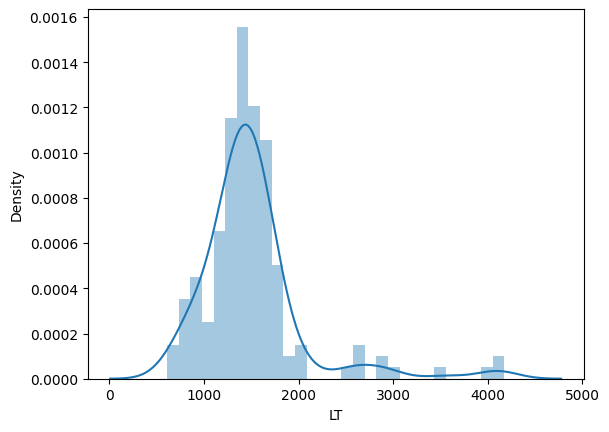

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




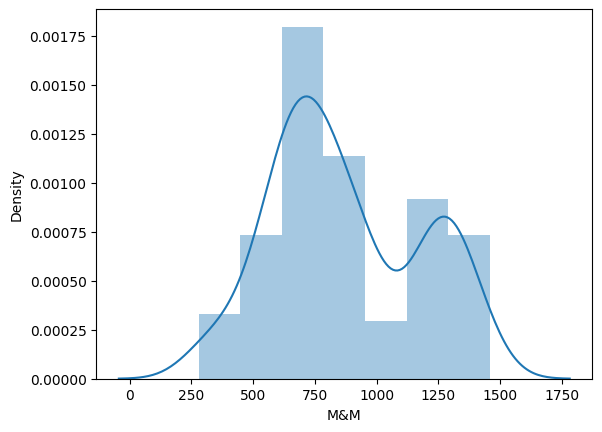

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




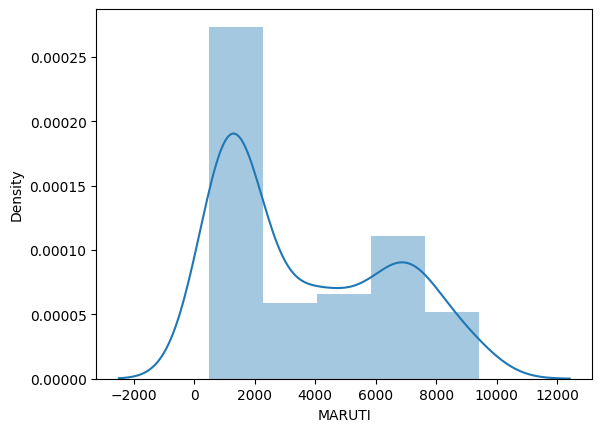

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




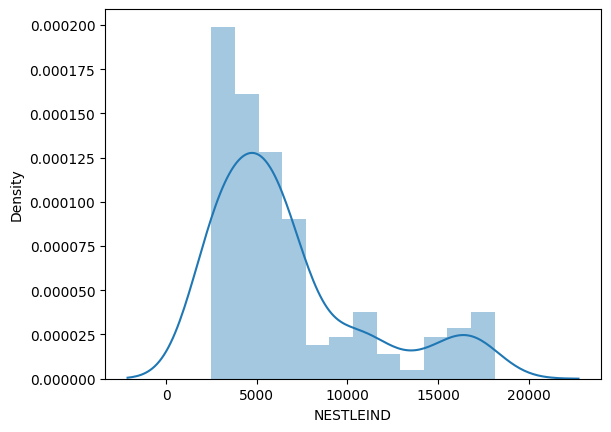

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




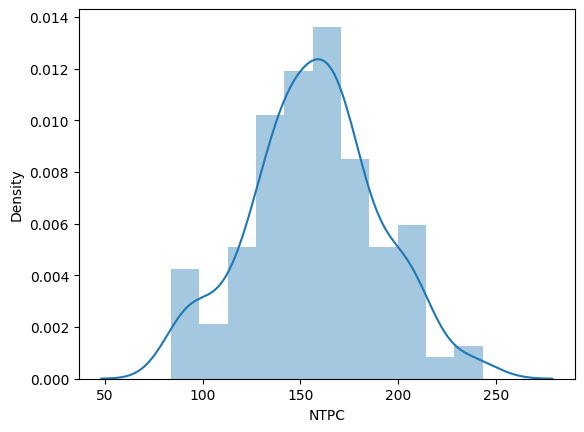

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




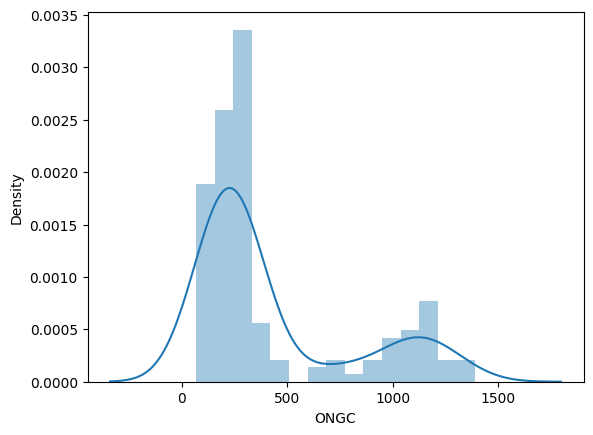

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




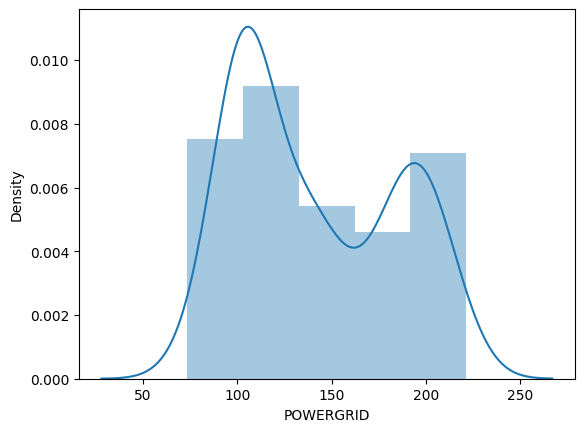

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




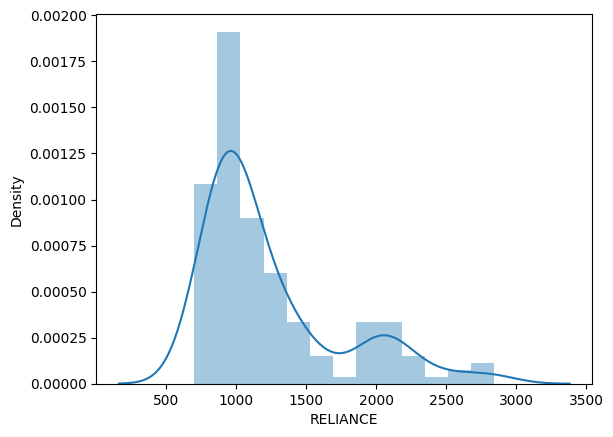

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




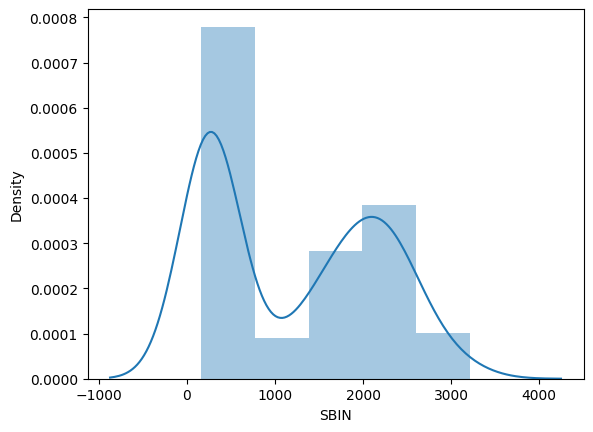

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




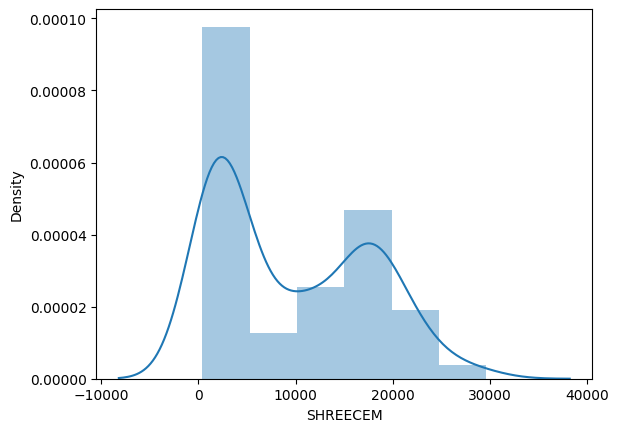

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




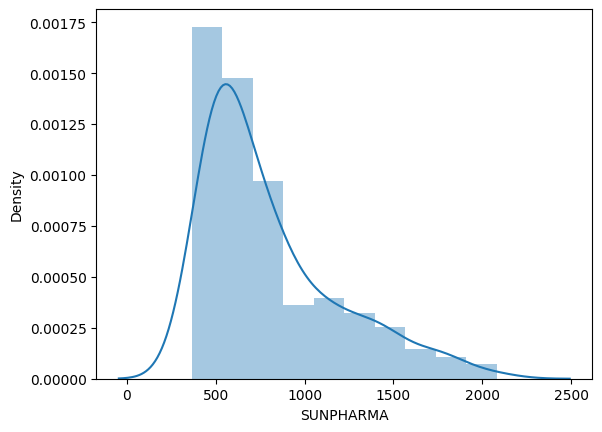

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




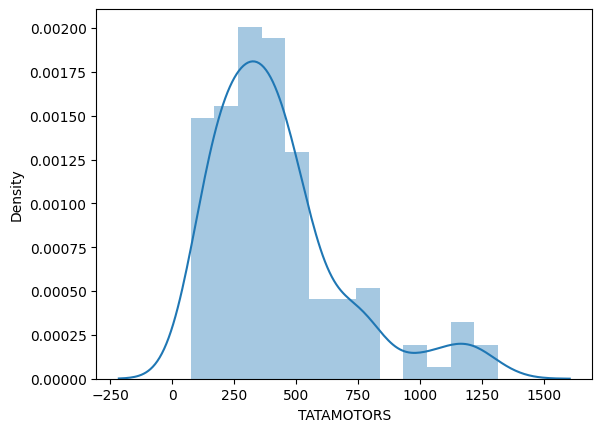

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




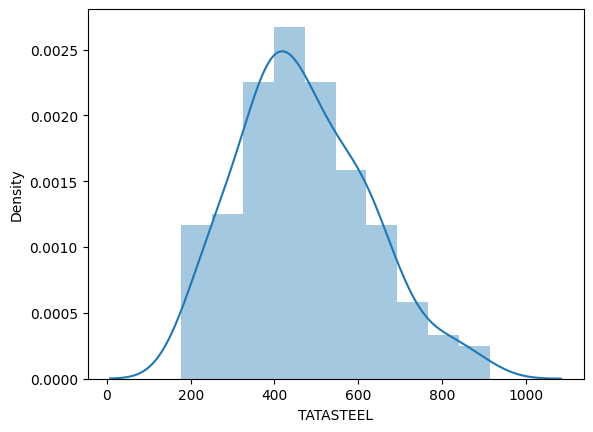

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




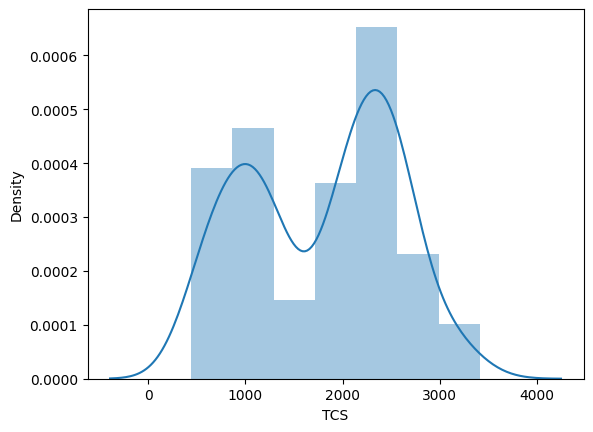

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




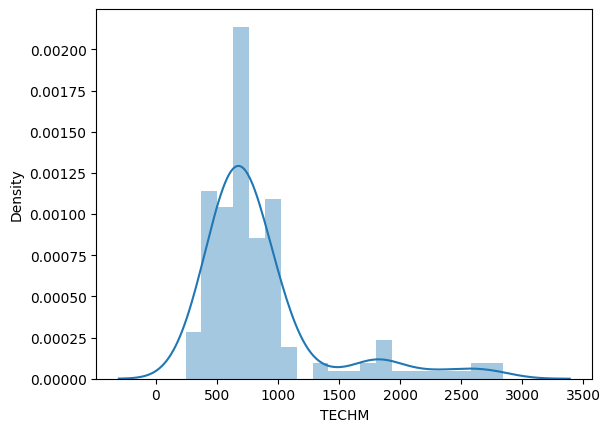

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




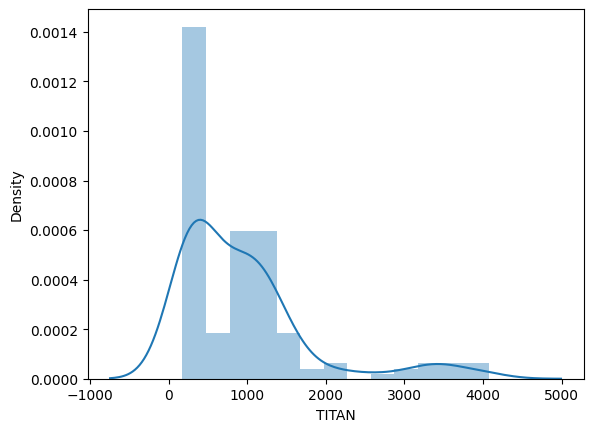

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




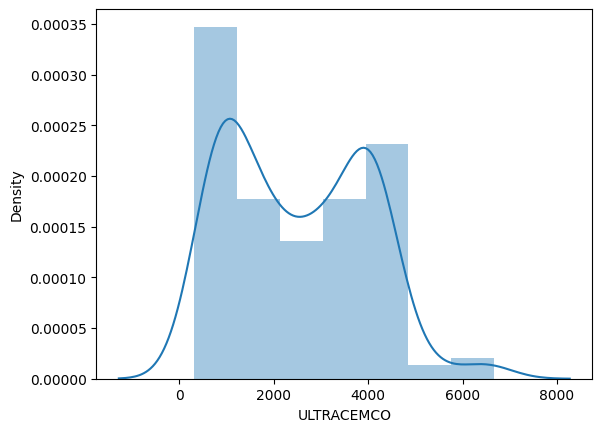

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




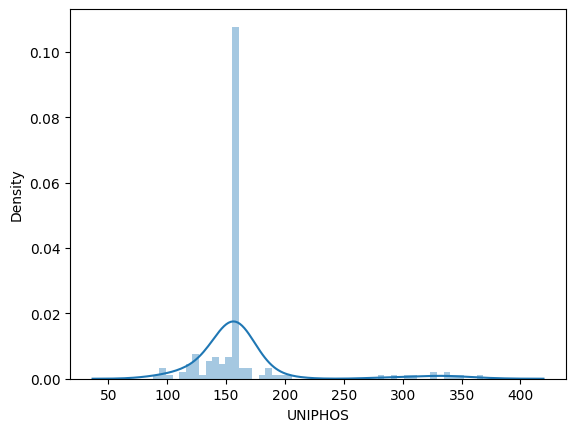

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




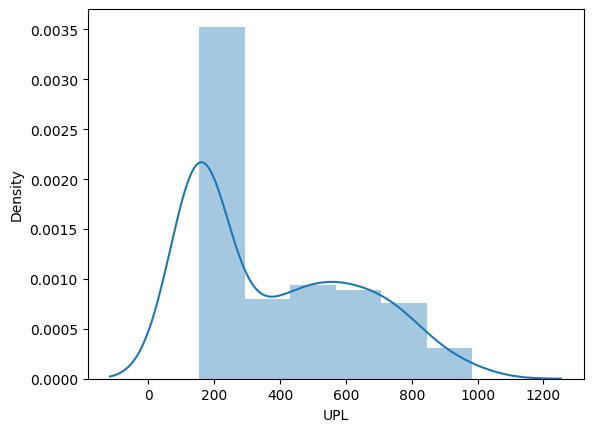

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




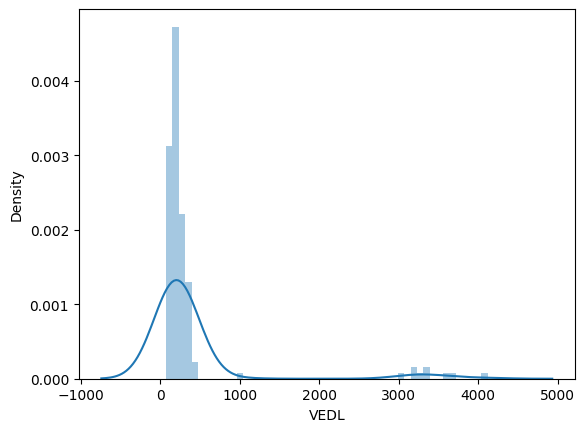

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




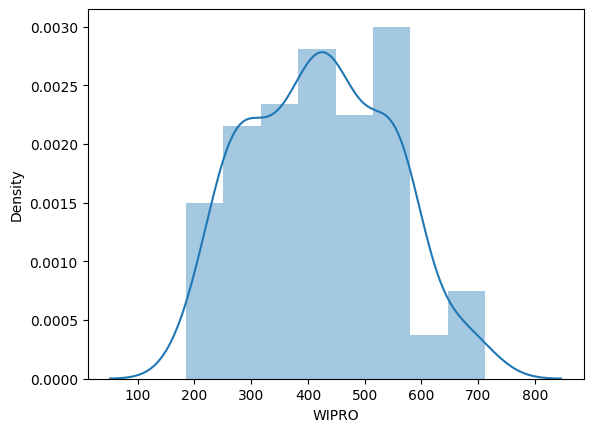

<ipython-input-34-520d596ecf0c>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




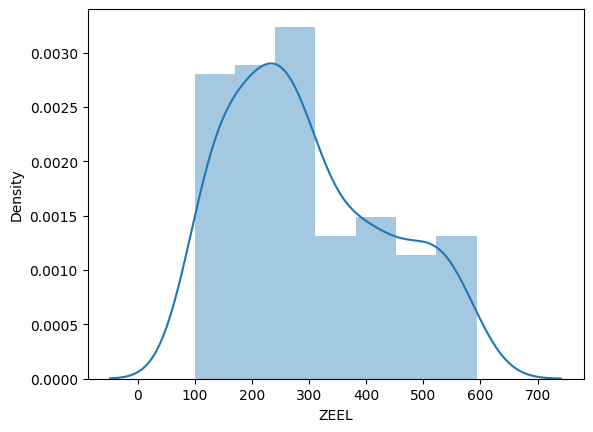

In [ ]:
for i in df.columns:
    sns.distplot(df[i])
    plt.show()

<ipython-input-35-cc77cdaaf725>:4: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



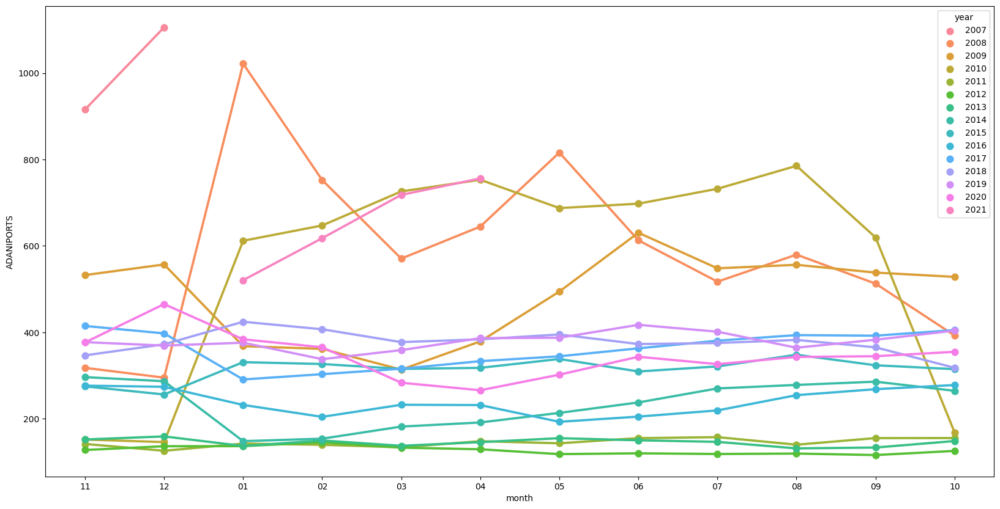

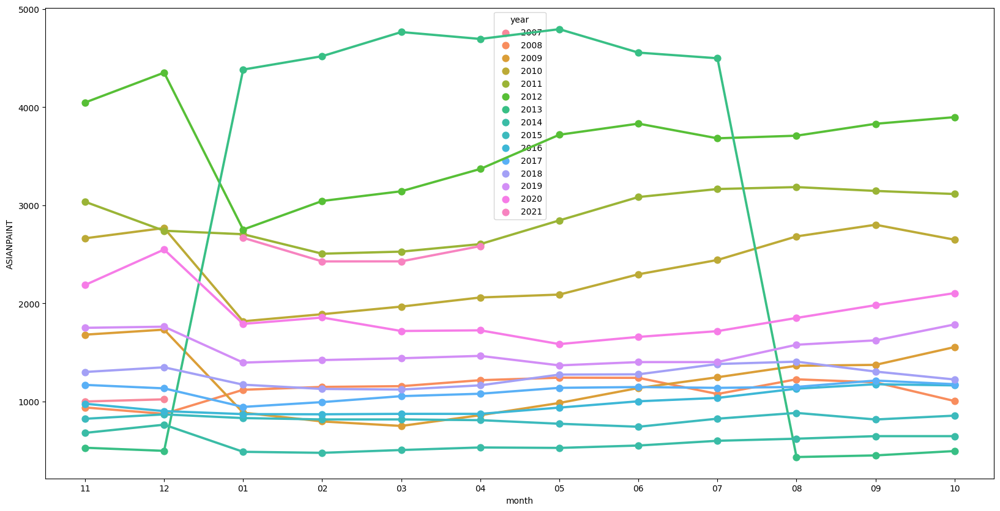

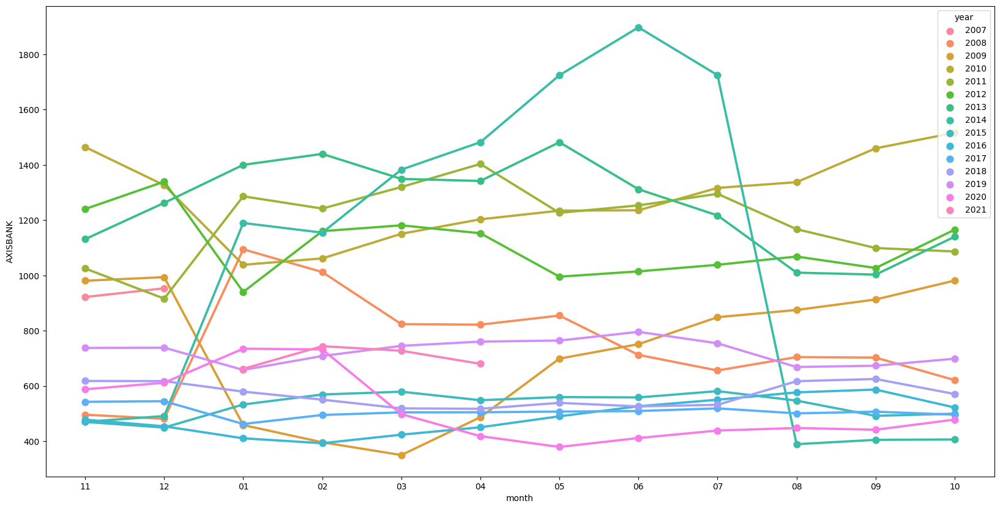

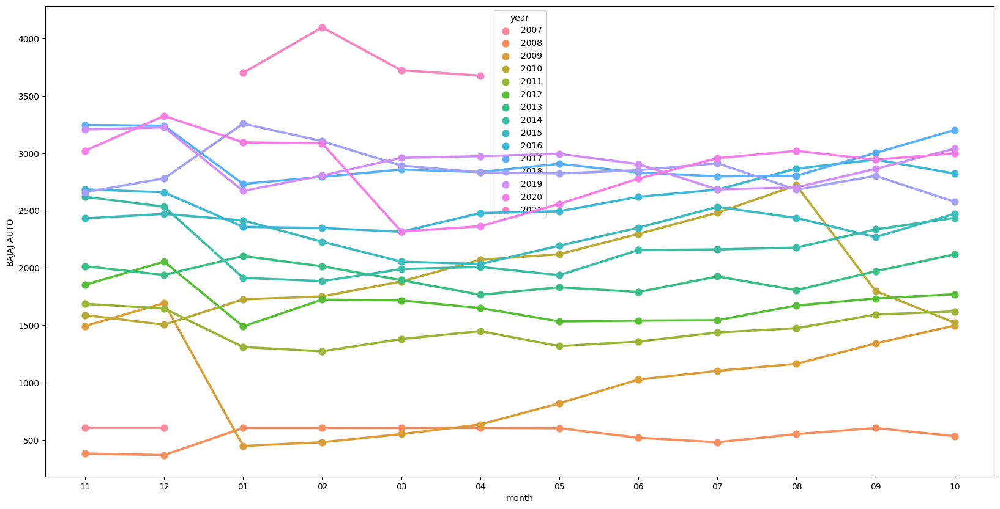

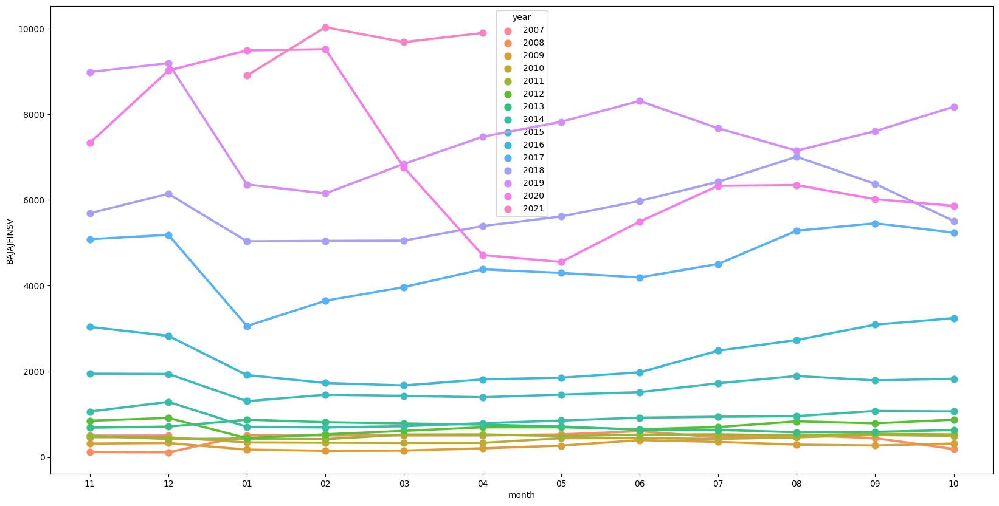

...

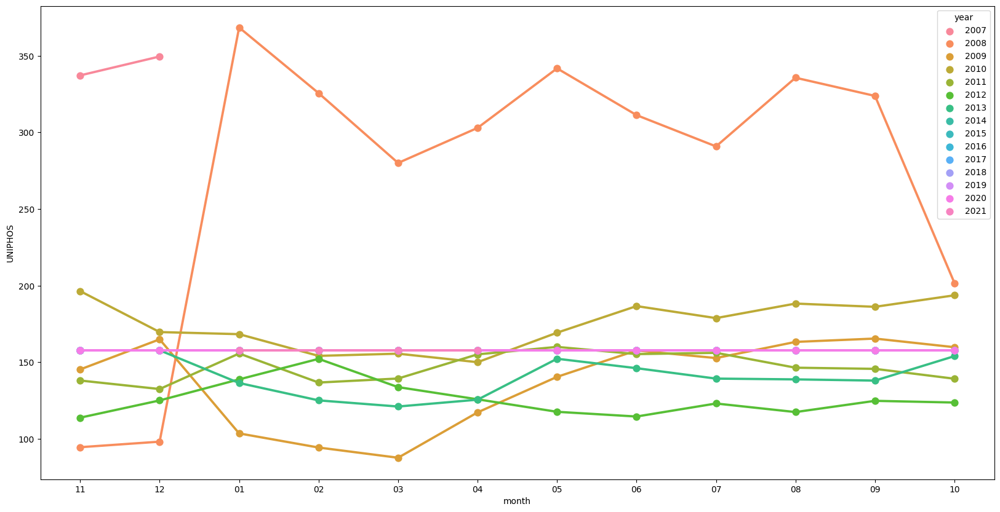

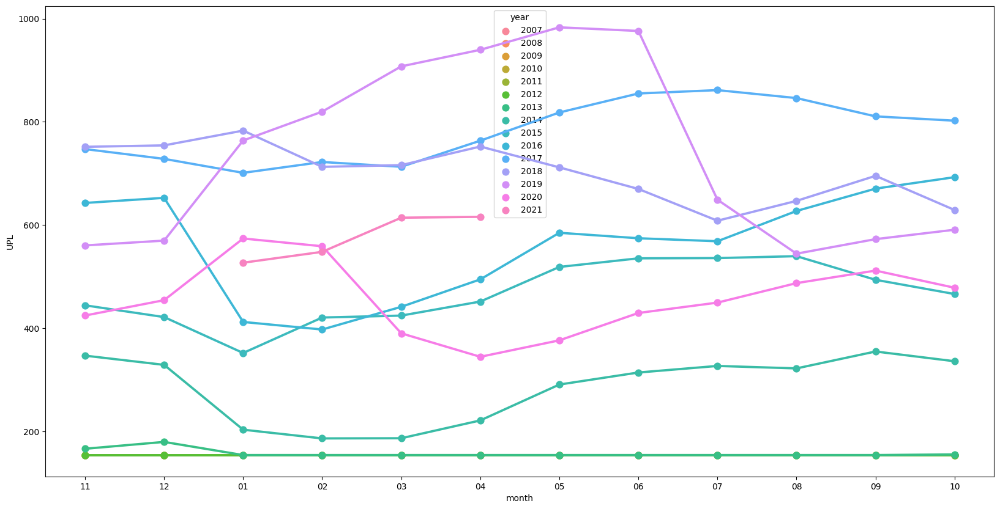

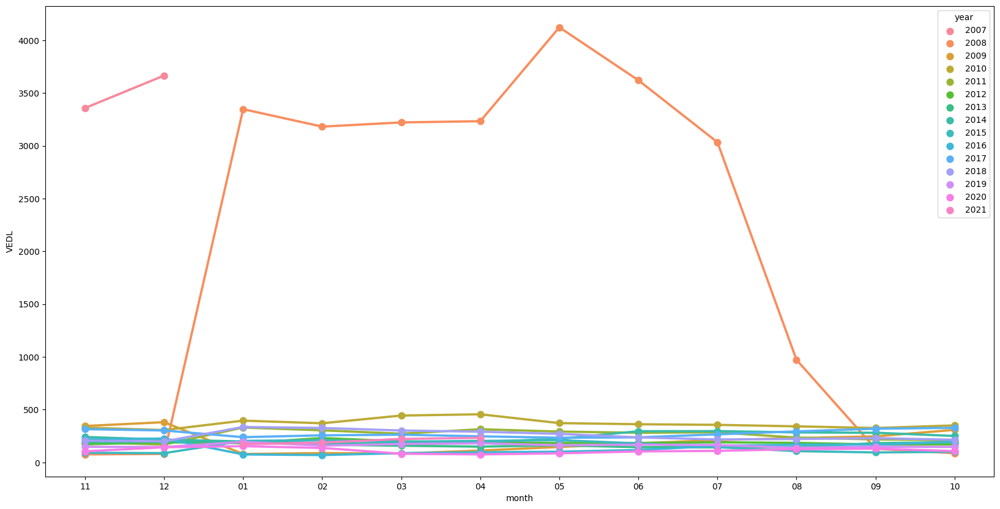

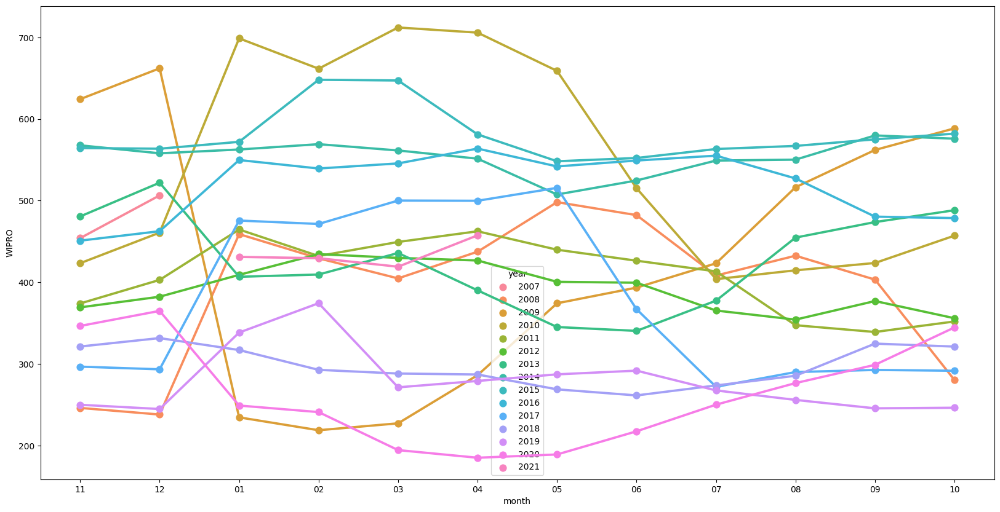

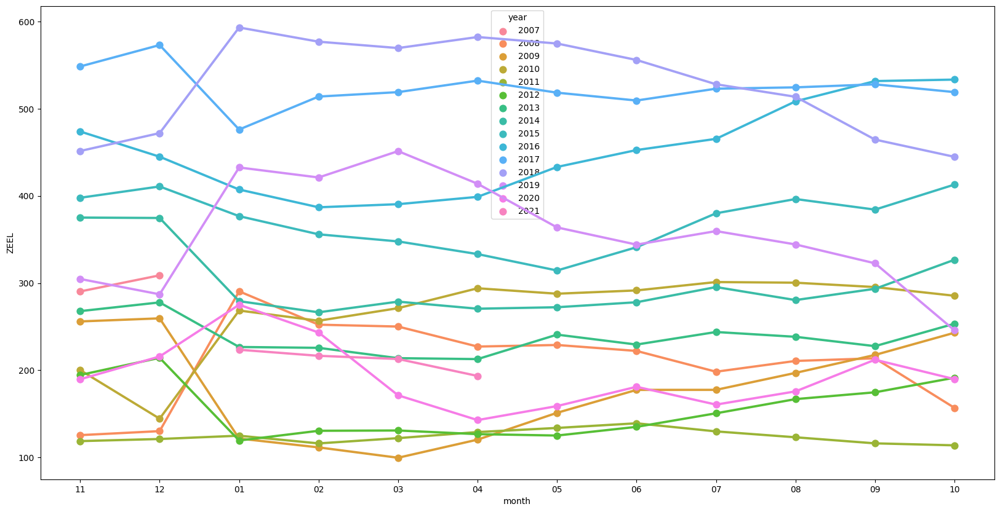

In [ ]:
for i in df.columns:
    df1['month'] = df1['Date'].apply(lambda x: str(x).split('-')[1])
    df1['year'] = df1['Date'].apply(lambda x: str(x).split('-')[0])
    fig, ax = plt.subplots(figsize=(20,10))
    sns.pointplot(data=df1,x= 'month', y=i,hue='year',ax=ax)

In [ ]:
train = df[( df.index.get_level_values(0) >='2007-11-30' ) &(df.index.get_level_values(0) <='2019-12-31' )]
test = df[(df.index.get_level_values(0) >'2019-12-31' )]

In [ ]:
len(test)

16

#ARIMA

In [ ]:
!pip install pmdarima


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 22.2 MB/s eta 0:00:00


In [ ]:
import pmdarima as pm
import sklearn.metrics as metrics
import numpy as np

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=inf, Time=0.50 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1622.971, Time=0.03 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1618.922, Time=0.62 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1607.045, Time=0.62 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1621.468, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1605.178, Time=0.08 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1607.042, Time=0.20 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=inf, Time=0.50 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1603.678, Time=0.12 sec
 ARIMA(1,1,1)(1,0,0)[12] intercept   : AIC=1605.409, Time=0.34 sec
 ARIMA(1,1,1)(0,0,1)[12] intercept   : AIC=1605.416, Time=0.45 sec
 ARIMA(1,1,1)(1,0,1)[12] intercept   : AIC=inf, Time=0.62 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1616.951, Time=0.08 sec
 ARIMA(2,1,1)(0,0,0)[12] intercept   : AIC=1598.393, Time=0.17 sec
 ARIMA(2,1,1)(1,0,0)[12] intercept

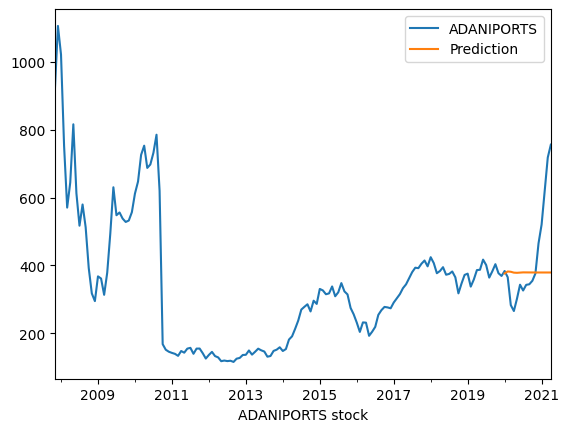

Results of sklearn.metrics:
MAE: 105.02265700821489
RMSE: 153.43306117118962
R-Squared: -0.08858776660436551
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=2120.838, Time=0.06 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=2116.847, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=2120.575, Time=0.10 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=2120.654, Time=0.13 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=2114.879, Time=0.02 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=2118.838, Time=0.08 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=2118.838, Time=0.07 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=2118.585, Time=0.03 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=2118.609, Time=0.13 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=2120.388, Time=0.23 sec

Best model:  ARIMA(0,1,0)(0,0,0)[12]          
Total fit time: 0.932 seconds
Axes(0.125,0.11;0.775x0.77)


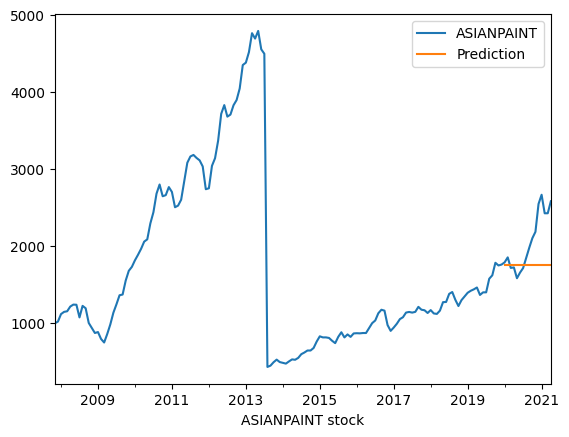

Results of sklearn.metrics:
MAE: 340.65240895438944
RMSE: 461.7101397284864
R-Squared: -0.6489333763227332
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=inf, Time=0.63 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1838.506, Time=0.03 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1836.910, Time=0.25 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1835.747, Time=0.29 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1836.519, Time=0.03 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1836.242, Time=0.10 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=inf, Time=0.67 sec
 ARIMA(0,1,1)(0,0,2)[12] intercept   : AIC=1836.746, Time=0.94 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1836.136, Time=0.45 sec
 ARIMA(0,1,1)(1,0,2)[12] intercept   : AIC=inf, Time=2.27 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=1837.848, Time=0.25 sec
 ARIMA(1,1,1)(0,0,1)[12] intercept   : AIC=1837.516, Time=0.66 sec
 ARIMA(0,1,2)(0,0,1)[12] intercept   : AIC=1837.113, Time=0.4

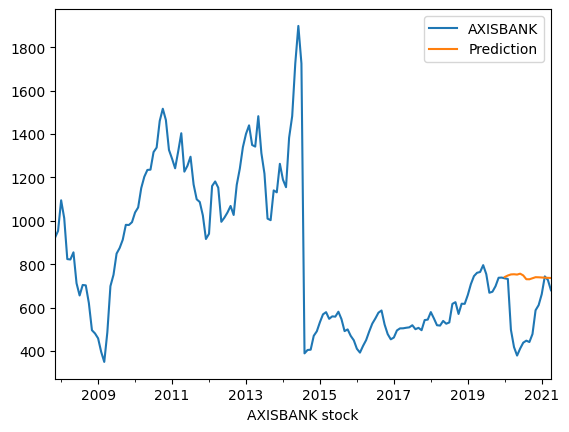

Results of sklearn.metrics:
MAE: 181.18984534446585
RMSE: 225.0722572601857
R-Squared: -1.9271034917893894
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=inf, Time=0.42 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1844.905, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1840.959, Time=0.15 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1840.108, Time=0.20 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1845.364, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1842.198, Time=0.08 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=inf, Time=0.51 sec
 ARIMA(0,1,1)(0,0,2)[12] intercept   : AIC=1842.022, Time=0.42 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1840.272, Time=0.20 sec
 ARIMA(0,1,1)(1,0,2)[12] intercept   : AIC=inf, Time=2.01 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=1843.161, Time=0.20 sec
 ARIMA(1,1,1)(0,0,1)[12] intercept   : AIC=1842.007, Time=0.56 sec
 ARIMA(0,1,2)(0,0,1)[12] intercept   : AIC=1841.934, Time=0.1

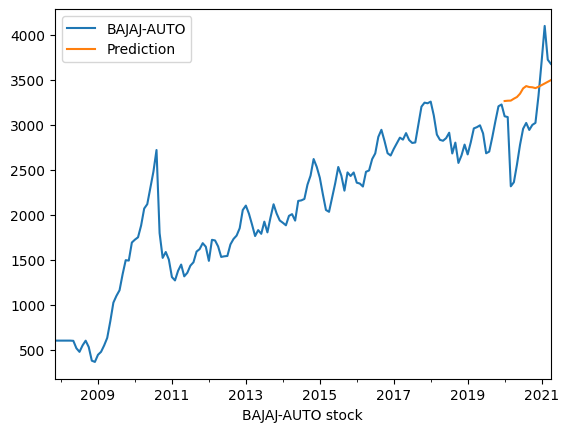

Results of sklearn.metrics:
MAE: 444.08476666993965
RMSE: 512.7731702779403
R-Squared: -0.12215280194920886
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1994.490, Time=0.13 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1990.490, Time=0.01 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1974.460, Time=0.07 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1959.840, Time=0.23 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1998.126, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1957.841, Time=0.09 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1959.840, Time=0.22 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=inf, Time=0.47 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1959.469, Time=0.14 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=1959.180, Time=0.13 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1972.506, Time=0.03 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=1958.548, Time=0.23 sec
 ARIMA(0,1,1)(0,0,0)[12]             : AIC=1960.82

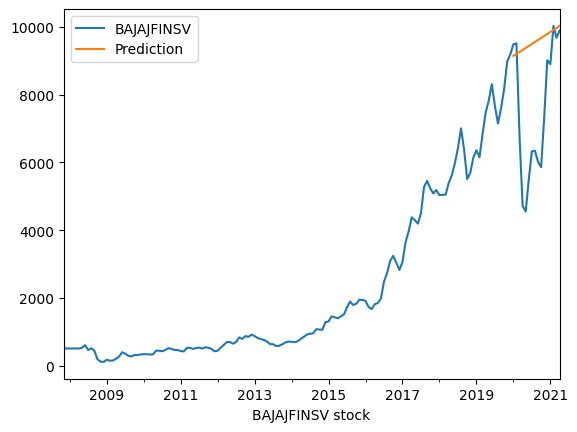

Results of sklearn.metrics:
MAE: 2188.2330136856026
RMSE: 2759.848175458427
R-Squared: -1.1094124777366403
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=2301.724, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=2297.985, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=2299.110, Time=0.07 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=2298.104, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=2296.210, Time=0.01 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=2299.750, Time=0.04 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=2299.764, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=2297.331, Time=0.04 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=2296.366, Time=0.03 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=2296.771, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[12]          
Total fit time: 0.625 seconds
Axes(0.125,0.11;0.775x0.77)


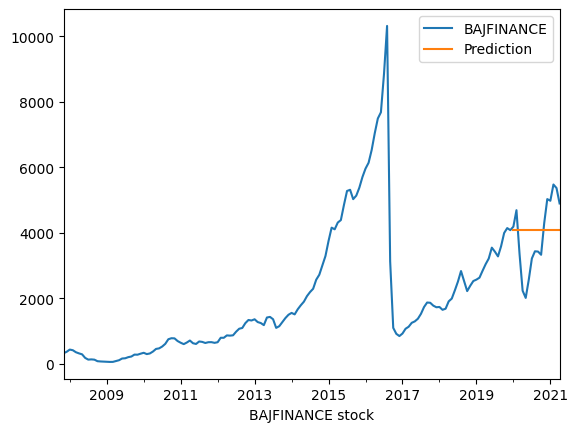

Results of sklearn.metrics:
MAE: 958.4758447259658
RMSE: 1091.2420698753274
R-Squared: -0.02664073608614803
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1491.994, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1488.161, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1487.705, Time=0.12 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1487.210, Time=0.20 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1487.100, Time=0.01 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=1489.995, Time=0.08 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=1489.993, Time=0.09 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1485.749, Time=0.06 sec
 ARIMA(1,1,0)(0,0,1)[12] intercept   : AIC=1487.704, Time=0.12 sec
 ARIMA(1,1,0)(1,0,1)[12] intercept   : AIC=1489.702, Time=0.69 sec
 ARIMA(2,1,0)(0,0,0)[12] intercept   : AIC=1486.550, Time=0.12 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1487.227, Time=0.18 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=14

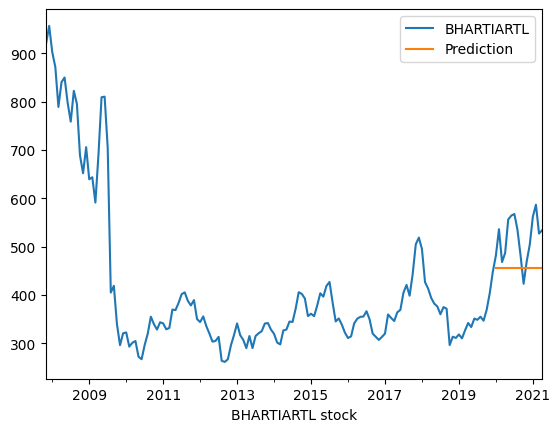

Results of sklearn.metrics:
MAE: 66.3975734268964
RMSE: 76.44183510430933
R-Squared: -1.994299845819505
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1571.594, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1569.704, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1561.238, Time=0.12 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1556.535, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1567.729, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1554.892, Time=0.07 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1556.555, Time=0.16 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=1558.488, Time=0.32 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1556.381, Time=0.12 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=1556.151, Time=0.06 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1559.644, Time=0.05 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=inf, Time=0.36 sec
 ARIMA(0,1,1)(0,0,0)[12]             : AIC=1552.910, T

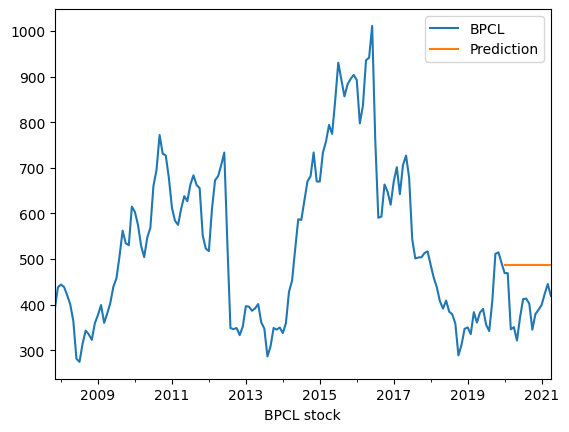

Results of sklearn.metrics:
MAE: 88.8886446458808
RMSE: 98.44668412650337
R-Squared: -4.412696533447619
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=2048.397, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=2044.464, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=2045.747, Time=0.08 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=2046.288, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=2042.689, Time=0.01 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=2046.453, Time=0.04 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=2046.454, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=2043.770, Time=0.03 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=2044.303, Time=0.06 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=2043.859, Time=0.13 sec

Best model:  ARIMA(0,1,0)(0,0,0)[12]          
Total fit time: 0.777 seconds
Axes(0.125,0.11;0.775x0.77)


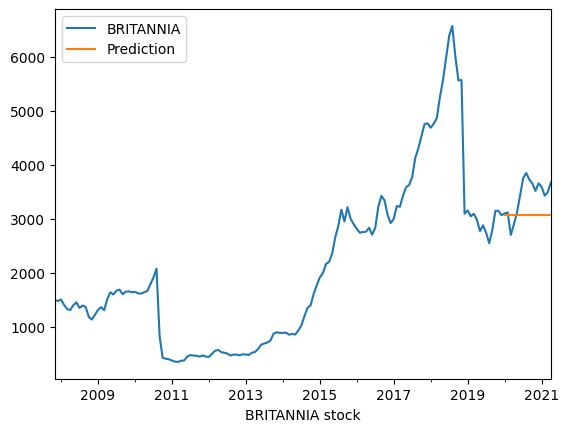

Results of sklearn.metrics:
MAE: 418.54417184987324
RMSE: 478.18687955973047
R-Squared: -1.1806025894282905
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1353.294, Time=0.24 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1351.165, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1349.746, Time=0.15 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1349.919, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1350.029, Time=0.02 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1347.845, Time=0.04 sec
 ARIMA(1,1,0)(0,0,1)[12] intercept   : AIC=1349.775, Time=0.15 sec
 ARIMA(1,1,0)(1,0,1)[12] intercept   : AIC=1350.236, Time=0.24 sec
 ARIMA(2,1,0)(0,0,0)[12] intercept   : AIC=1349.830, Time=0.08 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1349.836, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1347.994, Time=0.08 sec
 ARIMA(2,1,1)(0,0,0)[12] intercept   : AIC=inf, Time=0.29 sec
 ARIMA(1,1,0)(0,0,0)[12]             : AIC=1346.44

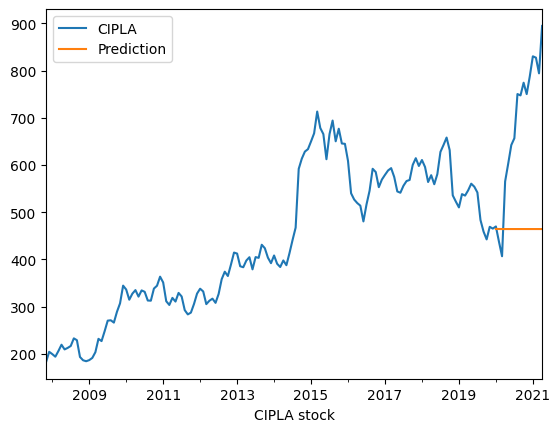

Results of sklearn.metrics:
MAE: 229.83026745353283
RMSE: 262.9543945242113
R-Squared: -2.283858663922886
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1208.935, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1207.176, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1200.327, Time=0.14 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1194.176, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1205.790, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1192.480, Time=0.06 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1194.225, Time=0.15 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=inf, Time=0.42 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1188.654, Time=0.08 sec
 ARIMA(1,1,1)(1,0,0)[12] intercept   : AIC=1190.383, Time=0.22 sec
 ARIMA(1,1,1)(0,0,1)[12] intercept   : AIC=1190.319, Time=0.20 sec
 ARIMA(1,1,1)(1,0,1)[12] intercept   : AIC=1191.023, Time=0.40 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1198.934,

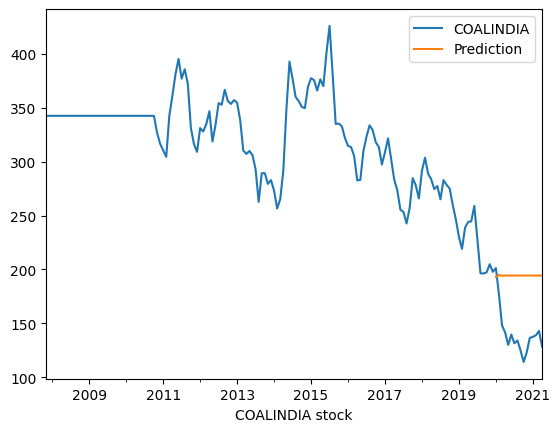

Results of sklearn.metrics:
MAE: 54.77679269577296
RMSE: 57.5943006311843
R-Squared: -6.905415911788493
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1867.709, Time=0.29 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1864.005, Time=0.04 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1867.659, Time=0.11 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1867.646, Time=0.31 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1863.608, Time=0.03 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=1865.755, Time=0.19 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=1865.739, Time=0.10 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1865.881, Time=0.05 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1865.879, Time=0.12 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1867.908, Time=0.11 sec

Best model:  ARIMA(0,1,0)(0,0,0)[12]          
Total fit time: 1.381 seconds
Axes(0.125,0.11;0.775x0.77)


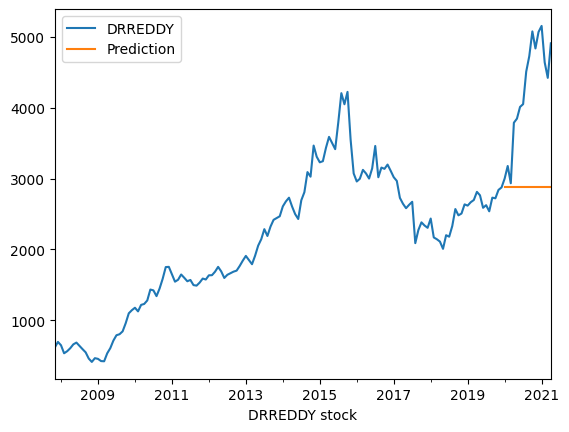

Results of sklearn.metrics:
MAE: 1383.5266241397094
RMSE: 1560.498700808913
R-Squared: -3.673912031355596
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=2423.834, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=2420.439, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=2416.608, Time=0.05 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=2414.837, Time=0.06 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=2421.523, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=2413.127, Time=0.03 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=2414.931, Time=0.07 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=2416.310, Time=0.15 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=2414.452, Time=0.05 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=2414.560, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=2414.683, Time=0.03 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=2416.525, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[12]             : AIC=2413

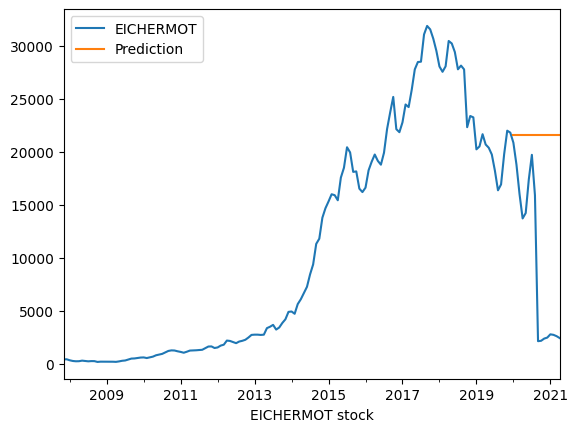

Results of sklearn.metrics:
MAE: 11849.39295755446
RMSE: 14020.390802890312
R-Squared: -2.5000000258971204
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1405.030, Time=0.23 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1401.205, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1398.109, Time=0.16 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1394.048, Time=0.22 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1399.921, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1392.223, Time=0.06 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1394.040, Time=0.15 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=1396.020, Time=0.35 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1391.281, Time=0.10 sec
 ARIMA(1,1,1)(1,0,0)[12] intercept   : AIC=1392.813, Time=0.22 sec
 ARIMA(1,1,1)(0,0,1)[12] intercept   : AIC=1392.809, Time=0.23 sec
 ARIMA(1,1,1)(1,0,1)[12] intercept   : AIC=1394.808, Time=0.45 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=139

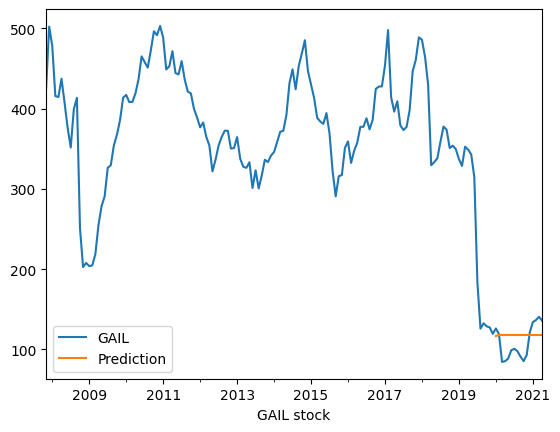

Results of sklearn.metrics:
MAE: 20.309127580807512
RMSE: 22.431901664225077
R-Squared: -0.21183612173152855
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=2095.704, Time=0.32 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=2093.316, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=2088.758, Time=0.12 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=2089.006, Time=0.06 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=2091.890, Time=0.03 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=2088.025, Time=0.03 sec
 ARIMA(1,1,0)(0,0,1)[12] intercept   : AIC=2088.922, Time=0.06 sec
 ARIMA(1,1,0)(1,0,1)[12] intercept   : AIC=2090.452, Time=0.11 sec
 ARIMA(2,1,0)(0,0,0)[12] intercept   : AIC=2089.770, Time=0.10 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=2089.893, Time=0.10 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=2088.059, Time=0.09 sec
 ARIMA(2,1,1)(0,0,0)[12] intercept   : AIC=2088.552, Time=0.26 sec
 ARIMA(1,1,0)(0,0,0)[12]             : AIC=2

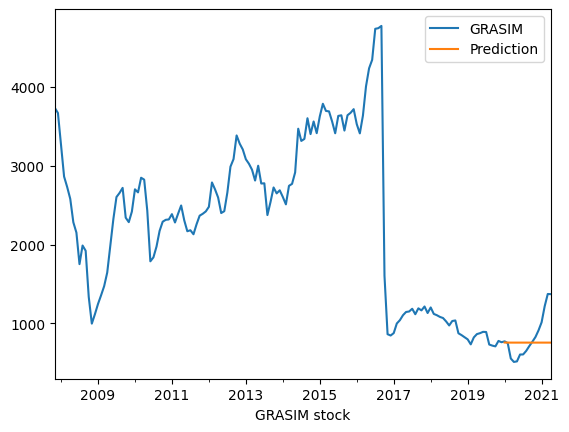

Results of sklearn.metrics:
MAE: 209.13609894198288
RMSE: 283.2945965920732
R-Squared: -0.05825305471289011
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1730.712, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1728.608, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1728.973, Time=0.15 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1726.735, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1726.694, Time=0.02 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=1728.754, Time=0.08 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=1728.712, Time=0.09 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1728.206, Time=0.04 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1725.406, Time=0.05 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1726.764, Time=0.13 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=1728.723, Time=0.24 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1712.389, Time=0.12 sec
 ARIMA(1,1,1)(1,0,0)[12] intercept   : AIC=17

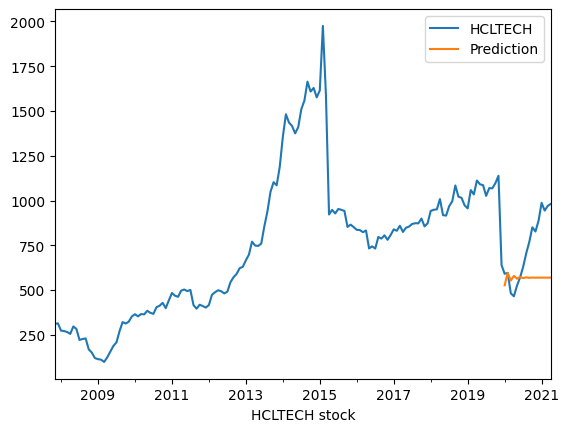

Results of sklearn.metrics:
MAE: 196.71023282952456
RMSE: 246.90537545352072
R-Squared: -0.8424259000117365
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1911.029, Time=0.27 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1908.109, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1890.148, Time=0.05 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1865.311, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1906.138, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1864.045, Time=0.05 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1865.476, Time=0.14 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=1866.459, Time=0.30 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1864.813, Time=0.08 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=1864.506, Time=0.08 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1888.230, Time=0.07 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=1866.243, Time=0.10 sec
 ARIMA(0,1,1)(0,0,0)[12]             : AIC=18

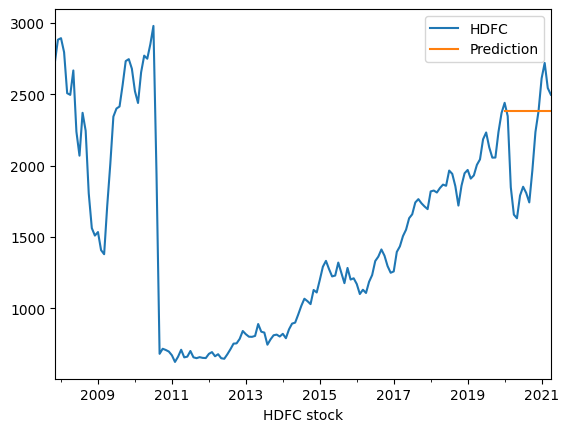

Results of sklearn.metrics:
MAE: 364.5845960646411
RMSE: 442.3545597823199
R-Squared: -0.4717911017076999
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1868.627, Time=0.26 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1865.005, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1839.771, Time=0.06 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1823.432, Time=0.26 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1863.052, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1821.456, Time=0.07 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1823.429, Time=0.21 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=inf, Time=0.47 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1821.516, Time=0.12 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=1821.920, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1837.767, Time=0.06 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=1822.961, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[12]             : AIC=1819.494,

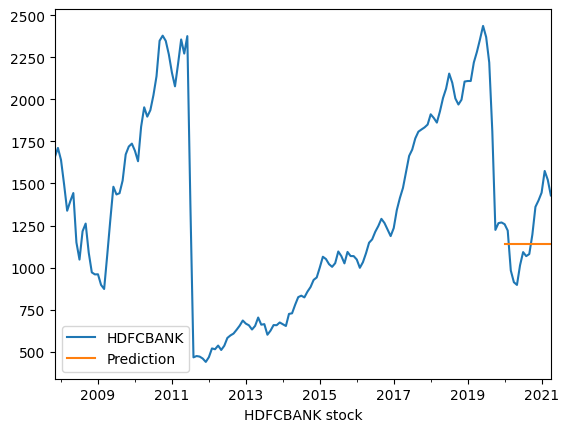

Results of sklearn.metrics:
MAE: 192.47147429726988
RMSE: 225.59746076927317
R-Squared: -0.12796025904848896
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1825.201, Time=0.33 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1823.773, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1824.001, Time=0.18 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1824.260, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1822.917, Time=0.02 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=1823.618, Time=0.13 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=1823.907, Time=0.11 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1824.582, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1824.461, Time=0.08 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1822.166, Time=0.14 sec
 ARIMA(1,1,1)(1,0,0)[12] intercept   : AIC=1822.008, Time=0.39 sec
 ARIMA(1,1,1)(2,0,0)[12] intercept   : AIC=1822.773, Time=0.87 sec
 ARIMA(1,1,1)(1,0,1)[12] intercept   : AIC=1

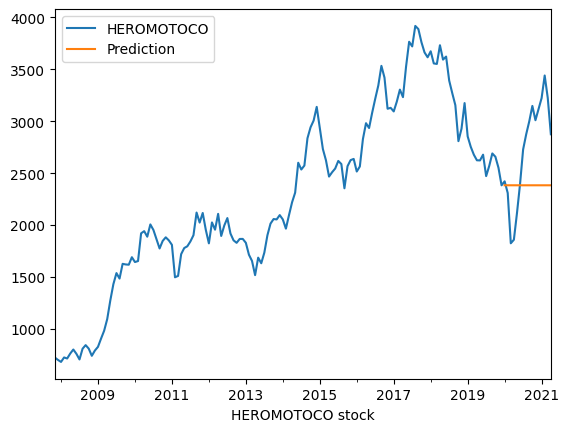

Results of sklearn.metrics:
MAE: 517.8131092740056
RMSE: 596.6940744724449
R-Squared: -0.4787669042967646
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1157.904, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1161.531, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1152.684, Time=0.15 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1151.034, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1159.551, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1152.230, Time=0.05 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=1149.923, Time=0.24 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1152.137, Time=0.13 sec
 ARIMA(0,1,1)(2,0,1)[12] intercept   : AIC=1150.957, Time=0.52 sec
 ARIMA(0,1,1)(1,0,2)[12] intercept   : AIC=1149.921, Time=0.51 sec
 ARIMA(0,1,1)(0,0,2)[12] intercept   : AIC=1148.396, Time=0.37 sec
 ARIMA(0,1,0)(0,0,2)[12] intercept   : AIC=1155.478, Time=0.24 sec
 ARIMA(1,1,1)(0,0,2)[12] intercept   : AIC=1151

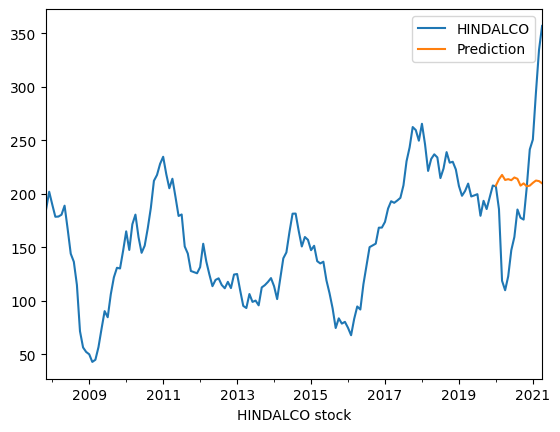

Results of sklearn.metrics:
MAE: 60.161748194110885
RMSE: 73.24574799453002
R-Squared: -0.044093138870670234
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1506.989, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1503.772, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1499.667, Time=0.14 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1498.612, Time=0.20 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1513.249, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1498.368, Time=0.07 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1498.618, Time=0.17 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=1500.608, Time=0.35 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1500.368, Time=0.09 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=1500.368, Time=0.11 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1499.551, Time=0.05 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=1495.324, Time=0.19 sec
 ARIMA(1,1,2)(1,0,0)[12] intercept   : AIC=1

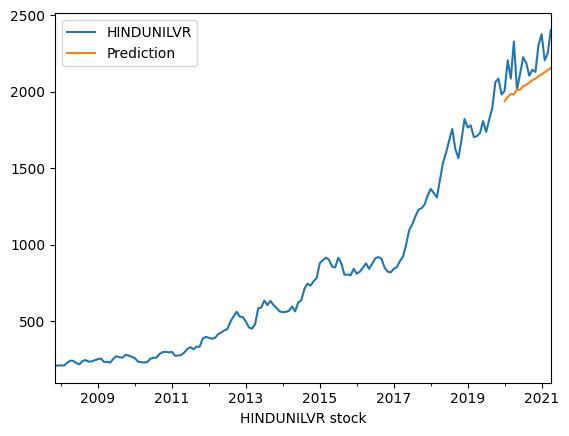

Results of sklearn.metrics:
MAE: 140.83424480440493
RMSE: 169.22502862065545
R-Squared: -1.1510482451354567
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1801.545, Time=0.23 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1798.069, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1800.667, Time=0.13 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1800.524, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1796.257, Time=0.02 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=1799.859, Time=0.04 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=1799.818, Time=0.08 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1798.841, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1798.729, Time=0.07 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1800.619, Time=0.12 sec

Best model:  ARIMA(0,1,0)(0,0,0)[12]          
Total fit time: 0.888 seconds
Axes(0.125,0.11;0.775x0.77)


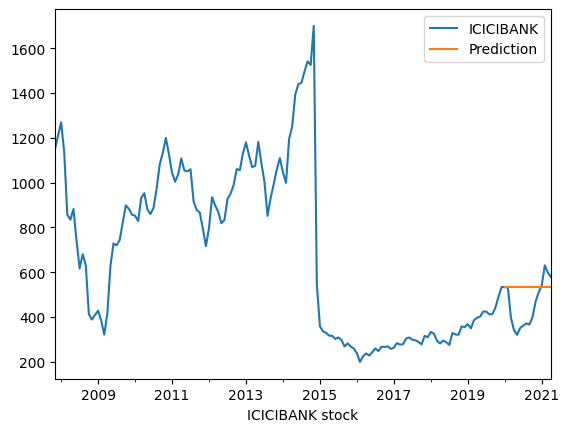

Results of sklearn.metrics:
MAE: 104.64327203569692
RMSE: 127.425213355348
R-Squared: -0.6096998783846388
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1568.365, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1566.062, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1560.119, Time=0.16 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1556.053, Time=0.23 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1568.698, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1556.423, Time=0.07 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=1557.897, Time=0.24 sec
 ARIMA(0,1,1)(0,0,2)[12] intercept   : AIC=1557.523, Time=0.53 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1555.904, Time=0.10 sec
 ARIMA(0,1,1)(2,0,0)[12] intercept   : AIC=1557.887, Time=0.26 sec
 ARIMA(0,1,1)(2,0,1)[12] intercept   : AIC=1559.816, Time=0.83 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=1566.369, Time=0.32 sec
 ARIMA(1,1,1)(1,0,0)[12] intercept   : AIC=1551

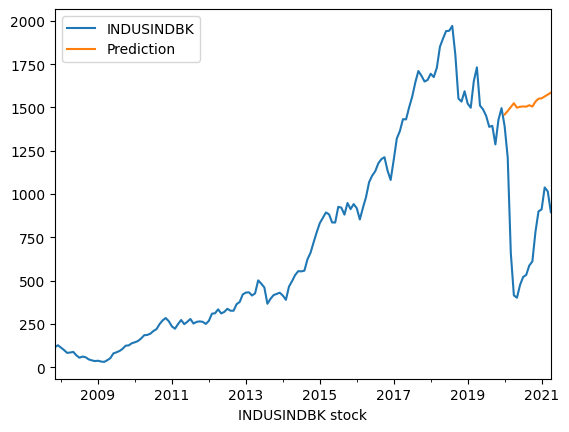

Results of sklearn.metrics:
MAE: 750.7604978069362
RMSE: 803.1596911807355
R-Squared: -6.909144042697419
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1997.082, Time=0.20 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1993.664, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1997.143, Time=0.14 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1997.084, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1991.759, Time=0.01 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=1995.257, Time=0.10 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=1995.223, Time=0.06 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1995.551, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1995.519, Time=0.07 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1996.712, Time=0.11 sec

Best model:  ARIMA(0,1,0)(0,0,0)[12]          
Total fit time: 0.922 seconds
Axes(0.125,0.11;0.775x0.77)


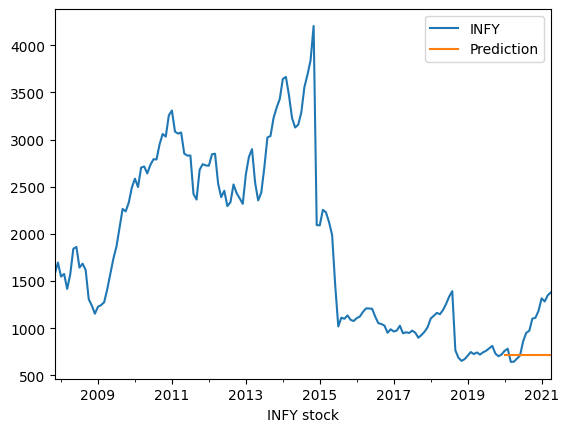

Results of sklearn.metrics:
MAE: 288.1957891243879
RMSE: 368.19757943997166
R-Squared: -1.0315245763443133
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=inf, Time=0.38 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1509.304, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1506.870, Time=0.18 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1501.509, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1507.915, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1499.660, Time=0.06 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1501.519, Time=0.19 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=1503.197, Time=0.40 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1500.201, Time=0.10 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=1498.283, Time=0.10 sec
 ARIMA(0,1,2)(1,0,0)[12] intercept   : AIC=1500.133, Time=0.24 sec
 ARIMA(0,1,2)(0,0,1)[12] intercept   : AIC=1500.126, Time=0.26 sec
 ARIMA(0,1,2)(1,0,1)[12] intercept   : AIC=1501.862

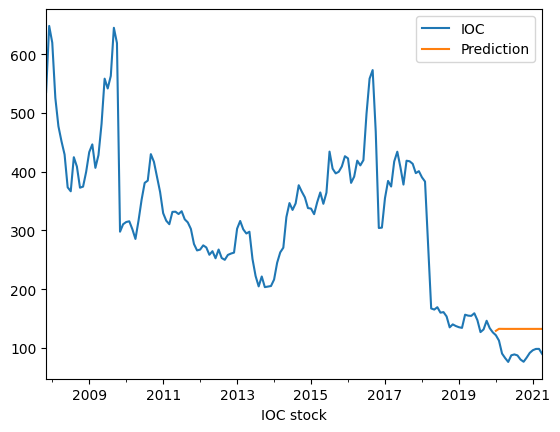

Results of sklearn.metrics:
MAE: 40.86869662423766
RMSE: 42.69505581408543
R-Squared: -12.032084688726504
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1279.715, Time=0.22 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1278.534, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1278.763, Time=0.14 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1278.079, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1276.586, Time=0.03 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=1278.741, Time=0.11 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=1278.333, Time=0.07 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1278.477, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1278.151, Time=0.04 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1279.798, Time=0.08 sec

Best model:  ARIMA(0,1,0)(0,0,0)[12]          
Total fit time: 0.980 seconds
Axes(0.125,0.11;0.775x0.77)


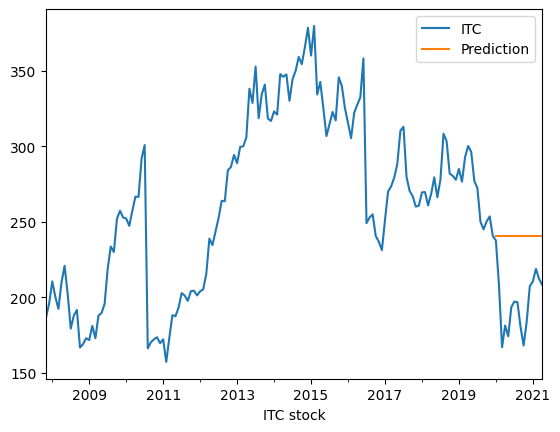

Results of sklearn.metrics:
MAE: 44.108777903978506
RMSE: 48.09833028755523
R-Squared: -5.288852762140257
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1846.956, Time=0.37 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1844.054, Time=0.03 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1842.723, Time=0.14 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1842.793, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1842.242, Time=0.02 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=1845.104, Time=0.09 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=1845.086, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1841.131, Time=0.09 sec
 ARIMA(1,1,0)(0,0,1)[12] intercept   : AIC=1842.686, Time=0.22 sec
 ARIMA(1,1,0)(1,0,1)[12] intercept   : AIC=1844.203, Time=0.37 sec
 ARIMA(2,1,0)(0,0,0)[12] intercept   : AIC=1843.105, Time=0.07 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1843.083, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1841

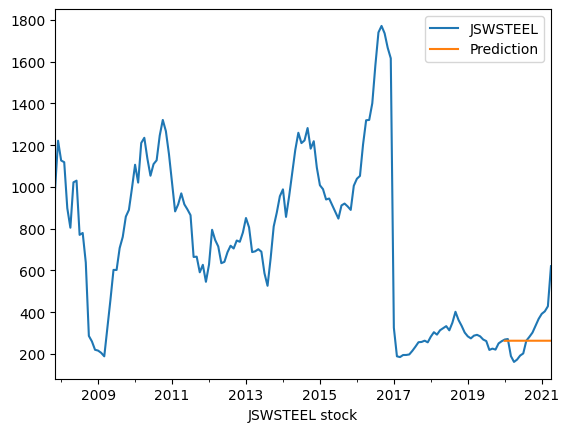

Results of sklearn.metrics:
MAE: 89.83960162317507
RMSE: 122.92266123702315
R-Squared: -0.11941141401367728
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=inf, Time=0.36 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1677.819, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1659.519, Time=0.12 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1655.963, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1676.149, Time=0.03 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1654.903, Time=0.08 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1655.891, Time=0.18 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=1657.872, Time=0.35 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1656.870, Time=0.09 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=1656.858, Time=0.10 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1659.434, Time=0.07 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=1657.223, Time=0.24 sec
 ARIMA(0,1,1)(0,0,0)[12]             : AIC=1653.15

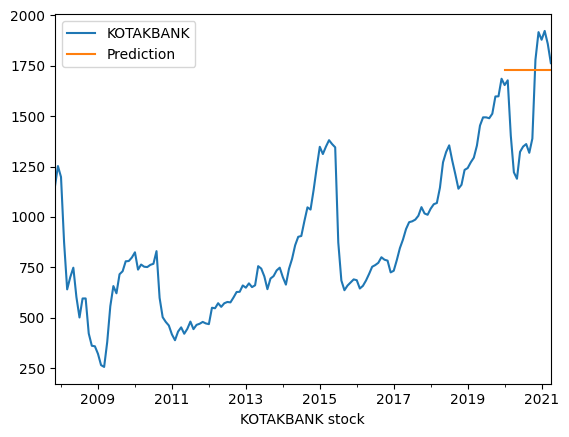

Results of sklearn.metrics:
MAE: 259.5301816246038
RMSE: 307.2315260976515
R-Squared: -0.41430230927141953
Performing stepwise search to minimize aic
 ARIMA(0,0,0)(1,0,1)[12] intercept   : AIC=2254.510, Time=0.25 sec
 ARIMA(0,0,0)(0,0,0)[12] intercept   : AIC=2267.019, Time=0.02 sec
 ARIMA(1,0,0)(1,0,0)[12] intercept   : AIC=1962.768, Time=0.33 sec
 ARIMA(0,0,1)(0,0,1)[12] intercept   : AIC=2111.036, Time=0.24 sec
 ARIMA(0,0,0)(0,0,0)[12]             : AIC=2578.696, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[12] intercept   : AIC=1960.867, Time=0.09 sec
 ARIMA(1,0,0)(0,0,1)[12] intercept   : AIC=1962.745, Time=0.32 sec
 ARIMA(1,0,0)(1,0,1)[12] intercept   : AIC=inf, Time=0.79 sec
 ARIMA(2,0,0)(0,0,0)[12] intercept   : AIC=1953.461, Time=0.27 sec
 ARIMA(2,0,0)(1,0,0)[12] intercept   : AIC=1955.453, Time=0.88 sec
 ARIMA(2,0,0)(0,0,1)[12] intercept   : AIC=1955.451, Time=1.98 sec
 ARIMA(2,0,0)(1,0,1)[12] intercept   : AIC=inf, Time=0.61 sec
 ARIMA(3,0,0)(0,0,0)[12] intercept   : AIC=1954.693, Tim

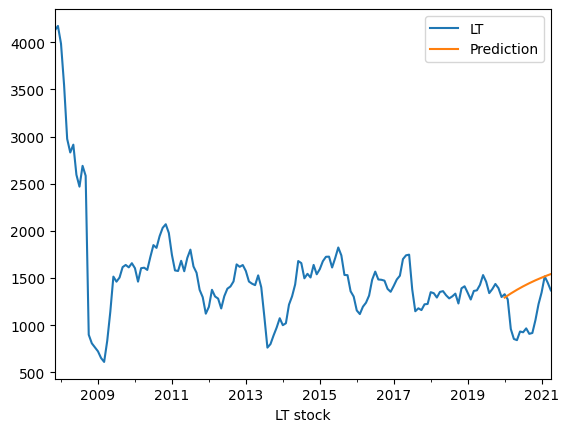

Results of sklearn.metrics:
MAE: 317.47649674882814
RMSE: 374.1720791592013
R-Squared: -1.7357615482110162
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1694.376, Time=0.22 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1693.109, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1689.740, Time=0.23 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1690.336, Time=0.13 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1691.148, Time=0.02 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1689.863, Time=0.04 sec
 ARIMA(1,1,0)(2,0,0)[12] intercept   : AIC=1690.598, Time=0.50 sec
 ARIMA(1,1,0)(1,0,1)[12] intercept   : AIC=1691.039, Time=0.27 sec
 ARIMA(1,1,0)(0,0,1)[12] intercept   : AIC=1690.048, Time=0.12 sec
 ARIMA(1,1,0)(2,0,1)[12] intercept   : AIC=1692.100, Time=0.84 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=1693.134, Time=0.09 sec
 ARIMA(2,1,0)(1,0,0)[12] intercept   : AIC=1691.738, Time=0.18 sec
 ARIMA(1,1,1)(1,0,0)[12] intercept   : AIC=169

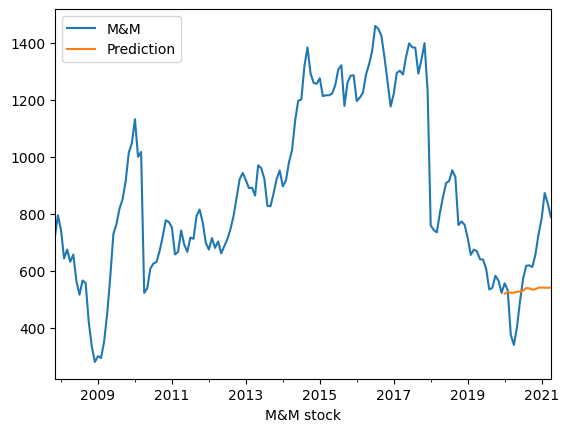

Results of sklearn.metrics:
MAE: 140.1069899475498
RMSE: 170.04256499183342
R-Squared: -0.17275327344180202
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=inf, Time=0.24 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=2035.205, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=2022.450, Time=0.15 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=2015.489, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=2036.882, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=2015.177, Time=0.09 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=2016.046, Time=0.27 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=inf, Time=0.38 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=2016.862, Time=0.14 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=2016.635, Time=0.16 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=2022.616, Time=0.05 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=2018.317, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[12]             : AIC=2015.273, Ti

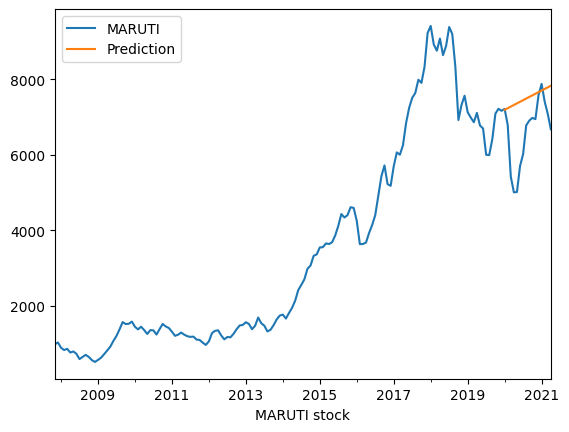

Results of sklearn.metrics:
MAE: 949.3560862627528
RMSE: 1203.9566059425908
R-Squared: -0.9458706819948899
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=2079.447, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=2081.564, Time=0.04 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=2075.502, Time=0.28 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=2076.196, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=2089.218, Time=0.02 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=2080.417, Time=0.07 sec
 ARIMA(1,1,0)(2,0,0)[12] intercept   : AIC=2077.098, Time=0.70 sec
 ARIMA(1,1,0)(1,0,1)[12] intercept   : AIC=2077.272, Time=0.26 sec
 ARIMA(1,1,0)(0,0,1)[12] intercept   : AIC=2075.352, Time=0.14 sec
 ARIMA(1,1,0)(0,0,2)[12] intercept   : AIC=2077.210, Time=0.45 sec
 ARIMA(1,1,0)(1,0,2)[12] intercept   : AIC=2079.222, Time=0.58 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=2077.532, Time=0.09 sec
 ARIMA(2,1,0)(0,0,1)[12] intercept   : AIC=207

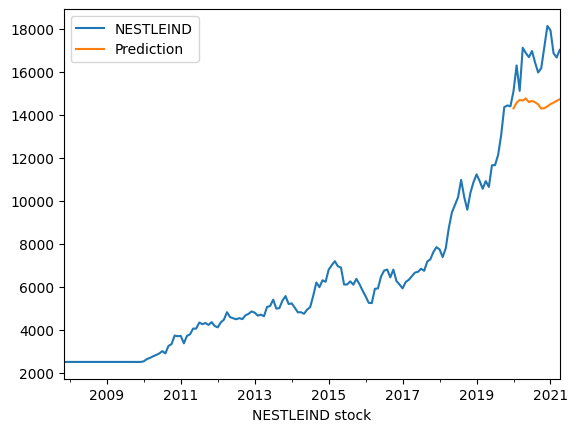

Results of sklearn.metrics:
MAE: 2111.9252600204713
RMSE: 2261.298105619168
R-Squared: -6.941612169634544
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1049.277, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1045.371, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1048.838, Time=0.11 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1048.349, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1044.628, Time=0.02 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=1047.311, Time=0.07 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=1047.316, Time=0.06 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1046.860, Time=0.04 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1046.360, Time=0.07 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1046.147, Time=0.09 sec

Best model:  ARIMA(0,1,0)(0,0,0)[12]          
Total fit time: 0.866 seconds
Axes(0.125,0.11;0.775x0.77)


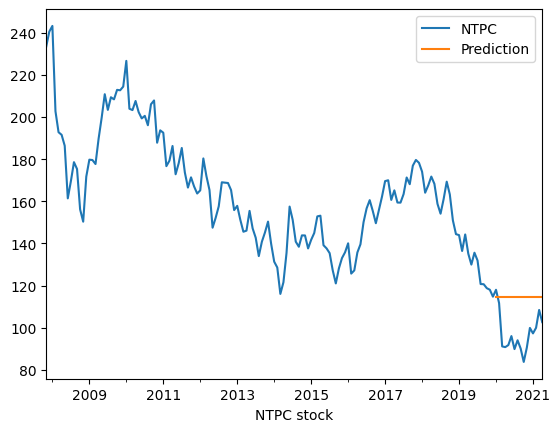

Results of sklearn.metrics:
MAE: 17.90281170647304
RMSE: 19.61872402579189
R-Squared: -3.8825394539048803
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1665.447, Time=0.49 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1662.744, Time=0.04 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1642.313, Time=0.26 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1636.271, Time=0.37 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1662.082, Time=0.04 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1634.289, Time=0.17 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1636.271, Time=0.41 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=1637.812, Time=0.81 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1636.113, Time=0.13 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=1636.060, Time=0.16 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1640.341, Time=0.07 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=1637.500, Time=0.18 sec
 ARIMA(0,1,1)(0,0,0)[12]             : AIC=1633

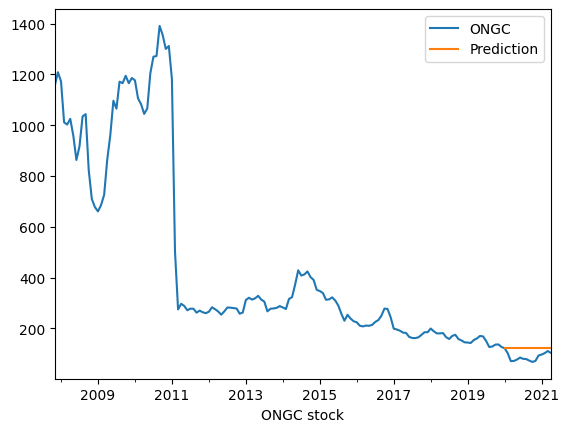

Results of sklearn.metrics:
MAE: 34.24027257952002
RMSE: 37.81657668818845
R-Squared: -4.549510971000029
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=954.532, Time=0.22 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=956.341, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=951.111, Time=0.27 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=948.118, Time=0.28 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=954.616, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=949.926, Time=0.05 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=950.051, Time=0.50 sec
 ARIMA(0,1,1)(0,0,2)[12] intercept   : AIC=950.112, Time=0.58 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=948.157, Time=0.30 sec
 ARIMA(0,1,1)(1,0,2)[12] intercept   : AIC=952.088, Time=0.81 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=952.806, Time=0.08 sec
 ARIMA(1,1,1)(0,0,1)[12] intercept   : AIC=947.684, Time=0.29 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=inf, Time=0.11 se

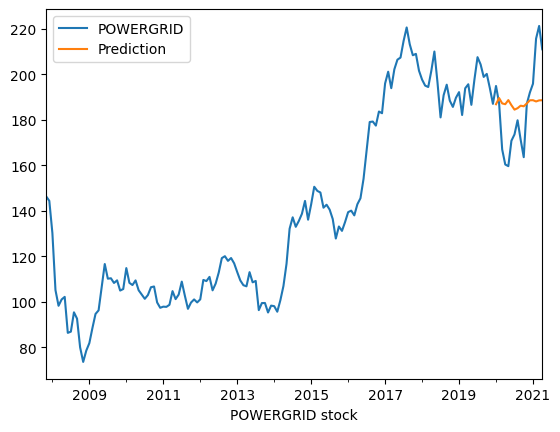

Results of sklearn.metrics:
MAE: 15.560177584857458
RMSE: 18.62381900620497
R-Squared: 0.04264345337344111
Performing stepwise search to minimize aic
 ARIMA(0,0,0)(1,0,1)[12] intercept   : AIC=2186.057, Time=0.30 sec
 ARIMA(0,0,0)(0,0,0)[12] intercept   : AIC=2215.094, Time=0.02 sec
 ARIMA(1,0,0)(1,0,0)[12] intercept   : AIC=1860.747, Time=0.33 sec
 ARIMA(0,0,1)(0,0,1)[12] intercept   : AIC=inf, Time=0.28 sec
 ARIMA(0,0,0)(0,0,0)[12]             : AIC=2502.311, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[12] intercept   : AIC=1858.765, Time=0.08 sec
 ARIMA(1,0,0)(0,0,1)[12] intercept   : AIC=1860.747, Time=0.25 sec
 ARIMA(1,0,0)(1,0,1)[12] intercept   : AIC=inf, Time=0.28 sec
 ARIMA(2,0,0)(0,0,0)[12] intercept   : AIC=1850.492, Time=0.14 sec
 ARIMA(2,0,0)(1,0,0)[12] intercept   : AIC=1852.480, Time=0.39 sec
 ARIMA(2,0,0)(0,0,1)[12] intercept   : AIC=1852.480, Time=0.35 sec
 ARIMA(2,0,0)(1,0,1)[12] intercept   : AIC=inf, Time=0.55 sec
 ARIMA(3,0,0)(0,0,0)[12] intercept   : AIC=1846.342, Time=0.2

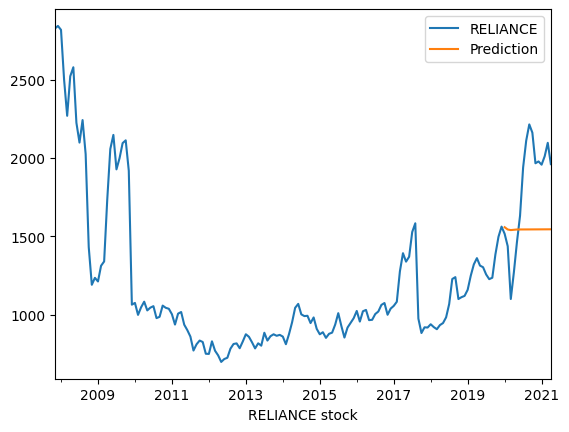

Results of sklearn.metrics:
MAE: 373.37542511916655
RMSE: 420.4606005870221
R-Squared: -0.5885594402568033
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1948.895, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1944.873, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1930.180, Time=0.09 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1924.727, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1943.557, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1922.799, Time=0.09 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1924.741, Time=0.24 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=1926.335, Time=0.48 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1924.783, Time=0.14 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=1924.778, Time=0.15 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1928.205, Time=0.05 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=inf, Time=0.27 sec
 ARIMA(0,1,1)(0,0,0)[12]             : AIC=1921.205

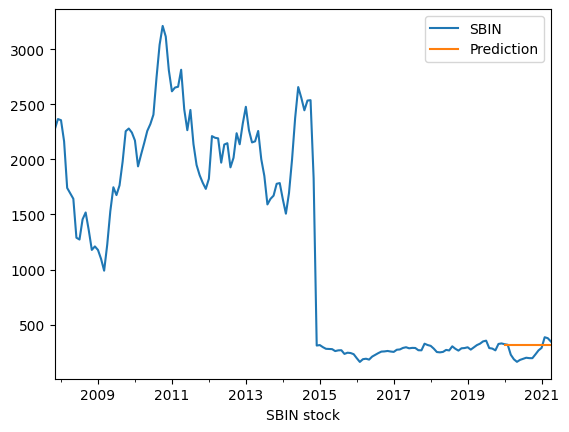

Results of sklearn.metrics:
MAE: 83.9436626832725
RMSE: 97.15855517922354
R-Squared: -0.77729336657104
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=2288.015, Time=0.33 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=2285.683, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=2282.684, Time=0.05 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=2276.705, Time=0.33 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=2289.771, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=2275.248, Time=0.03 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=2276.817, Time=0.19 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=2278.675, Time=0.22 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=2272.113, Time=0.16 sec
 ARIMA(1,1,1)(1,0,0)[12] intercept   : AIC=2274.230, Time=0.33 sec
 ARIMA(1,1,1)(0,0,1)[12] intercept   : AIC=2274.202, Time=0.27 sec
 ARIMA(1,1,1)(1,0,1)[12] intercept   : AIC=2275.929, Time=0.30 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=2281.18

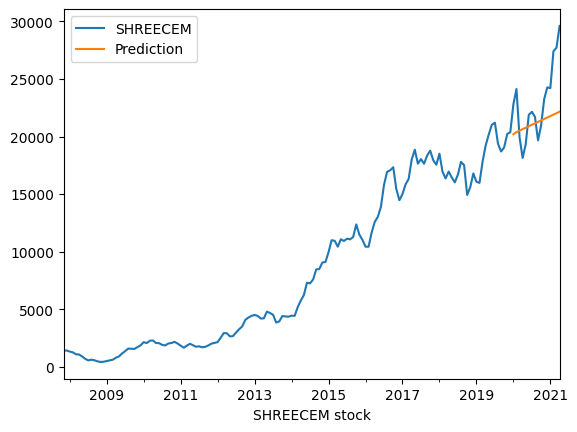

Results of sklearn.metrics:
MAE: 2562.0206032013884
RMSE: 3246.708912811358
R-Squared: -0.08704073279912339
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=inf, Time=0.28 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1853.466, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1856.144, Time=0.11 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1855.882, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1851.621, Time=0.03 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=1855.063, Time=0.05 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=1855.096, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1854.468, Time=0.03 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1854.168, Time=0.05 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1854.823, Time=0.12 sec

Best model:  ARIMA(0,1,0)(0,0,0)[12]          
Total fit time: 0.967 seconds
Axes(0.125,0.11;0.775x0.77)


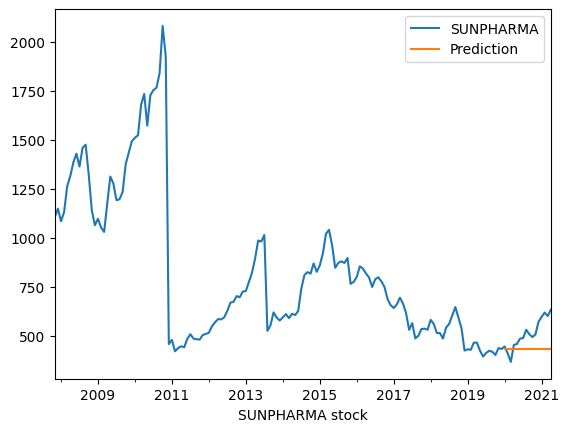

Results of sklearn.metrics:
MAE: 88.79901232154411
RMSE: 107.62875975679425
R-Squared: -1.0888684142187666
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1629.281, Time=0.24 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1630.634, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1603.286, Time=0.12 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1593.240, Time=0.22 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1629.114, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1591.286, Time=0.07 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1593.256, Time=0.21 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=inf, Time=0.56 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1593.286, Time=0.14 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=1593.286, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1601.438, Time=0.06 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=1594.221, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[12]             : AIC=1589.541

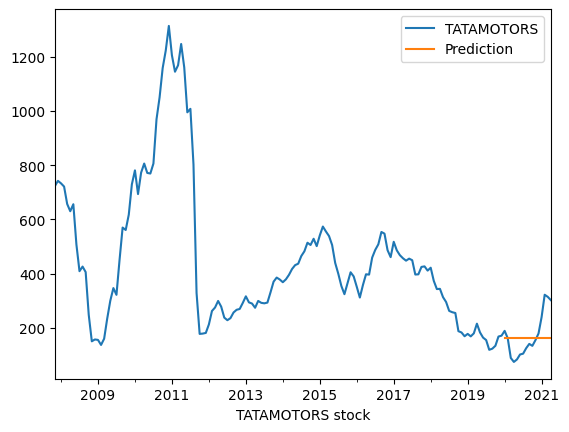

Results of sklearn.metrics:
MAE: 64.00219938046943
RMSE: 80.76393879579646
R-Squared: -0.010072549032188682
Performing stepwise search to minimize aic
 ARIMA(0,0,0)(1,0,1)[12] intercept   : AIC=inf, Time=0.43 sec
 ARIMA(0,0,0)(0,0,0)[12] intercept   : AIC=1884.351, Time=0.02 sec
 ARIMA(1,0,0)(1,0,0)[12] intercept   : AIC=1555.267, Time=0.25 sec
 ARIMA(0,0,1)(0,0,1)[12] intercept   : AIC=1717.061, Time=0.31 sec
 ARIMA(0,0,0)(0,0,0)[12]             : AIC=2225.696, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[12] intercept   : AIC=1555.523, Time=0.07 sec
 ARIMA(1,0,0)(2,0,0)[12] intercept   : AIC=1545.107, Time=0.52 sec
 ARIMA(1,0,0)(2,0,1)[12] intercept   : AIC=1546.907, Time=1.04 sec
 ARIMA(1,0,0)(1,0,1)[12] intercept   : AIC=1550.041, Time=0.43 sec
 ARIMA(0,0,0)(2,0,0)[12] intercept   : AIC=1880.944, Time=0.76 sec
 ARIMA(2,0,0)(2,0,0)[12] intercept   : AIC=1535.032, Time=0.79 sec
 ARIMA(2,0,0)(1,0,0)[12] intercept   : AIC=1541.597, Time=0.30 sec
 ARIMA(2,0,0)(2,0,1)[12] intercept   : AIC=1536.30

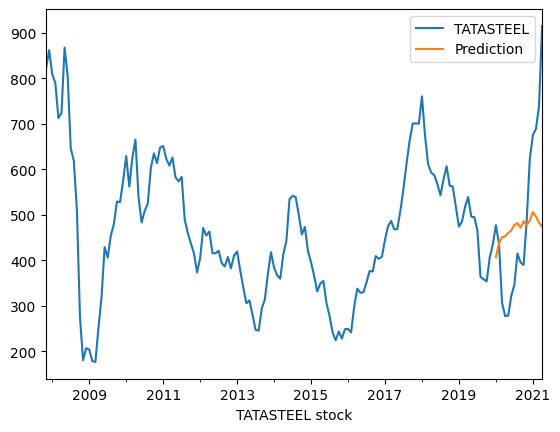

Results of sklearn.metrics:
MAE: 143.17050997453103
RMSE: 175.2626104179269
R-Squared: 0.08003772395037279
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1891.612, Time=0.63 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1888.604, Time=0.03 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1889.184, Time=0.11 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1888.380, Time=0.29 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1886.951, Time=0.04 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=1890.292, Time=0.08 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=1890.249, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1887.360, Time=0.10 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1886.558, Time=0.17 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1888.399, Time=0.46 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=1889.691, Time=0.59 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1887.733, Time=0.11 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=188

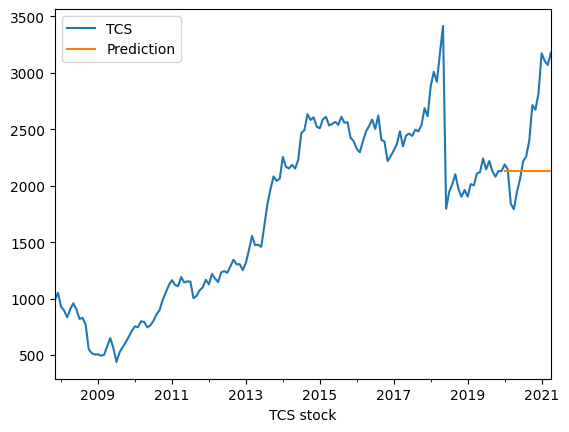

Results of sklearn.metrics:
MAE: 455.6121589534953
RMSE: 586.3027473797807
R-Squared: -0.5348517424930905
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1879.386, Time=0.13 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1875.543, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1853.492, Time=0.09 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1843.712, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1873.562, Time=0.03 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1841.728, Time=0.06 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1843.717, Time=0.13 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=1845.509, Time=0.31 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1843.650, Time=0.04 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=1843.633, Time=0.08 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1851.495, Time=0.05 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=1845.630, Time=0.18 sec
 ARIMA(0,1,1)(0,0,0)[12]             : AIC=1839

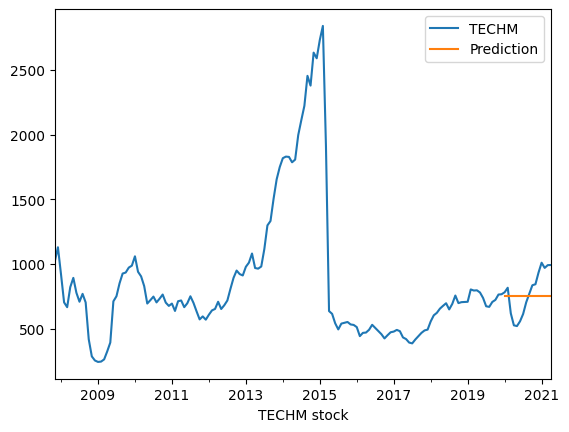

Results of sklearn.metrics:
MAE: 148.98902686772414
RMSE: 169.94642271176332
R-Squared: -0.021539143261047444
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=2056.296, Time=0.12 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=2053.651, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=2047.783, Time=0.08 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=2046.744, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=2051.660, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=2045.897, Time=0.09 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=2046.794, Time=0.15 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=2048.722, Time=0.33 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=2047.915, Time=0.04 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=2047.834, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=2046.730, Time=0.05 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=inf, Time=0.21 sec
 ARIMA(0,1,1)(0,0,0)[12]             : AIC=2043.

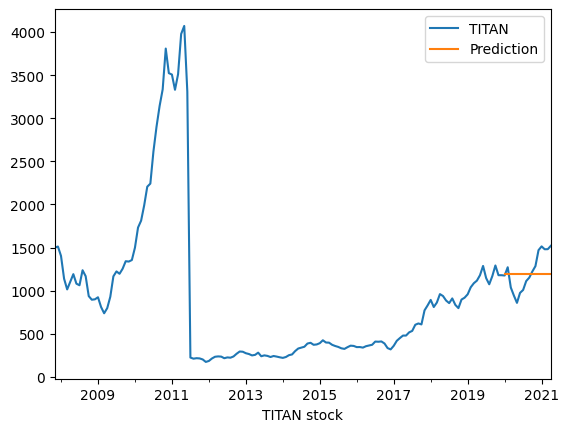

Results of sklearn.metrics:
MAE: 186.49126310093416
RMSE: 218.0562438909086
R-Squared: -0.020206189860461965
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1867.234, Time=0.34 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1872.415, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1864.454, Time=0.25 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1864.568, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1873.276, Time=0.02 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1871.428, Time=0.03 sec
 ARIMA(1,1,0)(2,0,0)[12] intercept   : AIC=1866.416, Time=0.56 sec
 ARIMA(1,1,0)(1,0,1)[12] intercept   : AIC=1866.425, Time=0.39 sec
 ARIMA(1,1,0)(0,0,1)[12] intercept   : AIC=1865.263, Time=0.12 sec
 ARIMA(1,1,0)(2,0,1)[12] intercept   : AIC=1868.379, Time=0.51 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : AIC=1865.269, Time=0.15 sec
 ARIMA(2,1,0)(1,0,0)[12] intercept   : AIC=1863.117, Time=0.31 sec
 ARIMA(2,1,0)(0,0,0)[12] intercept   : AIC=1

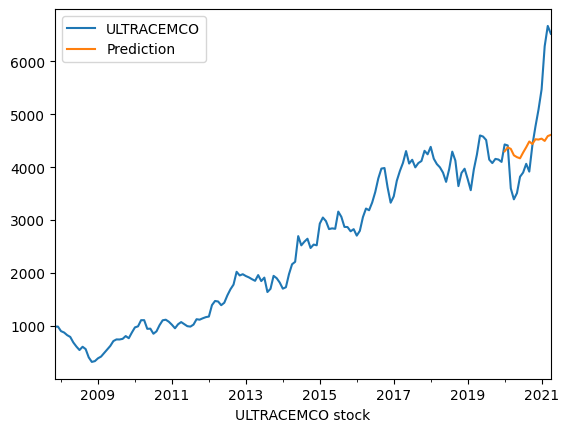

Results of sklearn.metrics:
MAE: 723.369969739771
RMSE: 962.764463361925
R-Squared: 0.14746076732188917
Performing stepwise search to minimize aic
 ARIMA(0,0,0)(1,0,1)[12] intercept   : AIC=inf, Time=0.50 sec
 ARIMA(0,0,0)(0,0,0)[12] intercept   : AIC=1557.076, Time=0.02 sec
 ARIMA(1,0,0)(1,0,0)[12] intercept   : AIC=1255.016, Time=0.24 sec
 ARIMA(0,0,1)(0,0,1)[12] intercept   : AIC=1386.570, Time=0.18 sec
 ARIMA(0,0,0)(0,0,0)[12]             : AIC=1919.209, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[12] intercept   : AIC=1256.739, Time=0.09 sec
 ARIMA(1,0,0)(2,0,0)[12] intercept   : AIC=1256.949, Time=0.95 sec
 ARIMA(1,0,0)(1,0,1)[12] intercept   : AIC=1256.808, Time=0.50 sec
 ARIMA(1,0,0)(0,0,1)[12] intercept   : AIC=1254.811, Time=0.15 sec
 ARIMA(1,0,0)(0,0,2)[12] intercept   : AIC=1256.809, Time=0.52 sec
 ARIMA(1,0,0)(1,0,2)[12] intercept   : AIC=inf, Time=0.69 sec
 ARIMA(0,0,0)(0,0,1)[12] intercept   : AIC=1547.112, Time=0.14 sec
 ARIMA(2,0,0)(0,0,1)[12] intercept   : AIC=1233.415, Time=0

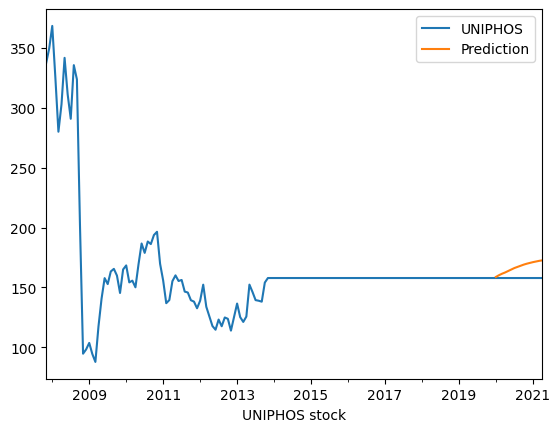

Results of sklearn.metrics:
MAE: 9.023521050811555
RMSE: 10.015718592748998
R-Squared: 0.0
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1488.256, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1486.290, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1482.110, Time=0.16 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1479.845, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1485.028, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1478.240, Time=0.07 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1479.783, Time=0.19 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=1481.173, Time=0.36 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1475.931, Time=0.09 sec
 ARIMA(1,1,1)(1,0,0)[12] intercept   : AIC=1477.478, Time=0.29 sec
 ARIMA(1,1,1)(0,0,1)[12] intercept   : AIC=1477.590, Time=0.35 sec
 ARIMA(1,1,1)(1,0,1)[12] intercept   : AIC=1478.107, Time=0.42 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1480.594, Time=0.05

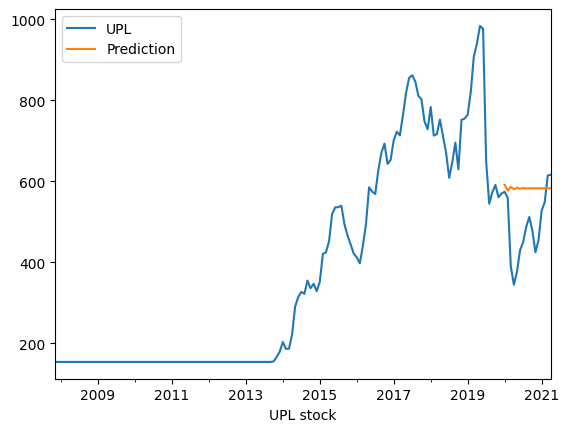

Results of sklearn.metrics:
MAE: 104.53693401764255
RMSE: 125.41150822045064
R-Squared: -1.4392515159996866
Performing stepwise search to minimize aic
 ARIMA(0,0,0)(1,0,1)[12] intercept   : AIC=2364.244, Time=0.40 sec
 ARIMA(0,0,0)(0,0,0)[12] intercept   : AIC=2362.825, Time=0.02 sec
 ARIMA(1,0,0)(1,0,0)[12] intercept   : AIC=1991.774, Time=0.17 sec
 ARIMA(0,0,1)(0,0,1)[12] intercept   : AIC=2209.858, Time=0.33 sec
 ARIMA(0,0,0)(0,0,0)[12]             : AIC=2397.691, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[12] intercept   : AIC=1990.191, Time=0.05 sec
 ARIMA(1,0,0)(0,0,1)[12] intercept   : AIC=1991.716, Time=0.19 sec
 ARIMA(1,0,0)(1,0,1)[12] intercept   : AIC=1993.715, Time=0.21 sec
 ARIMA(2,0,0)(0,0,0)[12] intercept   : AIC=1959.418, Time=0.13 sec
 ARIMA(2,0,0)(1,0,0)[12] intercept   : AIC=1961.402, Time=0.24 sec
 ARIMA(2,0,0)(0,0,1)[12] intercept   : AIC=1961.398, Time=0.25 sec
 ARIMA(2,0,0)(1,0,1)[12] intercept   : AIC=1963.400, Time=0.33 sec
 ARIMA(3,0,0)(0,0,0)[12] intercept   : AIC=19

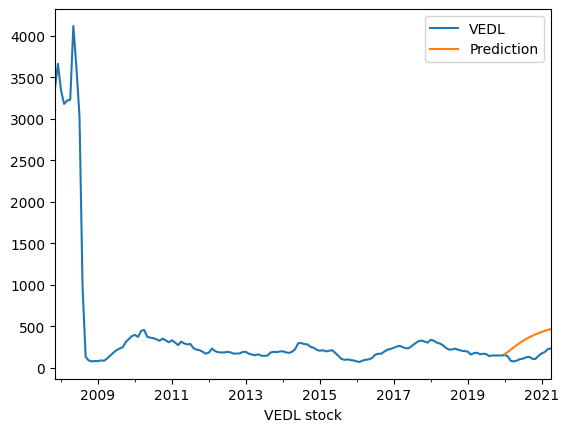

Results of sklearn.metrics:
MAE: 203.4656897369877
RMSE: 217.51169437708145
R-Squared: -21.393181666161784
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=1471.525, Time=0.42 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1467.599, Time=0.03 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1457.413, Time=0.30 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1455.584, Time=0.43 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1465.813, Time=0.04 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1453.599, Time=0.16 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1455.586, Time=0.34 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=1457.428, Time=0.36 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1455.598, Time=0.09 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=1455.598, Time=0.10 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1455.655, Time=0.06 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=1457.598, Time=0.10 sec
 ARIMA(0,1,1)(0,0,0)[12]             : AIC=145

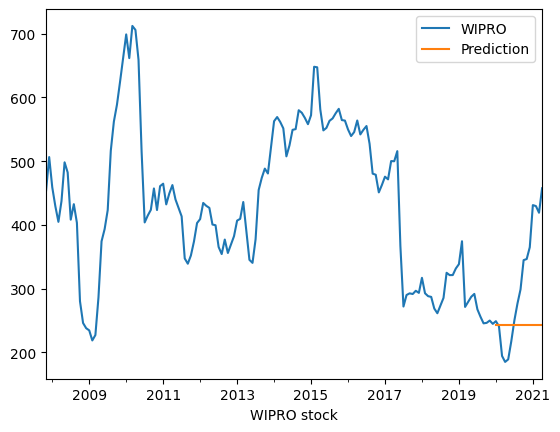

Results of sklearn.metrics:
MAE: 86.54182048911093
RMSE: 111.0559580906478
R-Squared: -0.47964588748477843
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[12] intercept   : AIC=inf, Time=0.40 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1320.233, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1314.310, Time=0.14 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1313.891, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1318.233, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=1311.984, Time=0.07 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : AIC=1313.903, Time=0.12 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=inf, Time=0.51 sec
 ARIMA(1,1,1)(0,0,0)[12] intercept   : AIC=1313.918, Time=0.07 sec
 ARIMA(0,1,2)(0,0,0)[12] intercept   : AIC=1313.904, Time=0.08 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1312.345, Time=0.10 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=1315.365, Time=0.17 sec
 ARIMA(0,1,1)(0,0,0)[12]             : AIC=1309.984, Tim

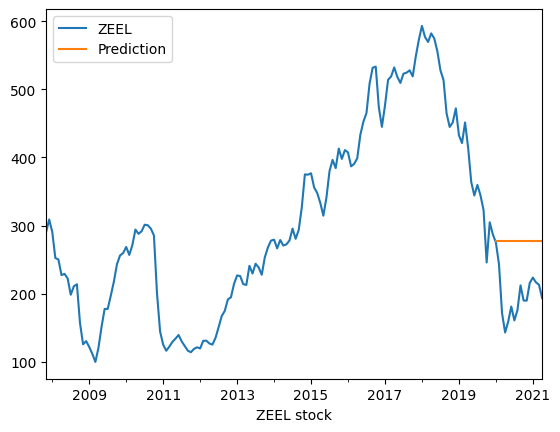

Results of sklearn.metrics:
MAE: 79.13359669834527
RMSE: 85.71318854479398
R-Squared: -5.773542600538558


In [ ]:
for i in train.columns:
    model = pm.auto_arima(train[i],
                        m=12, seasonal=True,
                      start_p=0, start_q=0, max_order=4, test='adf',error_action='ignore',
                           suppress_warnings=True,
                      stepwise=True, trace=True)
    model.fit(train[i])
    forecast=model.predict(n_periods=16, return_conf_int=True)
    forecast_df = pd.DataFrame(forecast[0],index = test.index,columns=['Prediction'])

    mae = metrics.mean_absolute_error(test[i], forecast_df)
    mse = metrics.mean_squared_error(test[i], forecast_df)
    rmse = np.sqrt(mse)
    r2 = metrics.r2_score(test[i],forecast_df['Prediction'])
    print(pd.concat([df[i],forecast_df],axis=1).plot())
    plt.plot(df[i])
    plt.plot(forecast_df)
    plt.xlabel(i+' stock')
    plt.show()

    print("Results of sklearn.metrics:")
    print("MAE:",mae)
    print("RMSE:", rmse)
    print("R-Squared:", r2)







# RNN

In [ ]:
def create_dataset(dataset, time_step=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-time_step-1):
        a = dataset[i:(i+time_step), 0]   ###i=0, 0,1,2,3-----99   100
        dataX.append(a)
        dataY.append(dataset[i + time_step, 0])
    return numpy.array(dataX), numpy.array(dataY)


In [ ]:
# ... (other code)

# define create_dataset function here
def create_dataset(dataset, time_step=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-time_step-1):
        a = dataset[i:(i+time_step), 0]   ###i=0, 0,1,2,3-----99   100
        dataX.append(a)
        dataY.append(dataset[i + time_step, 0])
    return numpy.array(dataX), numpy.array(dataY)

# ... (other code)

for i in df.columns:
    scaler = MinMaxScaler(feature_range=(0, 1))
    df1 = scaler.fit_transform(np.array(df[i]).reshape(-1, 1))

    train_data, test_data = df1[0:129], df1[129:len(df)]

    time_step = 3
    X_train, y_train = create_dataset(train_data, time_step)
    X_test, y_test = create_dataset(test_data, time_step)

# ... (continue with the rest of the code)


Epoch 1/20
2/2 [==============================] - 4s 610ms/step - loss: 0.1390 - val_loss: 0.0087
Epoch 2/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0388 - val_loss: 0.0648
Epoch 3/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0619 - val_loss: 0.0363
Epoch 4/20
2/2 [==============================] - 0s 61ms/step - loss: 0.0271 - val_loss: 0.0065
Epoch 5/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0096 - val_loss: 0.0155
Epoch 6/20
2/2 [==============================] - 0s 28ms/step - loss: 0.0179 - val_loss: 0.0250
Epoch 7/20
2/2 [==============================] - 0s 28ms/step - loss: 0.0248 - val_loss: 0.0183
Epoch 8/20
2/2 [==============================] - 0s 28ms/step - loss: 0.0190 - val_loss: 0.0079
Epoch 9/20
2/2 [==============================] - 0s 32ms/step - loss: 0.0109 - val_loss: 0.0061
Epoch 10/20
2/2 [==============================] - 0s 29ms/step - loss: 0.0091 - val_loss: 0.0109
Epoch 11/20
2/2 [===========

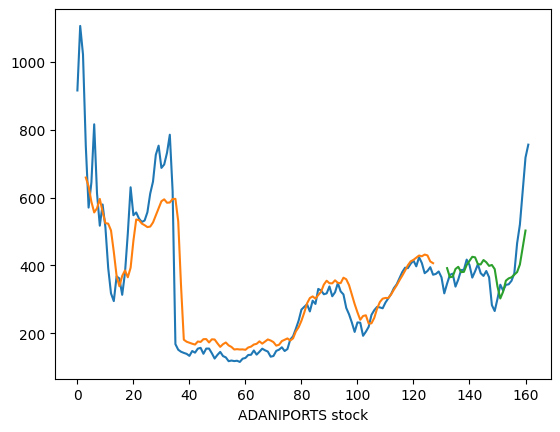

Epoch 1/20
2/2 [==============================] - 4s 884ms/step - loss: 0.2324 - val_loss: 0.0494
Epoch 2/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0859 - val_loss: 0.1653
Epoch 3/20
2/2 [==============================] - 0s 45ms/step - loss: 0.1211 - val_loss: 0.0953
Epoch 4/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0597 - val_loss: 0.0119
Epoch 5/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0160 - val_loss: 0.0086
Epoch 6/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0367 - val_loss: 0.0275
Epoch 7/20
2/2 [==============================] - 0s 49ms/step - loss: 0.0473 - val_loss: 0.0128
Epoch 8/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0279 - val_loss: 0.0014
Epoch 9/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0162 - val_loss: 0.0131
Epoch 10/20
2/2 [==============================] - 0s 63ms/step - loss: 0.0209 - val_loss: 0.0278
Epoch 11/20
2/2 [===========

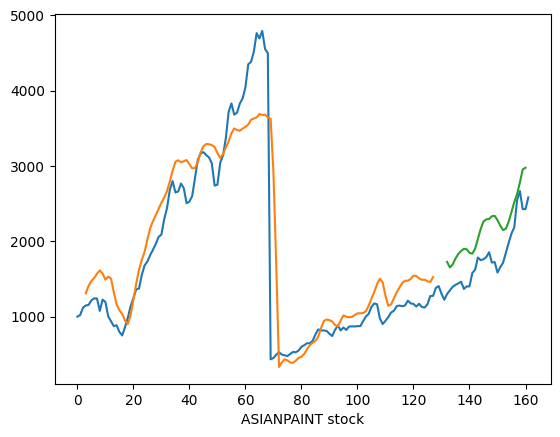

Epoch 1/20
2/2 [==============================] - 3s 552ms/step - loss: 0.4731 - val_loss: 0.0346
Epoch 2/20
2/2 [==============================] - 0s 34ms/step - loss: 0.1692 - val_loss: 0.0297
Epoch 3/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0673 - val_loss: 0.1488
Epoch 4/20
2/2 [==============================] - 0s 59ms/step - loss: 0.1023 - val_loss: 0.1920
Epoch 5/20
2/2 [==============================] - 0s 45ms/step - loss: 0.1137 - val_loss: 0.1440
Epoch 6/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0747 - val_loss: 0.0710
Epoch 7/20
2/2 [==============================] - 0s 58ms/step - loss: 0.0425 - val_loss: 0.0238
Epoch 8/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0390 - val_loss: 0.0060
Epoch 9/20
2/2 [==============================] - 0s 27ms/step - loss: 0.0428 - val_loss: 0.0025
Epoch 10/20
2/2 [==============================] - 0s 27ms/step - loss: 0.0422 - val_loss: 0.0028
Epoch 11/20
2/2 [===========

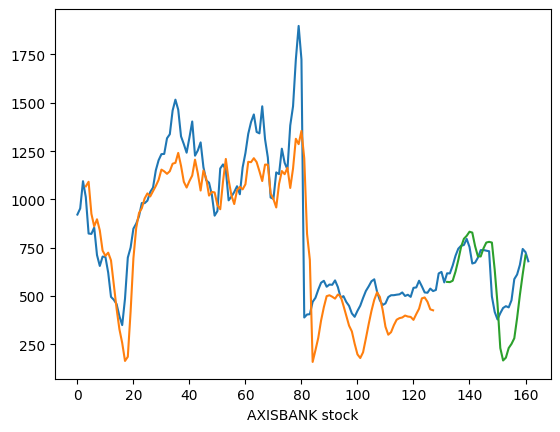

Epoch 1/20
2/2 [==============================] - 3s 390ms/step - loss: 0.0236 - val_loss: 0.0574
Epoch 2/20
2/2 [==============================] - 0s 31ms/step - loss: 0.0172 - val_loss: 0.0093
Epoch 3/20
2/2 [==============================] - 0s 25ms/step - loss: 0.0105 - val_loss: 0.0086
Epoch 4/20
2/2 [==============================] - 0s 26ms/step - loss: 0.0111 - val_loss: 0.0166
Epoch 5/20
2/2 [==============================] - 0s 26ms/step - loss: 0.0059 - val_loss: 0.0404
Epoch 6/20
2/2 [==============================] - 0s 26ms/step - loss: 0.0102 - val_loss: 0.0299
Epoch 7/20
2/2 [==============================] - 0s 31ms/step - loss: 0.0057 - val_loss: 0.0124
Epoch 8/20
2/2 [==============================] - 0s 27ms/step - loss: 0.0063 - val_loss: 0.0093
Epoch 9/20
2/2 [==============================] - 0s 33ms/step - loss: 0.0070 - val_loss: 0.0128
Epoch 10/20
2/2 [==============================] - 0s 28ms/step - loss: 0.0047 - val_loss: 0.0224
Epoch 11/20
2/2 [===========

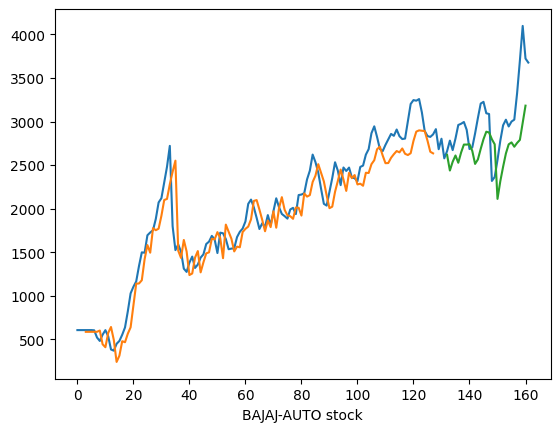

Epoch 1/20
2/2 [==============================] - 4s 553ms/step - loss: 0.0522 - val_loss: 0.0753
Epoch 2/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0228 - val_loss: 0.0483
Epoch 3/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0241 - val_loss: 0.0369
Epoch 4/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0043 - val_loss: 0.0958
Epoch 5/20
2/2 [==============================] - 0s 59ms/step - loss: 0.0057 - val_loss: 0.1484
Epoch 6/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0117 - val_loss: 0.1058
Epoch 7/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0067 - val_loss: 0.0442
Epoch 8/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0024 - val_loss: 0.0358
Epoch 9/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0048 - val_loss: 0.0413
Epoch 10/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0064 - val_loss: 0.0341
Epoch 11/20
2/2 [===========

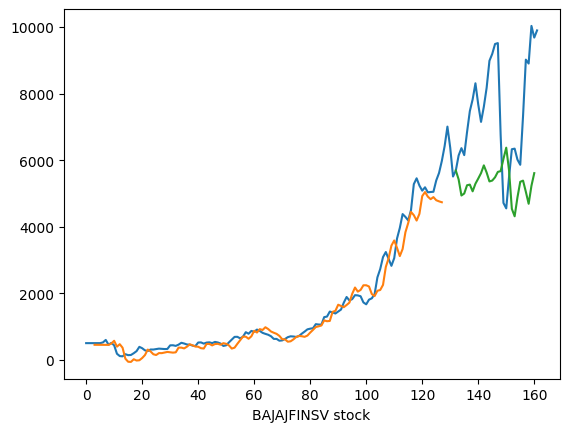

Epoch 1/20
2/2 [==============================] - 3s 397ms/step - loss: 0.0475 - val_loss: 0.0515
Epoch 2/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0447 - val_loss: 0.0159
Epoch 3/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0224 - val_loss: 0.0548
Epoch 4/20
2/2 [==============================] - 0s 33ms/step - loss: 0.0285 - val_loss: 0.0157
Epoch 5/20
2/2 [==============================] - 0s 30ms/step - loss: 0.0165 - val_loss: 0.0126
Epoch 6/20
2/2 [==============================] - 0s 32ms/step - loss: 0.0215 - val_loss: 0.0085
Epoch 7/20
2/2 [==============================] - 0s 32ms/step - loss: 0.0138 - val_loss: 0.0157
Epoch 8/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0135 - val_loss: 0.0279
Epoch 9/20
2/2 [==============================] - 0s 33ms/step - loss: 0.0152 - val_loss: 0.0125
Epoch 10/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0110 - val_loss: 0.0075
Epoch 11/20
2/2 [===========

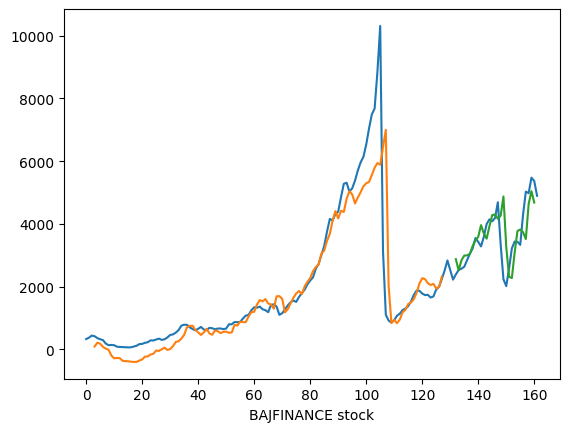

Epoch 1/20
2/2 [==============================] - 3s 393ms/step - loss: 0.0669 - val_loss: 0.0072
Epoch 2/20
2/2 [==============================] - 0s 34ms/step - loss: 0.0222 - val_loss: 0.0306
Epoch 3/20
2/2 [==============================] - 0s 33ms/step - loss: 0.0374 - val_loss: 0.0234
Epoch 4/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0241 - val_loss: 0.0080
Epoch 5/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0114 - val_loss: 0.0083
Epoch 6/20
2/2 [==============================] - 0s 32ms/step - loss: 0.0121 - val_loss: 0.0165
Epoch 7/20
2/2 [==============================] - 0s 30ms/step - loss: 0.0173 - val_loss: 0.0169
Epoch 8/20
2/2 [==============================] - 0s 34ms/step - loss: 0.0157 - val_loss: 0.0103
Epoch 9/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0113 - val_loss: 0.0060
Epoch 10/20
2/2 [==============================] - 0s 34ms/step - loss: 0.0081 - val_loss: 0.0066
Epoch 11/20
2/2 [===========

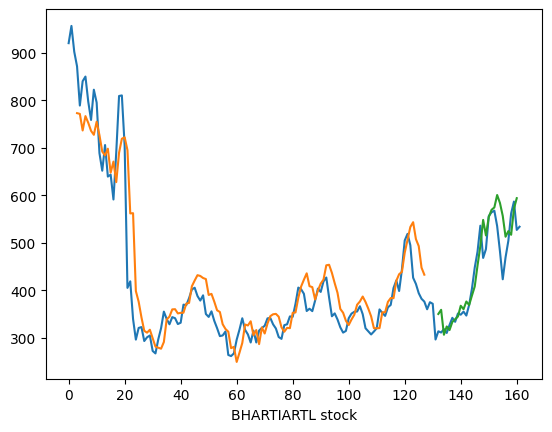

Epoch 1/20
2/2 [==============================] - 3s 411ms/step - loss: 0.4971 - val_loss: 0.0109
Epoch 2/20
2/2 [==============================] - 0s 38ms/step - loss: 0.1435 - val_loss: 0.0217
Epoch 3/20
2/2 [==============================] - 0s 33ms/step - loss: 0.0418 - val_loss: 0.0763
Epoch 4/20
2/2 [==============================] - 0s 34ms/step - loss: 0.0560 - val_loss: 0.1209
Epoch 5/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0759 - val_loss: 0.1371
Epoch 6/20
2/2 [==============================] - 0s 33ms/step - loss: 0.0816 - val_loss: 0.1308
Epoch 7/20
2/2 [==============================] - 0s 34ms/step - loss: 0.0751 - val_loss: 0.1119
Epoch 8/20
2/2 [==============================] - 0s 31ms/step - loss: 0.0639 - val_loss: 0.0877
Epoch 9/20
2/2 [==============================] - 0s 34ms/step - loss: 0.0519 - val_loss: 0.0641
Epoch 10/20
2/2 [==============================] - 0s 29ms/step - loss: 0.0409 - val_loss: 0.0443
Epoch 11/20
2/2 [===========

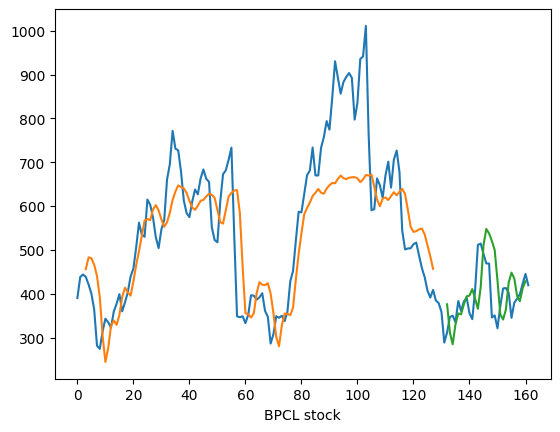

Epoch 1/20
2/2 [==============================] - 3s 394ms/step - loss: 0.8558 - val_loss: 1.1376
Epoch 2/20
2/2 [==============================] - 0s 38ms/step - loss: 0.3559 - val_loss: 0.2334
Epoch 3/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0918 - val_loss: 0.0186
Epoch 4/20
2/2 [==============================] - 0s 35ms/step - loss: 0.1070 - val_loss: 0.1674
Epoch 5/20
2/2 [==============================] - 0s 33ms/step - loss: 0.1748 - val_loss: 0.2089
Epoch 6/20
2/2 [==============================] - 0s 33ms/step - loss: 0.1568 - val_loss: 0.1280
Epoch 7/20
2/2 [==============================] - 0s 48ms/step - loss: 0.0915 - val_loss: 0.0404
Epoch 8/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0378 - val_loss: 0.0088
Epoch 9/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0188 - val_loss: 0.0260
Epoch 10/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0230 - val_loss: 0.0534
Epoch 11/20
2/2 [===========

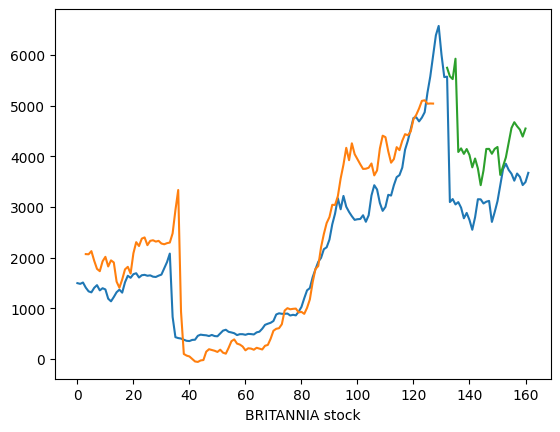

Epoch 1/20
2/2 [==============================] - 3s 389ms/step - loss: 0.3056 - val_loss: 0.0508
Epoch 2/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0215 - val_loss: 0.0517
Epoch 3/20
2/2 [==============================] - 0s 33ms/step - loss: 0.0834 - val_loss: 0.0810
Epoch 4/20
2/2 [==============================] - 0s 33ms/step - loss: 0.1031 - val_loss: 0.0664
Epoch 5/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0800 - val_loss: 0.0393
Epoch 6/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0445 - val_loss: 0.0211
Epoch 7/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0167 - val_loss: 0.0246
Epoch 8/20
2/2 [==============================] - 0s 51ms/step - loss: 0.0077 - val_loss: 0.0476
Epoch 9/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0147 - val_loss: 0.0682
Epoch 10/20
2/2 [==============================] - 0s 33ms/step - loss: 0.0219 - val_loss: 0.0672
Epoch 11/20
2/2 [===========

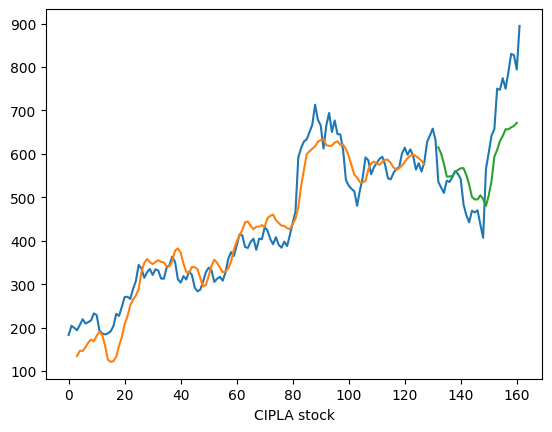

Epoch 1/20
2/2 [==============================] - 3s 406ms/step - loss: 1.9359 - val_loss: 0.0978
Epoch 2/20
2/2 [==============================] - 0s 52ms/step - loss: 0.5643 - val_loss: 0.0246
Epoch 3/20
2/2 [==============================] - 0s 55ms/step - loss: 0.0825 - val_loss: 0.0891
Epoch 4/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0135 - val_loss: 0.1730
Epoch 5/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0242 - val_loss: 0.2390
Epoch 6/20
2/2 [==============================] - 0s 53ms/step - loss: 0.0413 - val_loss: 0.2796
Epoch 7/20
2/2 [==============================] - 0s 34ms/step - loss: 0.0500 - val_loss: 0.2983
Epoch 8/20
2/2 [==============================] - 0s 32ms/step - loss: 0.0497 - val_loss: 0.3004
Epoch 9/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0441 - val_loss: 0.2918
Epoch 10/20
2/2 [==============================] - 0s 52ms/step - loss: 0.0364 - val_loss: 0.2769
Epoch 11/20
2/2 [===========

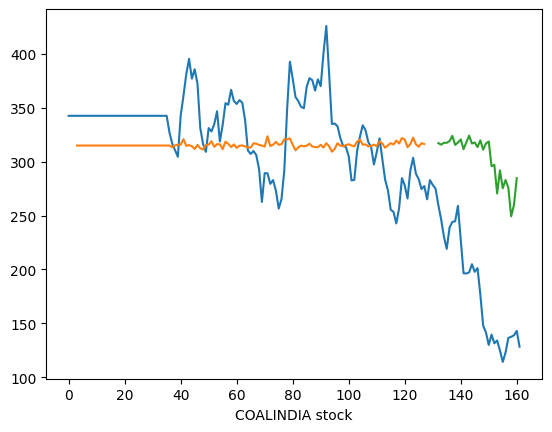

Epoch 1/20
2/2 [==============================] - 4s 430ms/step - loss: 0.0593 - val_loss: 0.0258
Epoch 2/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0425 - val_loss: 0.0263
Epoch 3/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0259 - val_loss: 0.0489
Epoch 4/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0073 - val_loss: 0.1074
Epoch 5/20
2/2 [==============================] - 0s 46ms/step - loss: 0.0212 - val_loss: 0.0960
Epoch 6/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0146 - val_loss: 0.0397
Epoch 7/20
2/2 [==============================] - 0s 49ms/step - loss: 0.0045 - val_loss: 0.0159
Epoch 8/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0092 - val_loss: 0.0137
Epoch 9/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0098 - val_loss: 0.0138
Epoch 10/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0045 - val_loss: 0.0267
Epoch 11/20
2/2 [===========

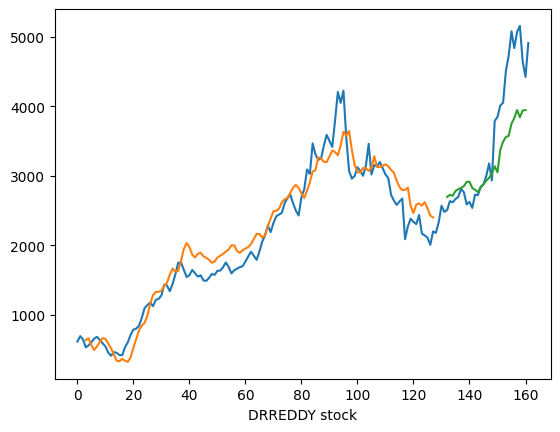

Epoch 1/20
2/2 [==============================] - 4s 691ms/step - loss: 0.1170 - val_loss: 0.1780
Epoch 2/20
2/2 [==============================] - 0s 83ms/step - loss: 0.0191 - val_loss: 0.0576
Epoch 3/20
2/2 [==============================] - 0s 91ms/step - loss: 0.0394 - val_loss: 0.0541
Epoch 4/20
2/2 [==============================] - 0s 90ms/step - loss: 0.0222 - val_loss: 0.0642
Epoch 5/20
2/2 [==============================] - 0s 82ms/step - loss: 0.0071 - val_loss: 0.0988
Epoch 6/20
2/2 [==============================] - 0s 93ms/step - loss: 0.0121 - val_loss: 0.1202
Epoch 7/20
2/2 [==============================] - 0s 89ms/step - loss: 0.0176 - val_loss: 0.1146
Epoch 8/20
2/2 [==============================] - 0s 128ms/step - loss: 0.0147 - val_loss: 0.0948
Epoch 9/20
2/2 [==============================] - 0s 110ms/step - loss: 0.0086 - val_loss: 0.0722
Epoch 10/20
2/2 [==============================] - 0s 119ms/step - loss: 0.0051 - val_loss: 0.0575
Epoch 11/20
2/2 [========

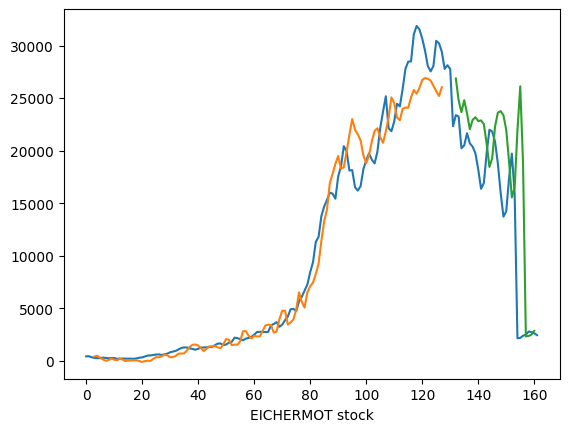

Epoch 1/20
2/2 [==============================] - 3s 395ms/step - loss: 0.5671 - val_loss: 0.0244
Epoch 2/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0330 - val_loss: 0.1188
Epoch 3/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0706 - val_loss: 0.1756
Epoch 4/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0812 - val_loss: 0.1456
Epoch 5/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0311 - val_loss: 0.1048
Epoch 6/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0292 - val_loss: 0.0927
Epoch 7/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0500 - val_loss: 0.0961
Epoch 8/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0421 - val_loss: 0.1098
Epoch 9/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0246 - val_loss: 0.1337
Epoch 10/20
2/2 [==============================] - 0s 34ms/step - loss: 0.0203 - val_loss: 0.1560
Epoch 11/20
2/2 [===========

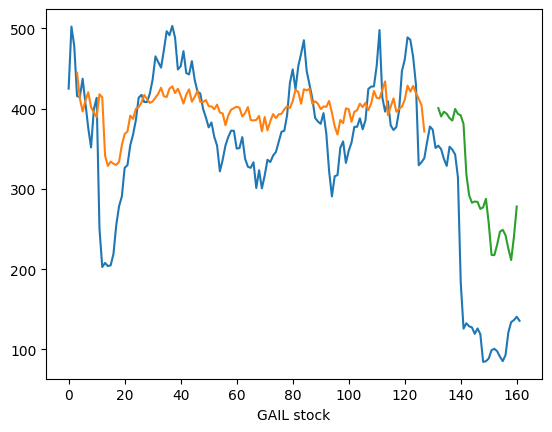

Epoch 1/20
2/2 [==============================] - 5s 591ms/step - loss: 2.4053 - val_loss: 0.0190
Epoch 2/20
2/2 [==============================] - 0s 60ms/step - loss: 0.4571 - val_loss: 0.2380
Epoch 3/20
2/2 [==============================] - 0s 39ms/step - loss: 0.1078 - val_loss: 0.5274
Epoch 4/20
2/2 [==============================] - 0s 41ms/step - loss: 0.2772 - val_loss: 0.6470
Epoch 5/20
2/2 [==============================] - 0s 44ms/step - loss: 0.3504 - val_loss: 0.6099
Epoch 6/20
2/2 [==============================] - 0s 43ms/step - loss: 0.2995 - val_loss: 0.4816
Epoch 7/20
2/2 [==============================] - 0s 58ms/step - loss: 0.2014 - val_loss: 0.3282
Epoch 8/20
2/2 [==============================] - 0s 59ms/step - loss: 0.1142 - val_loss: 0.1913
Epoch 9/20
2/2 [==============================] - 0s 66ms/step - loss: 0.0590 - val_loss: 0.0936
Epoch 10/20
2/2 [==============================] - 0s 59ms/step - loss: 0.0366 - val_loss: 0.0372
Epoch 11/20
2/2 [===========

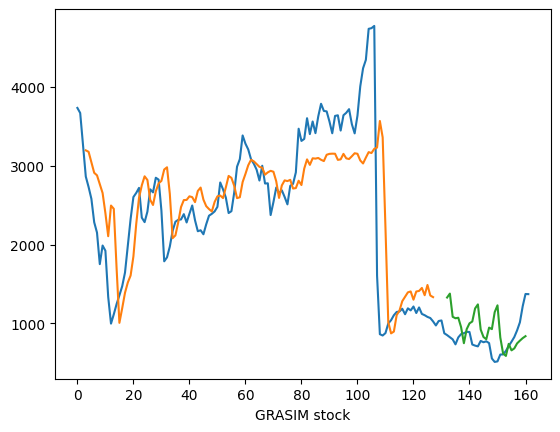

Epoch 1/20
2/2 [==============================] - 4s 427ms/step - loss: 0.0464 - val_loss: 0.0599
Epoch 2/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0357 - val_loss: 0.0140
Epoch 3/20
2/2 [==============================] - 0s 60ms/step - loss: 0.0069 - val_loss: 0.0150
Epoch 4/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0175 - val_loss: 0.0120
Epoch 5/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0087 - val_loss: 0.0087
Epoch 6/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0063 - val_loss: 0.0238
Epoch 7/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0117 - val_loss: 0.0149
Epoch 8/20
2/2 [==============================] - 0s 52ms/step - loss: 0.0065 - val_loss: 0.0056
Epoch 9/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0062 - val_loss: 0.0073
Epoch 10/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0075 - val_loss: 0.0052
Epoch 11/20
2/2 [===========

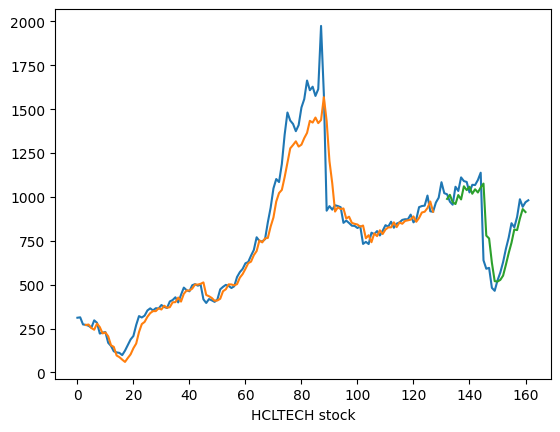

Epoch 1/20
2/2 [==============================] - 4s 529ms/step - loss: 0.4008 - val_loss: 0.1242
Epoch 2/20
2/2 [==============================] - 0s 74ms/step - loss: 0.0681 - val_loss: 0.1191
Epoch 3/20
2/2 [==============================] - 0s 47ms/step - loss: 0.1592 - val_loss: 0.1673
Epoch 4/20
2/2 [==============================] - 0s 38ms/step - loss: 0.1528 - val_loss: 0.0639
Epoch 5/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0689 - val_loss: 0.0305
Epoch 6/20
2/2 [==============================] - 0s 49ms/step - loss: 0.0351 - val_loss: 0.0873
Epoch 7/20
2/2 [==============================] - 0s 67ms/step - loss: 0.0514 - val_loss: 0.1351
Epoch 8/20
2/2 [==============================] - 0s 83ms/step - loss: 0.0666 - val_loss: 0.1286
Epoch 9/20
2/2 [==============================] - 0s 62ms/step - loss: 0.0579 - val_loss: 0.0826
Epoch 10/20
2/2 [==============================] - 0s 67ms/step - loss: 0.0389 - val_loss: 0.0392
Epoch 11/20
2/2 [===========

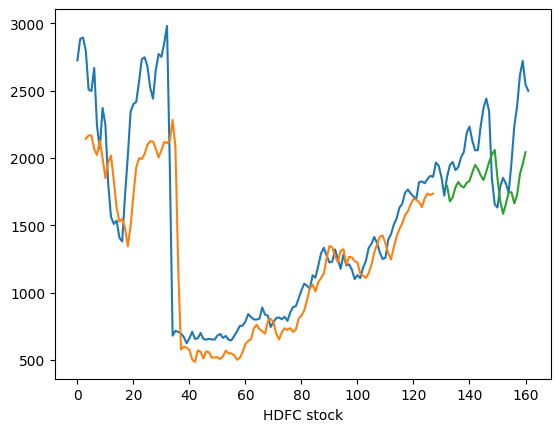

Epoch 1/20
2/2 [==============================] - 3s 403ms/step - loss: 0.9965 - val_loss: 0.6900
Epoch 2/20
2/2 [==============================] - 0s 40ms/step - loss: 0.2808 - val_loss: 0.0920
Epoch 3/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0786 - val_loss: 0.0865
Epoch 4/20
2/2 [==============================] - 0s 38ms/step - loss: 0.1360 - val_loss: 0.1322
Epoch 5/20
2/2 [==============================] - 0s 38ms/step - loss: 0.1788 - val_loss: 0.1429
Epoch 6/20
2/2 [==============================] - 0s 43ms/step - loss: 0.1818 - val_loss: 0.1321
Epoch 7/20
2/2 [==============================] - 0s 38ms/step - loss: 0.1606 - val_loss: 0.1110
Epoch 8/20
2/2 [==============================] - 0s 40ms/step - loss: 0.1294 - val_loss: 0.0875
Epoch 9/20
2/2 [==============================] - 0s 53ms/step - loss: 0.0959 - val_loss: 0.0662
Epoch 10/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0657 - val_loss: 0.0510
Epoch 11/20
2/2 [===========

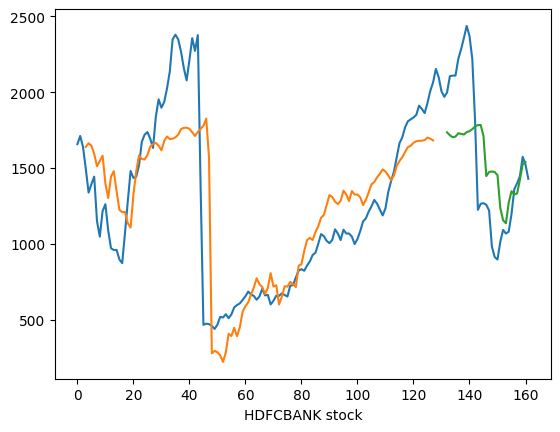

Epoch 1/20
2/2 [==============================] - 4s 431ms/step - loss: 0.2295 - val_loss: 0.1260
Epoch 2/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0735 - val_loss: 0.0307
Epoch 3/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0215 - val_loss: 0.0125
Epoch 4/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0193 - val_loss: 0.0169
Epoch 5/20
2/2 [==============================] - 0s 75ms/step - loss: 0.0272 - val_loss: 0.0220
Epoch 6/20
2/2 [==============================] - 0s 67ms/step - loss: 0.0329 - val_loss: 0.0222
Epoch 7/20
2/2 [==============================] - 0s 64ms/step - loss: 0.0320 - val_loss: 0.0186
Epoch 8/20
2/2 [==============================] - 0s 76ms/step - loss: 0.0270 - val_loss: 0.0141
Epoch 9/20
2/2 [==============================] - 0s 96ms/step - loss: 0.0212 - val_loss: 0.0119
Epoch 10/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0174 - val_loss: 0.0140
Epoch 11/20
2/2 [===========

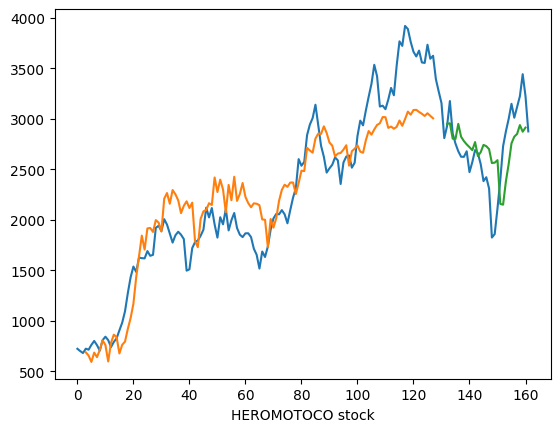

Epoch 1/20
2/2 [==============================] - 3s 405ms/step - loss: 0.0289 - val_loss: 0.0454
Epoch 2/20
2/2 [==============================] - 0s 48ms/step - loss: 0.0257 - val_loss: 0.0255
Epoch 3/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0129 - val_loss: 0.0522
Epoch 4/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0176 - val_loss: 0.0204
Epoch 5/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0087 - val_loss: 0.0224
Epoch 6/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0145 - val_loss: 0.0185
Epoch 7/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0082 - val_loss: 0.0221
Epoch 8/20
2/2 [==============================] - 0s 51ms/step - loss: 0.0094 - val_loss: 0.0308
Epoch 9/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0104 - val_loss: 0.0190
Epoch 10/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0062 - val_loss: 0.0161
Epoch 11/20
2/2 [===========

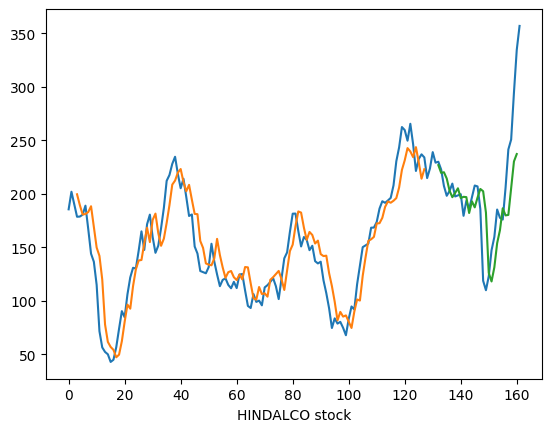

Epoch 1/20
2/2 [==============================] - 3s 415ms/step - loss: 0.0300 - val_loss: 0.2727
Epoch 2/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0099 - val_loss: 0.1229
Epoch 3/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0138 - val_loss: 0.0895
Epoch 4/20
2/2 [==============================] - 0s 46ms/step - loss: 0.0093 - val_loss: 0.0972
Epoch 5/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0031 - val_loss: 0.1166
Epoch 6/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0031 - val_loss: 0.1248
Epoch 7/20
2/2 [==============================] - 0s 62ms/step - loss: 0.0054 - val_loss: 0.1093
Epoch 8/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0049 - val_loss: 0.0837
Epoch 9/20
2/2 [==============================] - 0s 59ms/step - loss: 0.0031 - val_loss: 0.0620
Epoch 10/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0026 - val_loss: 0.0496
Epoch 11/20
2/2 [===========

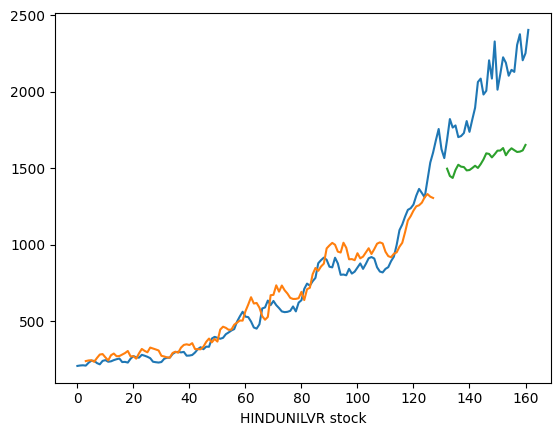

Epoch 1/20
2/2 [==============================] - 3s 404ms/step - loss: 0.4615 - val_loss: 0.0145
Epoch 2/20
2/2 [==============================] - 0s 39ms/step - loss: 0.1261 - val_loss: 0.0087
Epoch 3/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0386 - val_loss: 0.0415
Epoch 4/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0445 - val_loss: 0.0732
Epoch 5/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0648 - val_loss: 0.0862
Epoch 6/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0689 - val_loss: 0.0823
Epoch 7/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0603 - val_loss: 0.0679
Epoch 8/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0472 - val_loss: 0.0510
Epoch 9/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0391 - val_loss: 0.0354
Epoch 10/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0346 - val_loss: 0.0238
Epoch 11/20
2/2 [===========

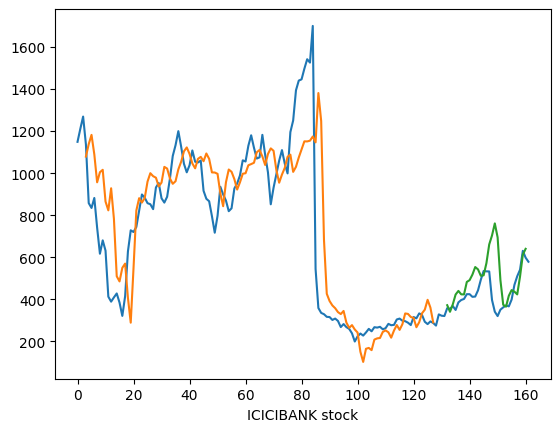

Epoch 1/20
2/2 [==============================] - 4s 588ms/step - loss: 0.0761 - val_loss: 0.0285
Epoch 2/20
2/2 [==============================] - 0s 95ms/step - loss: 0.0298 - val_loss: 0.0855
Epoch 3/20
2/2 [==============================] - 0s 53ms/step - loss: 0.0443 - val_loss: 0.0539
Epoch 4/20
2/2 [==============================] - 0s 70ms/step - loss: 0.0208 - val_loss: 0.0220
Epoch 5/20
2/2 [==============================] - 0s 46ms/step - loss: 0.0059 - val_loss: 0.0230
Epoch 6/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0107 - val_loss: 0.0301
Epoch 7/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0159 - val_loss: 0.0248
Epoch 8/20
2/2 [==============================] - 0s 52ms/step - loss: 0.0118 - val_loss: 0.0193
Epoch 9/20
2/2 [==============================] - 0s 50ms/step - loss: 0.0057 - val_loss: 0.0234
Epoch 10/20
2/2 [==============================] - 0s 74ms/step - loss: 0.0051 - val_loss: 0.0320
Epoch 11/20
2/2 [===========

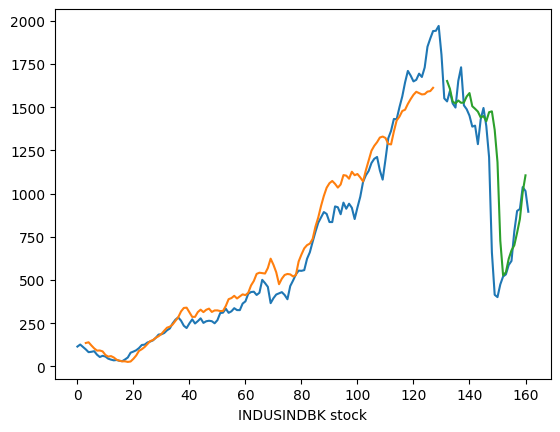

Epoch 1/20
2/2 [==============================] - 3s 427ms/step - loss: 0.1400 - val_loss: 0.0030
Epoch 2/20
2/2 [==============================] - 0s 32ms/step - loss: 0.0482 - val_loss: 0.0146
Epoch 3/20
2/2 [==============================] - 0s 33ms/step - loss: 0.0262 - val_loss: 0.0264
Epoch 4/20
2/2 [==============================] - 0s 68ms/step - loss: 0.0305 - val_loss: 0.0302
Epoch 5/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0363 - val_loss: 0.0258
Epoch 6/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0361 - val_loss: 0.0176
Epoch 7/20
2/2 [==============================] - 0s 59ms/step - loss: 0.0306 - val_loss: 0.0091
Epoch 8/20
2/2 [==============================] - 0s 58ms/step - loss: 0.0220 - val_loss: 0.0036
Epoch 9/20
2/2 [==============================] - 0s 62ms/step - loss: 0.0155 - val_loss: 0.0021
Epoch 10/20
2/2 [==============================] - 0s 48ms/step - loss: 0.0114 - val_loss: 0.0040
Epoch 11/20
2/2 [===========

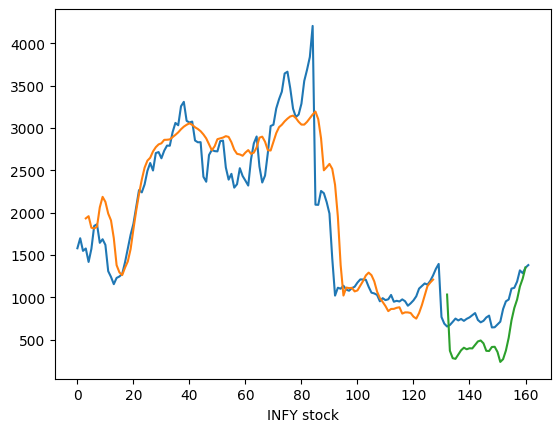

Epoch 1/20
2/2 [==============================] - 3s 416ms/step - loss: 0.2285 - val_loss: 0.0033
Epoch 2/20
2/2 [==============================] - 0s 67ms/step - loss: 0.0360 - val_loss: 0.0251
Epoch 3/20
2/2 [==============================] - 0s 50ms/step - loss: 0.0308 - val_loss: 0.0468
Epoch 4/20
2/2 [==============================] - 0s 55ms/step - loss: 0.0647 - val_loss: 0.0525
Epoch 5/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0680 - val_loss: 0.0449
Epoch 6/20
2/2 [==============================] - 0s 63ms/step - loss: 0.0496 - val_loss: 0.0322
Epoch 7/20
2/2 [==============================] - 0s 78ms/step - loss: 0.0283 - val_loss: 0.0205
Epoch 8/20
2/2 [==============================] - 0s 70ms/step - loss: 0.0196 - val_loss: 0.0122
Epoch 9/20
2/2 [==============================] - 0s 77ms/step - loss: 0.0214 - val_loss: 0.0077
Epoch 10/20
2/2 [==============================] - 0s 68ms/step - loss: 0.0276 - val_loss: 0.0058
Epoch 11/20
2/2 [===========

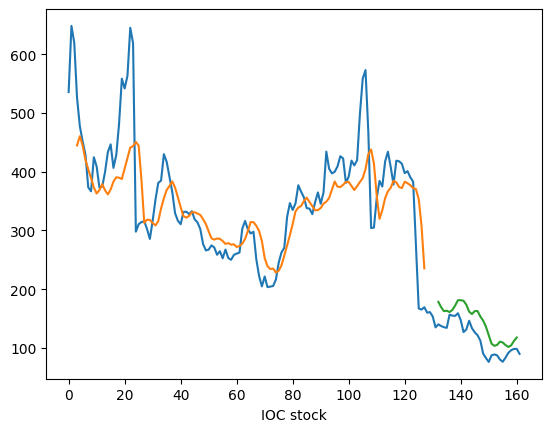

Epoch 1/20
2/2 [==============================] - 3s 396ms/step - loss: 0.0245 - val_loss: 0.0322
Epoch 2/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0177 - val_loss: 0.0102
Epoch 3/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0199 - val_loss: 0.0152
Epoch 4/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0135 - val_loss: 0.0285
Epoch 5/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0174 - val_loss: 0.0251
Epoch 6/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0145 - val_loss: 0.0133
Epoch 7/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0140 - val_loss: 0.0109
Epoch 8/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0148 - val_loss: 0.0137
Epoch 9/20
2/2 [==============================] - 0s 49ms/step - loss: 0.0122 - val_loss: 0.0187
Epoch 10/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0130 - val_loss: 0.0182
Epoch 11/20
2/2 [===========

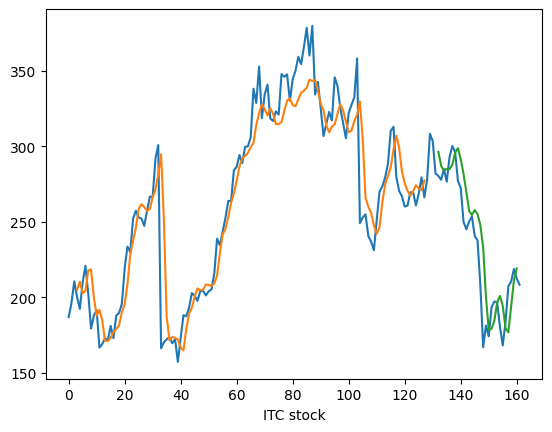

Epoch 1/20
2/2 [==============================] - 3s 426ms/step - loss: 0.0970 - val_loss: 0.0157
Epoch 2/20
2/2 [==============================] - 0s 57ms/step - loss: 0.0464 - val_loss: 0.0031
Epoch 3/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0676 - val_loss: 0.0018
Epoch 4/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0277 - val_loss: 0.0133
Epoch 5/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0503 - val_loss: 0.0078
Epoch 6/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0279 - val_loss: 9.7873e-04
Epoch 7/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0314 - val_loss: 0.0017
Epoch 8/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0288 - val_loss: 0.0013
Epoch 9/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0181 - val_loss: 0.0048
Epoch 10/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0265 - val_loss: 0.0037
Epoch 11/20
2/2 [=======

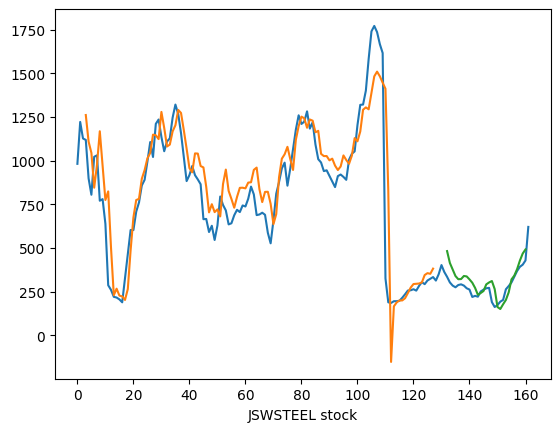

Epoch 1/20
2/2 [==============================] - 3s 398ms/step - loss: 0.0523 - val_loss: 0.0974
Epoch 2/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0365 - val_loss: 0.0536
Epoch 3/20
2/2 [==============================] - 0s 55ms/step - loss: 0.0120 - val_loss: 0.0117
Epoch 4/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0157 - val_loss: 0.0115
Epoch 5/20
2/2 [==============================] - 0s 49ms/step - loss: 0.0149 - val_loss: 0.0292
Epoch 6/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0061 - val_loss: 0.0776
Epoch 7/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0097 - val_loss: 0.0954
Epoch 8/20
2/2 [==============================] - 0s 58ms/step - loss: 0.0099 - val_loss: 0.0691
Epoch 9/20
2/2 [==============================] - 0s 57ms/step - loss: 0.0057 - val_loss: 0.0401
Epoch 10/20
2/2 [==============================] - 0s 50ms/step - loss: 0.0074 - val_loss: 0.0322
Epoch 11/20
2/2 [===========

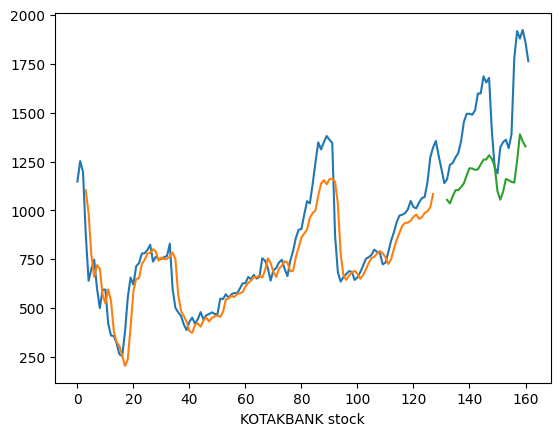

Epoch 1/20
2/2 [==============================] - 3s 423ms/step - loss: 0.0231 - val_loss: 0.0079
Epoch 2/20
2/2 [==============================] - 0s 60ms/step - loss: 0.0143 - val_loss: 0.0084
Epoch 3/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0176 - val_loss: 0.0030
Epoch 4/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0096 - val_loss: 0.0063
Epoch 5/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0119 - val_loss: 0.0025
Epoch 6/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0064 - val_loss: 0.0043
Epoch 7/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0085 - val_loss: 0.0048
Epoch 8/20
2/2 [==============================] - 0s 66ms/step - loss: 0.0069 - val_loss: 0.0020
Epoch 9/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0069 - val_loss: 0.0020
Epoch 10/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0075 - val_loss: 0.0018
Epoch 11/20
2/2 [===========

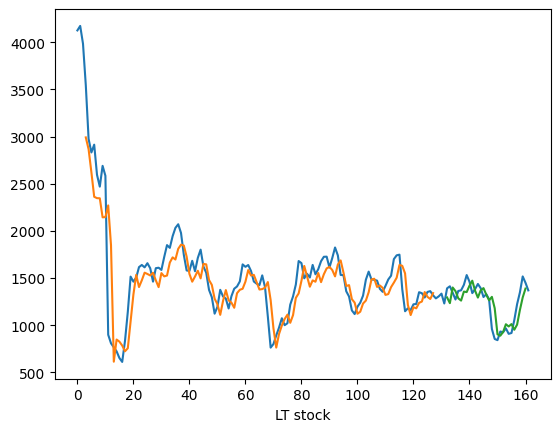

Epoch 1/20
2/2 [==============================] - 5s 414ms/step - loss: 1.9998 - val_loss: 0.3002
Epoch 2/20
2/2 [==============================] - 0s 36ms/step - loss: 0.8349 - val_loss: 0.0339
Epoch 3/20
2/2 [==============================] - 0s 45ms/step - loss: 0.2734 - val_loss: 0.0675
Epoch 4/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0892 - val_loss: 0.2425
Epoch 5/20
2/2 [==============================] - 0s 59ms/step - loss: 0.1333 - val_loss: 0.3847
Epoch 6/20
2/2 [==============================] - 0s 40ms/step - loss: 0.2062 - val_loss: 0.4282
Epoch 7/20
2/2 [==============================] - 0s 40ms/step - loss: 0.2181 - val_loss: 0.3933
Epoch 8/20
2/2 [==============================] - 0s 65ms/step - loss: 0.1826 - val_loss: 0.3143
Epoch 9/20
2/2 [==============================] - 0s 48ms/step - loss: 0.1306 - val_loss: 0.2246
Epoch 10/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0921 - val_loss: 0.1483
Epoch 11/20
2/2 [===========

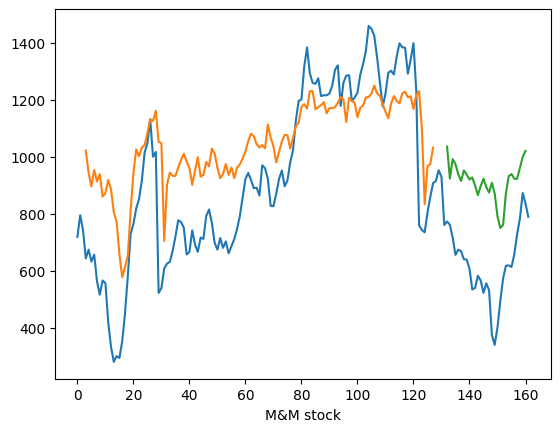

Epoch 1/20
2/2 [==============================] - 3s 402ms/step - loss: 0.0705 - val_loss: 0.0058
Epoch 2/20
2/2 [==============================] - 0s 59ms/step - loss: 0.0321 - val_loss: 0.0698
Epoch 3/20
2/2 [==============================] - 0s 59ms/step - loss: 0.0460 - val_loss: 0.0513
Epoch 4/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0199 - val_loss: 0.0104
Epoch 5/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0037 - val_loss: 0.0101
Epoch 6/20
2/2 [==============================] - 0s 51ms/step - loss: 0.0122 - val_loss: 0.0229
Epoch 7/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0183 - val_loss: 0.0112
Epoch 8/20
2/2 [==============================] - 0s 59ms/step - loss: 0.0113 - val_loss: 0.0059
Epoch 9/20
2/2 [==============================] - 0s 48ms/step - loss: 0.0046 - val_loss: 0.0197
Epoch 10/20
2/2 [==============================] - 0s 54ms/step - loss: 0.0066 - val_loss: 0.0318
Epoch 11/20
2/2 [===========

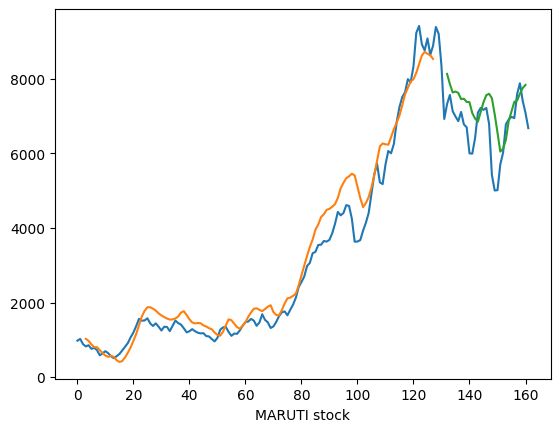

Epoch 1/20
2/2 [==============================] - 3s 425ms/step - loss: 0.0906 - val_loss: 0.1075
Epoch 2/20
2/2 [==============================] - 0s 49ms/step - loss: 0.0145 - val_loss: 0.0082
Epoch 3/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0392 - val_loss: 0.0083
Epoch 4/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0223 - val_loss: 0.0083
Epoch 5/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0032 - val_loss: 0.0228
Epoch 6/20
2/2 [==============================] - 0s 61ms/step - loss: 0.0046 - val_loss: 0.0303
Epoch 7/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0104 - val_loss: 0.0204
Epoch 8/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0091 - val_loss: 0.0066
Epoch 9/20
2/2 [==============================] - 0s 56ms/step - loss: 0.0040 - val_loss: 0.0048
Epoch 10/20
2/2 [==============================] - 0s 61ms/step - loss: 0.0019 - val_loss: 0.0125
Epoch 11/20
2/2 [===========

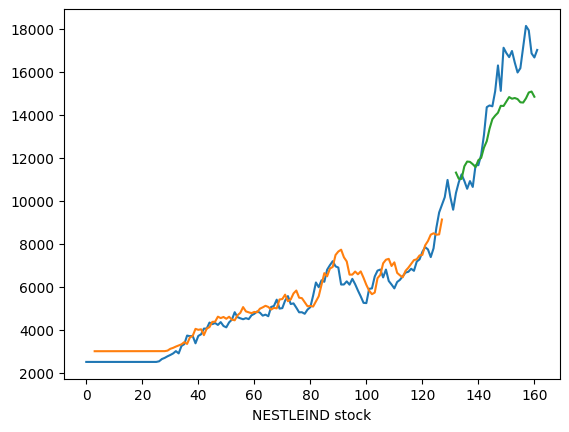

Epoch 1/20
2/2 [==============================] - 3s 383ms/step - loss: 0.8837 - val_loss: 0.0319
Epoch 2/20
2/2 [==============================] - 0s 39ms/step - loss: 0.1734 - val_loss: 0.0811
Epoch 3/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0732 - val_loss: 0.2430
Epoch 4/20
2/2 [==============================] - 0s 42ms/step - loss: 0.2104 - val_loss: 0.2426
Epoch 5/20
2/2 [==============================] - 0s 40ms/step - loss: 0.1576 - val_loss: 0.1436
Epoch 6/20
2/2 [==============================] - 0s 57ms/step - loss: 0.0494 - val_loss: 0.0598
Epoch 7/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0343 - val_loss: 0.0258
Epoch 8/20
2/2 [==============================] - 0s 57ms/step - loss: 0.0641 - val_loss: 0.0181
Epoch 9/20
2/2 [==============================] - 0s 52ms/step - loss: 0.0792 - val_loss: 0.0175
Epoch 10/20
2/2 [==============================] - 0s 54ms/step - loss: 0.0658 - val_loss: 0.0228
Epoch 11/20
2/2 [===========

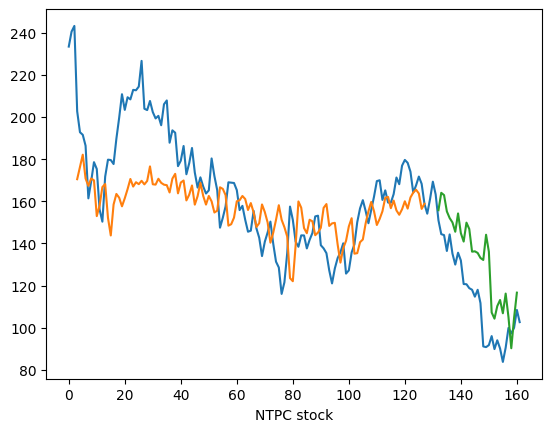

Epoch 1/20
2/2 [==============================] - 3s 413ms/step - loss: 0.6223 - val_loss: 0.0119
Epoch 2/20
2/2 [==============================] - 0s 50ms/step - loss: 0.1399 - val_loss: 0.0771
Epoch 3/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0765 - val_loss: 0.1261
Epoch 4/20
2/2 [==============================] - 0s 41ms/step - loss: 0.1307 - val_loss: 0.1261
Epoch 5/20
2/2 [==============================] - 0s 38ms/step - loss: 0.1395 - val_loss: 0.0946
Epoch 6/20
2/2 [==============================] - 0s 40ms/step - loss: 0.1097 - val_loss: 0.0547
Epoch 7/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0697 - val_loss: 0.0225
Epoch 8/20
2/2 [==============================] - 0s 56ms/step - loss: 0.0418 - val_loss: 0.0045
Epoch 9/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0277 - val_loss: 0.0010
Epoch 10/20
2/2 [==============================] - 0s 65ms/step - loss: 0.0262 - val_loss: 0.0067
Epoch 11/20
2/2 [===========

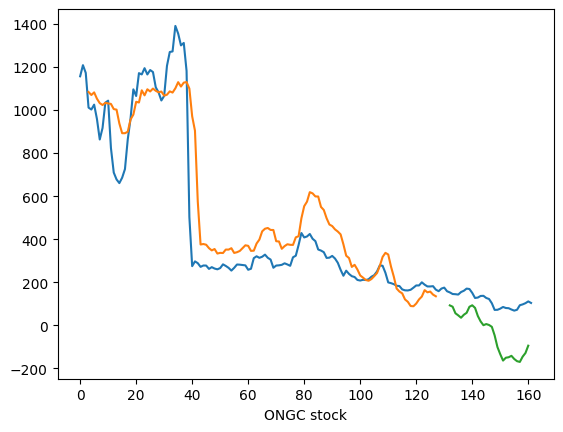

Epoch 1/20
2/2 [==============================] - 3s 443ms/step - loss: 0.4527 - val_loss: 0.5788
Epoch 2/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1218 - val_loss: 0.1509
Epoch 3/20
2/2 [==============================] - 0s 58ms/step - loss: 0.0481 - val_loss: 0.0346
Epoch 4/20
2/2 [==============================] - 0s 61ms/step - loss: 0.0596 - val_loss: 0.0132
Epoch 5/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0807 - val_loss: 0.0106
Epoch 6/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0865 - val_loss: 0.0112
Epoch 7/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0782 - val_loss: 0.0146
Epoch 8/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0632 - val_loss: 0.0229
Epoch 9/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0470 - val_loss: 0.0365
Epoch 10/20
2/2 [==============================] - 0s 55ms/step - loss: 0.0349 - val_loss: 0.0539
Epoch 11/20
2/2 [===========

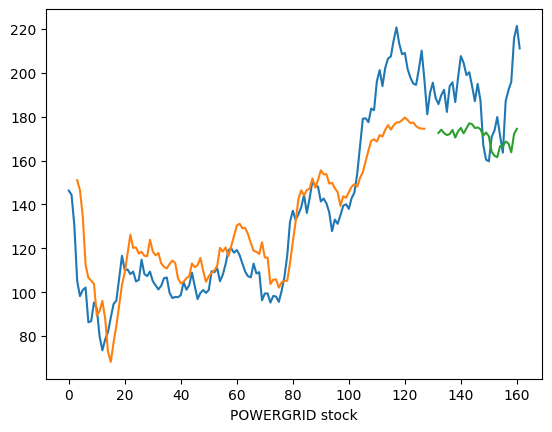

Epoch 1/20
2/2 [==============================] - 4s 399ms/step - loss: 0.0554 - val_loss: 0.0553
Epoch 2/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0228 - val_loss: 0.0191
Epoch 3/20
2/2 [==============================] - 0s 57ms/step - loss: 0.0178 - val_loss: 0.0141
Epoch 4/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0200 - val_loss: 0.0142
Epoch 5/20
2/2 [==============================] - 0s 108ms/step - loss: 0.0191 - val_loss: 0.0126
Epoch 6/20
2/2 [==============================] - 0s 182ms/step - loss: 0.0147 - val_loss: 0.0111
Epoch 7/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0110 - val_loss: 0.0123
Epoch 8/20
2/2 [==============================] - 0s 59ms/step - loss: 0.0094 - val_loss: 0.0160
Epoch 9/20
2/2 [==============================] - 0s 32ms/step - loss: 0.0102 - val_loss: 0.0189
Epoch 10/20
2/2 [==============================] - 0s 49ms/step - loss: 0.0112 - val_loss: 0.0184
Epoch 11/20
2/2 [=========

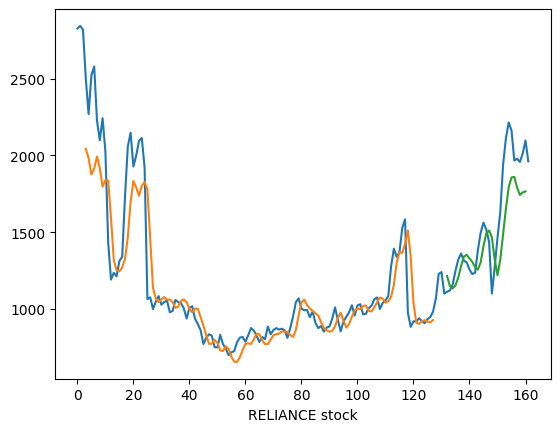

Epoch 1/20
2/2 [==============================] - 4s 448ms/step - loss: 0.9047 - val_loss: 0.0087
Epoch 2/20
2/2 [==============================] - 0s 47ms/step - loss: 0.1882 - val_loss: 0.0619
Epoch 3/20
2/2 [==============================] - 0s 69ms/step - loss: 0.0792 - val_loss: 0.1131
Epoch 4/20
2/2 [==============================] - 0s 40ms/step - loss: 0.2070 - val_loss: 0.1158
Epoch 5/20
2/2 [==============================] - 0s 44ms/step - loss: 0.2234 - val_loss: 0.0874
Epoch 6/20
2/2 [==============================] - 0s 64ms/step - loss: 0.1430 - val_loss: 0.0526
Epoch 7/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0590 - val_loss: 0.0255
Epoch 8/20
2/2 [==============================] - 0s 61ms/step - loss: 0.0305 - val_loss: 0.0099
Epoch 9/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0449 - val_loss: 0.0033
Epoch 10/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0653 - val_loss: 0.0013
Epoch 11/20
2/2 [===========

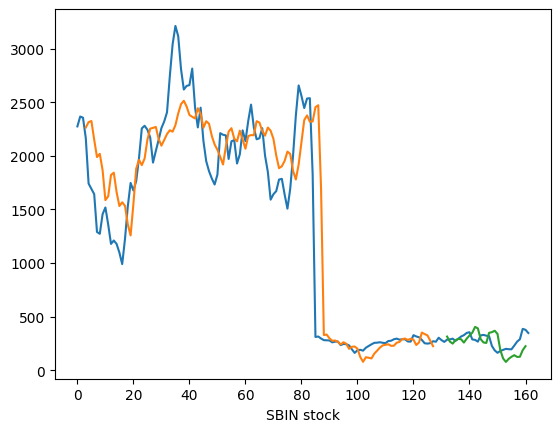

Epoch 1/20
2/2 [==============================] - 3s 424ms/step - loss: 0.3569 - val_loss: 1.0417
Epoch 2/20
2/2 [==============================] - 0s 43ms/step - loss: 0.1591 - val_loss: 0.3959
Epoch 3/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0475 - val_loss: 0.0570
Epoch 4/20
2/2 [==============================] - 0s 63ms/step - loss: 0.0405 - val_loss: 0.0099
Epoch 5/20
2/2 [==============================] - 0s 46ms/step - loss: 0.0592 - val_loss: 0.0143
Epoch 6/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0596 - val_loss: 0.0133
Epoch 7/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0451 - val_loss: 0.0092
Epoch 8/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0263 - val_loss: 0.0111
Epoch 9/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0108 - val_loss: 0.0249
Epoch 10/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0036 - val_loss: 0.0486
Epoch 11/20
2/2 [===========

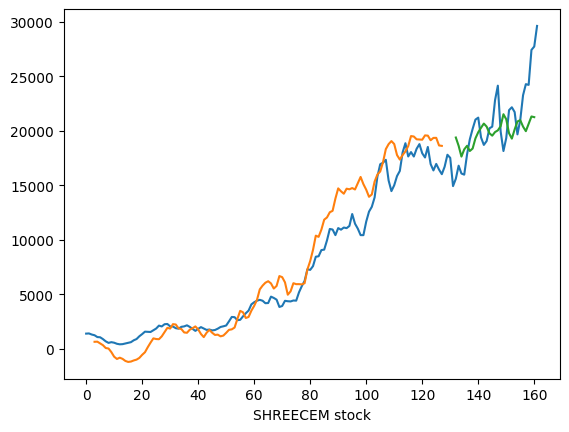

Epoch 1/20
2/2 [==============================] - 3s 424ms/step - loss: 0.1306 - val_loss: 0.0014
Epoch 2/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0472 - val_loss: 0.0062
Epoch 3/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0236 - val_loss: 0.0156
Epoch 4/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0245 - val_loss: 0.0230
Epoch 5/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0298 - val_loss: 0.0257
Epoch 6/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0315 - val_loss: 0.0238
Epoch 7/20
2/2 [==============================] - 0s 48ms/step - loss: 0.0304 - val_loss: 0.0195
Epoch 8/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0279 - val_loss: 0.0142
Epoch 9/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0250 - val_loss: 0.0096
Epoch 10/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0228 - val_loss: 0.0060
Epoch 11/20
2/2 [===========

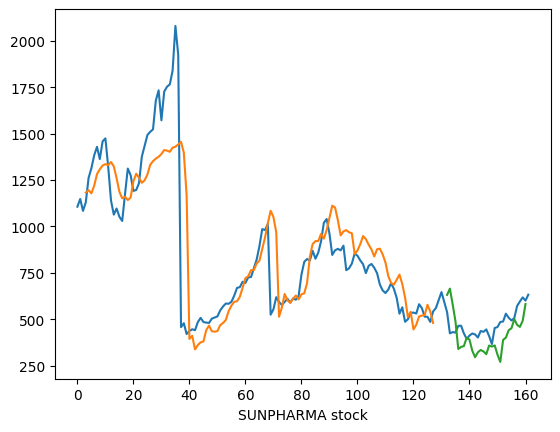

Epoch 1/20
2/2 [==============================] - 3s 389ms/step - loss: 0.3170 - val_loss: 0.0577
Epoch 2/20
2/2 [==============================] - 0s 49ms/step - loss: 0.1129 - val_loss: 0.1294
Epoch 3/20
2/2 [==============================] - 0s 61ms/step - loss: 0.1785 - val_loss: 0.0659
Epoch 4/20
2/2 [==============================] - 0s 55ms/step - loss: 0.0642 - val_loss: 0.0126
Epoch 5/20
2/2 [==============================] - 0s 34ms/step - loss: 0.0447 - val_loss: 0.0040
Epoch 6/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0834 - val_loss: 0.0048
Epoch 7/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0679 - val_loss: 0.0041
Epoch 8/20
2/2 [==============================] - 0s 54ms/step - loss: 0.0296 - val_loss: 0.0089
Epoch 9/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0302 - val_loss: 0.0157
Epoch 10/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0445 - val_loss: 0.0146
Epoch 11/20
2/2 [===========

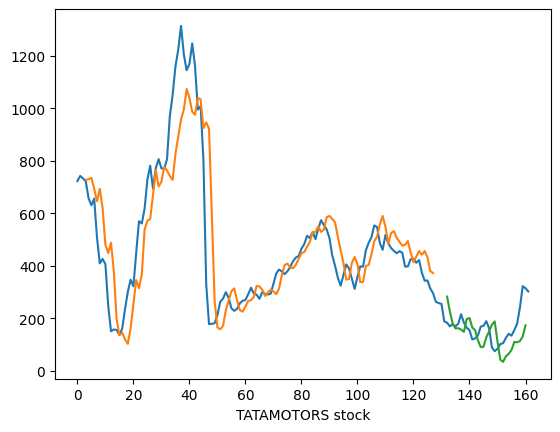

Epoch 1/20
2/2 [==============================] - 4s 437ms/step - loss: 0.1362 - val_loss: 0.0321
Epoch 2/20
2/2 [==============================] - 0s 64ms/step - loss: 0.0552 - val_loss: 0.0990
Epoch 3/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0894 - val_loss: 0.0530
Epoch 4/20
2/2 [==============================] - 0s 46ms/step - loss: 0.0366 - val_loss: 0.0216
Epoch 5/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0177 - val_loss: 0.0401
Epoch 6/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0394 - val_loss: 0.0469
Epoch 7/20
2/2 [==============================] - 0s 58ms/step - loss: 0.0376 - val_loss: 0.0275
Epoch 8/20
2/2 [==============================] - 0s 46ms/step - loss: 0.0181 - val_loss: 0.0181
Epoch 9/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0143 - val_loss: 0.0241
Epoch 10/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0218 - val_loss: 0.0269
Epoch 11/20
2/2 [===========

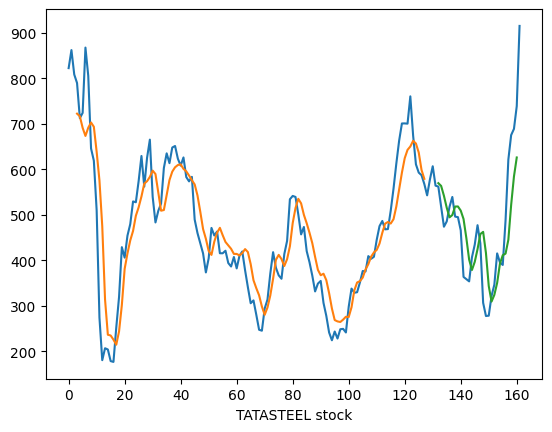

Epoch 1/20
2/2 [==============================] - 3s 398ms/step - loss: 2.3080 - val_loss: 2.3066
Epoch 2/20
2/2 [==============================] - 0s 43ms/step - loss: 1.1865 - val_loss: 0.7019
Epoch 3/20
2/2 [==============================] - 0s 41ms/step - loss: 0.2934 - val_loss: 0.0324
Epoch 4/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0995 - val_loss: 0.1328
Epoch 5/20
2/2 [==============================] - 0s 37ms/step - loss: 0.2359 - val_loss: 0.2565
Epoch 6/20
2/2 [==============================] - 0s 38ms/step - loss: 0.3113 - val_loss: 0.2416
Epoch 7/20
2/2 [==============================] - 0s 55ms/step - loss: 0.2777 - val_loss: 0.1529
Epoch 8/20
2/2 [==============================] - 0s 40ms/step - loss: 0.1936 - val_loss: 0.0628
Epoch 9/20
2/2 [==============================] - 0s 53ms/step - loss: 0.1136 - val_loss: 0.0216
Epoch 10/20
2/2 [==============================] - 0s 60ms/step - loss: 0.0679 - val_loss: 0.0311
Epoch 11/20
2/2 [===========

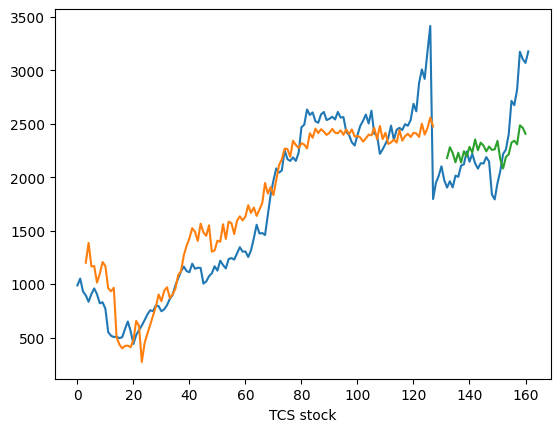

Epoch 1/20
2/2 [==============================] - 3s 417ms/step - loss: 0.1304 - val_loss: 0.0067
Epoch 2/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0385 - val_loss: 0.0093
Epoch 3/20
2/2 [==============================] - 0s 55ms/step - loss: 0.0266 - val_loss: 0.0301
Epoch 4/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0384 - val_loss: 0.0327
Epoch 5/20
2/2 [==============================] - 0s 53ms/step - loss: 0.0358 - val_loss: 0.0198
Epoch 6/20
2/2 [==============================] - 0s 34ms/step - loss: 0.0245 - val_loss: 0.0065
Epoch 7/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0137 - val_loss: 0.0017
Epoch 8/20
2/2 [==============================] - 0s 59ms/step - loss: 0.0121 - val_loss: 0.0038
Epoch 9/20
2/2 [==============================] - 0s 58ms/step - loss: 0.0164 - val_loss: 0.0062
Epoch 10/20
2/2 [==============================] - 0s 56ms/step - loss: 0.0184 - val_loss: 0.0054
Epoch 11/20
2/2 [===========

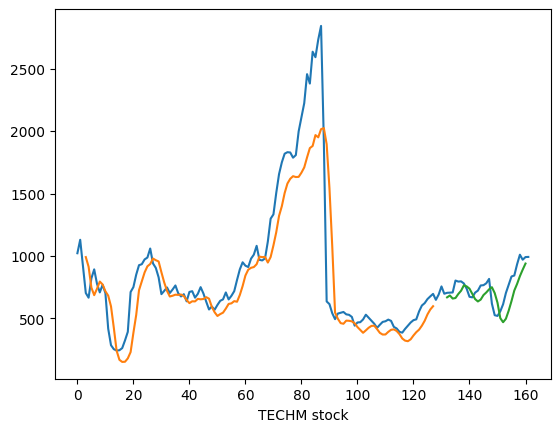

Epoch 1/20
2/2 [==============================] - 5s 488ms/step - loss: 0.1470 - val_loss: 0.0241
Epoch 2/20
2/2 [==============================] - 0s 48ms/step - loss: 0.0614 - val_loss: 0.0045
Epoch 3/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0391 - val_loss: 0.0312
Epoch 4/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0390 - val_loss: 0.0424
Epoch 5/20
2/2 [==============================] - 0s 53ms/step - loss: 0.0366 - val_loss: 0.0369
Epoch 6/20
2/2 [==============================] - 0s 51ms/step - loss: 0.0284 - val_loss: 0.0244
Epoch 7/20
2/2 [==============================] - 0s 51ms/step - loss: 0.0205 - val_loss: 0.0117
Epoch 8/20
2/2 [==============================] - 0s 48ms/step - loss: 0.0152 - val_loss: 0.0042
Epoch 9/20
2/2 [==============================] - 0s 67ms/step - loss: 0.0145 - val_loss: 0.0016
Epoch 10/20
2/2 [==============================] - 0s 48ms/step - loss: 0.0168 - val_loss: 0.0016
Epoch 11/20
2/2 [===========

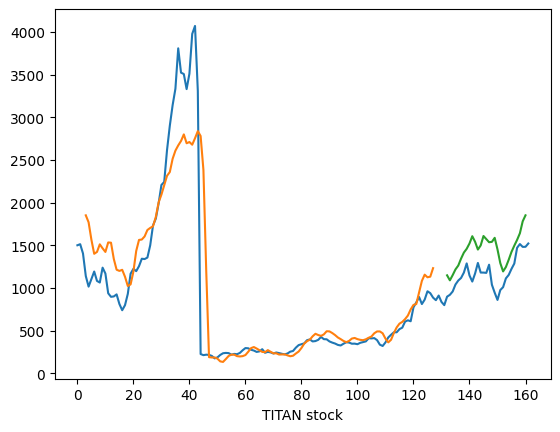

Epoch 1/20
2/2 [==============================] - 3s 426ms/step - loss: 0.0531 - val_loss: 0.0372
Epoch 2/20
2/2 [==============================] - 0s 56ms/step - loss: 0.0175 - val_loss: 0.1044
Epoch 3/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0509 - val_loss: 0.0278
Epoch 4/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0079 - val_loss: 0.0532
Epoch 5/20
2/2 [==============================] - 0s 49ms/step - loss: 0.0212 - val_loss: 0.0706
Epoch 6/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0183 - val_loss: 0.0194
Epoch 7/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0032 - val_loss: 0.0224
Epoch 8/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0130 - val_loss: 0.0238
Epoch 9/20
2/2 [==============================] - 0s 58ms/step - loss: 0.0101 - val_loss: 0.0138
Epoch 10/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0025 - val_loss: 0.0304
Epoch 11/20
2/2 [===========

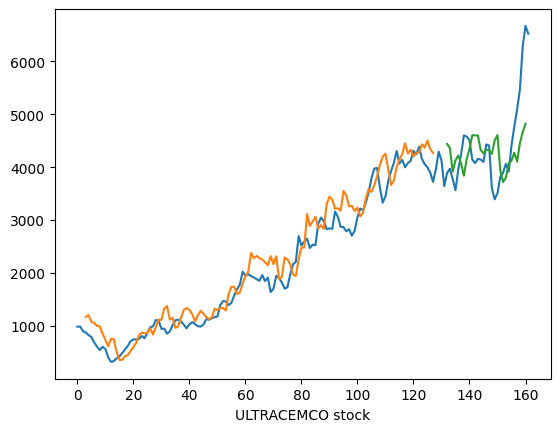

Epoch 1/20
2/2 [==============================] - 3s 410ms/step - loss: 0.0336 - val_loss: 0.0080
Epoch 2/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0233 - val_loss: 0.0071
Epoch 3/20
2/2 [==============================] - 0s 46ms/step - loss: 0.0270 - val_loss: 0.0011
Epoch 4/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0172 - val_loss: 0.0051
Epoch 5/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0199 - val_loss: 0.0044
Epoch 6/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0171 - val_loss: 6.8576e-05
Epoch 7/20
2/2 [==============================] - 0s 56ms/step - loss: 0.0131 - val_loss: 0.0023
Epoch 8/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0144 - val_loss: 4.9919e-04
Epoch 9/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0117 - val_loss: 4.3003e-04
Epoch 10/20
2/2 [==============================] - 0s 52ms/step - loss: 0.0109 - val_loss: 9.3463e-04
Epoch 11/20


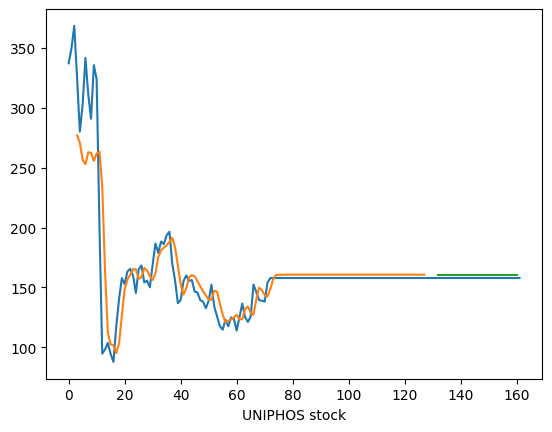

Epoch 1/20
2/2 [==============================] - 3s 557ms/step - loss: 0.2931 - val_loss: 0.1678
Epoch 2/20
2/2 [==============================] - 0s 159ms/step - loss: 0.0448 - val_loss: 0.0370
Epoch 3/20
2/2 [==============================] - 0s 68ms/step - loss: 0.0472 - val_loss: 0.1271
Epoch 4/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0626 - val_loss: 0.1266
Epoch 5/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0439 - val_loss: 0.0749
Epoch 6/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0199 - val_loss: 0.0360
Epoch 7/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0108 - val_loss: 0.0249
Epoch 8/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0154 - val_loss: 0.0281
Epoch 9/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0207 - val_loss: 0.0322
Epoch 10/20
2/2 [==============================] - 0s 57ms/step - loss: 0.0211 - val_loss: 0.0323
Epoch 11/20
2/2 [==========

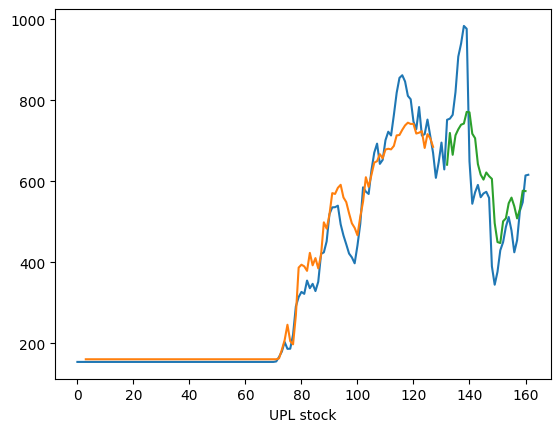

Epoch 1/20
2/2 [==============================] - 4s 455ms/step - loss: 0.0137 - val_loss: 0.0025
Epoch 2/20
2/2 [==============================] - 0s 71ms/step - loss: 0.0060 - val_loss: 6.3479e-04
Epoch 3/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0091 - val_loss: 8.5608e-04
Epoch 4/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0078 - val_loss: 2.9581e-04
Epoch 5/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0055 - val_loss: 4.5858e-04
Epoch 6/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0059 - val_loss: 2.8432e-04
Epoch 7/20
2/2 [==============================] - 0s 56ms/step - loss: 0.0072 - val_loss: 7.2016e-04
Epoch 8/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0060 - val_loss: 0.0013
Epoch 9/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0057 - val_loss: 1.5743e-04
Epoch 10/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0049 - val_loss: 6.1911e

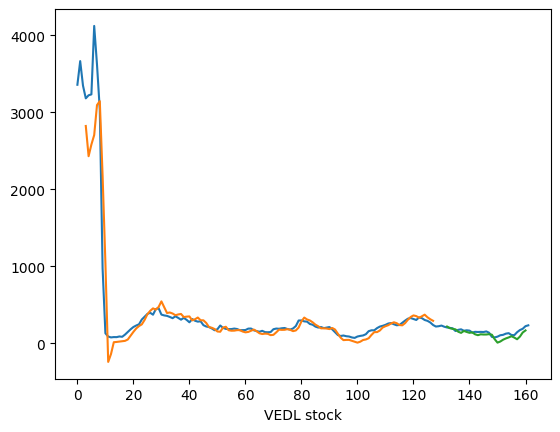

Epoch 1/20
2/2 [==============================] - 3s 443ms/step - loss: 1.1234 - val_loss: 0.0835
Epoch 2/20
2/2 [==============================] - 0s 39ms/step - loss: 0.3134 - val_loss: 0.0356
Epoch 3/20
2/2 [==============================] - 0s 60ms/step - loss: 0.0552 - val_loss: 0.1231
Epoch 4/20
2/2 [==============================] - 0s 41ms/step - loss: 0.1132 - val_loss: 0.1983
Epoch 5/20
2/2 [==============================] - 0s 57ms/step - loss: 0.1772 - val_loss: 0.2170
Epoch 6/20
2/2 [==============================] - 0s 57ms/step - loss: 0.1762 - val_loss: 0.1946
Epoch 7/20
2/2 [==============================] - 0s 73ms/step - loss: 0.1356 - val_loss: 0.1523
Epoch 8/20
2/2 [==============================] - 0s 58ms/step - loss: 0.0872 - val_loss: 0.1078
Epoch 9/20
2/2 [==============================] - 0s 66ms/step - loss: 0.0524 - val_loss: 0.0721
Epoch 10/20
2/2 [==============================] - 0s 63ms/step - loss: 0.0415 - val_loss: 0.0480
Epoch 11/20
2/2 [===========

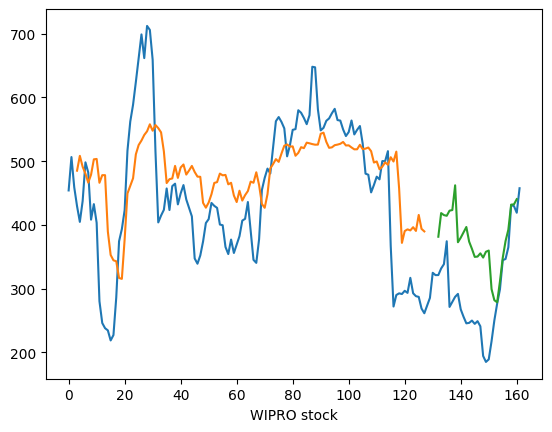

Epoch 1/20
2/2 [==============================] - 3s 423ms/step - loss: 0.0637 - val_loss: 0.0685
Epoch 2/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0452 - val_loss: 0.0693
Epoch 3/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0297 - val_loss: 0.0196
Epoch 4/20
2/2 [==============================] - 0s 32ms/step - loss: 0.0109 - val_loss: 0.0102
Epoch 5/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0227 - val_loss: 0.0115
Epoch 6/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0173 - val_loss: 0.0157
Epoch 7/20
2/2 [==============================] - 0s 34ms/step - loss: 0.0107 - val_loss: 0.0332
Epoch 8/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0143 - val_loss: 0.0375
Epoch 9/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0138 - val_loss: 0.0246
Epoch 10/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0082 - val_loss: 0.0121
Epoch 11/20
2/2 [===========

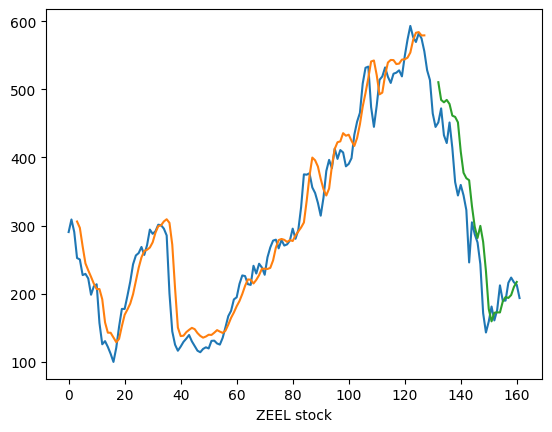

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import SimpleRNN, Dense
from sklearn import metrics

for i in df.columns:
    scaler = MinMaxScaler(feature_range=(0, 1))
    df1 = scaler.fit_transform(np.array(df[i]).reshape(-1, 1))

    train_data, test_data = df1[0:129], df1[129:len(df)]

    time_step = 3
    X_train, y_train = create_dataset(train_data, time_step)
    X_test, y_test = create_dataset(test_data, time_step)

    model = Sequential()
    model.add(SimpleRNN(50, return_sequences=True, input_shape=(time_step, 1)))
    model.add(SimpleRNN(25, return_sequences=True))
    model.add(SimpleRNN(10, return_sequences=True))
    model.add(SimpleRNN(5))
    model.add(Dense(1))
    model.compile(loss='mean_squared_error', optimizer='adam')
    model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=20, batch_size=64, verbose=1)

    train_predict = model.predict(X_train)
    test_predict = model.predict(X_test)

    train_predict = scaler.inverse_transform(train_predict)
    test_predict = scaler.inverse_transform(test_predict)

    mae = metrics.mean_absolute_error(y_test, test_predict)
    mse = metrics.mean_squared_error(y_test, test_predict)
    rmse = np.sqrt(mse)

    print("Results of sklearn.metrics:")
    print("MAE:", mae)
    print("RMSE:", rmse)

    look_back = 3
    trainPredictPlot = np.empty_like(df1)
    trainPredictPlot[:, :] = np.nan
    trainPredictPlot[look_back:len(train_predict) + look_back, :] = train_predict

    testPredictPlot = np.empty_like(df1)
    testPredictPlot[:, :] = np.nan
    testPredictPlot[len(train_predict) + (look_back * 2) + 1:len(df1) - 1, :] = test_predict

    plt.plot(scaler.inverse_transform(df1))
    plt.plot(trainPredictPlot)
    plt.plot(testPredictPlot)
    plt.xlabel(i + ' stock')
    plt.show()


# LSTM

Epoch 1/20
2/2 [==============================] - 7s 992ms/step - loss: 0.0725 - val_loss: 0.0767
Epoch 2/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0672 - val_loss: 0.0702
Epoch 3/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0621 - val_loss: 0.0639
Epoch 4/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0570 - val_loss: 0.0576
Epoch 5/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0524 - val_loss: 0.0515
Epoch 6/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0479 - val_loss: 0.0455
Epoch 7/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0434 - val_loss: 0.0397
Epoch 8/20
2/2 [==============================] - 0s 31ms/step - loss: 0.0390 - val_loss: 0.0340
Epoch 9/20
2/2 [==============================] - 0s 33ms/step - loss: 0.0351 - val_loss: 0.0286
Epoch 10/20
2/2 [==============================] - 0s 32ms/step - loss: 0.0315 - val_loss: 0.0236
Epoch 11/20
2/2 [===========

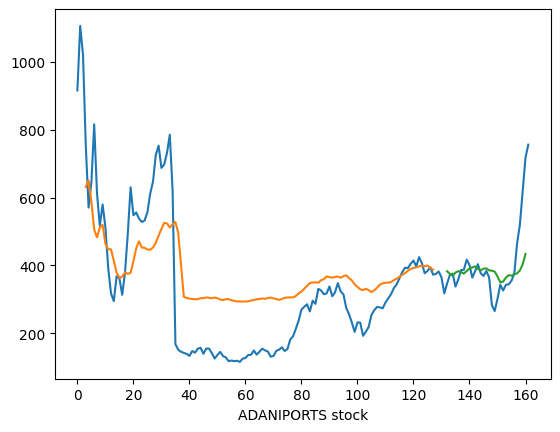

Epoch 1/20
2/2 [==============================] - 5s 1s/step - loss: 0.1617 - val_loss: 0.0927
Epoch 2/20
2/2 [==============================] - 0s 43ms/step - loss: 0.1532 - val_loss: 0.0855
Epoch 3/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1450 - val_loss: 0.0784
Epoch 4/20
2/2 [==============================] - 0s 43ms/step - loss: 0.1366 - val_loss: 0.0714
Epoch 5/20
2/2 [==============================] - 0s 45ms/step - loss: 0.1283 - val_loss: 0.0644
Epoch 6/20
2/2 [==============================] - 0s 50ms/step - loss: 0.1200 - val_loss: 0.0574
Epoch 7/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1122 - val_loss: 0.0504
Epoch 8/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1037 - val_loss: 0.0434
Epoch 9/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0952 - val_loss: 0.0365
Epoch 10/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0868 - val_loss: 0.0298
Epoch 11/20
2/2 [==============

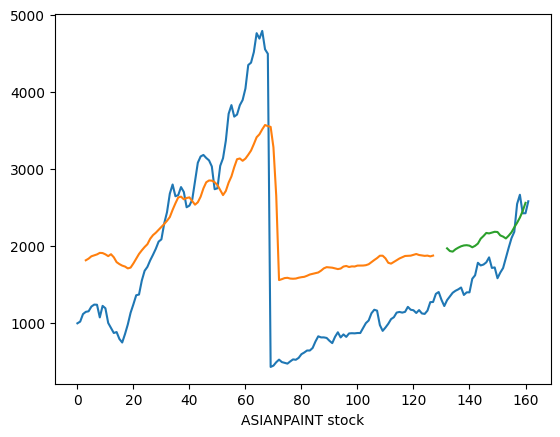

Epoch 1/20
2/2 [==============================] - 5s 936ms/step - loss: 0.1725 - val_loss: 0.0362
Epoch 2/20
2/2 [==============================] - 0s 33ms/step - loss: 0.1643 - val_loss: 0.0327
Epoch 3/20
2/2 [==============================] - 0s 34ms/step - loss: 0.1562 - val_loss: 0.0294
Epoch 4/20
2/2 [==============================] - 0s 36ms/step - loss: 0.1477 - val_loss: 0.0262
Epoch 5/20
2/2 [==============================] - 0s 32ms/step - loss: 0.1397 - val_loss: 0.0230
Epoch 6/20
2/2 [==============================] - 0s 33ms/step - loss: 0.1314 - val_loss: 0.0200
Epoch 7/20
2/2 [==============================] - 0s 33ms/step - loss: 0.1228 - val_loss: 0.0171
Epoch 8/20
2/2 [==============================] - 0s 31ms/step - loss: 0.1145 - val_loss: 0.0144
Epoch 9/20
2/2 [==============================] - 0s 34ms/step - loss: 0.1055 - val_loss: 0.0119
Epoch 10/20
2/2 [==============================] - 0s 33ms/step - loss: 0.0969 - val_loss: 0.0097
Epoch 11/20
2/2 [===========

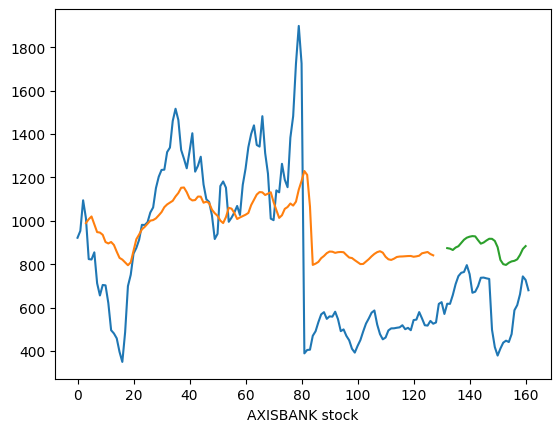

Epoch 1/20
2/2 [==============================] - 7s 2s/step - loss: 0.2148 - val_loss: 0.4866
Epoch 2/20
2/2 [==============================] - 0s 40ms/step - loss: 0.2025 - val_loss: 0.4638
Epoch 3/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1903 - val_loss: 0.4414
Epoch 4/20
2/2 [==============================] - 0s 43ms/step - loss: 0.1787 - val_loss: 0.4188
Epoch 5/20
2/2 [==============================] - 0s 43ms/step - loss: 0.1670 - val_loss: 0.3959
Epoch 6/20
2/2 [==============================] - 0s 43ms/step - loss: 0.1557 - val_loss: 0.3723
Epoch 7/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1434 - val_loss: 0.3480
Epoch 8/20
2/2 [==============================] - 0s 41ms/step - loss: 0.1317 - val_loss: 0.3226
Epoch 9/20
2/2 [==============================] - 0s 46ms/step - loss: 0.1192 - val_loss: 0.2960
Epoch 10/20
2/2 [==============================] - 0s 41ms/step - loss: 0.1066 - val_loss: 0.2681
Epoch 11/20
2/2 [==============

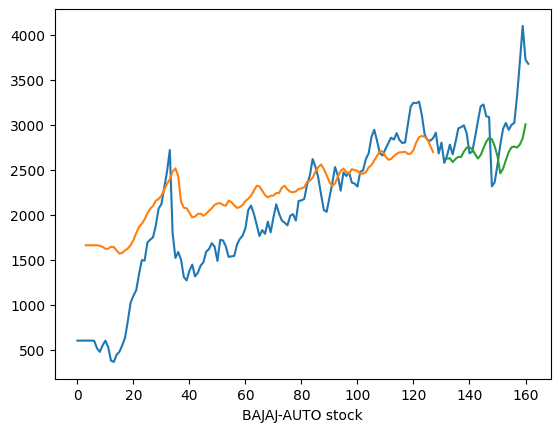

Epoch 1/20
2/2 [==============================] - 6s 941ms/step - loss: 0.0417 - val_loss: 0.5357
Epoch 2/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0382 - val_loss: 0.5104
Epoch 3/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0349 - val_loss: 0.4853
Epoch 4/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0321 - val_loss: 0.4598
Epoch 5/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0293 - val_loss: 0.4341
Epoch 6/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0268 - val_loss: 0.4080
Epoch 7/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0244 - val_loss: 0.3817
Epoch 8/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0227 - val_loss: 0.3549
Epoch 9/20
2/2 [==============================] - 0s 54ms/step - loss: 0.0210 - val_loss: 0.3285
Epoch 10/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0200 - val_loss: 0.3022
Epoch 11/20
2/2 [===========

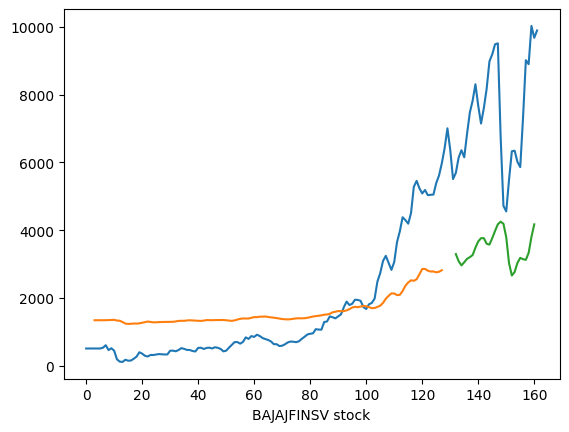

Epoch 1/20
2/2 [==============================] - 6s 997ms/step - loss: 0.0671 - val_loss: 0.1173
Epoch 2/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0630 - val_loss: 0.1084
Epoch 3/20
2/2 [==============================] - 0s 33ms/step - loss: 0.0586 - val_loss: 0.0998
Epoch 4/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0547 - val_loss: 0.0913
Epoch 5/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0507 - val_loss: 0.0829
Epoch 6/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0469 - val_loss: 0.0746
Epoch 7/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0436 - val_loss: 0.0664
Epoch 8/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0405 - val_loss: 0.0584
Epoch 9/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0372 - val_loss: 0.0507
Epoch 10/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0344 - val_loss: 0.0433
Epoch 11/20
2/2 [===========

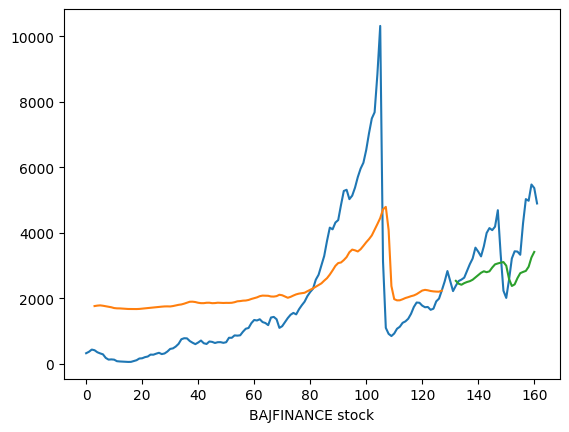

Epoch 1/20
2/2 [==============================] - 6s 933ms/step - loss: 0.0871 - val_loss: 0.0740
Epoch 2/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0825 - val_loss: 0.0688
Epoch 3/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0776 - val_loss: 0.0636
Epoch 4/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0727 - val_loss: 0.0585
Epoch 5/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0678 - val_loss: 0.0534
Epoch 6/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0634 - val_loss: 0.0483
Epoch 7/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0586 - val_loss: 0.0433
Epoch 8/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0539 - val_loss: 0.0384
Epoch 9/20
2/2 [==============================] - 0s 34ms/step - loss: 0.0492 - val_loss: 0.0336
Epoch 10/20
2/2 [==============================] - 0s 33ms/step - loss: 0.0445 - val_loss: 0.0290
Epoch 11/20
2/2 [===========

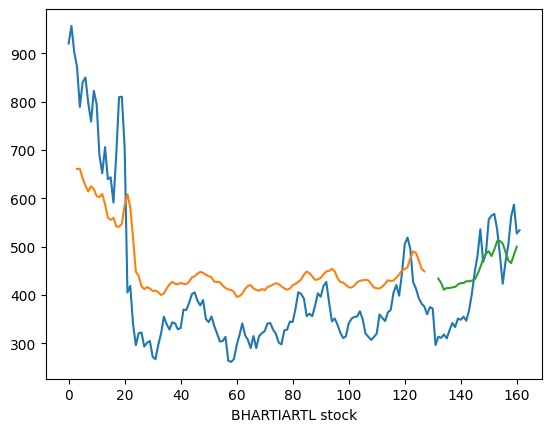

Epoch 1/20
2/2 [==============================] - 7s 2s/step - loss: 0.2125 - val_loss: 0.0290
Epoch 2/20
2/2 [==============================] - 0s 43ms/step - loss: 0.2029 - val_loss: 0.0262
Epoch 3/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1937 - val_loss: 0.0235
Epoch 4/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1845 - val_loss: 0.0209
Epoch 5/20
2/2 [==============================] - 0s 43ms/step - loss: 0.1753 - val_loss: 0.0184
Epoch 6/20
2/2 [==============================] - 0s 52ms/step - loss: 0.1661 - val_loss: 0.0160
Epoch 7/20
2/2 [==============================] - 0s 41ms/step - loss: 0.1564 - val_loss: 0.0137
Epoch 8/20
2/2 [==============================] - 0s 47ms/step - loss: 0.1464 - val_loss: 0.0116
Epoch 9/20
2/2 [==============================] - 0s 39ms/step - loss: 0.1366 - val_loss: 0.0096
Epoch 10/20
2/2 [==============================] - 0s 38ms/step - loss: 0.1262 - val_loss: 0.0079
Epoch 11/20
2/2 [==============

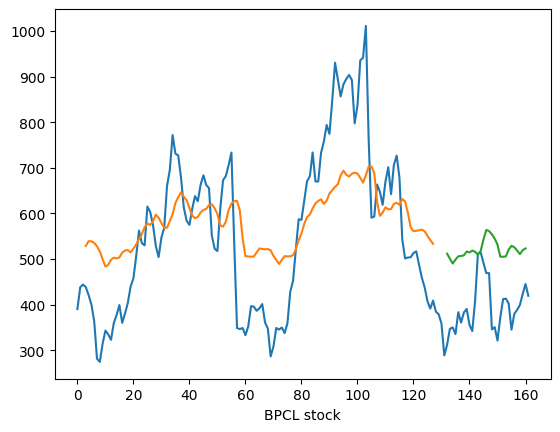

Epoch 1/20
2/2 [==============================] - 5s 929ms/step - loss: 0.1007 - val_loss: 0.2161
Epoch 2/20
2/2 [==============================] - 0s 37ms/step - loss: 0.0946 - val_loss: 0.2025
Epoch 3/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0884 - val_loss: 0.1892
Epoch 4/20
2/2 [==============================] - 0s 35ms/step - loss: 0.0826 - val_loss: 0.1759
Epoch 5/20
2/2 [==============================] - 0s 36ms/step - loss: 0.0769 - val_loss: 0.1625
Epoch 6/20
2/2 [==============================] - 0s 66ms/step - loss: 0.0714 - val_loss: 0.1490
Epoch 7/20
2/2 [==============================] - 0s 50ms/step - loss: 0.0658 - val_loss: 0.1354
Epoch 8/20
2/2 [==============================] - 0s 46ms/step - loss: 0.0604 - val_loss: 0.1215
Epoch 9/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0552 - val_loss: 0.1075
Epoch 10/20
2/2 [==============================] - 0s 62ms/step - loss: 0.0499 - val_loss: 0.0935
Epoch 11/20
2/2 [===========

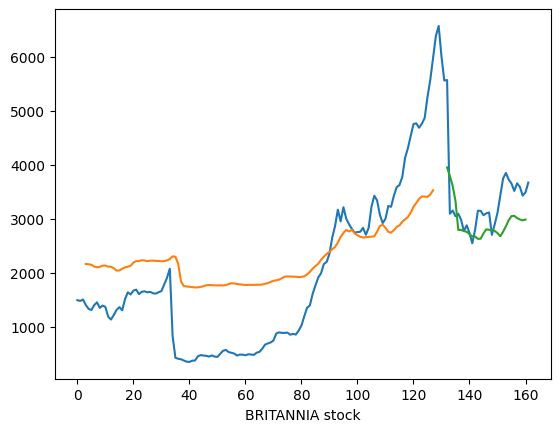

Epoch 1/20
2/2 [==============================] - 6s 2s/step - loss: 0.1529 - val_loss: 0.3488
Epoch 2/20
2/2 [==============================] - 0s 48ms/step - loss: 0.1449 - val_loss: 0.3334
Epoch 3/20
2/2 [==============================] - 0s 45ms/step - loss: 0.1366 - val_loss: 0.3178
Epoch 4/20
2/2 [==============================] - 0s 40ms/step - loss: 0.1288 - val_loss: 0.3017
Epoch 5/20
2/2 [==============================] - 0s 41ms/step - loss: 0.1205 - val_loss: 0.2852
Epoch 6/20
2/2 [==============================] - 0s 57ms/step - loss: 0.1122 - val_loss: 0.2680
Epoch 7/20
2/2 [==============================] - 0s 59ms/step - loss: 0.1036 - val_loss: 0.2501
Epoch 8/20
2/2 [==============================] - 0s 59ms/step - loss: 0.0947 - val_loss: 0.2315
Epoch 9/20
2/2 [==============================] - 0s 75ms/step - loss: 0.0863 - val_loss: 0.2120
Epoch 10/20
2/2 [==============================] - 0s 62ms/step - loss: 0.0771 - val_loss: 0.1918
Epoch 11/20
2/2 [==============

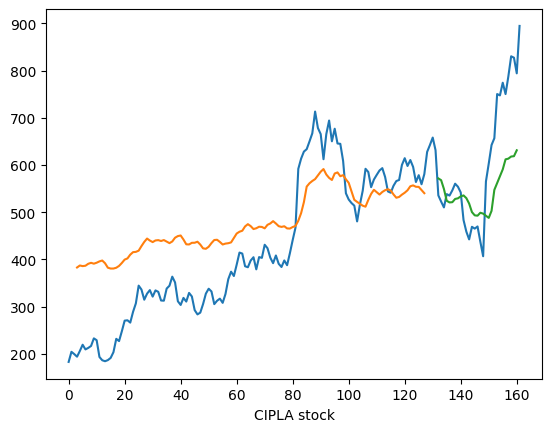

Epoch 1/20
2/2 [==============================] - 5s 928ms/step - loss: 0.4840 - val_loss: 0.0665
Epoch 2/20
2/2 [==============================] - 0s 38ms/step - loss: 0.4650 - val_loss: 0.0618
Epoch 3/20
2/2 [==============================] - 0s 37ms/step - loss: 0.4462 - val_loss: 0.0572
Epoch 4/20
2/2 [==============================] - 0s 41ms/step - loss: 0.4276 - val_loss: 0.0527
Epoch 5/20
2/2 [==============================] - 0s 37ms/step - loss: 0.4080 - val_loss: 0.0483
Epoch 6/20
2/2 [==============================] - 0s 37ms/step - loss: 0.3881 - val_loss: 0.0439
Epoch 7/20
2/2 [==============================] - 0s 39ms/step - loss: 0.3675 - val_loss: 0.0396
Epoch 8/20
2/2 [==============================] - 0s 46ms/step - loss: 0.3460 - val_loss: 0.0354
Epoch 9/20
2/2 [==============================] - 0s 39ms/step - loss: 0.3235 - val_loss: 0.0313
Epoch 10/20
2/2 [==============================] - 0s 39ms/step - loss: 0.2988 - val_loss: 0.0273
Epoch 11/20
2/2 [===========

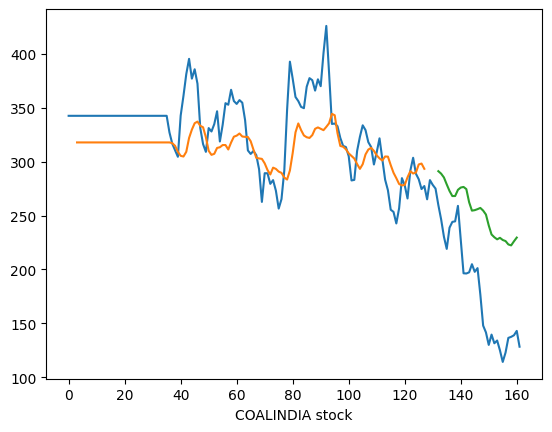

Epoch 1/20
2/2 [==============================] - 7s 2s/step - loss: 0.1572 - val_loss: 0.4440
Epoch 2/20
2/2 [==============================] - 0s 38ms/step - loss: 0.1507 - val_loss: 0.4299
Epoch 3/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1442 - val_loss: 0.4156
Epoch 4/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1376 - val_loss: 0.4009
Epoch 5/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1310 - val_loss: 0.3855
Epoch 6/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1239 - val_loss: 0.3695
Epoch 7/20
2/2 [==============================] - 0s 41ms/step - loss: 0.1168 - val_loss: 0.3527
Epoch 8/20
2/2 [==============================] - 0s 51ms/step - loss: 0.1094 - val_loss: 0.3349
Epoch 9/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1017 - val_loss: 0.3161
Epoch 10/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0940 - val_loss: 0.2962
Epoch 11/20
2/2 [==============

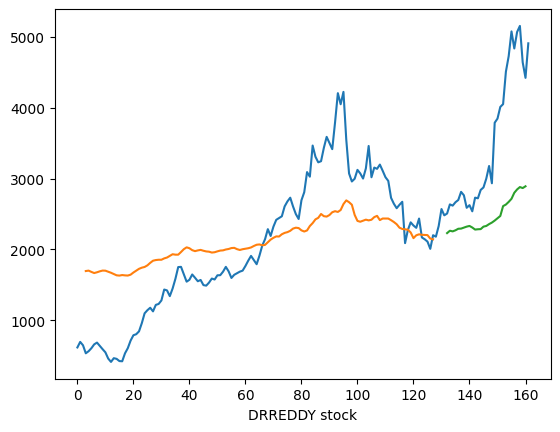

Epoch 1/20
2/2 [==============================] - 6s 1s/step - loss: 0.1897 - val_loss: 0.2660
Epoch 2/20
2/2 [==============================] - 0s 64ms/step - loss: 0.1837 - val_loss: 0.2559
Epoch 3/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1773 - val_loss: 0.2457
Epoch 4/20
2/2 [==============================] - 0s 50ms/step - loss: 0.1709 - val_loss: 0.2354
Epoch 5/20
2/2 [==============================] - 0s 64ms/step - loss: 0.1648 - val_loss: 0.2248
Epoch 6/20
2/2 [==============================] - 0s 53ms/step - loss: 0.1585 - val_loss: 0.2138
Epoch 7/20
2/2 [==============================] - 0s 60ms/step - loss: 0.1517 - val_loss: 0.2025
Epoch 8/20
2/2 [==============================] - 0s 54ms/step - loss: 0.1448 - val_loss: 0.1906
Epoch 9/20
2/2 [==============================] - 0s 82ms/step - loss: 0.1376 - val_loss: 0.1781
Epoch 10/20
2/2 [==============================] - 0s 52ms/step - loss: 0.1297 - val_loss: 0.1651
Epoch 11/20
2/2 [==============

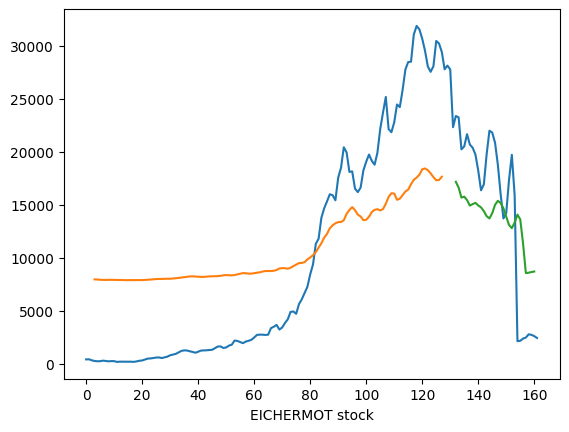

Epoch 1/20
2/2 [==============================] - 7s 1s/step - loss: 0.5644 - val_loss: 0.1125
Epoch 2/20
2/2 [==============================] - 0s 45ms/step - loss: 0.5422 - val_loss: 0.1069
Epoch 3/20
2/2 [==============================] - 0s 44ms/step - loss: 0.5211 - val_loss: 0.1015
Epoch 4/20
2/2 [==============================] - 0s 41ms/step - loss: 0.5010 - val_loss: 0.0964
Epoch 5/20
2/2 [==============================] - 0s 42ms/step - loss: 0.4811 - val_loss: 0.0915
Epoch 6/20
2/2 [==============================] - 0s 40ms/step - loss: 0.4610 - val_loss: 0.0867
Epoch 7/20
2/2 [==============================] - 0s 42ms/step - loss: 0.4412 - val_loss: 0.0819
Epoch 8/20
2/2 [==============================] - 0s 43ms/step - loss: 0.4205 - val_loss: 0.0772
Epoch 9/20
2/2 [==============================] - 0s 42ms/step - loss: 0.3993 - val_loss: 0.0725
Epoch 10/20
2/2 [==============================] - 0s 40ms/step - loss: 0.3771 - val_loss: 0.0678
Epoch 11/20
2/2 [==============

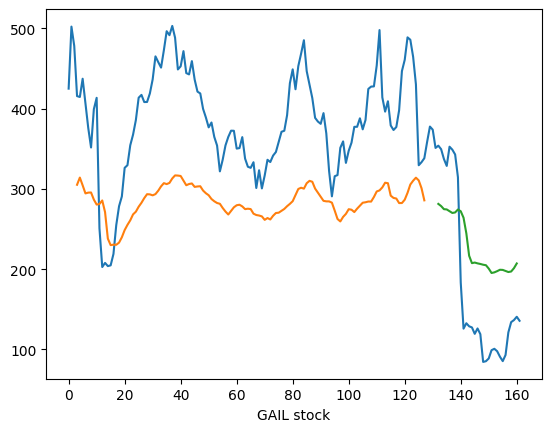

Epoch 1/20
2/2 [==============================] - 5s 913ms/step - loss: 0.2564 - val_loss: 0.0048
Epoch 2/20
2/2 [==============================] - 0s 67ms/step - loss: 0.2413 - val_loss: 0.0037
Epoch 3/20
2/2 [==============================] - 0s 53ms/step - loss: 0.2265 - val_loss: 0.0028
Epoch 4/20
2/2 [==============================] - 0s 51ms/step - loss: 0.2121 - val_loss: 0.0022
Epoch 5/20
2/2 [==============================] - 0s 57ms/step - loss: 0.1968 - val_loss: 0.0018
Epoch 6/20
2/2 [==============================] - 0s 63ms/step - loss: 0.1815 - val_loss: 0.0017
Epoch 7/20
2/2 [==============================] - 0s 39ms/step - loss: 0.1663 - val_loss: 0.0020
Epoch 8/20
2/2 [==============================] - 0s 47ms/step - loss: 0.1501 - val_loss: 0.0028
Epoch 9/20
2/2 [==============================] - 0s 41ms/step - loss: 0.1337 - val_loss: 0.0042
Epoch 10/20
2/2 [==============================] - 0s 57ms/step - loss: 0.1168 - val_loss: 0.0062
Epoch 11/20
2/2 [===========

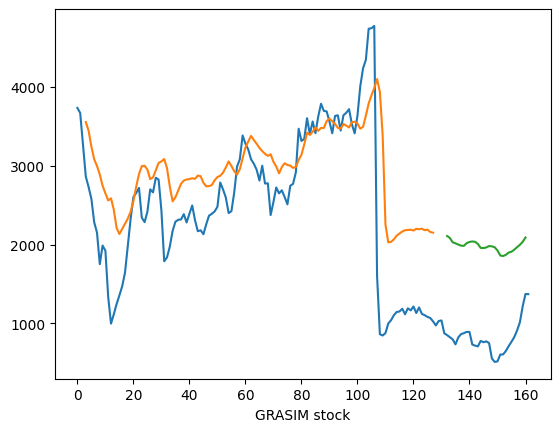

Epoch 1/20
2/2 [==============================] - 7s 1s/step - loss: 0.1481 - val_loss: 0.1684
Epoch 2/20
2/2 [==============================] - 0s 56ms/step - loss: 0.1424 - val_loss: 0.1614
Epoch 3/20
2/2 [==============================] - 0s 76ms/step - loss: 0.1365 - val_loss: 0.1542
Epoch 4/20
2/2 [==============================] - 0s 49ms/step - loss: 0.1307 - val_loss: 0.1468
Epoch 5/20
2/2 [==============================] - 0s 52ms/step - loss: 0.1249 - val_loss: 0.1392
Epoch 6/20
2/2 [==============================] - 0s 51ms/step - loss: 0.1185 - val_loss: 0.1311
Epoch 7/20
2/2 [==============================] - 0s 69ms/step - loss: 0.1120 - val_loss: 0.1227
Epoch 8/20
2/2 [==============================] - 0s 77ms/step - loss: 0.1051 - val_loss: 0.1138
Epoch 9/20
2/2 [==============================] - 0s 69ms/step - loss: 0.0981 - val_loss: 0.1044
Epoch 10/20
2/2 [==============================] - 0s 65ms/step - loss: 0.0904 - val_loss: 0.0944
Epoch 11/20
2/2 [==============

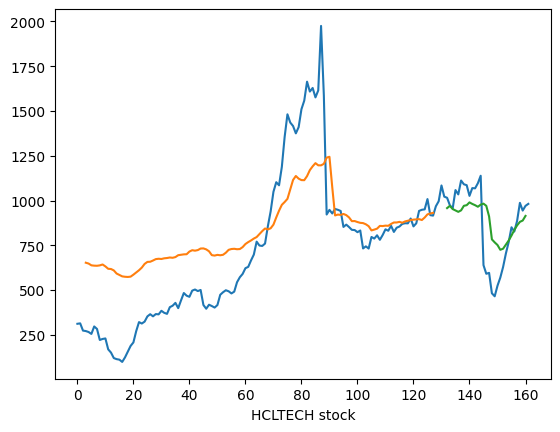

Epoch 1/20
2/2 [==============================] - 5s 926ms/step - loss: 0.1770 - val_loss: 0.3773
Epoch 2/20
2/2 [==============================] - 0s 37ms/step - loss: 0.1672 - val_loss: 0.3578
Epoch 3/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1574 - val_loss: 0.3383
Epoch 4/20
2/2 [==============================] - 0s 41ms/step - loss: 0.1482 - val_loss: 0.3183
Epoch 5/20
2/2 [==============================] - 0s 37ms/step - loss: 0.1386 - val_loss: 0.2979
Epoch 6/20
2/2 [==============================] - 0s 46ms/step - loss: 0.1294 - val_loss: 0.2768
Epoch 7/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1192 - val_loss: 0.2550
Epoch 8/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1096 - val_loss: 0.2324
Epoch 9/20
2/2 [==============================] - 0s 46ms/step - loss: 0.0998 - val_loss: 0.2089
Epoch 10/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0908 - val_loss: 0.1847
Epoch 11/20
2/2 [===========

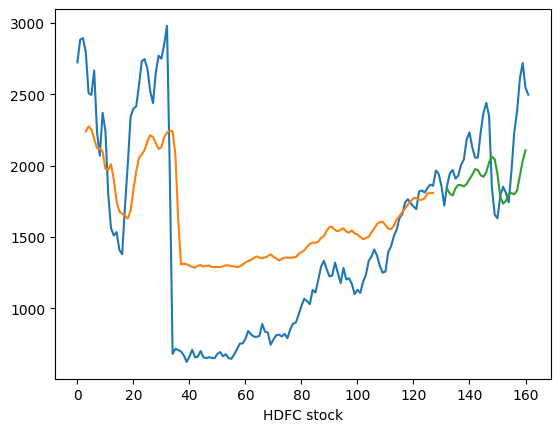

Epoch 1/20
2/2 [==============================] - 7s 984ms/step - loss: 0.2288 - val_loss: 0.3804
Epoch 2/20
2/2 [==============================] - 0s 47ms/step - loss: 0.2198 - val_loss: 0.3660
Epoch 3/20
2/2 [==============================] - 0s 46ms/step - loss: 0.2106 - val_loss: 0.3517
Epoch 4/20
2/2 [==============================] - 0s 40ms/step - loss: 0.2014 - val_loss: 0.3371
Epoch 5/20
2/2 [==============================] - 0s 45ms/step - loss: 0.1921 - val_loss: 0.3222
Epoch 6/20
2/2 [==============================] - 0s 40ms/step - loss: 0.1825 - val_loss: 0.3066
Epoch 7/20
2/2 [==============================] - 0s 43ms/step - loss: 0.1731 - val_loss: 0.2901
Epoch 8/20
2/2 [==============================] - 0s 45ms/step - loss: 0.1629 - val_loss: 0.2728
Epoch 9/20
2/2 [==============================] - 0s 45ms/step - loss: 0.1524 - val_loss: 0.2544
Epoch 10/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1413 - val_loss: 0.2349
Epoch 11/20
2/2 [===========

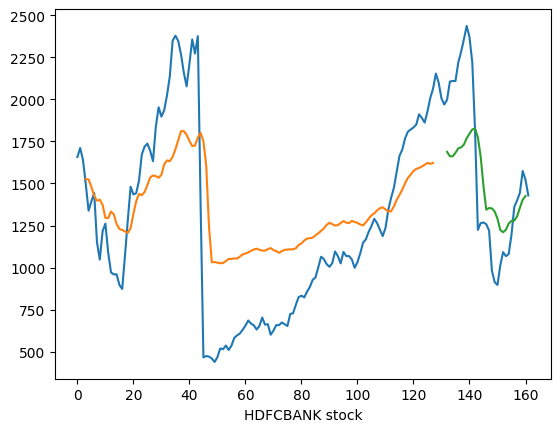

Epoch 1/20
2/2 [==============================] - 5s 946ms/step - loss: 0.2781 - val_loss: 0.3670
Epoch 2/20
2/2 [==============================] - 0s 60ms/step - loss: 0.2606 - val_loss: 0.3436
Epoch 3/20
2/2 [==============================] - 0s 39ms/step - loss: 0.2433 - val_loss: 0.3201
Epoch 4/20
2/2 [==============================] - 0s 44ms/step - loss: 0.2262 - val_loss: 0.2963
Epoch 5/20
2/2 [==============================] - 0s 39ms/step - loss: 0.2089 - val_loss: 0.2722
Epoch 6/20
2/2 [==============================] - 0s 51ms/step - loss: 0.1912 - val_loss: 0.2474
Epoch 7/20
2/2 [==============================] - 0s 41ms/step - loss: 0.1734 - val_loss: 0.2221
Epoch 8/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1551 - val_loss: 0.1962
Epoch 9/20
2/2 [==============================] - 0s 39ms/step - loss: 0.1365 - val_loss: 0.1697
Epoch 10/20
2/2 [==============================] - 0s 43ms/step - loss: 0.1189 - val_loss: 0.1429
Epoch 11/20
2/2 [===========

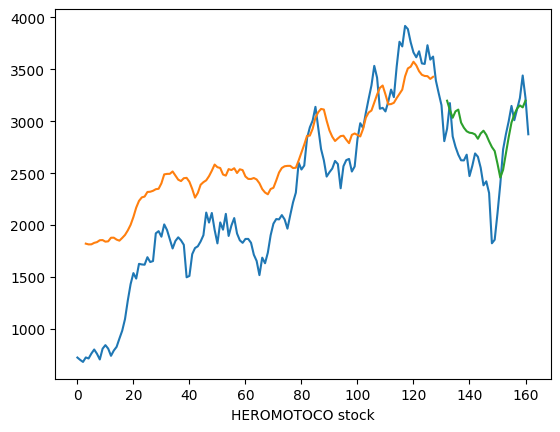

Epoch 1/20
2/2 [==============================] - 7s 962ms/step - loss: 0.1334 - val_loss: 0.2566
Epoch 2/20
2/2 [==============================] - 0s 41ms/step - loss: 0.1260 - val_loss: 0.2443
Epoch 3/20
2/2 [==============================] - 0s 43ms/step - loss: 0.1184 - val_loss: 0.2321
Epoch 4/20
2/2 [==============================] - 0s 37ms/step - loss: 0.1110 - val_loss: 0.2200
Epoch 5/20
2/2 [==============================] - 0s 37ms/step - loss: 0.1039 - val_loss: 0.2076
Epoch 6/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0963 - val_loss: 0.1949
Epoch 7/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0892 - val_loss: 0.1819
Epoch 8/20
2/2 [==============================] - 0s 38ms/step - loss: 0.0817 - val_loss: 0.1685
Epoch 9/20
2/2 [==============================] - 0s 41ms/step - loss: 0.0740 - val_loss: 0.1547
Epoch 10/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0665 - val_loss: 0.1405
Epoch 11/20
2/2 [===========

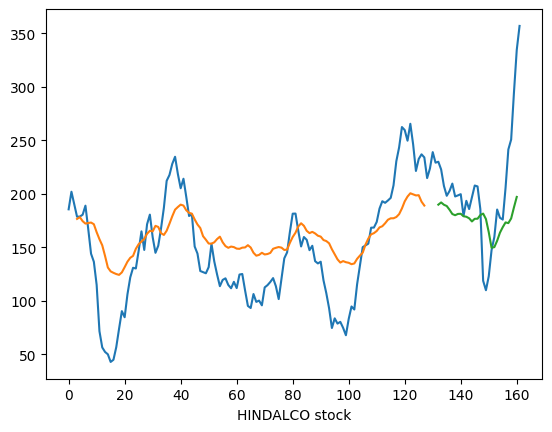

Epoch 1/20
2/2 [==============================] - 6s 920ms/step - loss: 0.0535 - val_loss: 0.6375
Epoch 2/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0496 - val_loss: 0.6112
Epoch 3/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0457 - val_loss: 0.5843
Epoch 4/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0420 - val_loss: 0.5567
Epoch 5/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0383 - val_loss: 0.5283
Epoch 6/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0347 - val_loss: 0.4990
Epoch 7/20
2/2 [==============================] - 0s 57ms/step - loss: 0.0313 - val_loss: 0.4687
Epoch 8/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0280 - val_loss: 0.4375
Epoch 9/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0250 - val_loss: 0.4055
Epoch 10/20
2/2 [==============================] - 0s 48ms/step - loss: 0.0223 - val_loss: 0.3730
Epoch 11/20
2/2 [===========

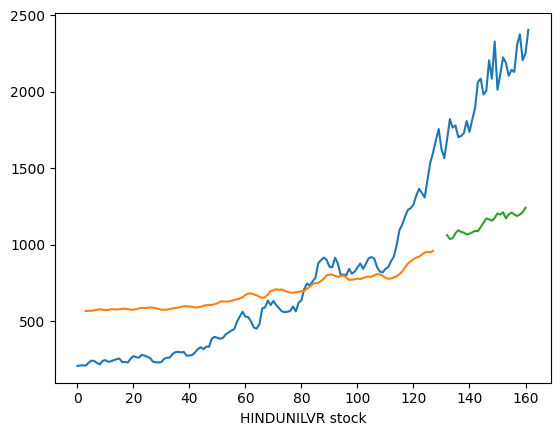

Epoch 1/20
2/2 [==============================] - 7s 1s/step - loss: 0.1841 - val_loss: 0.0232
Epoch 2/20
2/2 [==============================] - 0s 59ms/step - loss: 0.1727 - val_loss: 0.0198
Epoch 3/20
2/2 [==============================] - 0s 66ms/step - loss: 0.1624 - val_loss: 0.0167
Epoch 4/20
2/2 [==============================] - 0s 62ms/step - loss: 0.1516 - val_loss: 0.0138
Epoch 5/20
2/2 [==============================] - 0s 45ms/step - loss: 0.1413 - val_loss: 0.0111
Epoch 6/20
2/2 [==============================] - 0s 80ms/step - loss: 0.1305 - val_loss: 0.0087
Epoch 7/20
2/2 [==============================] - 0s 73ms/step - loss: 0.1201 - val_loss: 0.0066
Epoch 8/20
2/2 [==============================] - 0s 66ms/step - loss: 0.1093 - val_loss: 0.0049
Epoch 9/20
2/2 [==============================] - 0s 109ms/step - loss: 0.0986 - val_loss: 0.0035
Epoch 10/20
2/2 [==============================] - 0s 64ms/step - loss: 0.0882 - val_loss: 0.0027
Epoch 11/20
2/2 [=============

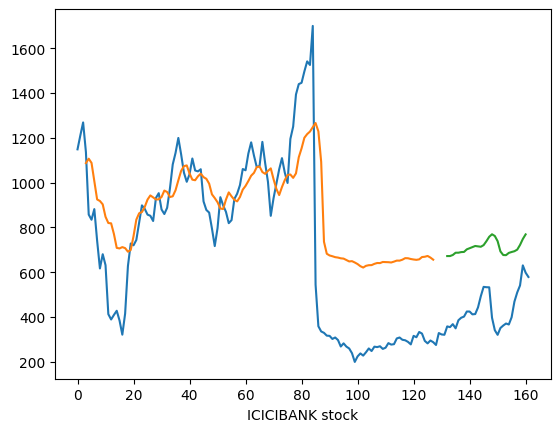

Epoch 1/20
2/2 [==============================] - 5s 933ms/step - loss: 0.1619 - val_loss: 0.3612
Epoch 2/20
2/2 [==============================] - 0s 49ms/step - loss: 0.1567 - val_loss: 0.3509
Epoch 3/20
2/2 [==============================] - 0s 39ms/step - loss: 0.1517 - val_loss: 0.3406
Epoch 4/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1468 - val_loss: 0.3302
Epoch 5/20
2/2 [==============================] - 0s 46ms/step - loss: 0.1418 - val_loss: 0.3195
Epoch 6/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1367 - val_loss: 0.3085
Epoch 7/20
2/2 [==============================] - 0s 51ms/step - loss: 0.1316 - val_loss: 0.2969
Epoch 8/20
2/2 [==============================] - 0s 45ms/step - loss: 0.1262 - val_loss: 0.2847
Epoch 9/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1207 - val_loss: 0.2718
Epoch 10/20
2/2 [==============================] - 0s 47ms/step - loss: 0.1149 - val_loss: 0.2580
Epoch 11/20
2/2 [===========

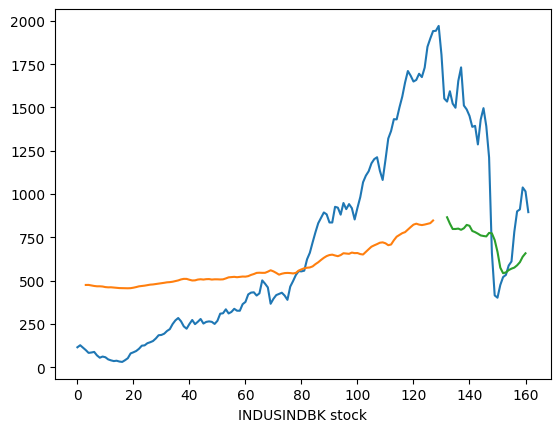

Epoch 1/20
2/2 [==============================] - 6s 937ms/step - loss: 0.2209 - val_loss: 0.0056
Epoch 2/20
2/2 [==============================] - 0s 45ms/step - loss: 0.2088 - val_loss: 0.0047
Epoch 3/20
2/2 [==============================] - 0s 51ms/step - loss: 0.1969 - val_loss: 0.0040
Epoch 4/20
2/2 [==============================] - 0s 49ms/step - loss: 0.1848 - val_loss: 0.0035
Epoch 5/20
2/2 [==============================] - 0s 49ms/step - loss: 0.1725 - val_loss: 0.0033
Epoch 6/20
2/2 [==============================] - 0s 49ms/step - loss: 0.1598 - val_loss: 0.0034
Epoch 7/20
2/2 [==============================] - 0s 55ms/step - loss: 0.1471 - val_loss: 0.0038
Epoch 8/20
2/2 [==============================] - 0s 45ms/step - loss: 0.1340 - val_loss: 0.0047
Epoch 9/20
2/2 [==============================] - 0s 47ms/step - loss: 0.1206 - val_loss: 0.0061
Epoch 10/20
2/2 [==============================] - 0s 49ms/step - loss: 0.1074 - val_loss: 0.0082
Epoch 11/20
2/2 [===========

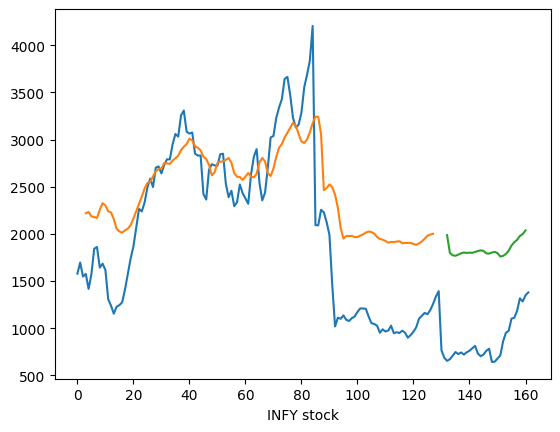

Epoch 1/20
2/2 [==============================] - 5s 927ms/step - loss: 0.2535 - val_loss: 0.0050
Epoch 2/20
2/2 [==============================] - 0s 44ms/step - loss: 0.2314 - val_loss: 0.0035
Epoch 3/20
2/2 [==============================] - 0s 45ms/step - loss: 0.2104 - val_loss: 0.0025
Epoch 4/20
2/2 [==============================] - 0s 59ms/step - loss: 0.1894 - val_loss: 0.0021
Epoch 5/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1694 - val_loss: 0.0022
Epoch 6/20
2/2 [==============================] - 0s 51ms/step - loss: 0.1490 - val_loss: 0.0032
Epoch 7/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1287 - val_loss: 0.0049
Epoch 8/20
2/2 [==============================] - 0s 43ms/step - loss: 0.1093 - val_loss: 0.0078
Epoch 9/20
2/2 [==============================] - 0s 40ms/step - loss: 0.0902 - val_loss: 0.0119
Epoch 10/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0718 - val_loss: 0.0174
Epoch 11/20
2/2 [===========

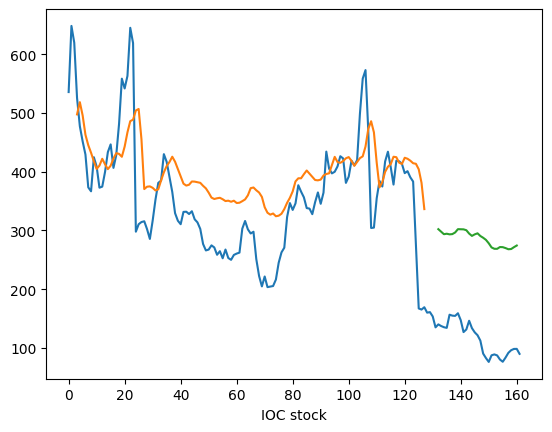

Epoch 1/20
2/2 [==============================] - 6s 941ms/step - loss: 0.2990 - val_loss: 0.1394
Epoch 2/20
2/2 [==============================] - 0s 60ms/step - loss: 0.2852 - val_loss: 0.1310
Epoch 3/20
2/2 [==============================] - 0s 44ms/step - loss: 0.2719 - val_loss: 0.1224
Epoch 4/20
2/2 [==============================] - 0s 44ms/step - loss: 0.2578 - val_loss: 0.1138
Epoch 5/20
2/2 [==============================] - 0s 61ms/step - loss: 0.2437 - val_loss: 0.1049
Epoch 6/20
2/2 [==============================] - 0s 50ms/step - loss: 0.2286 - val_loss: 0.0959
Epoch 7/20
2/2 [==============================] - 0s 47ms/step - loss: 0.2136 - val_loss: 0.0867
Epoch 8/20
2/2 [==============================] - 0s 46ms/step - loss: 0.1970 - val_loss: 0.0773
Epoch 9/20
2/2 [==============================] - 0s 46ms/step - loss: 0.1809 - val_loss: 0.0678
Epoch 10/20
2/2 [==============================] - 0s 47ms/step - loss: 0.1622 - val_loss: 0.0583
Epoch 11/20
2/2 [===========

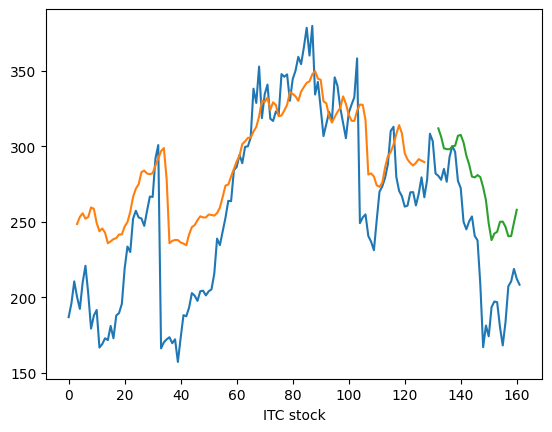

Epoch 1/20
2/2 [==============================] - 5s 938ms/step - loss: 0.2207 - val_loss: 0.0053
Epoch 2/20
2/2 [==============================] - 0s 41ms/step - loss: 0.2077 - val_loss: 0.0040
Epoch 3/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1959 - val_loss: 0.0030
Epoch 4/20
2/2 [==============================] - 0s 38ms/step - loss: 0.1839 - val_loss: 0.0023
Epoch 5/20
2/2 [==============================] - 0s 42ms/step - loss: 0.1721 - val_loss: 0.0018
Epoch 6/20
2/2 [==============================] - 0s 37ms/step - loss: 0.1598 - val_loss: 0.0015
Epoch 7/20
2/2 [==============================] - 0s 45ms/step - loss: 0.1478 - val_loss: 0.0017
Epoch 8/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1360 - val_loss: 0.0022
Epoch 9/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1235 - val_loss: 0.0033
Epoch 10/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1116 - val_loss: 0.0049
Epoch 11/20
2/2 [===========

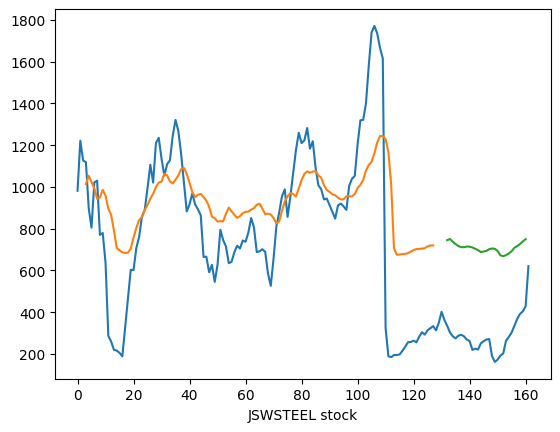

Epoch 1/20
2/2 [==============================] - 6s 960ms/step - loss: 0.1039 - val_loss: 0.5399
Epoch 2/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0976 - val_loss: 0.5194
Epoch 3/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0913 - val_loss: 0.4985
Epoch 4/20
2/2 [==============================] - 0s 60ms/step - loss: 0.0850 - val_loss: 0.4770
Epoch 5/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0789 - val_loss: 0.4547
Epoch 6/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0726 - val_loss: 0.4313
Epoch 7/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0659 - val_loss: 0.4067
Epoch 8/20
2/2 [==============================] - 0s 61ms/step - loss: 0.0596 - val_loss: 0.3808
Epoch 9/20
2/2 [==============================] - 0s 50ms/step - loss: 0.0532 - val_loss: 0.3534
Epoch 10/20
2/2 [==============================] - 0s 62ms/step - loss: 0.0465 - val_loss: 0.3246
Epoch 11/20
2/2 [===========

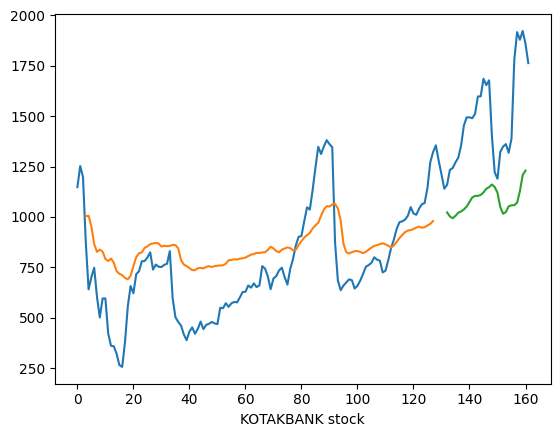

Epoch 1/20
2/2 [==============================] - 5s 909ms/step - loss: 0.0802 - val_loss: 0.0320
Epoch 2/20
2/2 [==============================] - 0s 58ms/step - loss: 0.0746 - val_loss: 0.0286
Epoch 3/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0691 - val_loss: 0.0253
Epoch 4/20
2/2 [==============================] - 0s 61ms/step - loss: 0.0637 - val_loss: 0.0222
Epoch 5/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0585 - val_loss: 0.0192
Epoch 6/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0532 - val_loss: 0.0162
Epoch 7/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0478 - val_loss: 0.0135
Epoch 8/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0428 - val_loss: 0.0108
Epoch 9/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0373 - val_loss: 0.0085
Epoch 10/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0325 - val_loss: 0.0064
Epoch 11/20
2/2 [===========

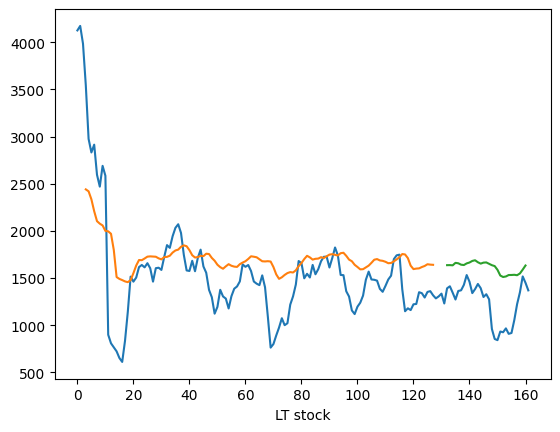

Epoch 1/20
2/2 [==============================] - 6s 946ms/step - loss: 0.3707 - val_loss: 0.0870
Epoch 2/20
2/2 [==============================] - 0s 46ms/step - loss: 0.3570 - val_loss: 0.0814
Epoch 3/20
2/2 [==============================] - 0s 49ms/step - loss: 0.3430 - val_loss: 0.0759
Epoch 4/20
2/2 [==============================] - 0s 48ms/step - loss: 0.3292 - val_loss: 0.0703
Epoch 5/20
2/2 [==============================] - 0s 53ms/step - loss: 0.3147 - val_loss: 0.0648
Epoch 6/20
2/2 [==============================] - 0s 47ms/step - loss: 0.2998 - val_loss: 0.0591
Epoch 7/20
2/2 [==============================] - 0s 44ms/step - loss: 0.2842 - val_loss: 0.0534
Epoch 8/20
2/2 [==============================] - 0s 57ms/step - loss: 0.2683 - val_loss: 0.0476
Epoch 9/20
2/2 [==============================] - 0s 49ms/step - loss: 0.2510 - val_loss: 0.0418
Epoch 10/20
2/2 [==============================] - 0s 48ms/step - loss: 0.2331 - val_loss: 0.0360
Epoch 11/20
2/2 [===========

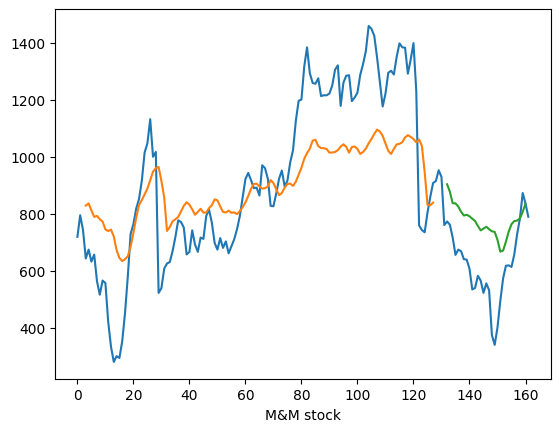

Epoch 1/20
2/2 [==============================] - 7s 2s/step - loss: 0.1433 - val_loss: 0.4799
Epoch 2/20
2/2 [==============================] - 0s 55ms/step - loss: 0.1368 - val_loss: 0.4605
Epoch 3/20
2/2 [==============================] - 0s 53ms/step - loss: 0.1304 - val_loss: 0.4411
Epoch 4/20
2/2 [==============================] - 0s 71ms/step - loss: 0.1242 - val_loss: 0.4213
Epoch 5/20
2/2 [==============================] - 0s 51ms/step - loss: 0.1178 - val_loss: 0.4010
Epoch 6/20
2/2 [==============================] - 0s 66ms/step - loss: 0.1114 - val_loss: 0.3798
Epoch 7/20
2/2 [==============================] - 0s 51ms/step - loss: 0.1050 - val_loss: 0.3577
Epoch 8/20
2/2 [==============================] - 0s 60ms/step - loss: 0.0986 - val_loss: 0.3343
Epoch 9/20
2/2 [==============================] - 0s 50ms/step - loss: 0.0914 - val_loss: 0.3097
Epoch 10/20
2/2 [==============================] - 0s 55ms/step - loss: 0.0850 - val_loss: 0.2835
Epoch 11/20
2/2 [==============

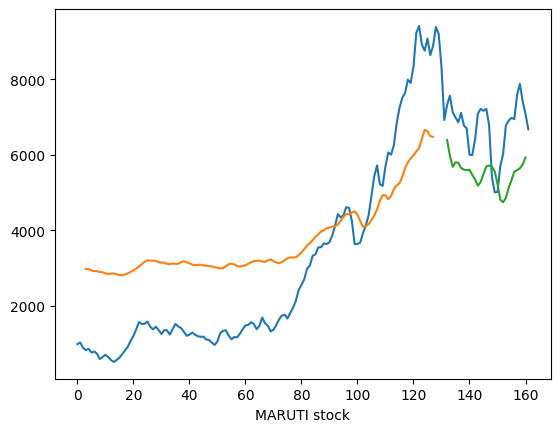

Epoch 1/20
2/2 [==============================] - 6s 938ms/step - loss: 0.0338 - val_loss: 0.5774
Epoch 2/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0310 - val_loss: 0.5568
Epoch 3/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0284 - val_loss: 0.5357
Epoch 4/20
2/2 [==============================] - 0s 48ms/step - loss: 0.0257 - val_loss: 0.5139
Epoch 5/20
2/2 [==============================] - 0s 63ms/step - loss: 0.0231 - val_loss: 0.4913
Epoch 6/20
2/2 [==============================] - 0s 53ms/step - loss: 0.0208 - val_loss: 0.4675
Epoch 7/20
2/2 [==============================] - 0s 52ms/step - loss: 0.0184 - val_loss: 0.4425
Epoch 8/20
2/2 [==============================] - 0s 61ms/step - loss: 0.0162 - val_loss: 0.4163
Epoch 9/20
2/2 [==============================] - 0s 51ms/step - loss: 0.0142 - val_loss: 0.3889
Epoch 10/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0124 - val_loss: 0.3603
Epoch 11/20
2/2 [===========

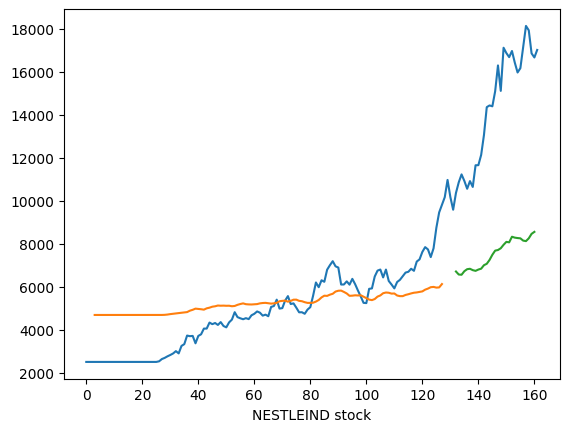

Epoch 1/20
2/2 [==============================] - 5s 1s/step - loss: 0.2782 - val_loss: 0.0468
Epoch 2/20
2/2 [==============================] - 0s 75ms/step - loss: 0.2669 - val_loss: 0.0434
Epoch 3/20
2/2 [==============================] - 0s 72ms/step - loss: 0.2553 - val_loss: 0.0400
Epoch 4/20
2/2 [==============================] - 0s 55ms/step - loss: 0.2436 - val_loss: 0.0366
Epoch 5/20
2/2 [==============================] - 0s 64ms/step - loss: 0.2315 - val_loss: 0.0333
Epoch 6/20
2/2 [==============================] - 0s 61ms/step - loss: 0.2189 - val_loss: 0.0300
Epoch 7/20
2/2 [==============================] - 0s 74ms/step - loss: 0.2056 - val_loss: 0.0266
Epoch 8/20
2/2 [==============================] - 0s 46ms/step - loss: 0.1916 - val_loss: 0.0234
Epoch 9/20
2/2 [==============================] - 0s 70ms/step - loss: 0.1766 - val_loss: 0.0202
Epoch 10/20
2/2 [==============================] - 0s 58ms/step - loss: 0.1610 - val_loss: 0.0172
Epoch 11/20
2/2 [==============

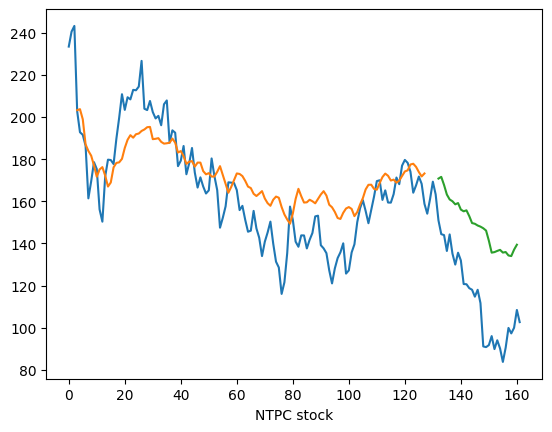

Epoch 1/20
2/2 [==============================] - 6s 1s/step - loss: 0.1818 - val_loss: 0.0013
Epoch 2/20
2/2 [==============================] - 0s 100ms/step - loss: 0.1726 - val_loss: 8.5700e-04
Epoch 3/20
2/2 [==============================] - 0s 81ms/step - loss: 0.1633 - val_loss: 6.3007e-04
Epoch 4/20
2/2 [==============================] - 0s 83ms/step - loss: 0.1548 - val_loss: 6.1455e-04
Epoch 5/20
2/2 [==============================] - 0s 75ms/step - loss: 0.1465 - val_loss: 8.3113e-04
Epoch 6/20
2/2 [==============================] - 0s 75ms/step - loss: 0.1386 - val_loss: 0.0013
Epoch 7/20
2/2 [==============================] - 0s 79ms/step - loss: 0.1293 - val_loss: 0.0021
Epoch 8/20
2/2 [==============================] - 0s 63ms/step - loss: 0.1207 - val_loss: 0.0032
Epoch 9/20
2/2 [==============================] - 0s 63ms/step - loss: 0.1125 - val_loss: 0.0047
Epoch 10/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1030 - val_loss: 0.0066
Epoch 11/20
2/

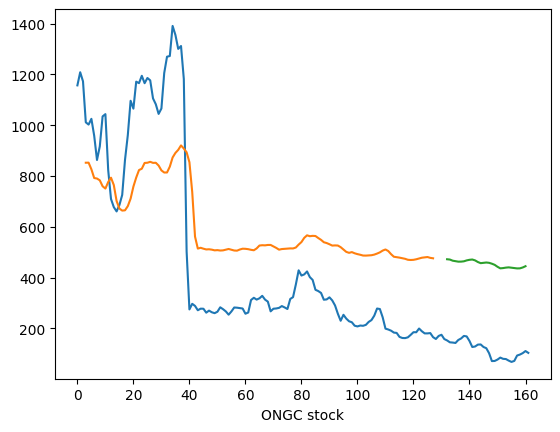

Epoch 1/20
2/2 [==============================] - 6s 2s/step - loss: 0.1984 - val_loss: 0.5847
Epoch 2/20
2/2 [==============================] - 0s 55ms/step - loss: 0.1916 - val_loss: 0.5681
Epoch 3/20
2/2 [==============================] - 0s 58ms/step - loss: 0.1847 - val_loss: 0.5511
Epoch 4/20
2/2 [==============================] - 0s 55ms/step - loss: 0.1777 - val_loss: 0.5333
Epoch 5/20
2/2 [==============================] - 0s 55ms/step - loss: 0.1705 - val_loss: 0.5147
Epoch 6/20
2/2 [==============================] - 0s 50ms/step - loss: 0.1629 - val_loss: 0.4950
Epoch 7/20
2/2 [==============================] - 0s 71ms/step - loss: 0.1552 - val_loss: 0.4741
Epoch 8/20
2/2 [==============================] - 0s 51ms/step - loss: 0.1468 - val_loss: 0.4519
Epoch 9/20
2/2 [==============================] - 0s 70ms/step - loss: 0.1378 - val_loss: 0.4282
Epoch 10/20
2/2 [==============================] - 0s 61ms/step - loss: 0.1290 - val_loss: 0.4027
Epoch 11/20
2/2 [==============

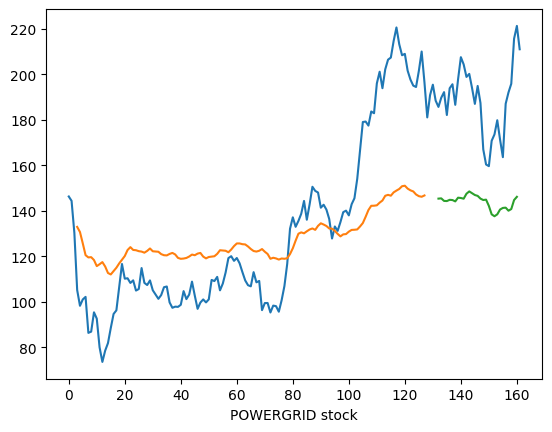

Epoch 1/20
2/2 [==============================] - 5s 961ms/step - loss: 0.0780 - val_loss: 0.1742
Epoch 2/20
2/2 [==============================] - 0s 54ms/step - loss: 0.0723 - val_loss: 0.1632
Epoch 3/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0670 - val_loss: 0.1523
Epoch 4/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0622 - val_loss: 0.1412
Epoch 5/20
2/2 [==============================] - 0s 66ms/step - loss: 0.0572 - val_loss: 0.1299
Epoch 6/20
2/2 [==============================] - 0s 48ms/step - loss: 0.0521 - val_loss: 0.1185
Epoch 7/20
2/2 [==============================] - 0s 65ms/step - loss: 0.0479 - val_loss: 0.1068
Epoch 8/20
2/2 [==============================] - 0s 57ms/step - loss: 0.0426 - val_loss: 0.0952
Epoch 9/20
2/2 [==============================] - 0s 46ms/step - loss: 0.0386 - val_loss: 0.0835
Epoch 10/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0344 - val_loss: 0.0719
Epoch 11/20
2/2 [===========

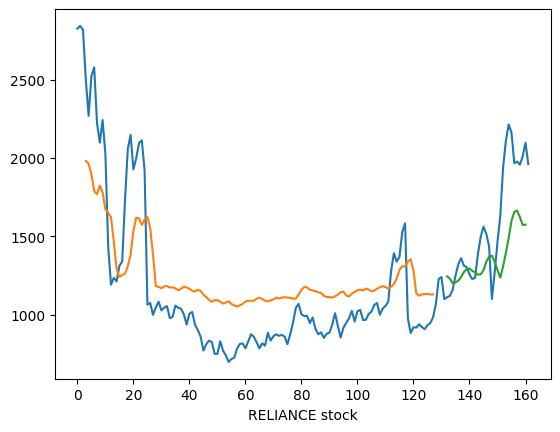

Epoch 1/20
2/2 [==============================] - 7s 2s/step - loss: 0.2807 - val_loss: 0.0013
Epoch 2/20
2/2 [==============================] - 0s 53ms/step - loss: 0.2697 - val_loss: 8.7328e-04
Epoch 3/20
2/2 [==============================] - 0s 52ms/step - loss: 0.2588 - val_loss: 5.8301e-04
Epoch 4/20
2/2 [==============================] - 0s 45ms/step - loss: 0.2488 - val_loss: 4.3083e-04
Epoch 5/20
2/2 [==============================] - 0s 47ms/step - loss: 0.2389 - val_loss: 4.1943e-04
Epoch 6/20
2/2 [==============================] - 0s 66ms/step - loss: 0.2294 - val_loss: 5.5869e-04
Epoch 7/20
2/2 [==============================] - 0s 44ms/step - loss: 0.2200 - val_loss: 8.6713e-04
Epoch 8/20
2/2 [==============================] - 0s 47ms/step - loss: 0.2104 - val_loss: 0.0014
Epoch 9/20
2/2 [==============================] - 0s 62ms/step - loss: 0.2005 - val_loss: 0.0021
Epoch 10/20
2/2 [==============================] - 0s 62ms/step - loss: 0.1898 - val_loss: 0.0031
Epoch 1

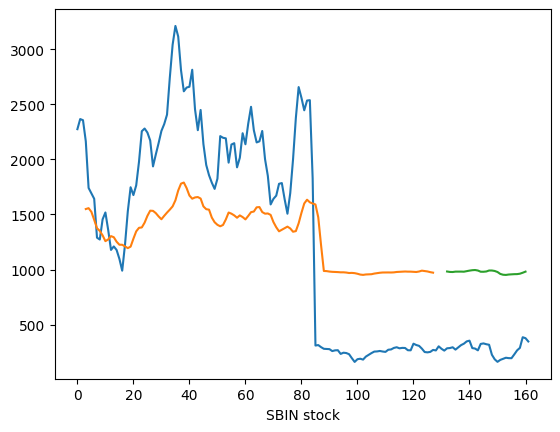

Epoch 1/20
2/2 [==============================] - 6s 943ms/step - loss: 0.0907 - val_loss: 0.4745
Epoch 2/20
2/2 [==============================] - 0s 50ms/step - loss: 0.0844 - val_loss: 0.4511
Epoch 3/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0787 - val_loss: 0.4280
Epoch 4/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0733 - val_loss: 0.4050
Epoch 5/20
2/2 [==============================] - 0s 55ms/step - loss: 0.0674 - val_loss: 0.3822
Epoch 6/20
2/2 [==============================] - 0s 54ms/step - loss: 0.0625 - val_loss: 0.3590
Epoch 7/20
2/2 [==============================] - 0s 48ms/step - loss: 0.0573 - val_loss: 0.3353
Epoch 8/20
2/2 [==============================] - 0s 48ms/step - loss: 0.0521 - val_loss: 0.3113
Epoch 9/20
2/2 [==============================] - 0s 61ms/step - loss: 0.0477 - val_loss: 0.2864
Epoch 10/20
2/2 [==============================] - 0s 46ms/step - loss: 0.0431 - val_loss: 0.2610
Epoch 11/20
2/2 [===========

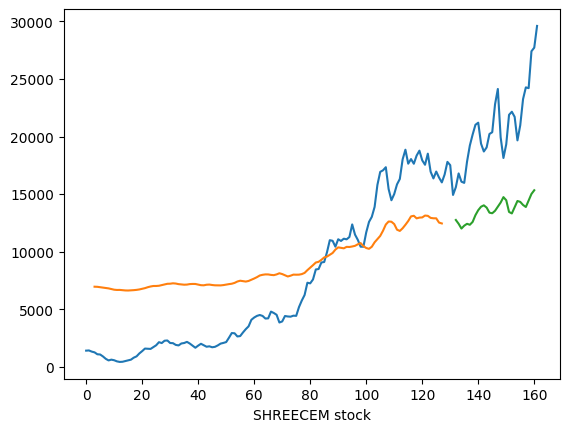

Epoch 1/20
2/2 [==============================] - 7s 3s/step - loss: 0.1373 - val_loss: 0.0042
Epoch 2/20
2/2 [==============================] - 0s 46ms/step - loss: 0.1316 - val_loss: 0.0035
Epoch 3/20
2/2 [==============================] - 0s 47ms/step - loss: 0.1262 - val_loss: 0.0028
Epoch 4/20
2/2 [==============================] - 0s 49ms/step - loss: 0.1202 - val_loss: 0.0023
Epoch 5/20
2/2 [==============================] - 0s 48ms/step - loss: 0.1148 - val_loss: 0.0018
Epoch 6/20
2/2 [==============================] - 0s 52ms/step - loss: 0.1089 - val_loss: 0.0015
Epoch 7/20
2/2 [==============================] - 0s 51ms/step - loss: 0.1027 - val_loss: 0.0014
Epoch 8/20
2/2 [==============================] - 0s 50ms/step - loss: 0.0966 - val_loss: 0.0014
Epoch 9/20
2/2 [==============================] - 0s 49ms/step - loss: 0.0897 - val_loss: 0.0016
Epoch 10/20
2/2 [==============================] - 0s 53ms/step - loss: 0.0827 - val_loss: 0.0022
Epoch 11/20
2/2 [==============

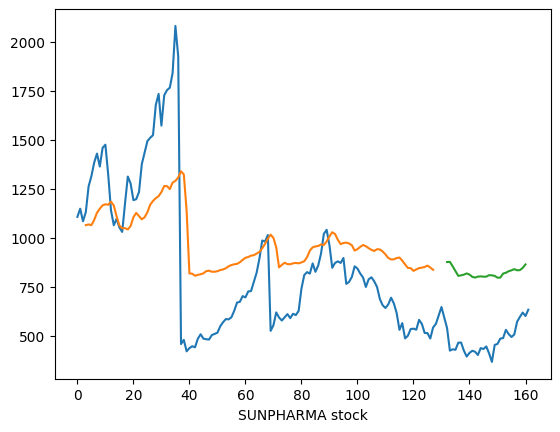

Epoch 1/20
2/2 [==============================] - 5s 933ms/step - loss: 0.1518 - val_loss: 0.0060
Epoch 2/20
2/2 [==============================] - 0s 57ms/step - loss: 0.1449 - val_loss: 0.0051
Epoch 3/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1377 - val_loss: 0.0042
Epoch 4/20
2/2 [==============================] - 0s 64ms/step - loss: 0.1308 - val_loss: 0.0034
Epoch 5/20
2/2 [==============================] - 0s 43ms/step - loss: 0.1234 - val_loss: 0.0028
Epoch 6/20
2/2 [==============================] - 0s 59ms/step - loss: 0.1162 - val_loss: 0.0024
Epoch 7/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1086 - val_loss: 0.0021
Epoch 8/20
2/2 [==============================] - 0s 47ms/step - loss: 0.1012 - val_loss: 0.0020
Epoch 9/20
2/2 [==============================] - 0s 62ms/step - loss: 0.0936 - val_loss: 0.0022
Epoch 10/20
2/2 [==============================] - 0s 64ms/step - loss: 0.0855 - val_loss: 0.0028
Epoch 11/20
2/2 [===========

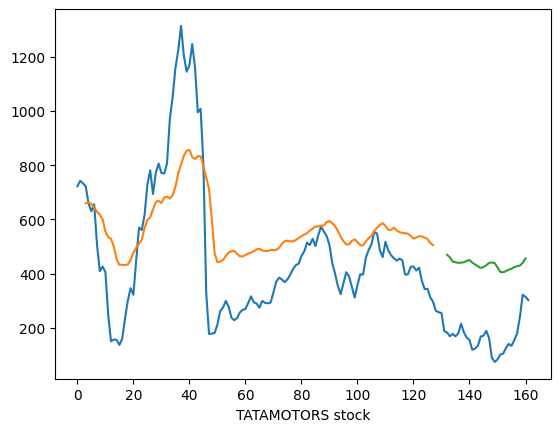

Epoch 1/20
2/2 [==============================] - 7s 1s/step - loss: 0.1837 - val_loss: 0.1649
Epoch 2/20
2/2 [==============================] - 0s 69ms/step - loss: 0.1751 - val_loss: 0.1563
Epoch 3/20
2/2 [==============================] - 0s 69ms/step - loss: 0.1661 - val_loss: 0.1477
Epoch 4/20
2/2 [==============================] - 0s 62ms/step - loss: 0.1572 - val_loss: 0.1391
Epoch 5/20
2/2 [==============================] - 0s 98ms/step - loss: 0.1482 - val_loss: 0.1303
Epoch 6/20
2/2 [==============================] - 0s 92ms/step - loss: 0.1388 - val_loss: 0.1213
Epoch 7/20
2/2 [==============================] - 0s 91ms/step - loss: 0.1293 - val_loss: 0.1120
Epoch 8/20
2/2 [==============================] - 0s 80ms/step - loss: 0.1194 - val_loss: 0.1024
Epoch 9/20
2/2 [==============================] - 0s 79ms/step - loss: 0.1095 - val_loss: 0.0925
Epoch 10/20
2/2 [==============================] - 0s 72ms/step - loss: 0.0989 - val_loss: 0.0824
Epoch 11/20
2/2 [==============

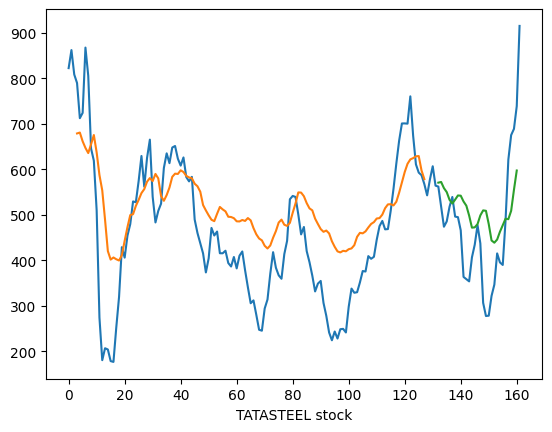

Epoch 1/20
2/2 [==============================] - 5s 919ms/step - loss: 0.2372 - val_loss: 0.3647
Epoch 2/20
2/2 [==============================] - 0s 46ms/step - loss: 0.2230 - val_loss: 0.3434
Epoch 3/20
2/2 [==============================] - 0s 44ms/step - loss: 0.2090 - val_loss: 0.3221
Epoch 4/20
2/2 [==============================] - 0s 46ms/step - loss: 0.1951 - val_loss: 0.3005
Epoch 5/20
2/2 [==============================] - 0s 65ms/step - loss: 0.1813 - val_loss: 0.2784
Epoch 6/20
2/2 [==============================] - 0s 47ms/step - loss: 0.1672 - val_loss: 0.2556
Epoch 7/20
2/2 [==============================] - 0s 47ms/step - loss: 0.1522 - val_loss: 0.2321
Epoch 8/20
2/2 [==============================] - 0s 46ms/step - loss: 0.1380 - val_loss: 0.2078
Epoch 9/20
2/2 [==============================] - 0s 64ms/step - loss: 0.1228 - val_loss: 0.1826
Epoch 10/20
2/2 [==============================] - 0s 46ms/step - loss: 0.1075 - val_loss: 0.1568
Epoch 11/20
2/2 [===========

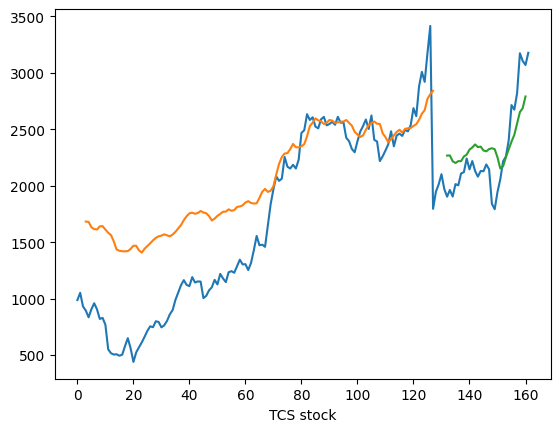

Epoch 1/20
2/2 [==============================] - 7s 1s/step - loss: 0.1014 - val_loss: 0.0357
Epoch 2/20
2/2 [==============================] - 0s 63ms/step - loss: 0.0953 - val_loss: 0.0319
Epoch 3/20
2/2 [==============================] - 0s 62ms/step - loss: 0.0898 - val_loss: 0.0282
Epoch 4/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0844 - val_loss: 0.0246
Epoch 5/20
2/2 [==============================] - 0s 63ms/step - loss: 0.0787 - val_loss: 0.0210
Epoch 6/20
2/2 [==============================] - 0s 74ms/step - loss: 0.0735 - val_loss: 0.0177
Epoch 7/20
2/2 [==============================] - 0s 65ms/step - loss: 0.0676 - val_loss: 0.0145
Epoch 8/20
2/2 [==============================] - 0s 53ms/step - loss: 0.0622 - val_loss: 0.0115
Epoch 9/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0569 - val_loss: 0.0087
Epoch 10/20
2/2 [==============================] - 0s 48ms/step - loss: 0.0518 - val_loss: 0.0063
Epoch 11/20
2/2 [==============

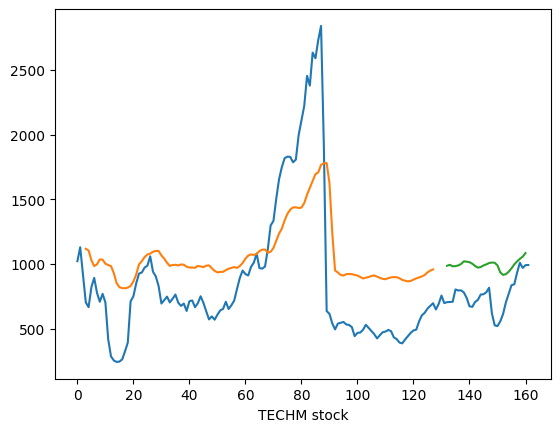

Epoch 1/20
2/2 [==============================] - 6s 946ms/step - loss: 0.0921 - val_loss: 0.0620
Epoch 2/20
2/2 [==============================] - 0s 46ms/step - loss: 0.0879 - val_loss: 0.0572
Epoch 3/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0840 - val_loss: 0.0525
Epoch 4/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0803 - val_loss: 0.0480
Epoch 5/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0765 - val_loss: 0.0435
Epoch 6/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0731 - val_loss: 0.0391
Epoch 7/20
2/2 [==============================] - 0s 48ms/step - loss: 0.0695 - val_loss: 0.0347
Epoch 8/20
2/2 [==============================] - 0s 60ms/step - loss: 0.0662 - val_loss: 0.0305
Epoch 9/20
2/2 [==============================] - 0s 51ms/step - loss: 0.0626 - val_loss: 0.0263
Epoch 10/20
2/2 [==============================] - 0s 61ms/step - loss: 0.0594 - val_loss: 0.0222
Epoch 11/20
2/2 [===========

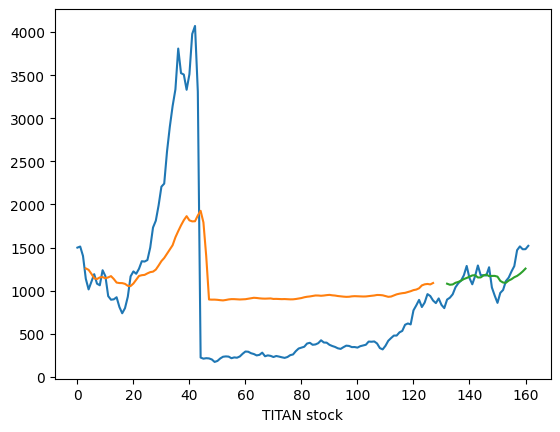

Epoch 1/20
2/2 [==============================] - 8s 1s/step - loss: 0.1067 - val_loss: 0.3823
Epoch 2/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0989 - val_loss: 0.3612
Epoch 3/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0912 - val_loss: 0.3402
Epoch 4/20
2/2 [==============================] - 0s 60ms/step - loss: 0.0837 - val_loss: 0.3193
Epoch 5/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0767 - val_loss: 0.2981
Epoch 6/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0697 - val_loss: 0.2766
Epoch 7/20
2/2 [==============================] - 0s 59ms/step - loss: 0.0624 - val_loss: 0.2548
Epoch 8/20
2/2 [==============================] - 0s 50ms/step - loss: 0.0558 - val_loss: 0.2325
Epoch 9/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0494 - val_loss: 0.2097
Epoch 10/20
2/2 [==============================] - 0s 46ms/step - loss: 0.0430 - val_loss: 0.1867
Epoch 11/20
2/2 [==============

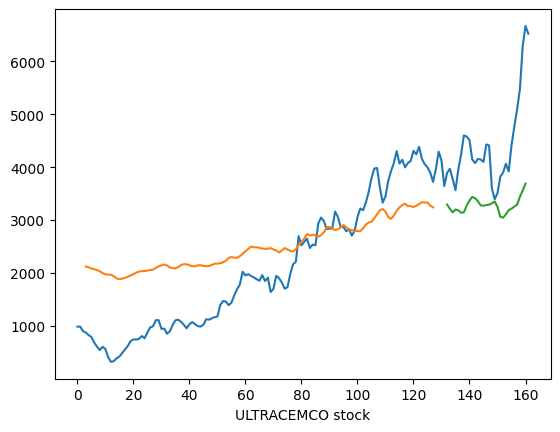

Epoch 1/20
2/2 [==============================] - 6s 1s/step - loss: 0.0945 - val_loss: 0.0570
Epoch 2/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0861 - val_loss: 0.0502
Epoch 3/20
2/2 [==============================] - 0s 46ms/step - loss: 0.0787 - val_loss: 0.0437
Epoch 4/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0712 - val_loss: 0.0374
Epoch 5/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0641 - val_loss: 0.0313
Epoch 6/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0570 - val_loss: 0.0255
Epoch 7/20
2/2 [==============================] - 0s 48ms/step - loss: 0.0502 - val_loss: 0.0199
Epoch 8/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0434 - val_loss: 0.0147
Epoch 9/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0376 - val_loss: 0.0100
Epoch 10/20
2/2 [==============================] - 0s 51ms/step - loss: 0.0311 - val_loss: 0.0060
Epoch 11/20
2/2 [==============

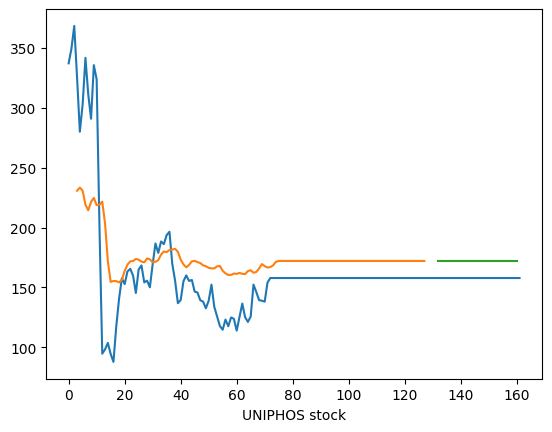

Epoch 1/20
2/2 [==============================] - 7s 1s/step - loss: 0.1180 - val_loss: 0.3246
Epoch 2/20
2/2 [==============================] - 0s 50ms/step - loss: 0.1113 - val_loss: 0.3070
Epoch 3/20
2/2 [==============================] - 0s 52ms/step - loss: 0.1058 - val_loss: 0.2892
Epoch 4/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0992 - val_loss: 0.2715
Epoch 5/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0931 - val_loss: 0.2537
Epoch 6/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0876 - val_loss: 0.2353
Epoch 7/20
2/2 [==============================] - 0s 56ms/step - loss: 0.0821 - val_loss: 0.2163
Epoch 8/20
2/2 [==============================] - 0s 45ms/step - loss: 0.0765 - val_loss: 0.1968
Epoch 9/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0711 - val_loss: 0.1769
Epoch 10/20
2/2 [==============================] - 0s 62ms/step - loss: 0.0652 - val_loss: 0.1568
Epoch 11/20
2/2 [==============

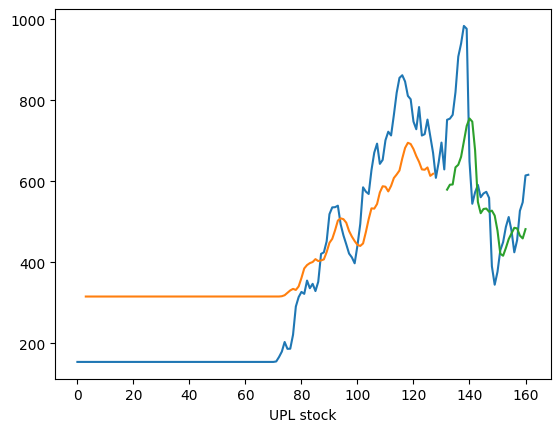

Epoch 1/20
2/2 [==============================] - 6s 1s/step - loss: 0.0364 - val_loss: 1.6314e-04
Epoch 2/20
2/2 [==============================] - 0s 51ms/step - loss: 0.0341 - val_loss: 8.7954e-05
Epoch 3/20
2/2 [==============================] - 0s 47ms/step - loss: 0.0324 - val_loss: 2.3516e-04
Epoch 4/20
2/2 [==============================] - 0s 39ms/step - loss: 0.0307 - val_loss: 5.8933e-04
Epoch 5/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0297 - val_loss: 0.0011
Epoch 6/20
2/2 [==============================] - 0s 58ms/step - loss: 0.0284 - val_loss: 0.0018
Epoch 7/20
2/2 [==============================] - 0s 44ms/step - loss: 0.0275 - val_loss: 0.0026
Epoch 8/20
2/2 [==============================] - 0s 42ms/step - loss: 0.0269 - val_loss: 0.0034
Epoch 9/20
2/2 [==============================] - 0s 59ms/step - loss: 0.0263 - val_loss: 0.0041
Epoch 10/20
2/2 [==============================] - 0s 43ms/step - loss: 0.0258 - val_loss: 0.0047
Epoch 11/20
2/2

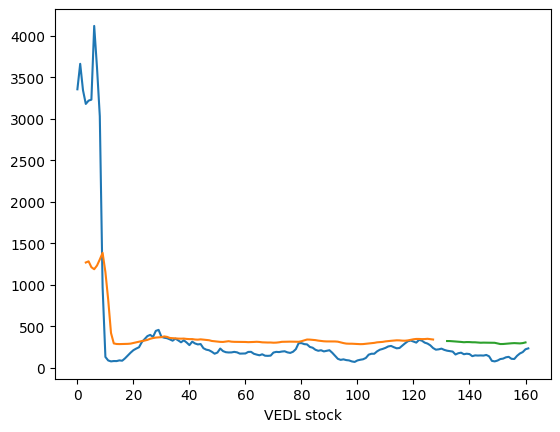

Epoch 1/20
2/2 [==============================] - 7s 1s/step - loss: 0.2940 - val_loss: 0.0506
Epoch 2/20
2/2 [==============================] - 0s 53ms/step - loss: 0.2786 - val_loss: 0.0460
Epoch 3/20
2/2 [==============================] - 0s 46ms/step - loss: 0.2628 - val_loss: 0.0415
Epoch 4/20
2/2 [==============================] - 0s 65ms/step - loss: 0.2464 - val_loss: 0.0372
Epoch 5/20
2/2 [==============================] - 0s 65ms/step - loss: 0.2302 - val_loss: 0.0330
Epoch 6/20
2/2 [==============================] - 0s 50ms/step - loss: 0.2132 - val_loss: 0.0289
Epoch 7/20
2/2 [==============================] - 0s 65ms/step - loss: 0.1958 - val_loss: 0.0251
Epoch 8/20
2/2 [==============================] - 0s 53ms/step - loss: 0.1776 - val_loss: 0.0215
Epoch 9/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1591 - val_loss: 0.0182
Epoch 10/20
2/2 [==============================] - 0s 43ms/step - loss: 0.1396 - val_loss: 0.0155
Epoch 11/20
2/2 [==============

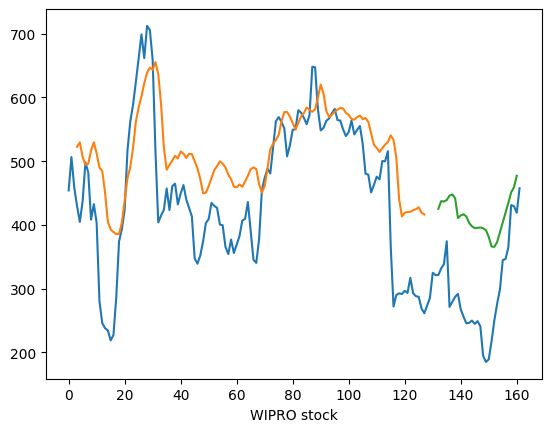

Epoch 1/20
2/2 [==============================] - 5s 1s/step - loss: 0.2382 - val_loss: 0.1715
Epoch 2/20
2/2 [==============================] - 0s 67ms/step - loss: 0.2301 - val_loss: 0.1641
Epoch 3/20
2/2 [==============================] - 0s 55ms/step - loss: 0.2218 - val_loss: 0.1567
Epoch 4/20
2/2 [==============================] - 0s 62ms/step - loss: 0.2138 - val_loss: 0.1493
Epoch 5/20
2/2 [==============================] - 0s 81ms/step - loss: 0.2051 - val_loss: 0.1418
Epoch 6/20
2/2 [==============================] - 0s 82ms/step - loss: 0.1965 - val_loss: 0.1340
Epoch 7/20
2/2 [==============================] - 0s 78ms/step - loss: 0.1878 - val_loss: 0.1259
Epoch 8/20
2/2 [==============================] - 0s 77ms/step - loss: 0.1782 - val_loss: 0.1176
Epoch 9/20
2/2 [==============================] - 0s 83ms/step - loss: 0.1695 - val_loss: 0.1089
Epoch 10/20
2/2 [==============================] - 0s 84ms/step - loss: 0.1589 - val_loss: 0.0999
Epoch 11/20
2/2 [==============

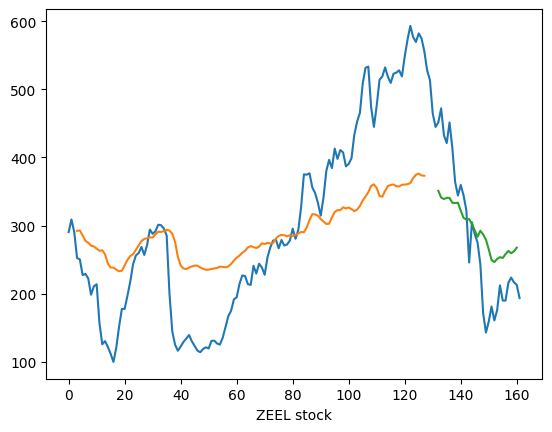

In [ ]:
for i in df.columns:
    scaler=MinMaxScaler(feature_range=(0,1))
    df1=scaler.fit_transform(np.array(df[i]).reshape(-1,1))


    train_data,test_data=df1[0:129],df1[129:len(df)]

    time_step = 3
    X_train, y_train = create_dataset(train_data, time_step)
    X_test, ytest = create_dataset(test_data, time_step)
    model=Sequential()
    model.add(LSTM(50,return_sequences=True,input_shape=(3,1)))
    model.add(LSTM(25,return_sequences=True))

    model.add(LSTM(5))
    model.add(Dense(1))
    model.compile(loss='mean_squared_error',optimizer='adam')
    model.fit(X_train,y_train,validation_data=(X_test,ytest),epochs=20,batch_size=64,verbose=1)
    train_predict=model.predict(X_train)
    test_predict=model.predict(X_test)



    train_predict=scaler.inverse_transform(train_predict)
    test_predict=scaler.inverse_transform(test_predict)
    mae = metrics.mean_absolute_error(ytest,test_predict)
    mse = metrics.mean_squared_error(ytest,test_predict)
    rmse = np.sqrt(mse) #mse**(0.5)

    print("Results of sklearn.metrics:")
    print("MAE:",mae)
    print("RMSE:", rmse)

    look_back=3
    trainPredictPlot = numpy.empty_like(df1)
    trainPredictPlot[:, :] = np.nan
    trainPredictPlot[look_back:len(train_predict)+look_back, :] = train_predict
    # shift test predictions for plotting
    testPredictPlot = numpy.empty_like(df1)
    testPredictPlot[:, :] = numpy.nan
    testPredictPlot[len(train_predict)+(look_back*2)+1:len(df1)-1, :] = test_predict
    # plot baseline and predictions
    plt.plot(scaler.inverse_transform(df1))
    plt.plot(trainPredictPlot)
    plt.plot(testPredictPlot)
    plt.xlabel(i+' stock')
    plt.show()

# Fb Prophet

Found existing installation: prophet 1.1.4
Uninstalling prophet-1.1.4:
  Successfully uninstalled prophet-1.1.4
  Using cached prophet-1.1.4-py3-none-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (13.0 MB)


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/jwkluam0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/e_ealf57.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60486', 'data', 'file=/tmp/tmpo7zomkn1/jwkluam0.json', 'init=/tmp/tmpo7zomkn1/e_ealf57.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model_y3l99m_/prophet_model-20230722231553.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:15:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:15:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


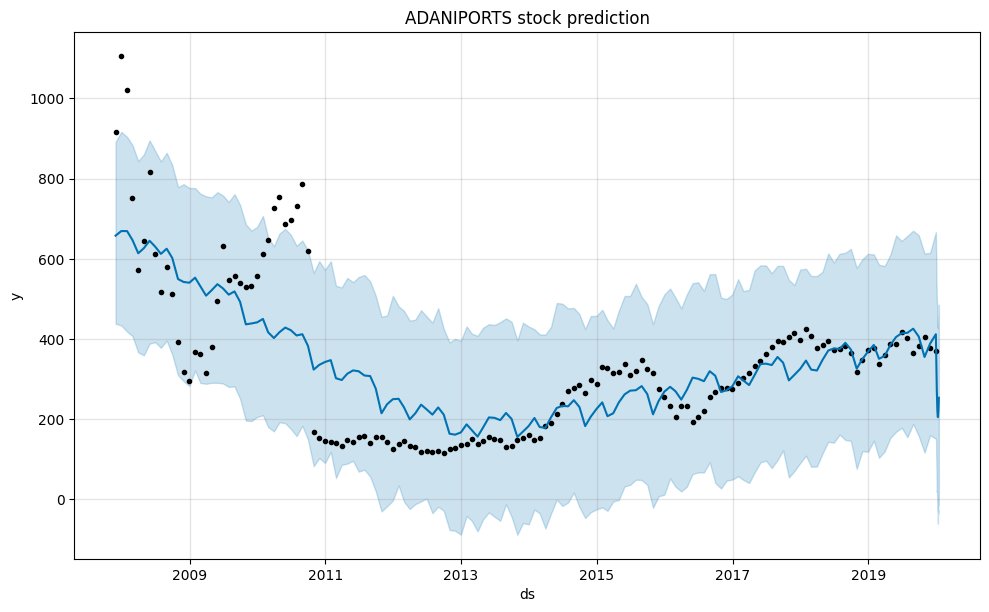

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/j00qpbks.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/_uqllxme.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50440', 'data', 'file=/tmp/tmpo7zomkn1/j00qpbks.json', 'init=/tmp/tmpo7zomkn1/_uqllxme.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model8b1h9imh/prophet_model-20230722231554.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:15:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:15:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


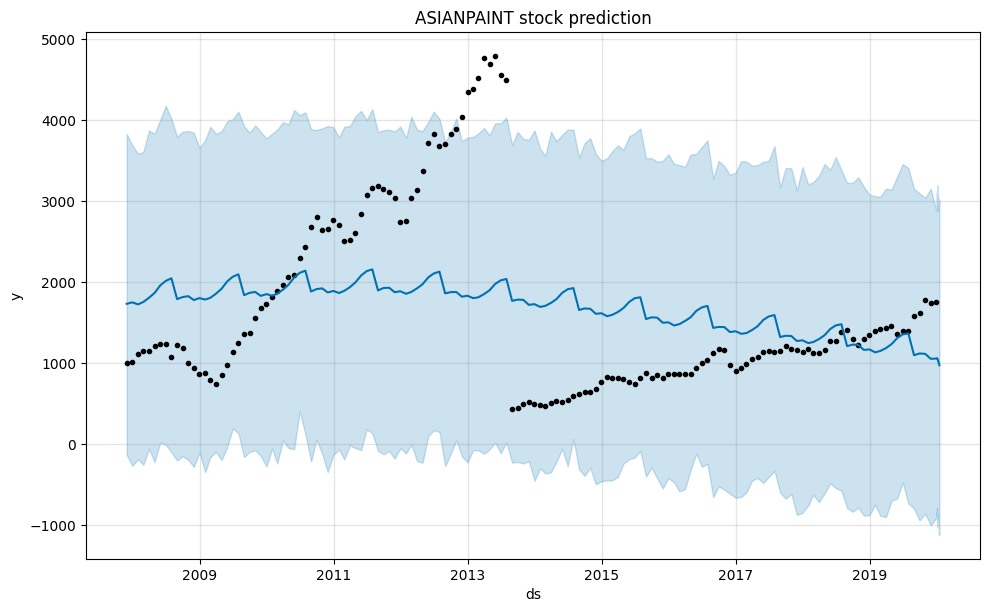

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/bqemok5z.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/v6v0wuvl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68348', 'data', 'file=/tmp/tmpo7zomkn1/bqemok5z.json', 'init=/tmp/tmpo7zomkn1/v6v0wuvl.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model5r29l7w1/prophet_model-20230722231554.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:15:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:15:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


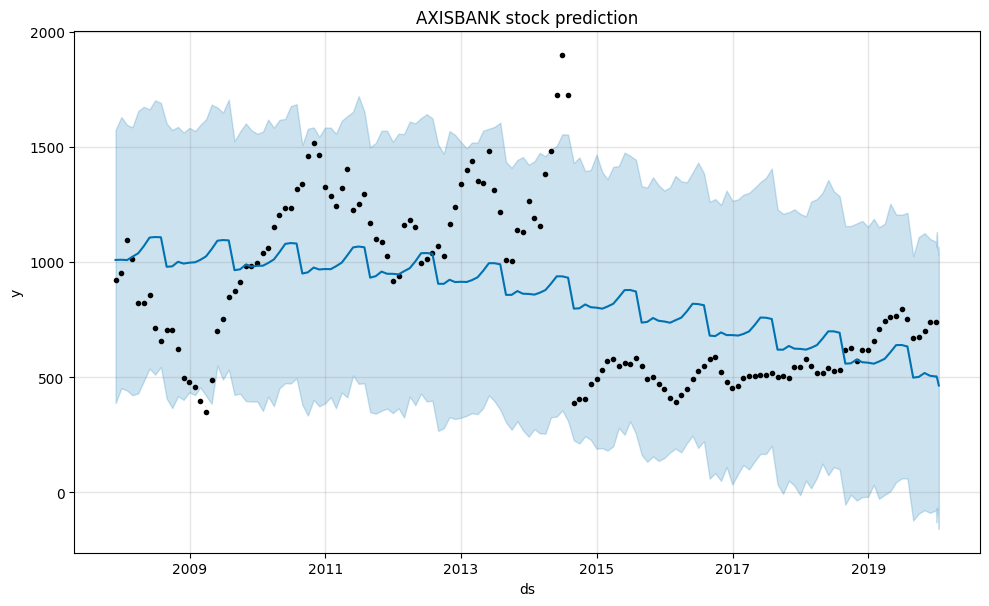

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/72buzt8z.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/v32ad8dw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54317', 'data', 'file=/tmp/tmpo7zomkn1/72buzt8z.json', 'init=/tmp/tmpo7zomkn1/v32ad8dw.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modeld6pmeh7l/prophet_model-20230722231555.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:15:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:15:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


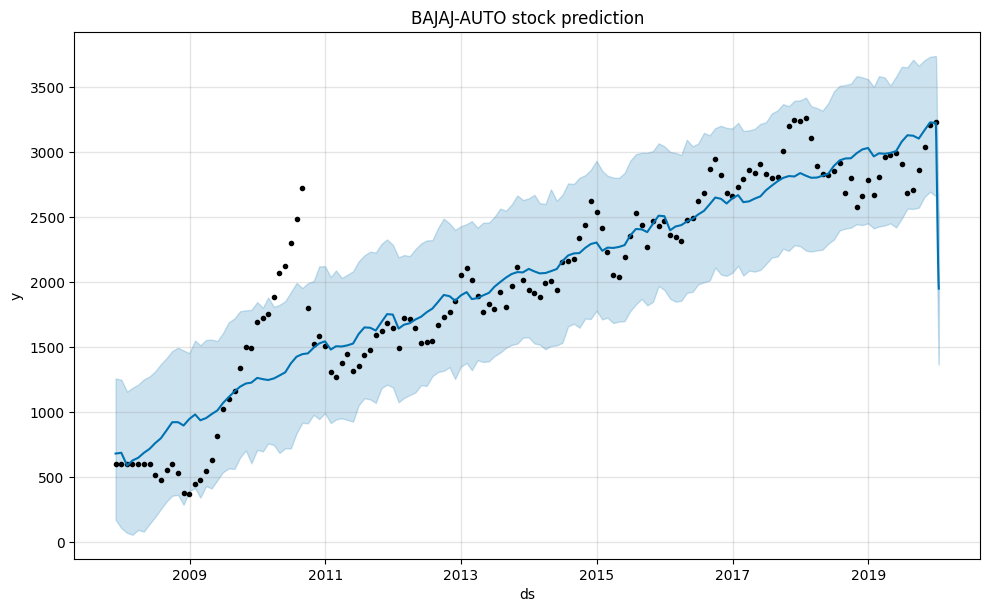

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/yyi92hfo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/hhoxg986.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17050', 'data', 'file=/tmp/tmpo7zomkn1/yyi92hfo.json', 'init=/tmp/tmpo7zomkn1/hhoxg986.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelgypndw3b/prophet_model-20230722231556.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:15:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:15:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


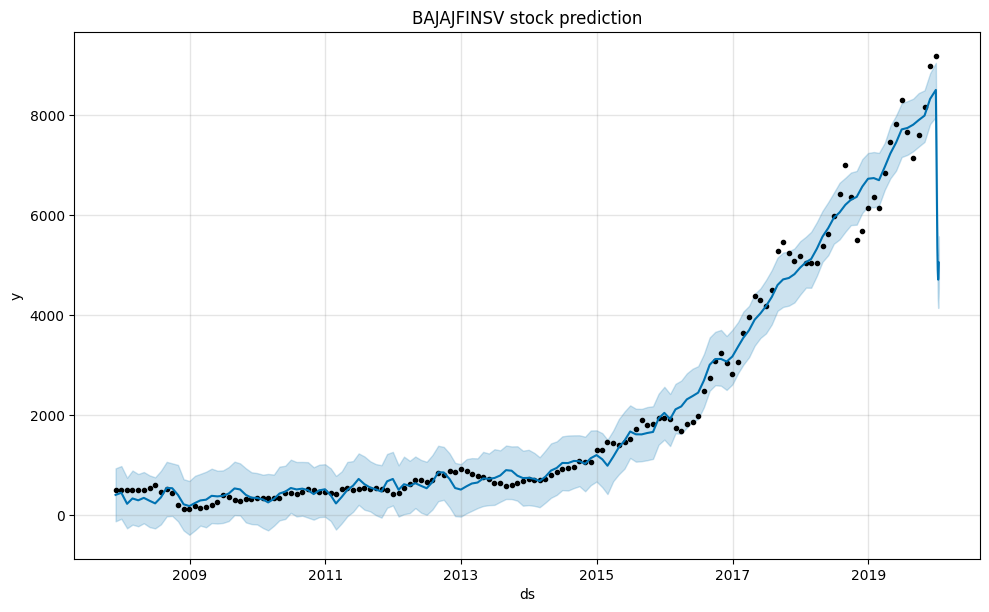

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/5_9rr_ic.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/n2xjww82.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8883', 'data', 'file=/tmp/tmpo7zomkn1/5_9rr_ic.json', 'init=/tmp/tmpo7zomkn1/n2xjww82.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model2wzthbgl/prophet_model-20230722231556.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:15:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:15:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


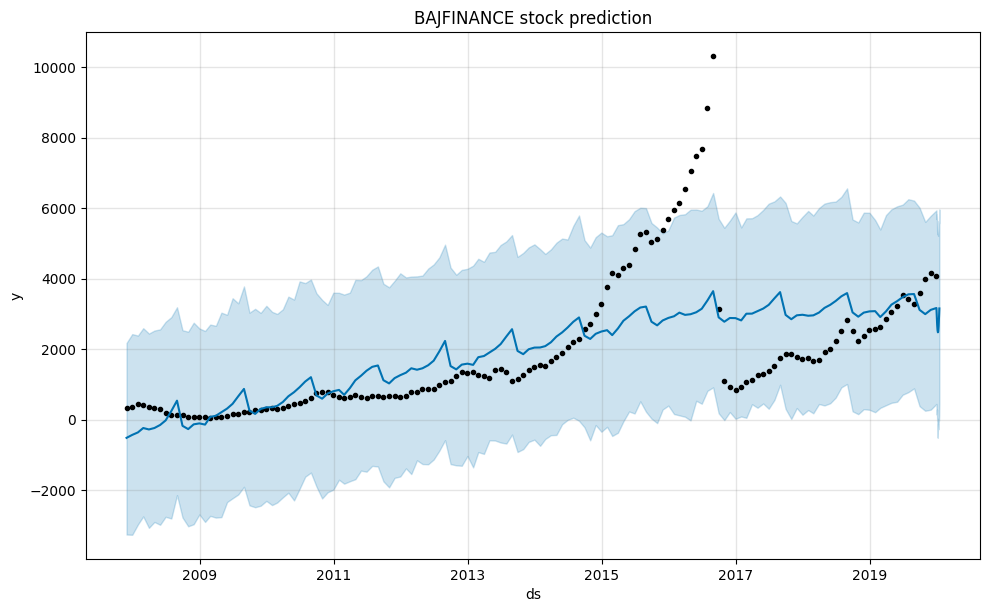

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/5kas9hdn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/c_6i8oz5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65537', 'data', 'file=/tmp/tmpo7zomkn1/5kas9hdn.json', 'init=/tmp/tmpo7zomkn1/c_6i8oz5.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelidqj6git/prophet_model-20230722231557.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:15:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:15:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


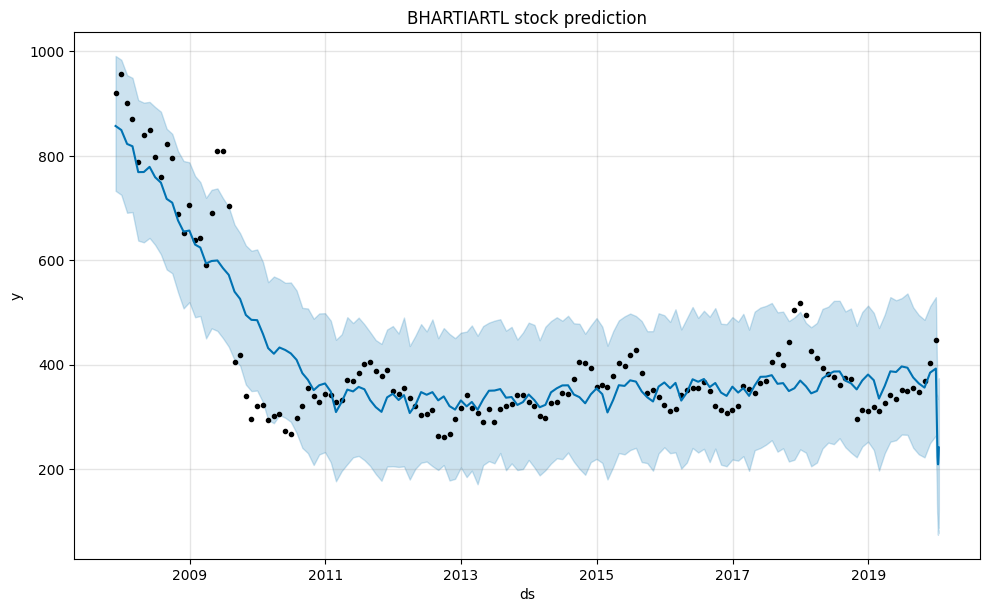

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/rcdn4pr1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/44r491sl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33145', 'data', 'file=/tmp/tmpo7zomkn1/rcdn4pr1.json', 'init=/tmp/tmpo7zomkn1/44r491sl.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model326nlfjb/prophet_model-20230722231558.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:15:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:15:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


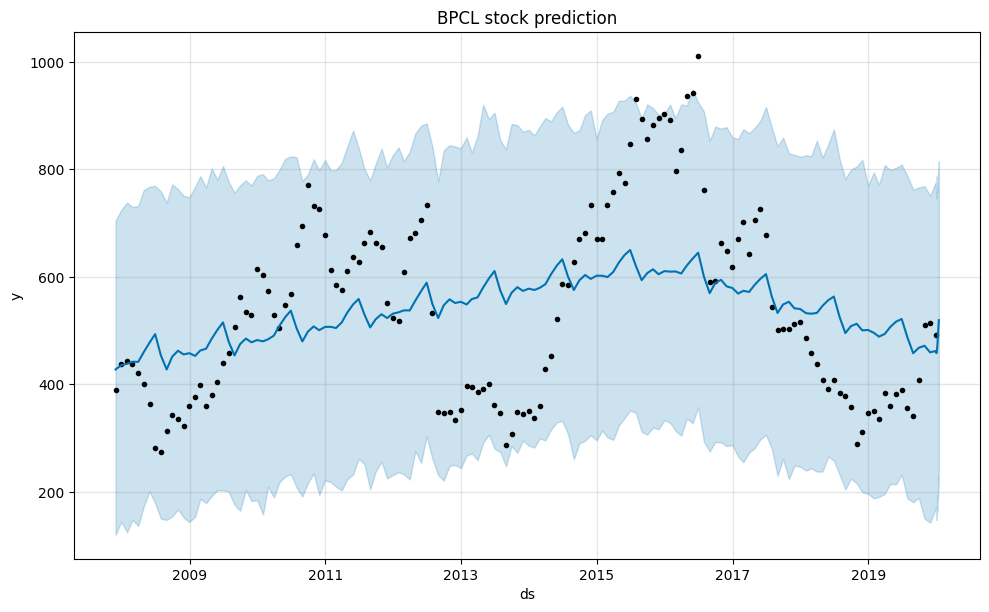

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/56h44079.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/hr1novdz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=23959', 'data', 'file=/tmp/tmpo7zomkn1/56h44079.json', 'init=/tmp/tmpo7zomkn1/hr1novdz.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelnp95dwm3/prophet_model-20230722231558.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:15:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:15:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


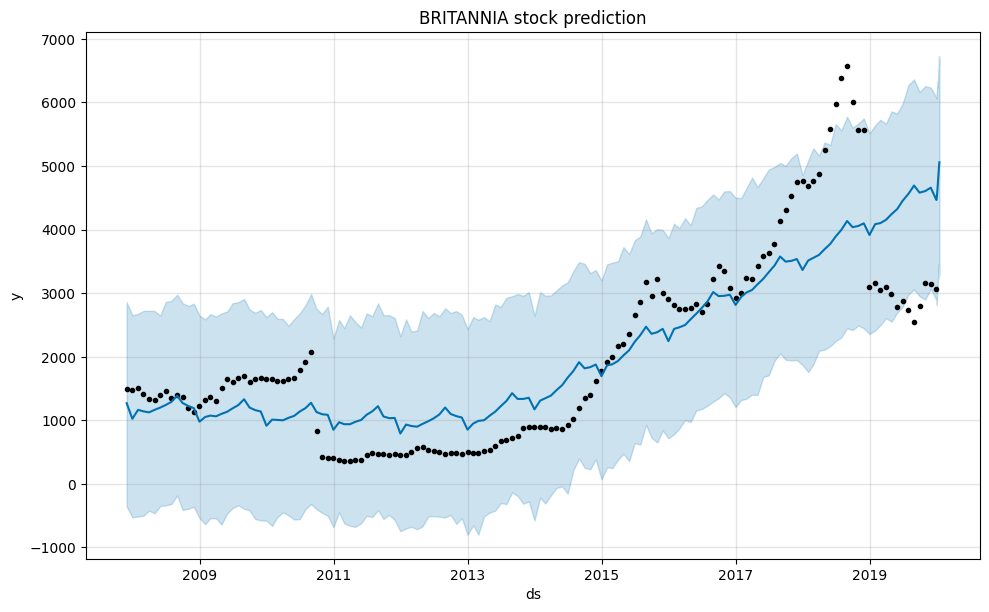

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/fuo9ot8g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/ot3p4sxy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39563', 'data', 'file=/tmp/tmpo7zomkn1/fuo9ot8g.json', 'init=/tmp/tmpo7zomkn1/ot3p4sxy.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modeladxg5t0l/prophet_model-20230722231559.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:15:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:15:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


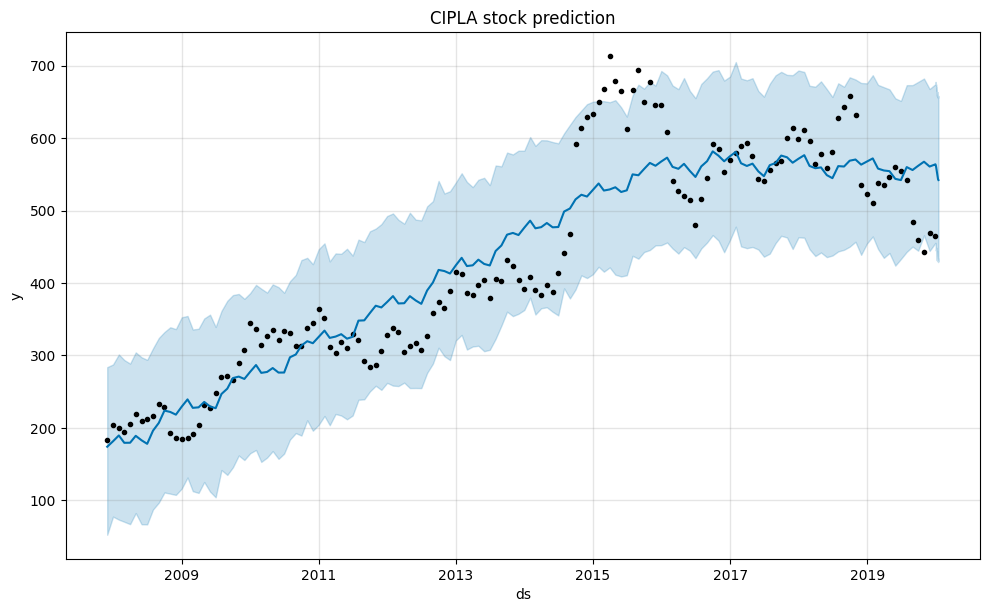

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/sz_d6zpr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/y47i3yn4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96683', 'data', 'file=/tmp/tmpo7zomkn1/sz_d6zpr.json', 'init=/tmp/tmpo7zomkn1/y47i3yn4.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelhktr1618/prophet_model-20230722231600.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


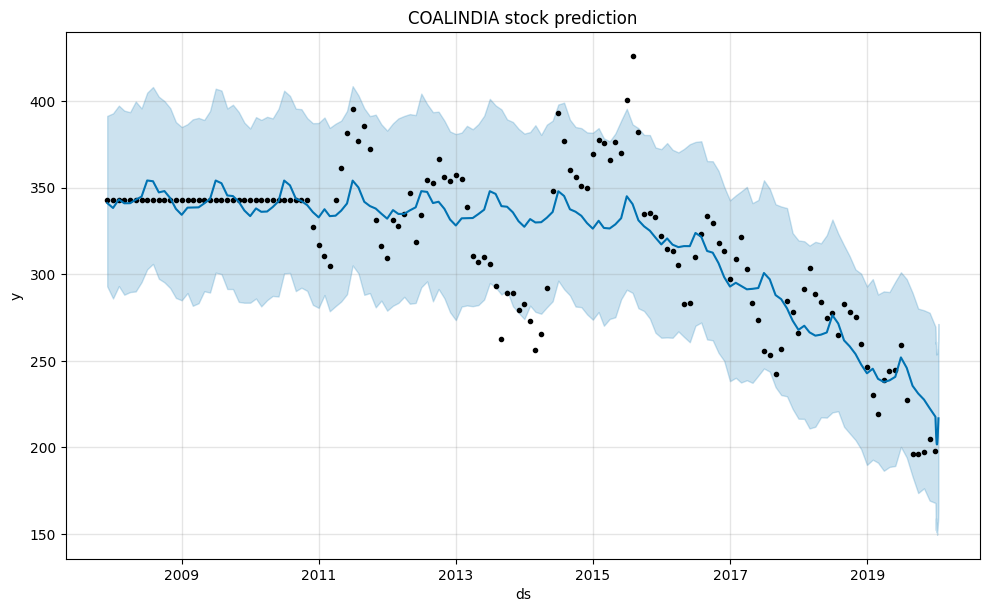

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/8aq4mb8u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/pfkdrye4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93749', 'data', 'file=/tmp/tmpo7zomkn1/8aq4mb8u.json', 'init=/tmp/tmpo7zomkn1/pfkdrye4.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelj7d9p8k9/prophet_model-20230722231600.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


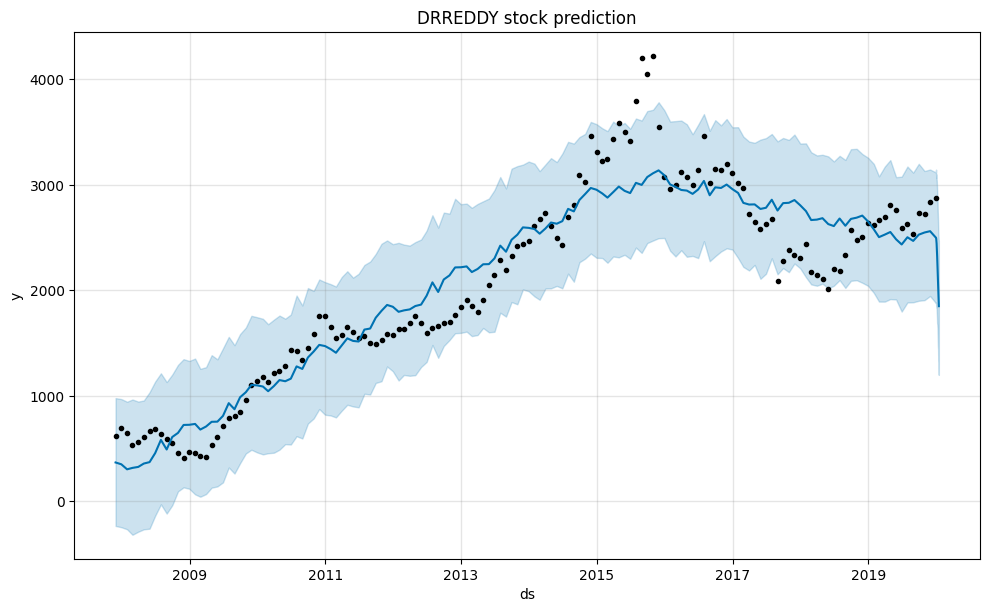

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/upx8vqlk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/58hjnq9z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53377', 'data', 'file=/tmp/tmpo7zomkn1/upx8vqlk.json', 'init=/tmp/tmpo7zomkn1/58hjnq9z.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model06ida5i3/prophet_model-20230722231600.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


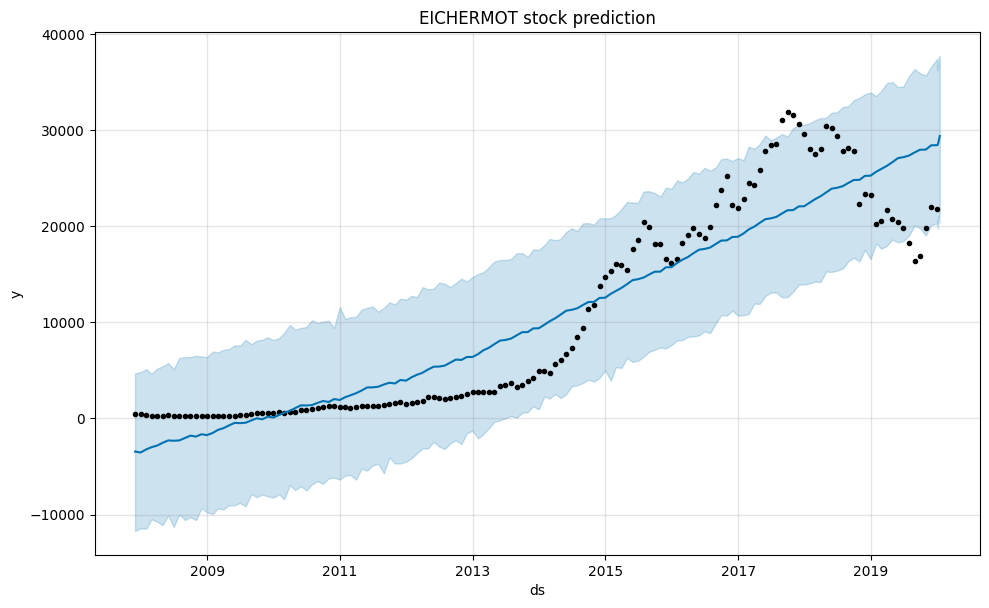

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/x23y6kjq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/rp5zk6qp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98002', 'data', 'file=/tmp/tmpo7zomkn1/x23y6kjq.json', 'init=/tmp/tmpo7zomkn1/rp5zk6qp.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelo1hebl53/prophet_model-20230722231601.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


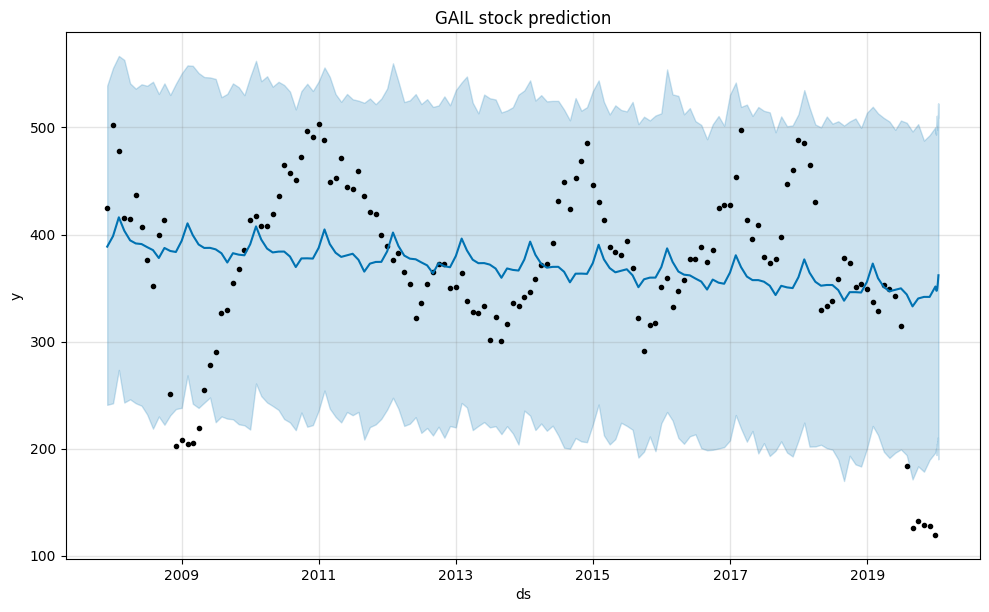

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/lq7xzwbw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/zk79myu8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72178', 'data', 'file=/tmp/tmpo7zomkn1/lq7xzwbw.json', 'init=/tmp/tmpo7zomkn1/zk79myu8.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modeltoj1or30/prophet_model-20230722231601.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


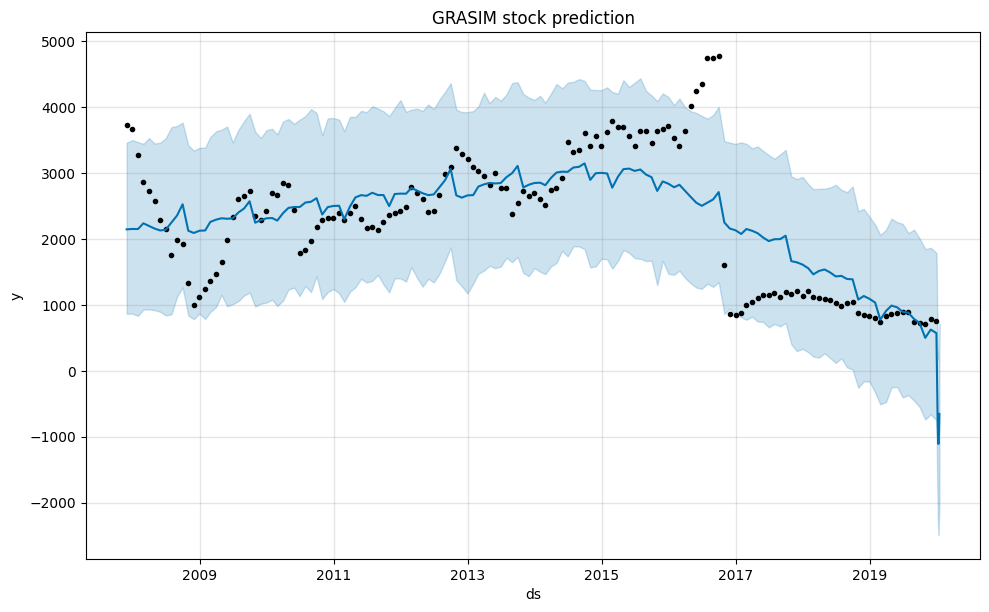

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/m1fcuv72.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/7o9uwc_1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84115', 'data', 'file=/tmp/tmpo7zomkn1/m1fcuv72.json', 'init=/tmp/tmpo7zomkn1/7o9uwc_1.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model0yw6r47w/prophet_model-20230722231602.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


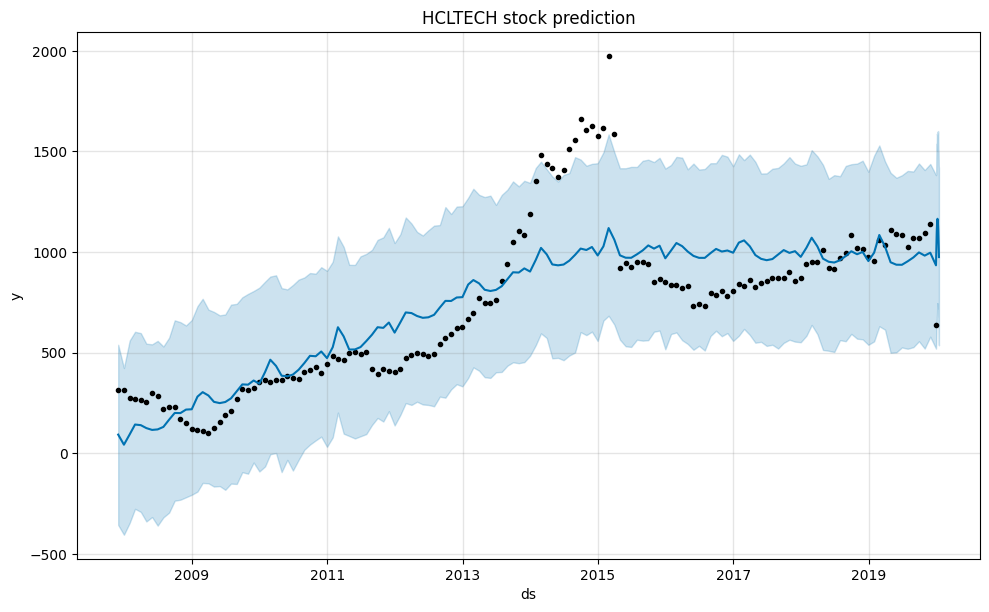

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/cyeh2tz9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/3jptu04r.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25333', 'data', 'file=/tmp/tmpo7zomkn1/cyeh2tz9.json', 'init=/tmp/tmpo7zomkn1/3jptu04r.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelhqkq88n3/prophet_model-20230722231602.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


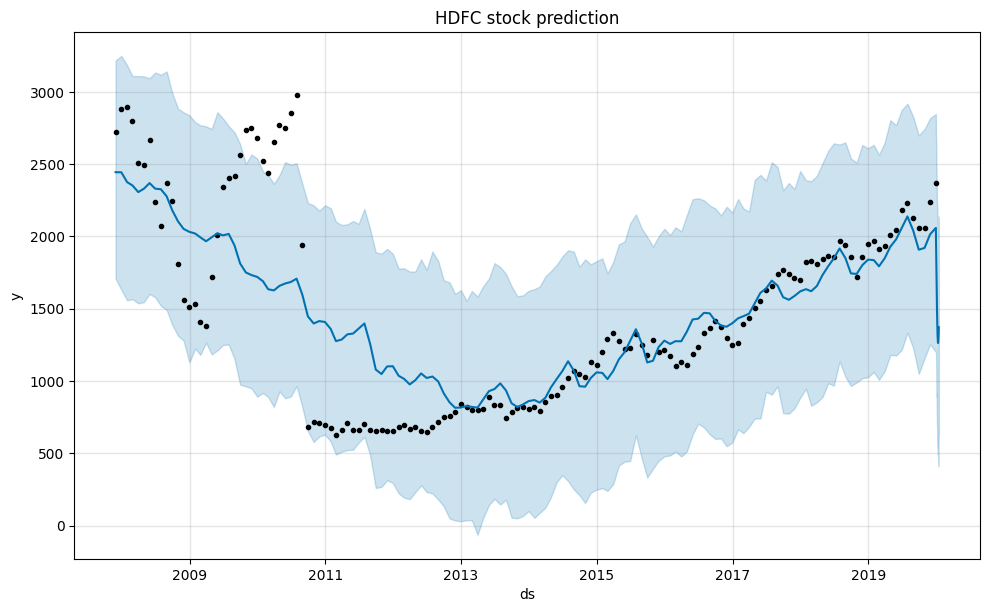

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/n0xya3jv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/4ds1jbgn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99133', 'data', 'file=/tmp/tmpo7zomkn1/n0xya3jv.json', 'init=/tmp/tmpo7zomkn1/4ds1jbgn.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelfi0i9925/prophet_model-20230722231603.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


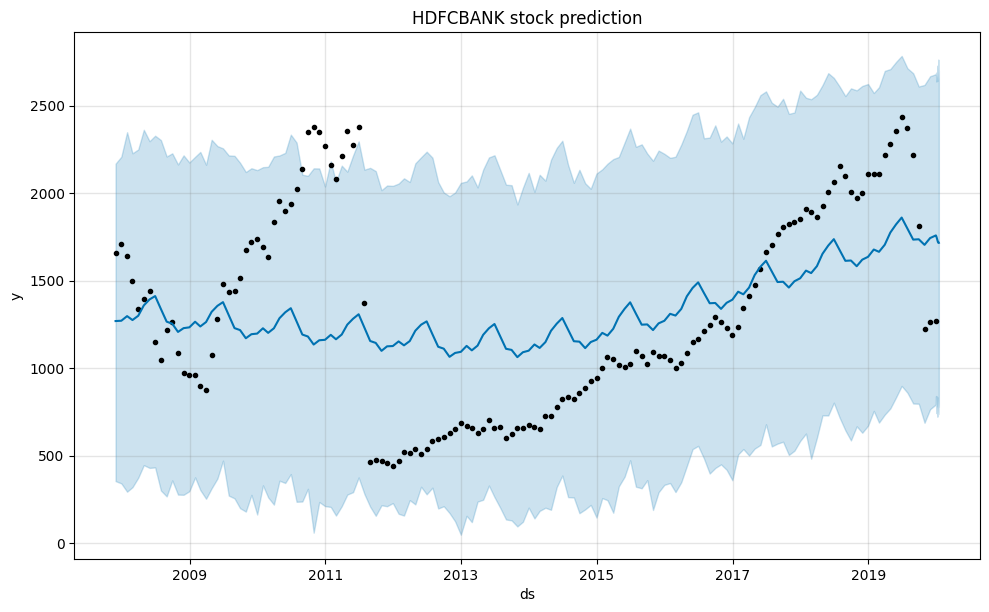

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/fqvnujiw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/ha15morb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28648', 'data', 'file=/tmp/tmpo7zomkn1/fqvnujiw.json', 'init=/tmp/tmpo7zomkn1/ha15morb.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelfki080j5/prophet_model-20230722231604.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


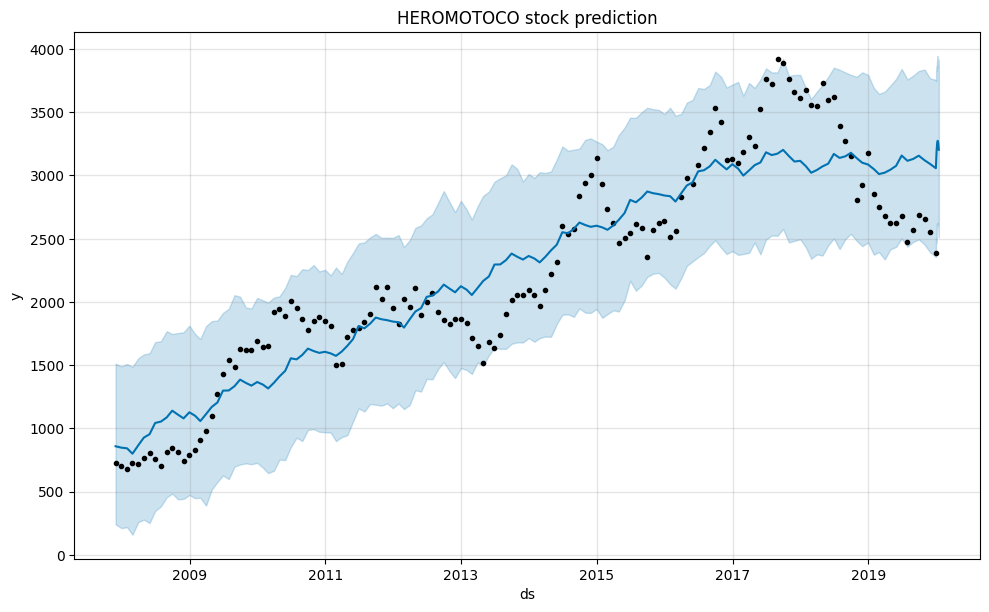

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/e4p84vb7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/1fcdjk5w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62828', 'data', 'file=/tmp/tmpo7zomkn1/e4p84vb7.json', 'init=/tmp/tmpo7zomkn1/1fcdjk5w.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelyhbdzogt/prophet_model-20230722231604.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


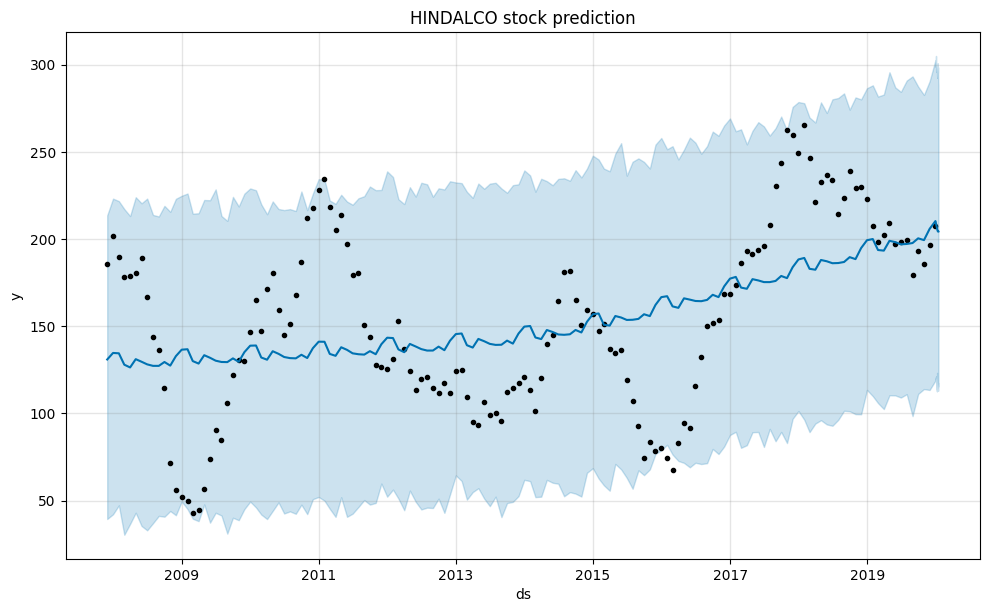

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/rea7no5u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/cqczresf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41591', 'data', 'file=/tmp/tmpo7zomkn1/rea7no5u.json', 'init=/tmp/tmpo7zomkn1/cqczresf.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modely860n7yw/prophet_model-20230722231605.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


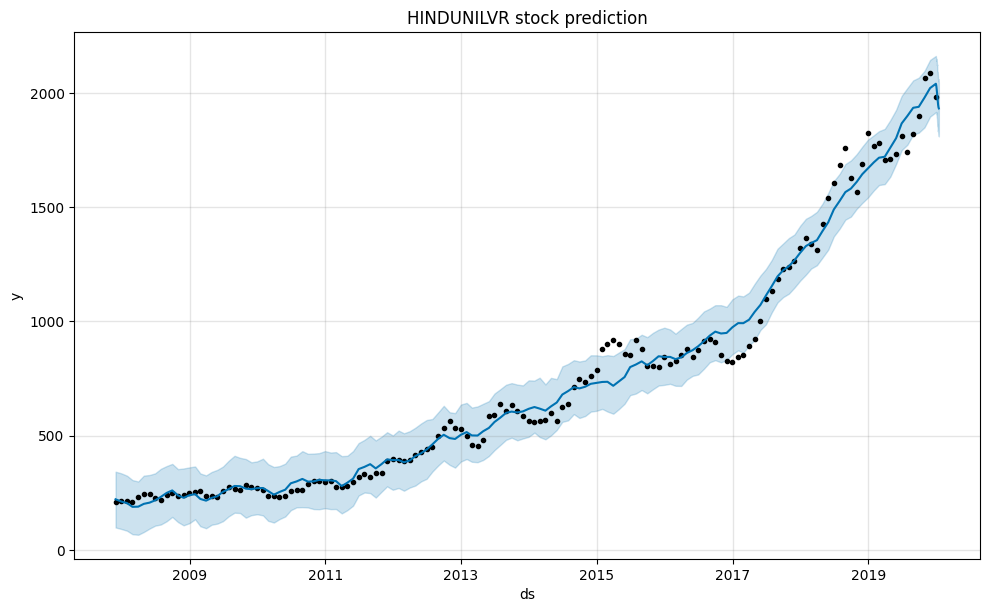

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/pwz24j64.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/hoom6_8z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68843', 'data', 'file=/tmp/tmpo7zomkn1/pwz24j64.json', 'init=/tmp/tmpo7zomkn1/hoom6_8z.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelmomx77ou/prophet_model-20230722231605.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


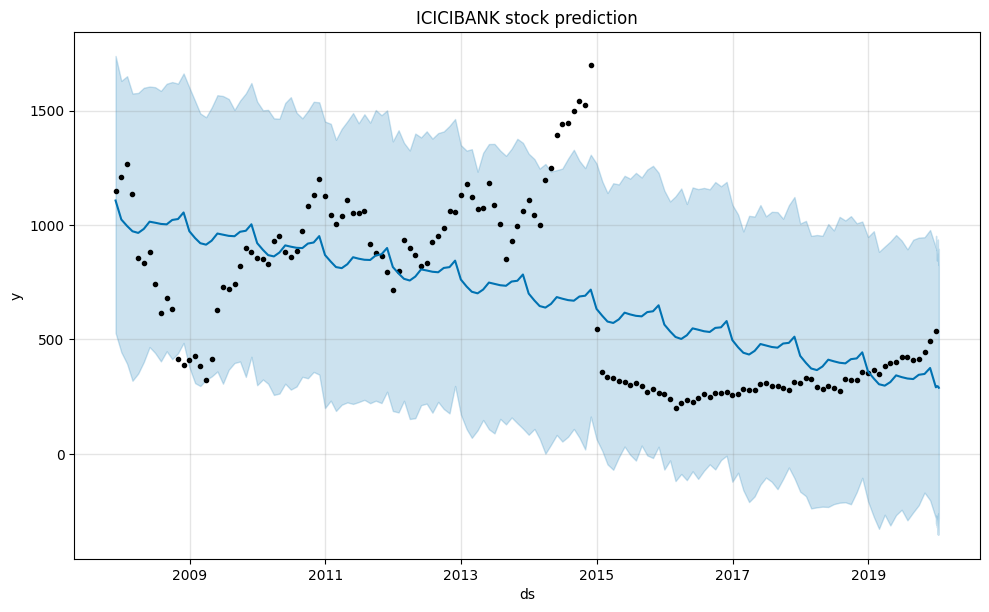

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/63rkxqf5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/v7eirkxi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92079', 'data', 'file=/tmp/tmpo7zomkn1/63rkxqf5.json', 'init=/tmp/tmpo7zomkn1/v7eirkxi.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelc2tctl3y/prophet_model-20230722231606.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


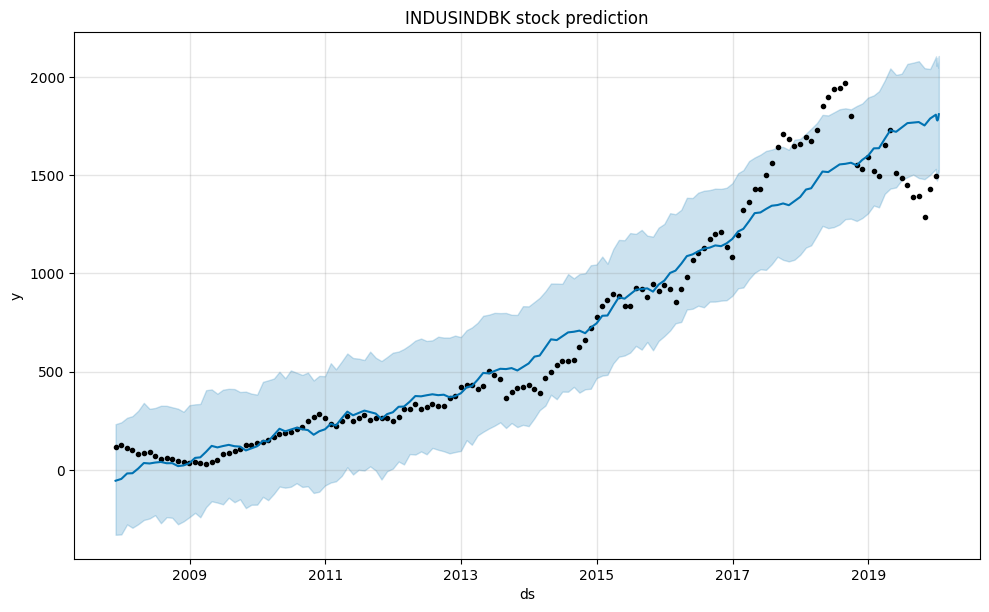

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/w8e29xxz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/t2cj_5a0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68153', 'data', 'file=/tmp/tmpo7zomkn1/w8e29xxz.json', 'init=/tmp/tmpo7zomkn1/t2cj_5a0.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelojtt0cqt/prophet_model-20230722231606.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


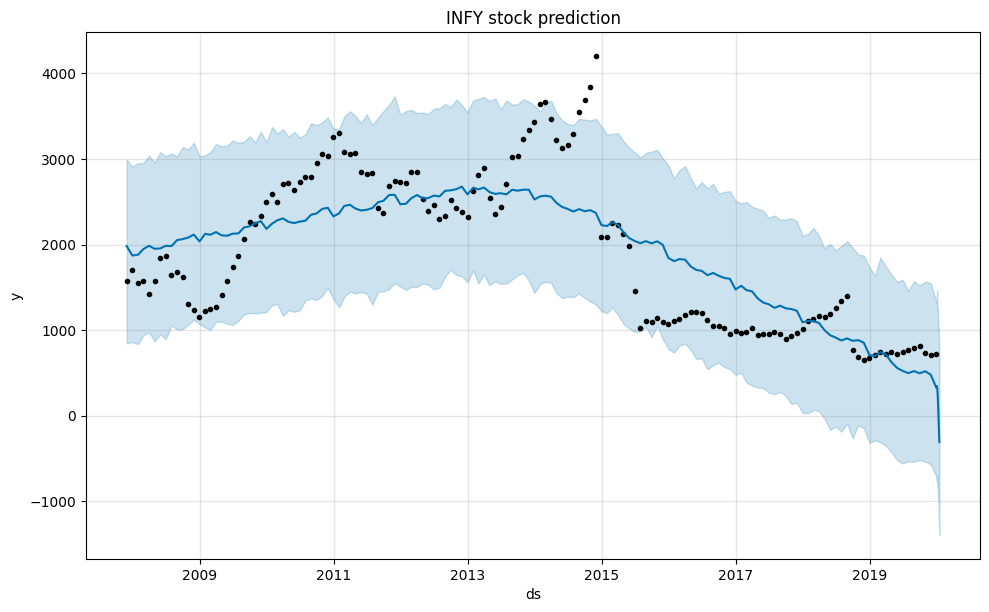

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/r0ghcny4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/_iw1wsss.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68683', 'data', 'file=/tmp/tmpo7zomkn1/r0ghcny4.json', 'init=/tmp/tmpo7zomkn1/_iw1wsss.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelpiyjsohm/prophet_model-20230722231607.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


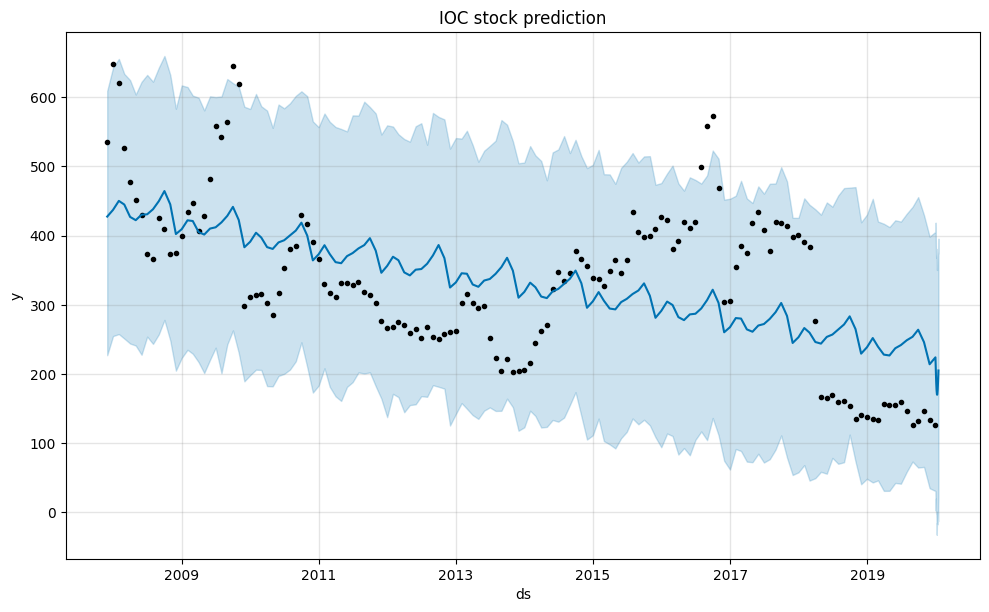

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/0ceo98fh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/iidq_6an.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6715', 'data', 'file=/tmp/tmpo7zomkn1/0ceo98fh.json', 'init=/tmp/tmpo7zomkn1/iidq_6an.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model59b7upon/prophet_model-20230722231607.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


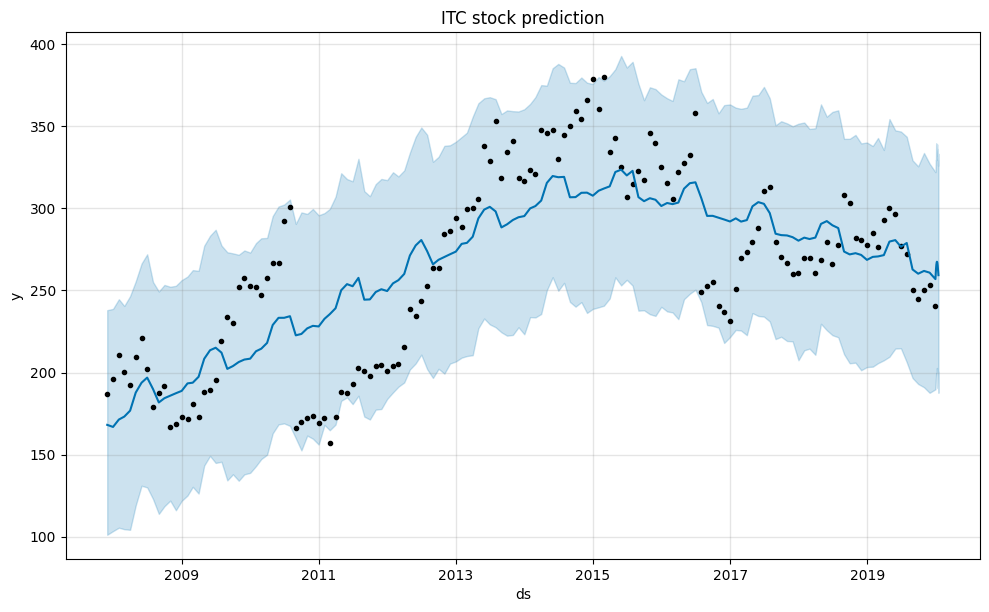

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/8vioqduo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/fylg8f1t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6449', 'data', 'file=/tmp/tmpo7zomkn1/8vioqduo.json', 'init=/tmp/tmpo7zomkn1/fylg8f1t.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelrgoqnhv7/prophet_model-20230722231608.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


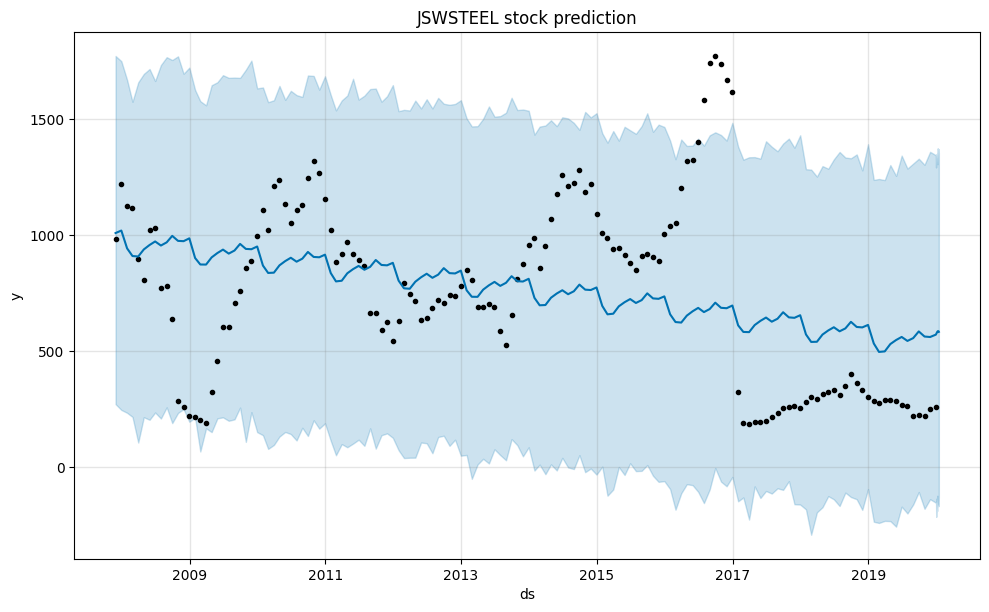

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/kyk3r63d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/b6bmj8rz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=13711', 'data', 'file=/tmp/tmpo7zomkn1/kyk3r63d.json', 'init=/tmp/tmpo7zomkn1/b6bmj8rz.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modeld7x8g_5_/prophet_model-20230722231608.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


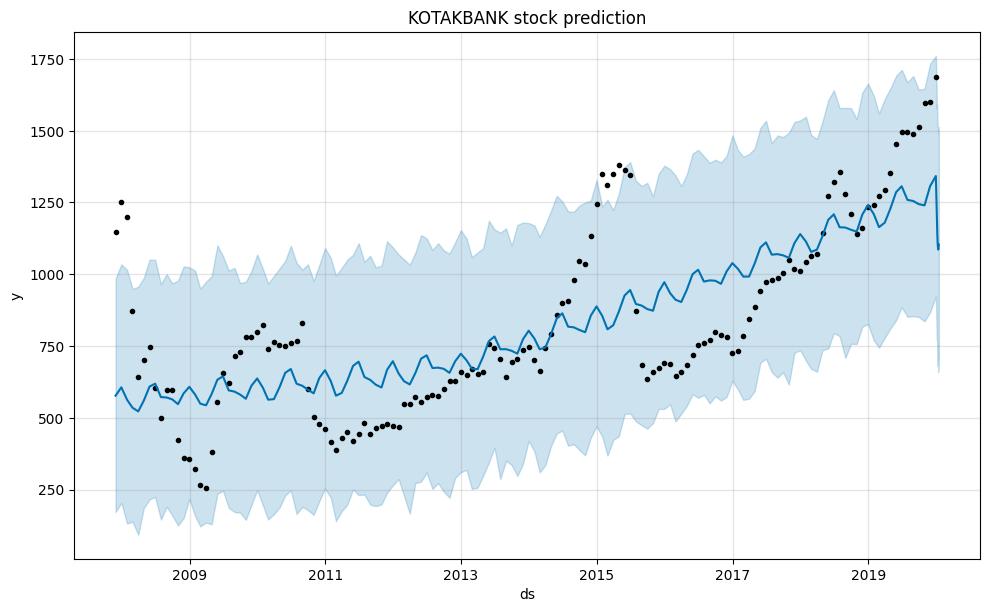

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/2t5wgqln.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/8cstip4h.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41423', 'data', 'file=/tmp/tmpo7zomkn1/2t5wgqln.json', 'init=/tmp/tmpo7zomkn1/8cstip4h.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelpgk23c3v/prophet_model-20230722231609.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


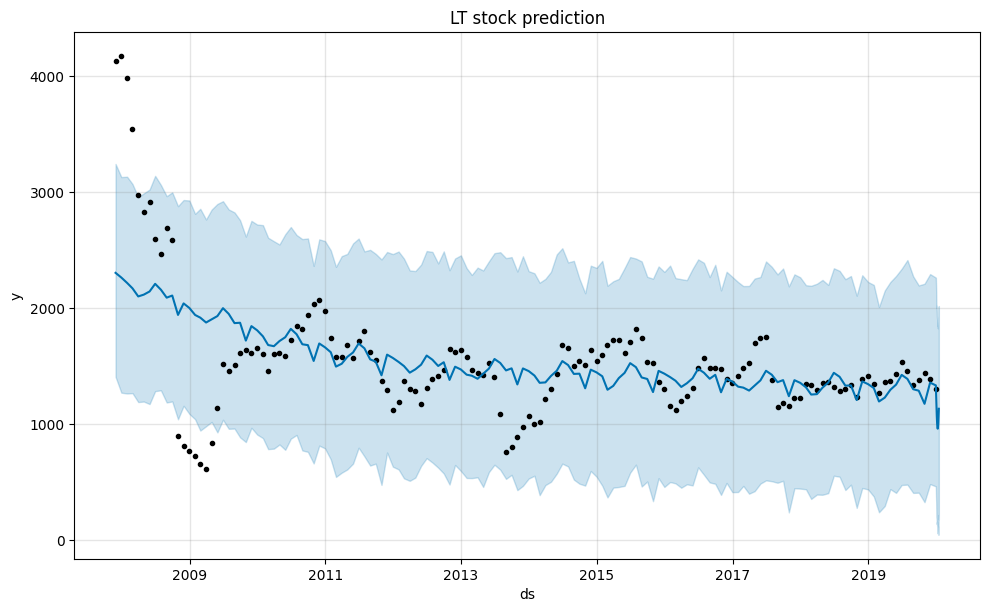

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/snakdxkz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/p8xdh02h.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3404', 'data', 'file=/tmp/tmpo7zomkn1/snakdxkz.json', 'init=/tmp/tmpo7zomkn1/p8xdh02h.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model4t9r1gw2/prophet_model-20230722231609.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


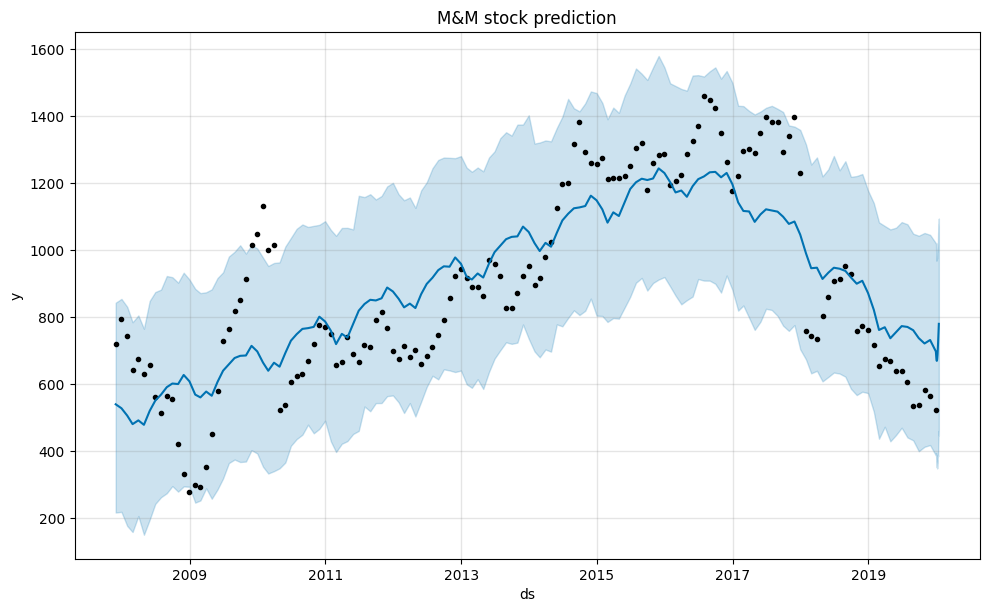

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/rmoa2fg9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/q4su6ac3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89983', 'data', 'file=/tmp/tmpo7zomkn1/rmoa2fg9.json', 'init=/tmp/tmpo7zomkn1/q4su6ac3.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelt659hhc9/prophet_model-20230722231610.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


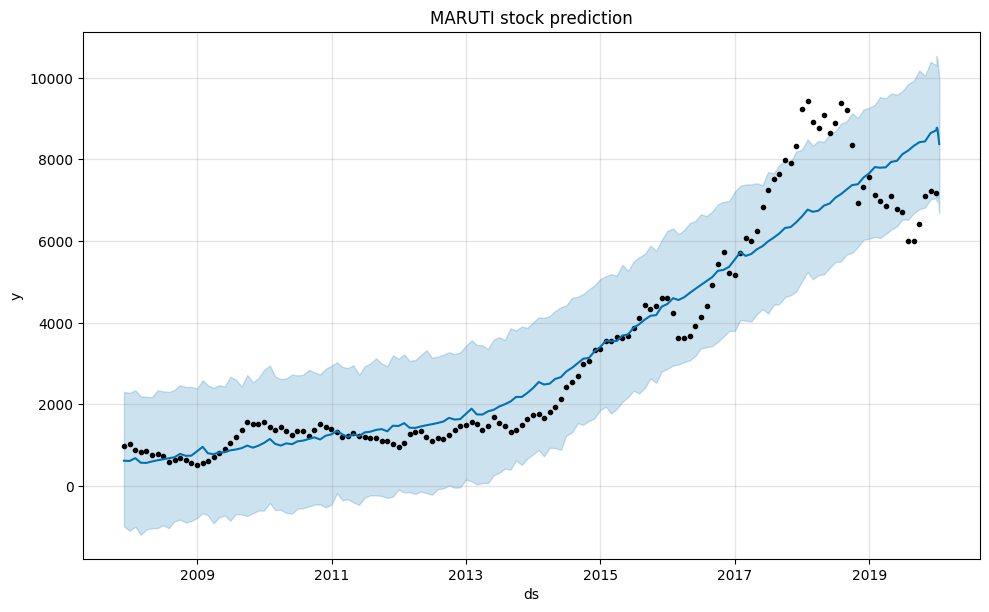

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/qa2vbv3j.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/96i8r15y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89332', 'data', 'file=/tmp/tmpo7zomkn1/qa2vbv3j.json', 'init=/tmp/tmpo7zomkn1/96i8r15y.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modeln0w_0rxo/prophet_model-20230722231611.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


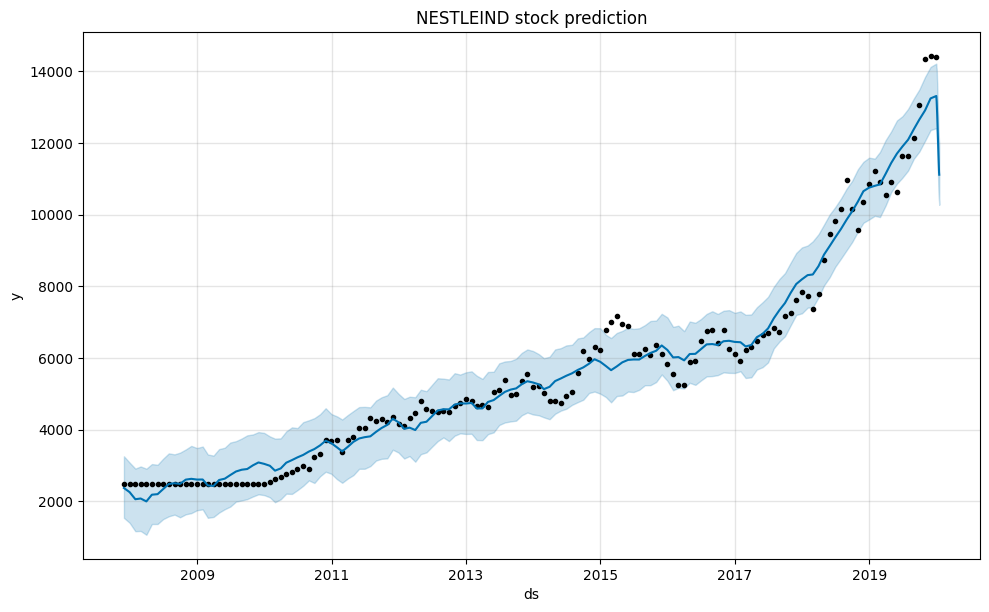

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/bthbxiur.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/jo38kjfk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18984', 'data', 'file=/tmp/tmpo7zomkn1/bthbxiur.json', 'init=/tmp/tmpo7zomkn1/jo38kjfk.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model4vwxyf4u/prophet_model-20230722231611.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


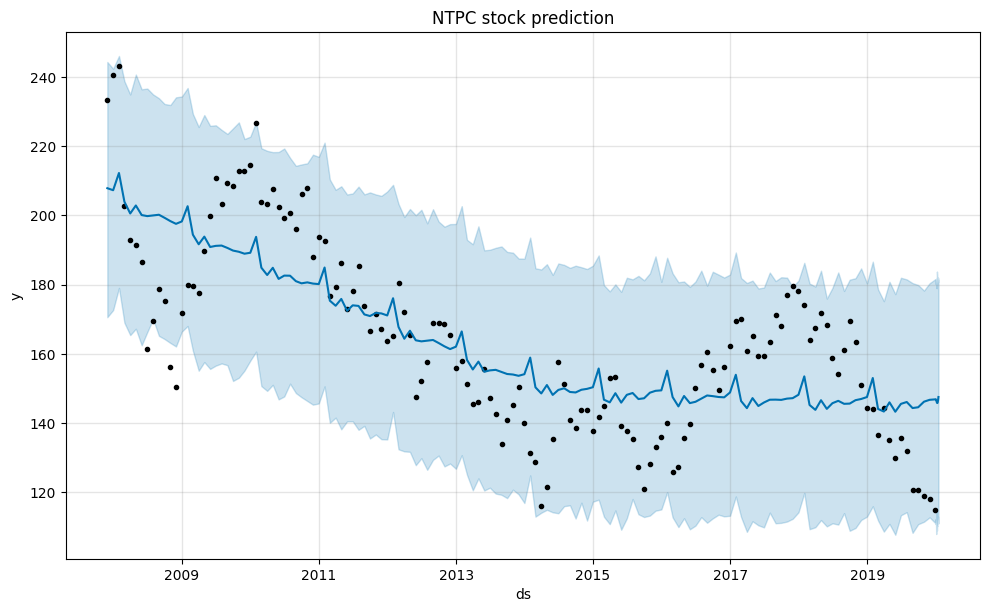

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/xjykoemi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/cj0on6xr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83105', 'data', 'file=/tmp/tmpo7zomkn1/xjykoemi.json', 'init=/tmp/tmpo7zomkn1/cj0on6xr.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model3mto5_4k/prophet_model-20230722231612.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


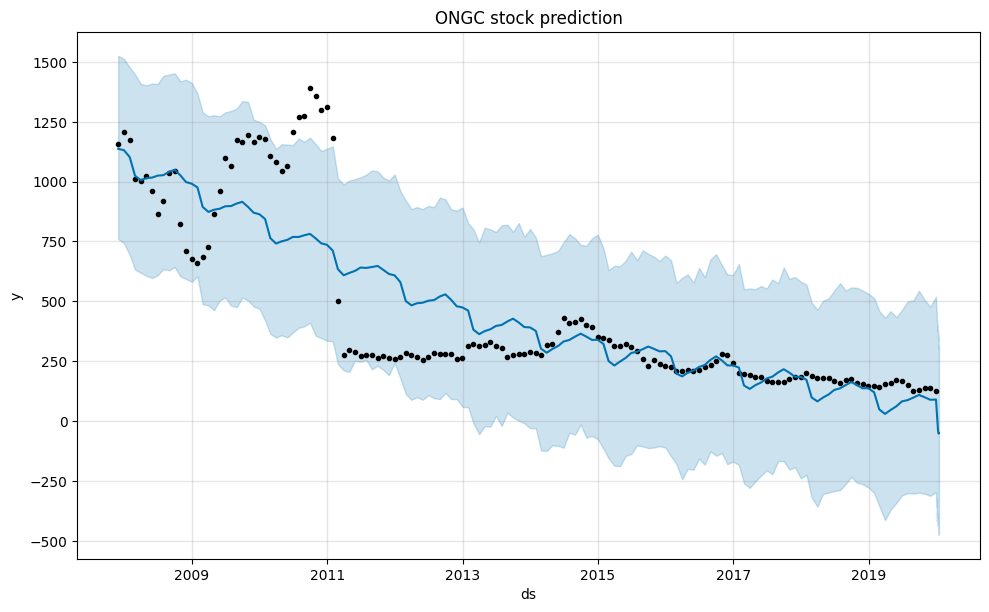

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/jdvk5j6c.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/gu88qc9z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80662', 'data', 'file=/tmp/tmpo7zomkn1/jdvk5j6c.json', 'init=/tmp/tmpo7zomkn1/gu88qc9z.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modellt_9zbpm/prophet_model-20230722231613.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


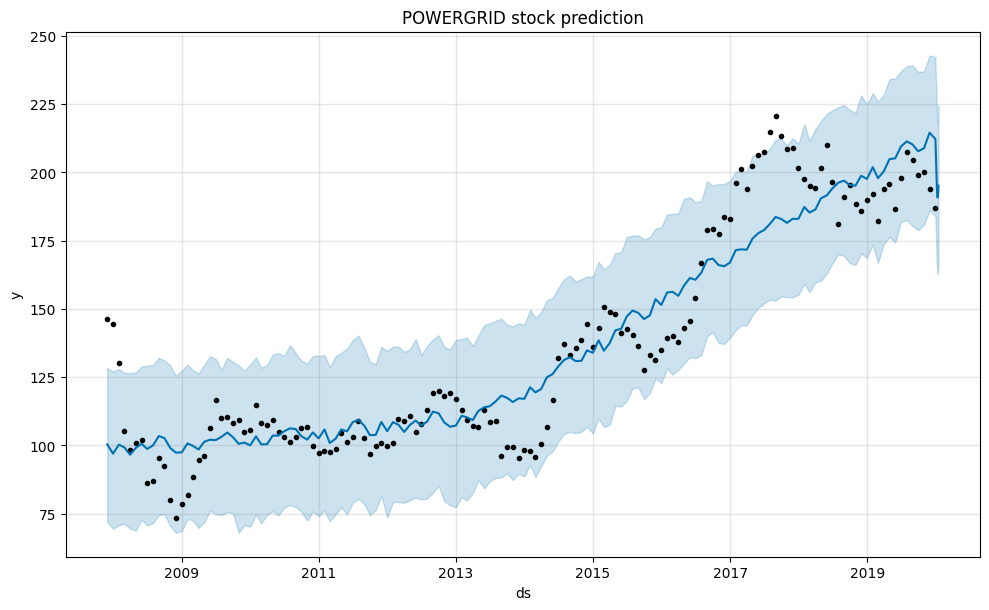

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/7qjpt9zv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/rcbwxfes.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28500', 'data', 'file=/tmp/tmpo7zomkn1/7qjpt9zv.json', 'init=/tmp/tmpo7zomkn1/rcbwxfes.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelwy8lnsge/prophet_model-20230722231614.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


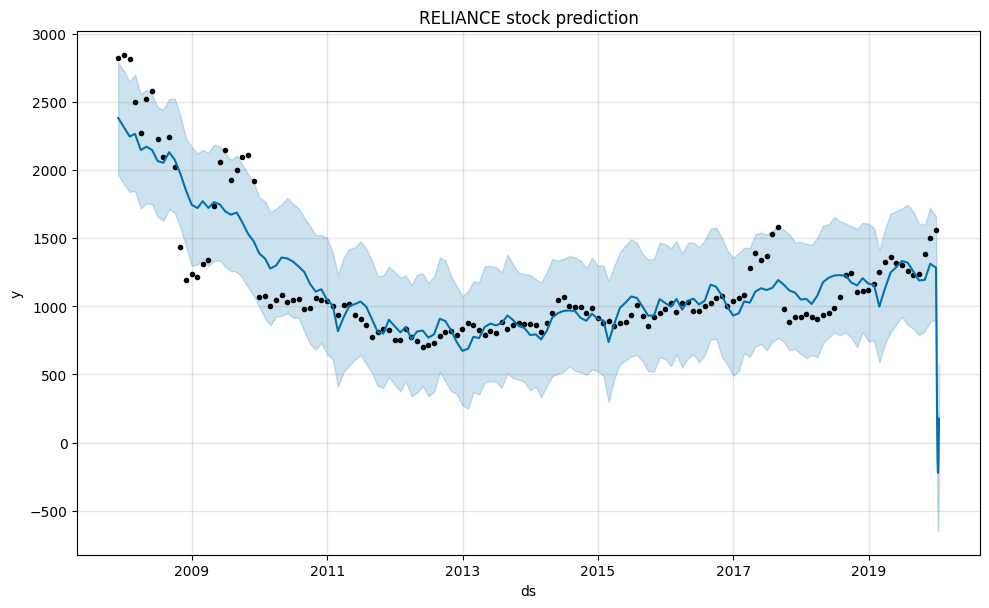

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/mlfg1l0x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/e1gqz2cl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21485', 'data', 'file=/tmp/tmpo7zomkn1/mlfg1l0x.json', 'init=/tmp/tmpo7zomkn1/e1gqz2cl.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model0mynktwt/prophet_model-20230722231614.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


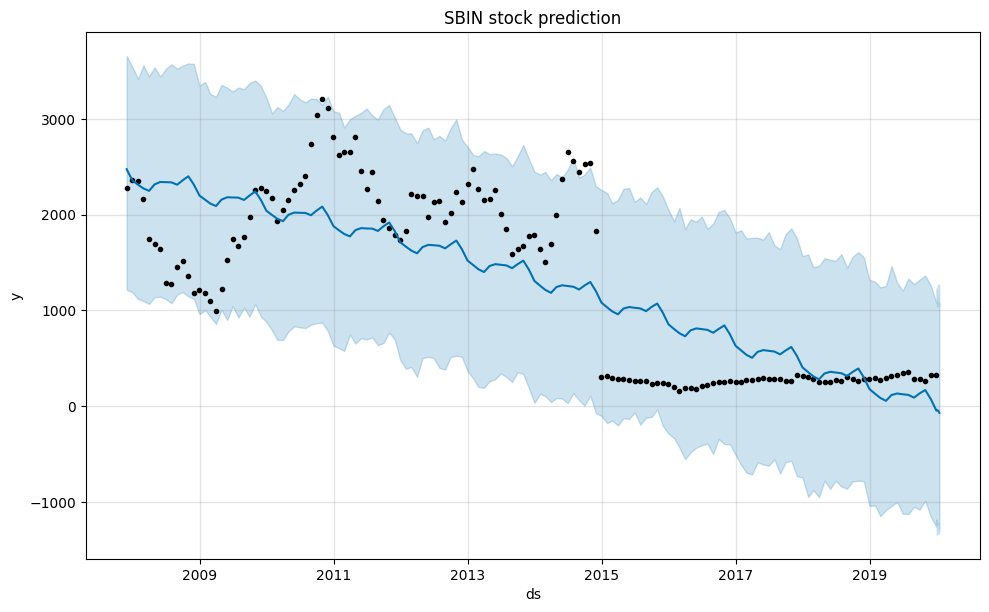

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/rp3vu7ed.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/pi3lberc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66126', 'data', 'file=/tmp/tmpo7zomkn1/rp3vu7ed.json', 'init=/tmp/tmpo7zomkn1/pi3lberc.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelgjkad3gq/prophet_model-20230722231615.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


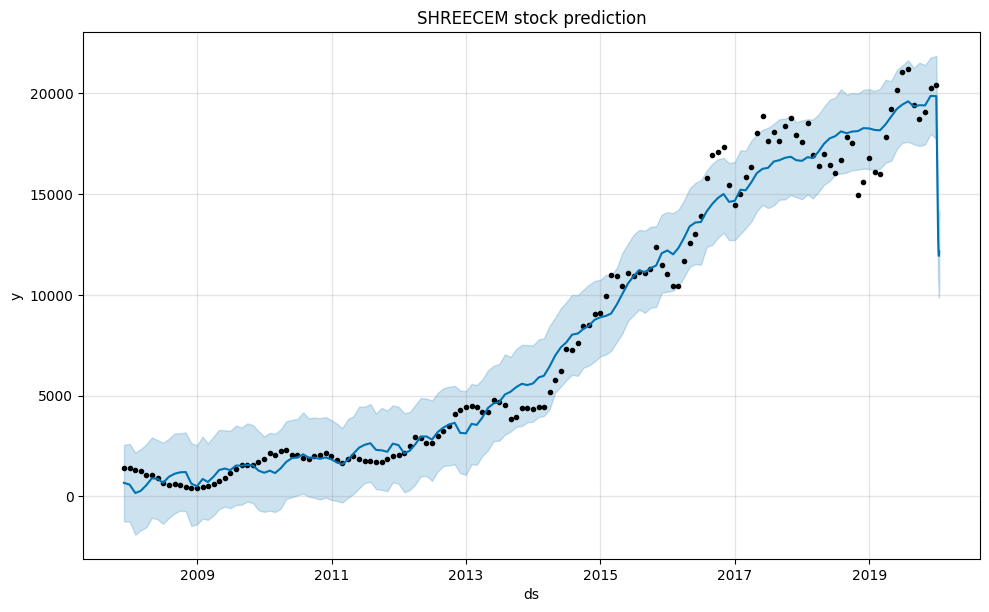

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/qq2ycpsp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/oufbod_j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=762', 'data', 'file=/tmp/tmpo7zomkn1/qq2ycpsp.json', 'init=/tmp/tmpo7zomkn1/oufbod_j.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelijzkvuda/prophet_model-20230722231615.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


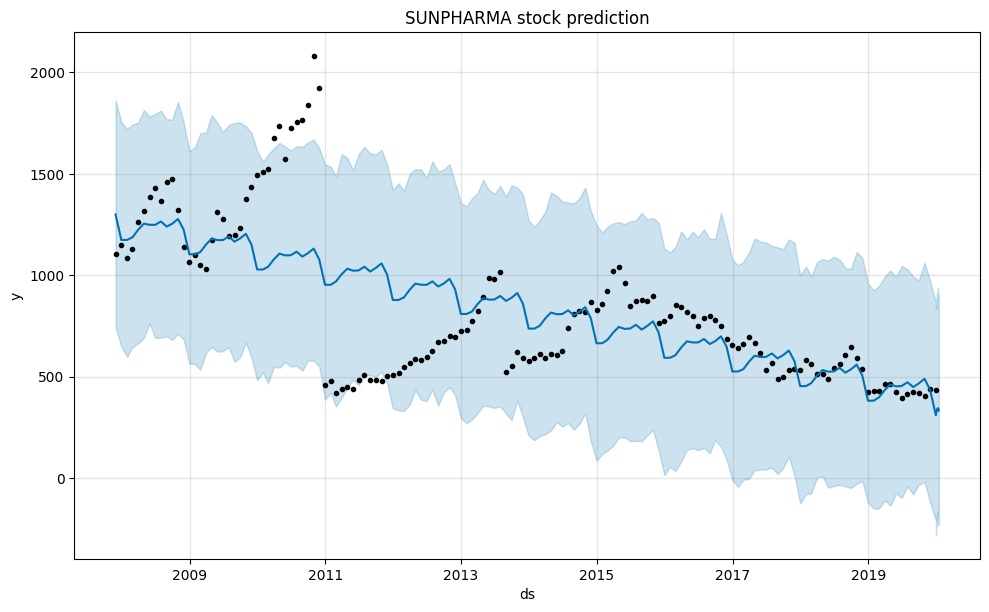

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/0t_w011h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/q6og3shv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=24298', 'data', 'file=/tmp/tmpo7zomkn1/0t_w011h.json', 'init=/tmp/tmpo7zomkn1/q6og3shv.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modeloo5joi96/prophet_model-20230722231616.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


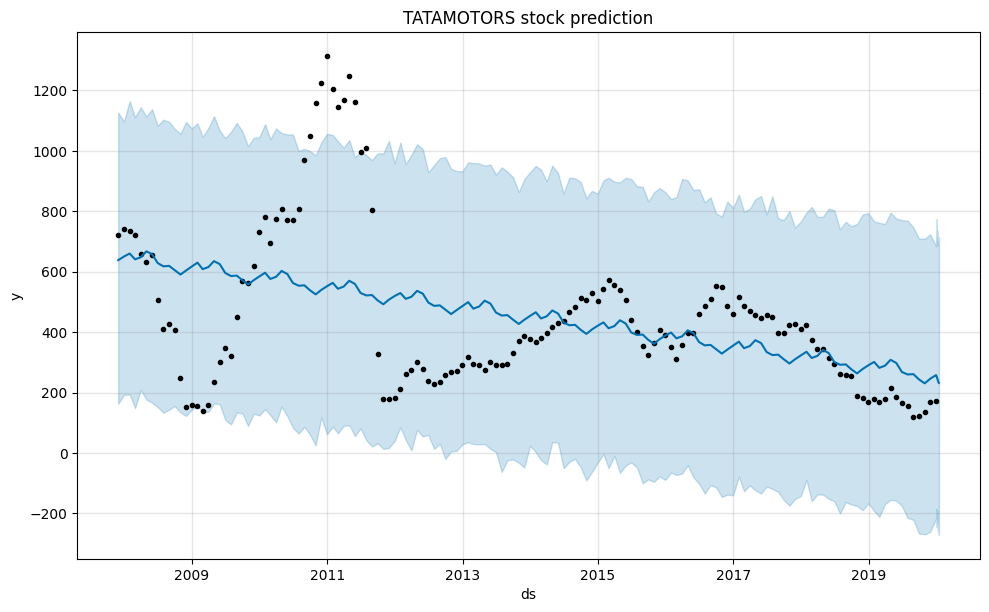

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/z5h2hj0q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/adtygc81.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36871', 'data', 'file=/tmp/tmpo7zomkn1/z5h2hj0q.json', 'init=/tmp/tmpo7zomkn1/adtygc81.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelgw89_tpu/prophet_model-20230722231617.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


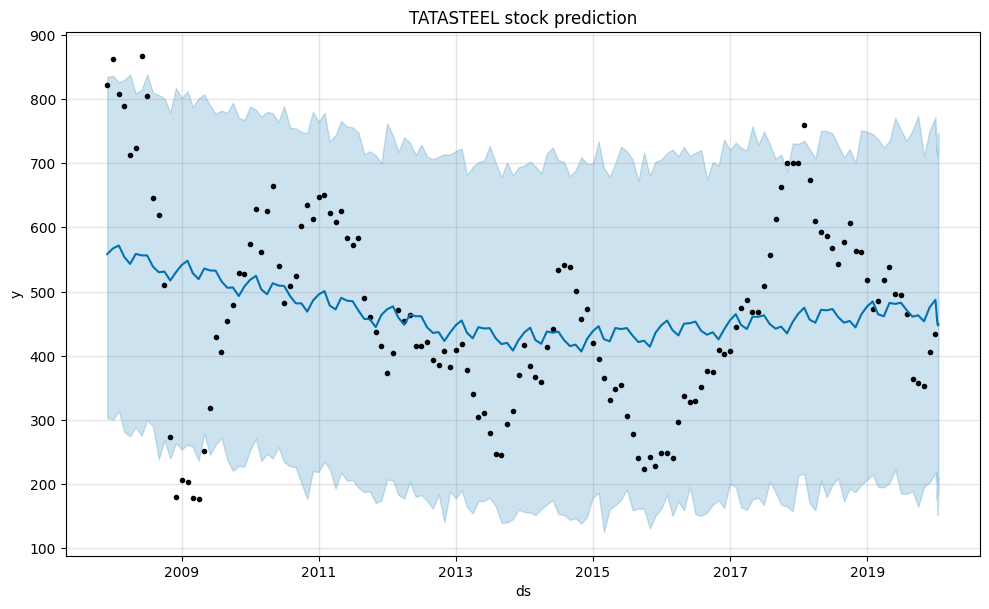

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/kodqbh0a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/_nvi0l6l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76189', 'data', 'file=/tmp/tmpo7zomkn1/kodqbh0a.json', 'init=/tmp/tmpo7zomkn1/_nvi0l6l.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model_xo460l8/prophet_model-20230722231618.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


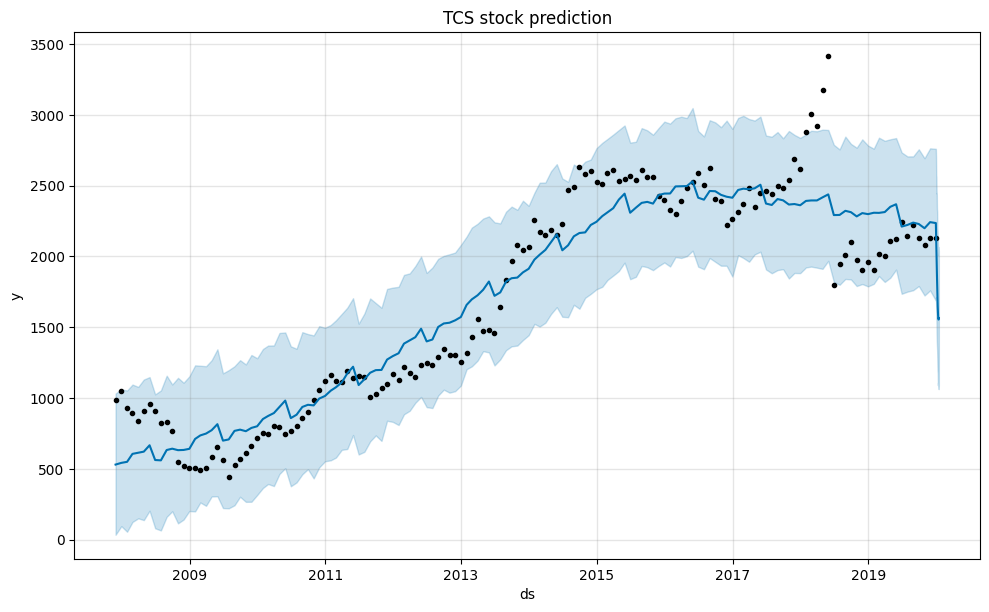

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/twd_p7_8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/iz4xq0ql.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53516', 'data', 'file=/tmp/tmpo7zomkn1/twd_p7_8.json', 'init=/tmp/tmpo7zomkn1/iz4xq0ql.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelcl883icy/prophet_model-20230722231618.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


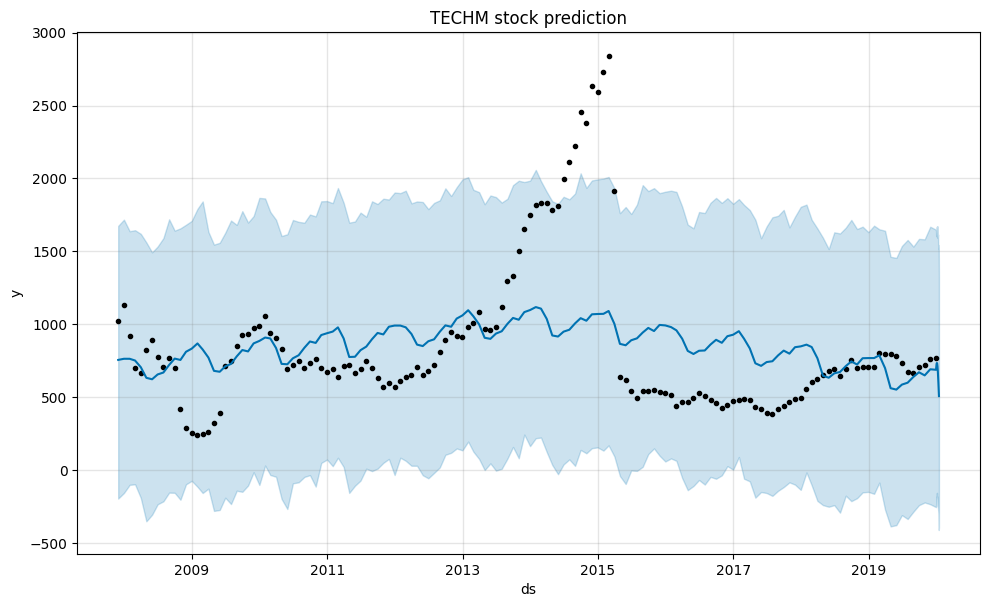

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/l67pzw1q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/6l69ncsn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42800', 'data', 'file=/tmp/tmpo7zomkn1/l67pzw1q.json', 'init=/tmp/tmpo7zomkn1/6l69ncsn.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modeli4vmuh2e/prophet_model-20230722231619.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


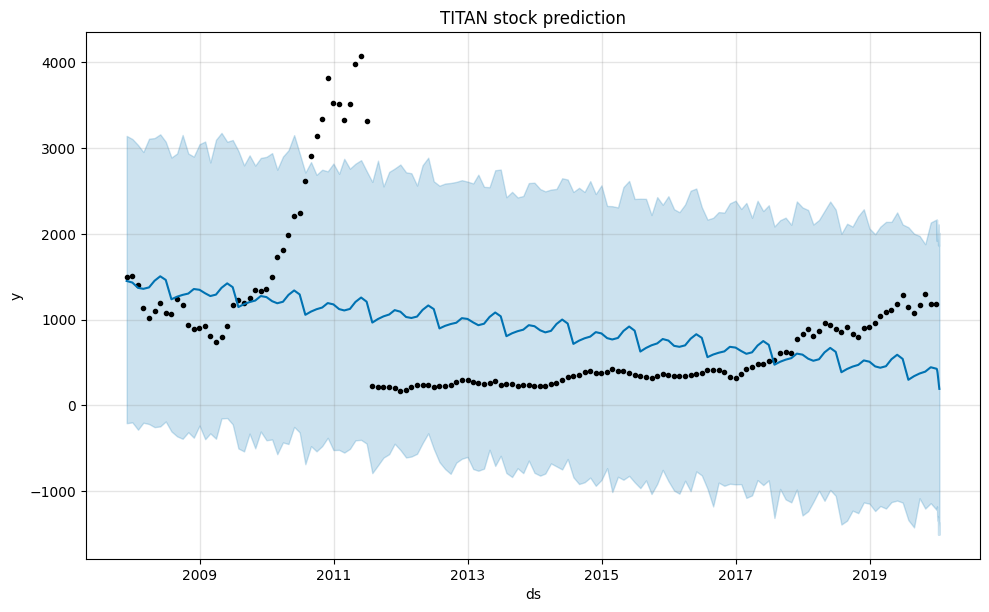

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/i95msqi9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/szwucyp5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97183', 'data', 'file=/tmp/tmpo7zomkn1/i95msqi9.json', 'init=/tmp/tmpo7zomkn1/szwucyp5.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model1ljzn419/prophet_model-20230722231620.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


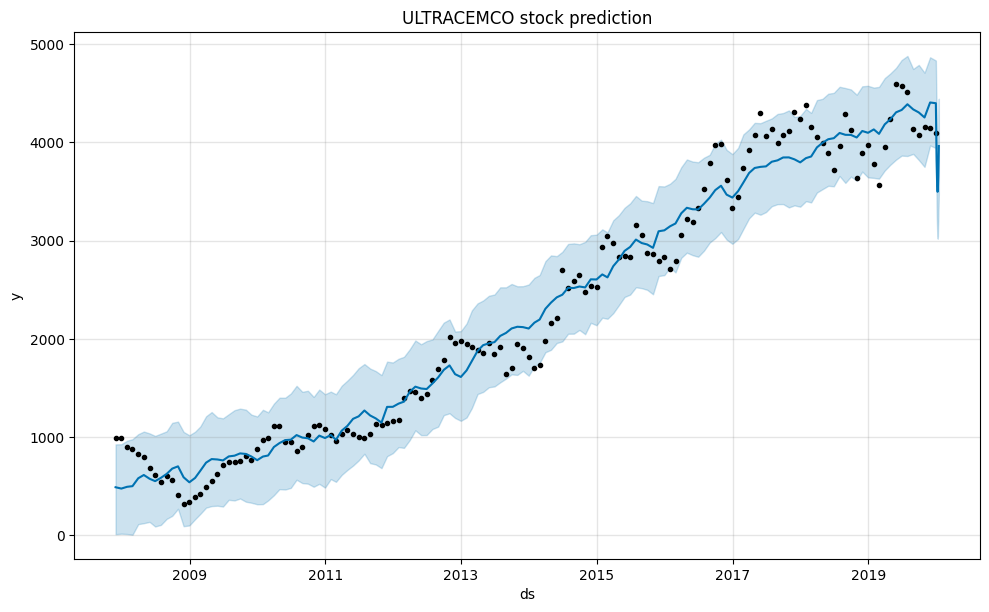

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/yq5q12ya.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/cz995bnf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97122', 'data', 'file=/tmp/tmpo7zomkn1/yq5q12ya.json', 'init=/tmp/tmpo7zomkn1/cz995bnf.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model37x93mr4/prophet_model-20230722231620.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


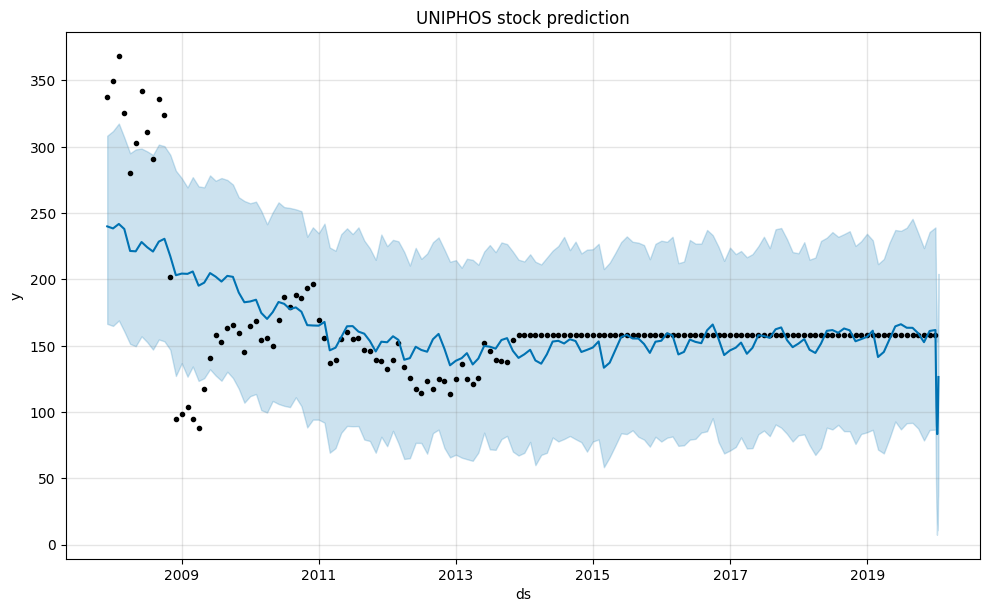

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/k0i20lpd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/xi4otssg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71292', 'data', 'file=/tmp/tmpo7zomkn1/k0i20lpd.json', 'init=/tmp/tmpo7zomkn1/xi4otssg.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelzppgh7mg/prophet_model-20230722231621.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


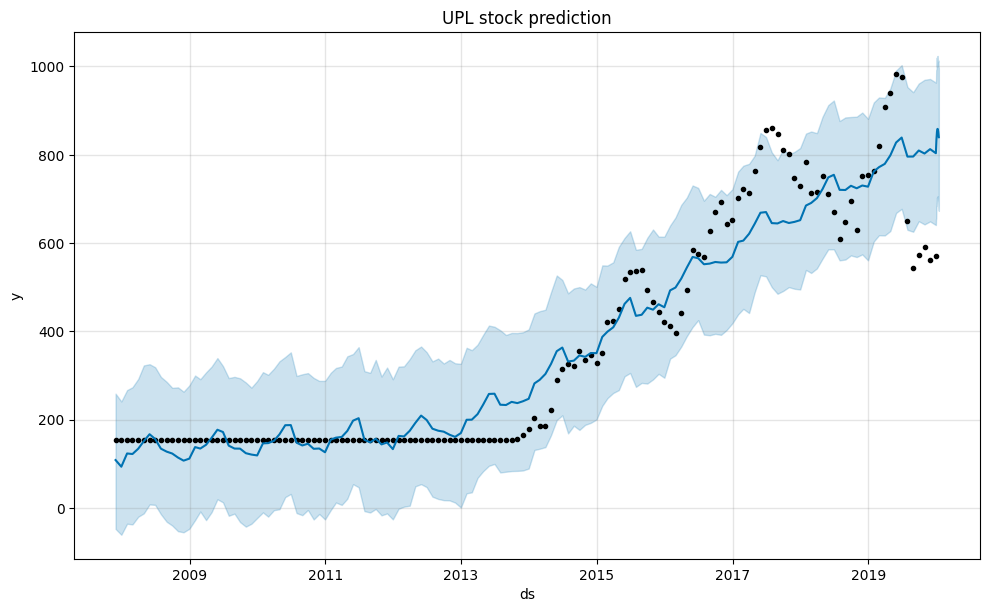

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/fyr0adf9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/41ds3d2w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=13376', 'data', 'file=/tmp/tmpo7zomkn1/fyr0adf9.json', 'init=/tmp/tmpo7zomkn1/41ds3d2w.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelwg7rr2ym/prophet_model-20230722231621.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


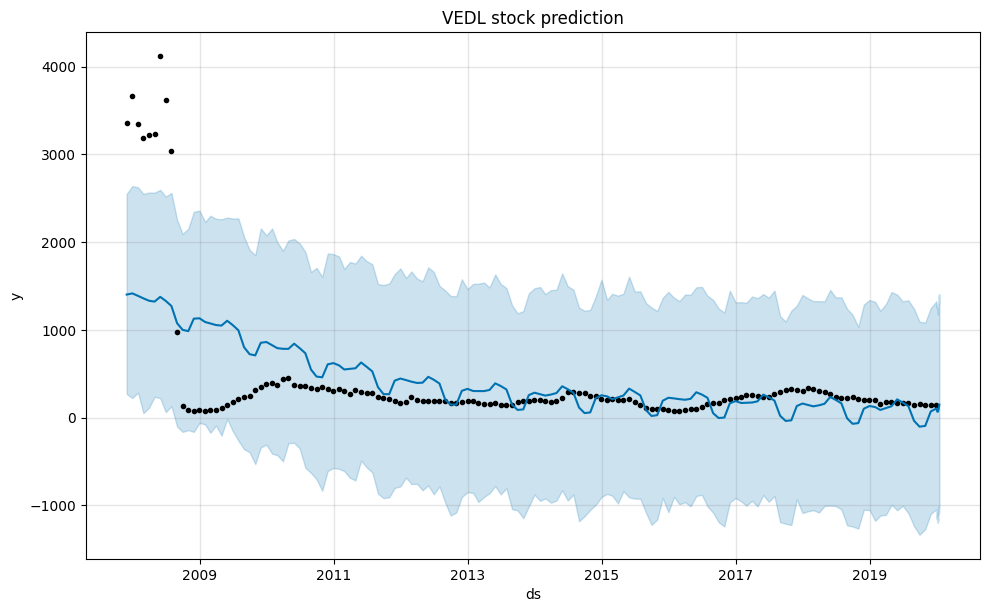

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/k25az4jh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/b00s3cmq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64193', 'data', 'file=/tmp/tmpo7zomkn1/k25az4jh.json', 'init=/tmp/tmpo7zomkn1/b00s3cmq.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modeld2dnj3r8/prophet_model-20230722231622.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


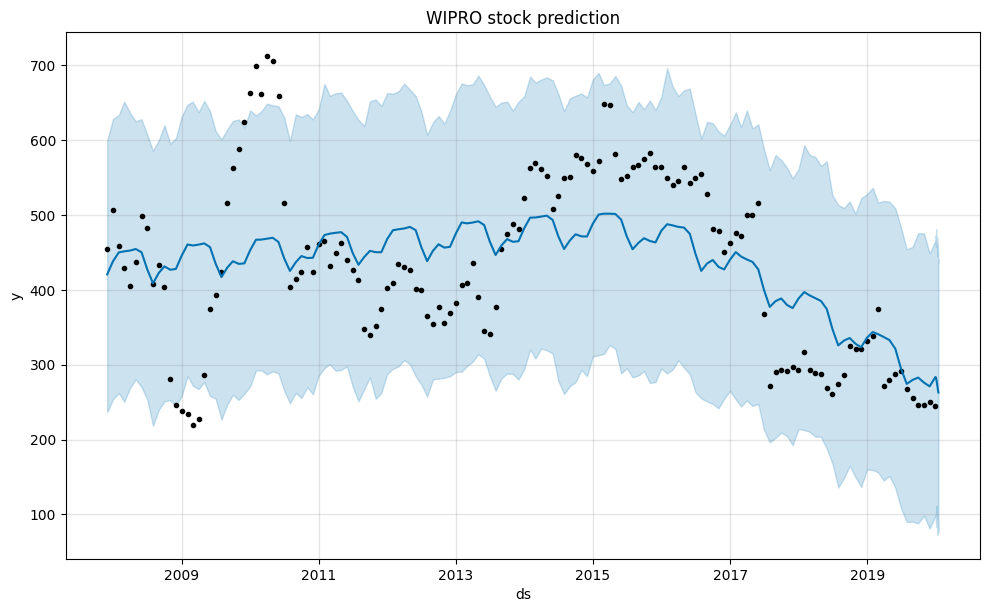

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/69pz6gfp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/gwrathhq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96602', 'data', 'file=/tmp/tmpo7zomkn1/69pz6gfp.json', 'init=/tmp/tmpo7zomkn1/gwrathhq.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modeliigr6ker/prophet_model-20230722231622.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:16:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:16:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


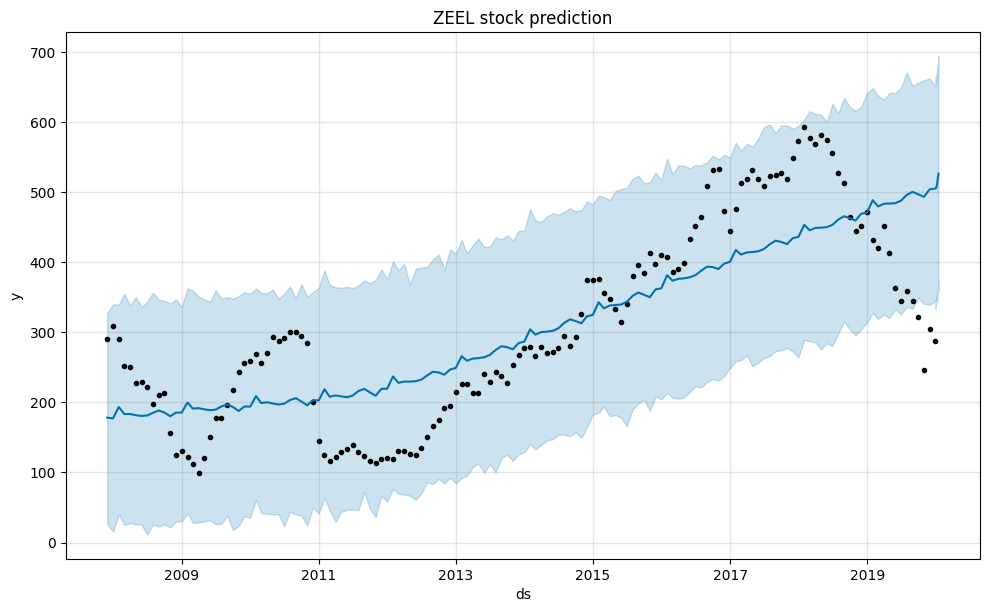

In [ ]:
# Importing the required libraries
!pip uninstall prophet -y
!pip install prophet
import pandas as pd
import numpy as np
from prophet.plot import plot_plotly, plot_components_plotly
from prophet import Prophet  # Correct import statement

# Load the stock market dataset (assuming it's already loaded as 'df')
# ... (rest of the code to preprocess the data, similar to the previous code)

# Function to perform stock market prediction using Facebook Prophet
def perform_stock_prediction(data, stock_name):
    df1 = data.reset_index()[['Date', stock_name]].rename({'Date': 'ds', stock_name: 'y'}, axis='columns')
    train = df1[(df1['ds'] >= '2007-11-30') & (df1['ds'] <= '2019-12-31')]
    test = df1[(df1['ds'] > '2019-12-31')]

    m = Prophet(interval_width=0.95, yearly_seasonality=True)
    m.fit(train)

    future = m.make_future_dataframe(periods=16, freq='D')  # Set the appropriate prediction frequency
    forecast = m.predict(future)

    fig = m.plot(forecast)
    plt.title(stock_name + ' stock prediction')
    plt.show()

    return forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail(16)

# Perform prediction for each stock
prediction_data = {}
for stock_name in df.columns:  # Assuming the columns represent stock names
    prediction_data[stock_name] = perform_stock_prediction(df, stock_name)

Found existing installation: prophet 1.1.4
Uninstalling prophet-1.1.4:
  Successfully uninstalled prophet-1.1.4
  Using cached prophet-1.1.4-py3-none-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (13.0 MB)


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/u2cd7gix.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/sxtakyar.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54175', 'data', 'file=/tmp/tmpo7zomkn1/u2cd7gix.json', 'init=/tmp/tmpo7zomkn1/sxtakyar.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelswyr4mjm/prophet_model-20230722232104.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


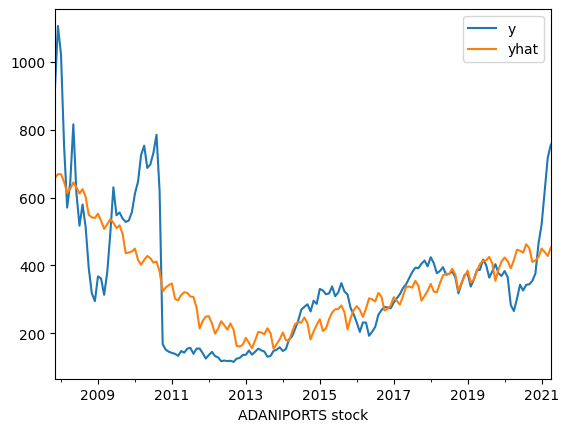

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/fwik6_w4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/_9ynycrm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42374', 'data', 'file=/tmp/tmpo7zomkn1/fwik6_w4.json', 'init=/tmp/tmpo7zomkn1/_9ynycrm.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelcz4munzd/prophet_model-20230722232104.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 90.40919412523715
RMSE: 124.27246411418389
R-Squared: 0.5863362724642391


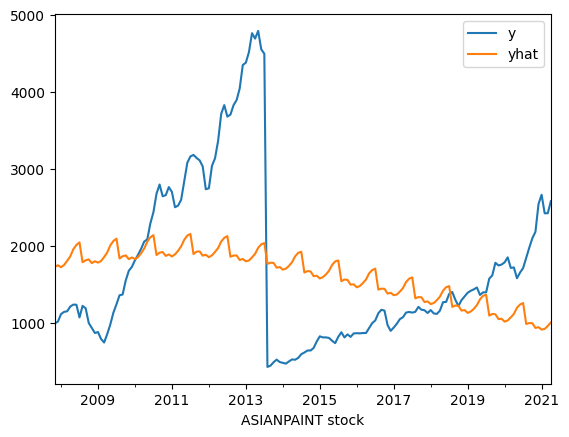

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/dguogz1w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/et8s05jp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79708', 'data', 'file=/tmp/tmpo7zomkn1/dguogz1w.json', 'init=/tmp/tmpo7zomkn1/et8s05jp.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelmmou9c8v/prophet_model-20230722232104.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 835.1634602128705
RMSE: 1041.7785550434967
R-Squared: 0.06605494662938771


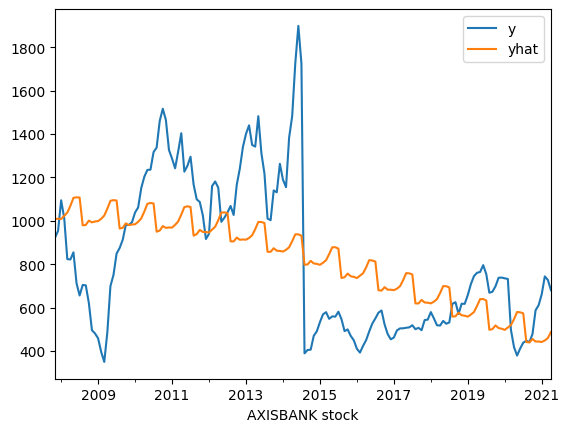

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/1oynrnva.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/si8ikl1c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36497', 'data', 'file=/tmp/tmpo7zomkn1/1oynrnva.json', 'init=/tmp/tmpo7zomkn1/si8ikl1c.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelsh4r5jn9/prophet_model-20230722232105.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 240.50026878889022
RMSE: 292.37829475635044
R-Squared: 0.3074435462312084


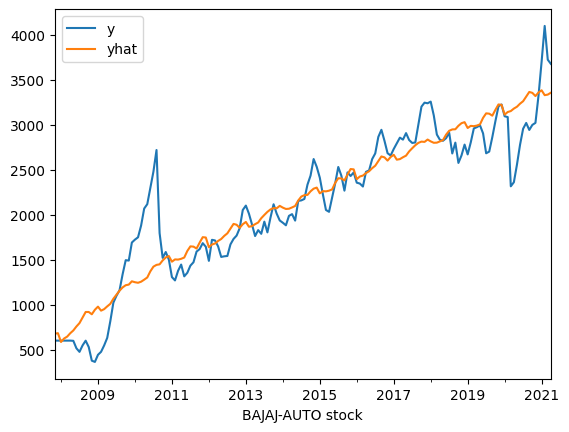

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/jht48bub.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/t8u7c8tb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49169', 'data', 'file=/tmp/tmpo7zomkn1/jht48bub.json', 'init=/tmp/tmpo7zomkn1/t8u7c8tb.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelnvn4zl9j/prophet_model-20230722232105.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 217.10429944399965
RMSE: 307.6282255165773
R-Squared: 0.8594448999951646


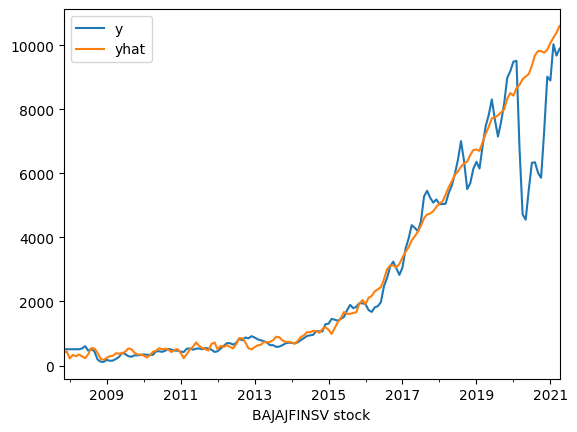

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/c10wede9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/t77mejv7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=61564', 'data', 'file=/tmp/tmpo7zomkn1/c10wede9.json', 'init=/tmp/tmpo7zomkn1/t77mejv7.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modeli5s9aqp2/prophet_model-20230722232105.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 398.36946417502077
RMSE: 885.5616638582543
R-Squared: 0.9029380025943673


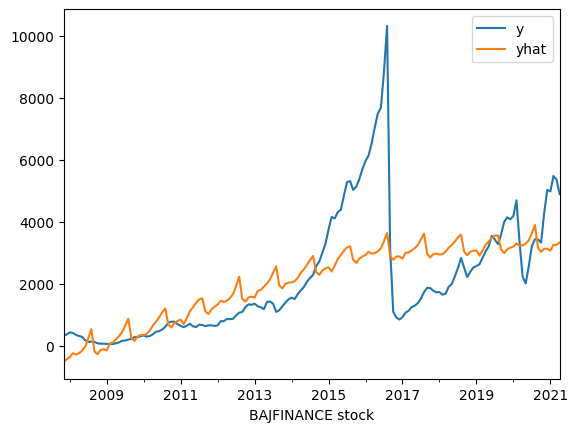

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/m7q_a19a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/467f47qr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89268', 'data', 'file=/tmp/tmpo7zomkn1/m7q_a19a.json', 'init=/tmp/tmpo7zomkn1/467f47qr.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model0zz0iwvj/prophet_model-20230722232106.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 977.1394002612298
RMSE: 1415.2615564973992
R-Squared: 0.47707615717753127


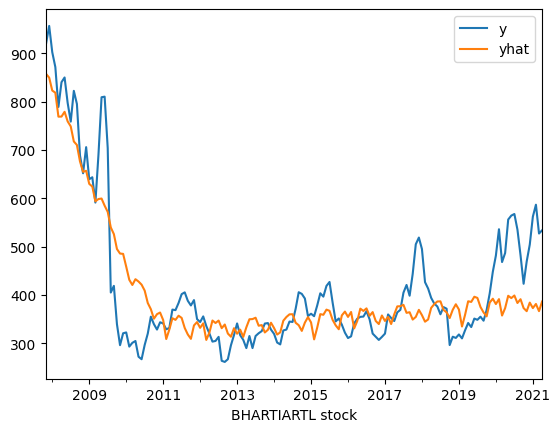

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/oija65u5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/ny9_dnzw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60732', 'data', 'file=/tmp/tmpo7zomkn1/oija65u5.json', 'init=/tmp/tmpo7zomkn1/ny9_dnzw.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelhzfhkeo8/prophet_model-20230722232106.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 56.869689746646266
RMSE: 77.29942243334972
R-Squared: 0.7510941448321738


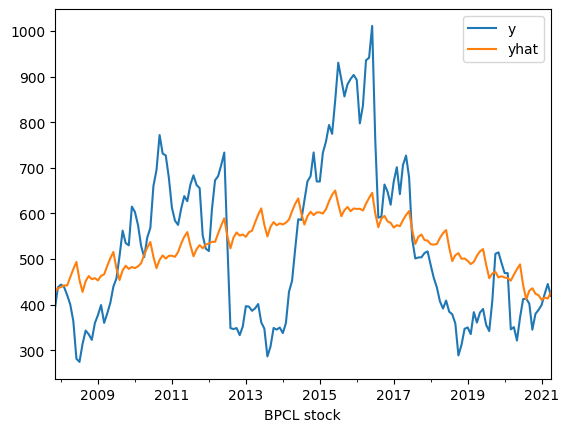

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/3icqclfn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/i0vbiv_1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91312', 'data', 'file=/tmp/tmpo7zomkn1/3icqclfn.json', 'init=/tmp/tmpo7zomkn1/i0vbiv_1.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelyojmio3t/prophet_model-20230722232106.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 120.29520802204624
RMSE: 145.57797626966166
R-Squared: 0.2878382389389854


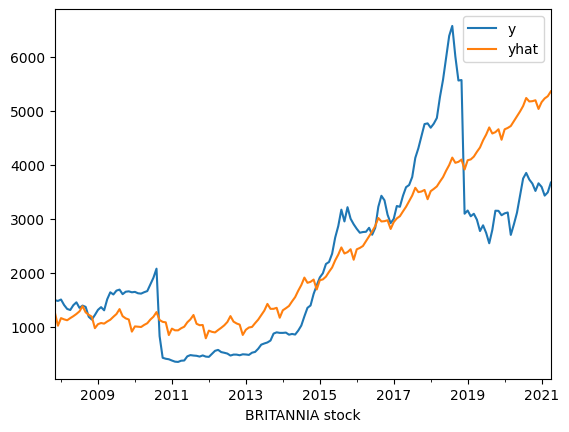

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/yxtih4k_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/iqy195eg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30906', 'data', 'file=/tmp/tmpo7zomkn1/yxtih4k_.json', 'init=/tmp/tmpo7zomkn1/iqy195eg.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modeljn_rgx9q/prophet_model-20230722232107.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 728.7718671384537
RMSE: 917.7340672828273
R-Squared: 0.6155525755911198


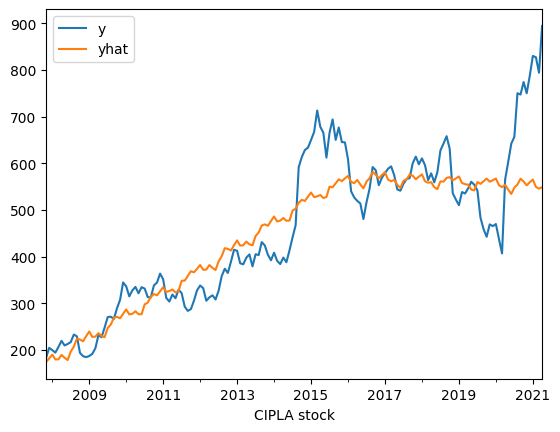

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/89euic0n.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/hlx6bsxx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37187', 'data', 'file=/tmp/tmpo7zomkn1/89euic0n.json', 'init=/tmp/tmpo7zomkn1/hlx6bsxx.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelpdr3ow5e/prophet_model-20230722232107.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 58.5367823455469
RMSE: 82.27847782230475
R-Squared: 0.7538744764290609


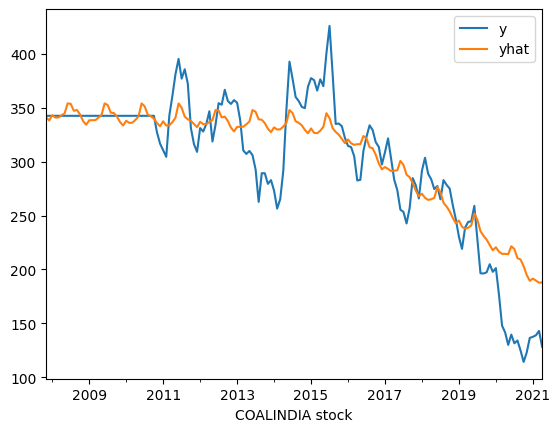

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/0mjema63.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/cfuvy0kb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52260', 'data', 'file=/tmp/tmpo7zomkn1/0mjema63.json', 'init=/tmp/tmpo7zomkn1/cfuvy0kb.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model8nudfv5x/prophet_model-20230722232108.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 24.174302178594548
RMSE: 33.028380460369455
R-Squared: 0.767723998760675


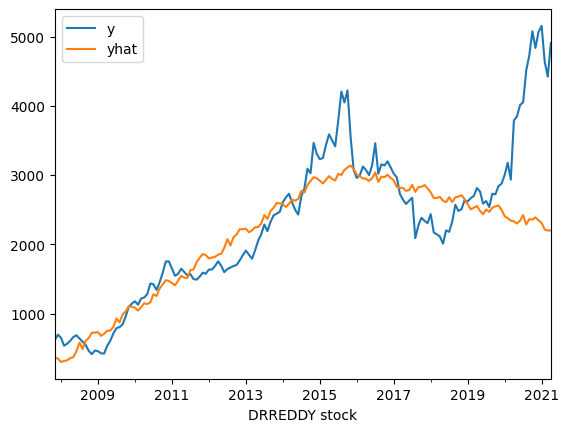

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/hfwilha4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/4jmx1__l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1342', 'data', 'file=/tmp/tmpo7zomkn1/hfwilha4.json', 'init=/tmp/tmpo7zomkn1/4jmx1__l.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelp24w_n2o/prophet_model-20230722232108.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 414.87692532419186
RMSE: 718.155956541416
R-Squared: 0.5873086711948661


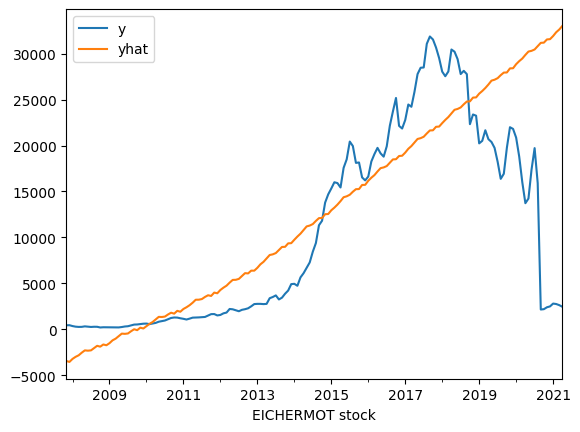

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/p83vw9zg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/26jdzite.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62183', 'data', 'file=/tmp/tmpo7zomkn1/p83vw9zg.json', 'init=/tmp/tmpo7zomkn1/26jdzite.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelllj9devy/prophet_model-20230722232108.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 5207.08460118394
RMSE: 8211.563875928621
R-Squared: 0.3760250248383371


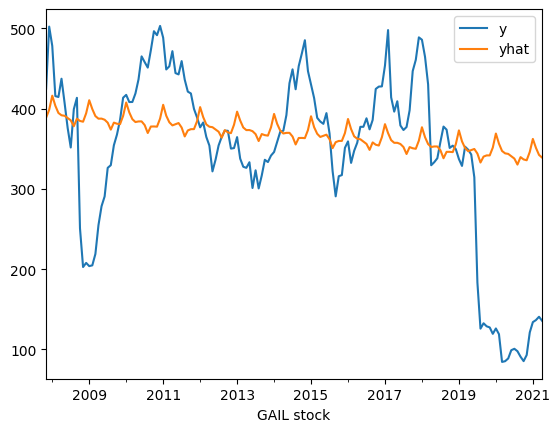

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/tswprtpn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/3uammve1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19212', 'data', 'file=/tmp/tmpo7zomkn1/tswprtpn.json', 'init=/tmp/tmpo7zomkn1/3uammve1.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modela5n_s0do/prophet_model-20230722232109.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 74.80116933247778
RMSE: 104.56919535066294
R-Squared: 0.08157869443683263


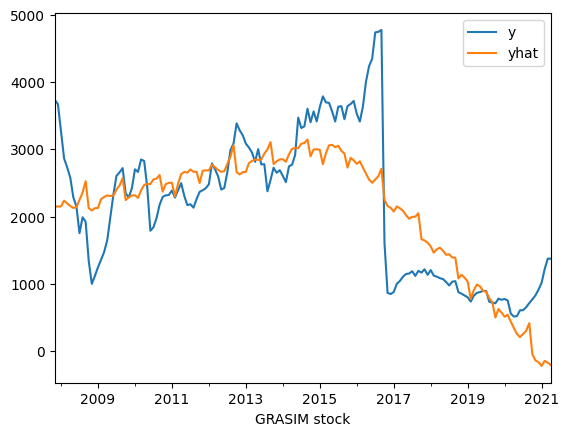

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/ty_ovvbb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/fs41r9qn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3026', 'data', 'file=/tmp/tmpo7zomkn1/ty_ovvbb.json', 'init=/tmp/tmpo7zomkn1/fs41r9qn.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modeleulove4e/prophet_model-20230722232109.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 517.923395196757
RMSE: 690.0795560436604
R-Squared: 0.5945520362882761


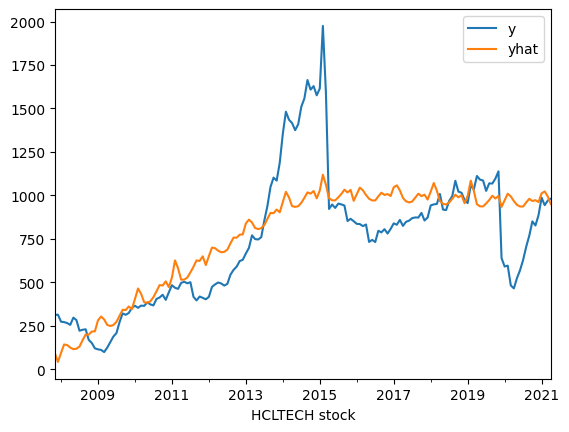

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/ax90yhst.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/fd4tuo8c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30831', 'data', 'file=/tmp/tmpo7zomkn1/ax90yhst.json', 'init=/tmp/tmpo7zomkn1/fd4tuo8c.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model6dvqo_65/prophet_model-20230722232110.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 170.2232598126039
RMSE: 230.85526887881613
R-Squared: 0.6349142369795838


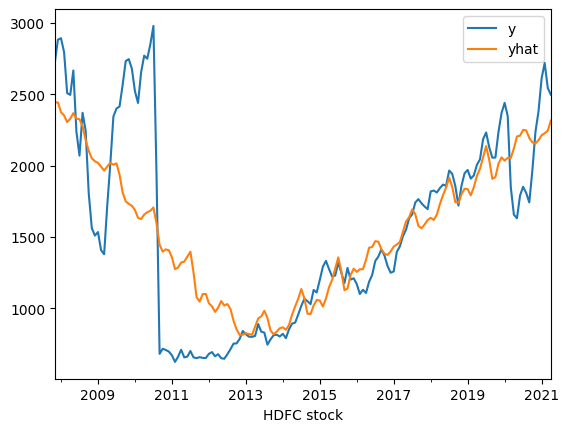

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/irfp_16p.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/84_ogf4z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35819', 'data', 'file=/tmp/tmpo7zomkn1/irfp_16p.json', 'init=/tmp/tmpo7zomkn1/84_ogf4z.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model6evjj2qh/prophet_model-20230722232110.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 278.9558205529297
RMSE: 392.9378240192528
R-Squared: 0.6686416698960497


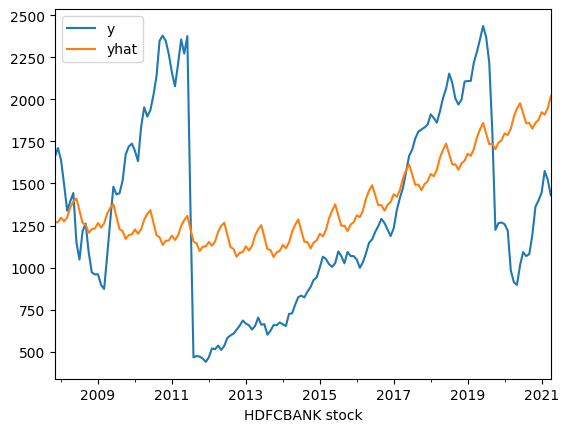

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/ay_wo80x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/08c3y9r5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31543', 'data', 'file=/tmp/tmpo7zomkn1/ay_wo80x.json', 'init=/tmp/tmpo7zomkn1/08c3y9r5.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelb6yssb_0/prophet_model-20230722232110.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 440.73959884908487
RMSE: 514.7255392724173
R-Squared: 0.14353171713650903


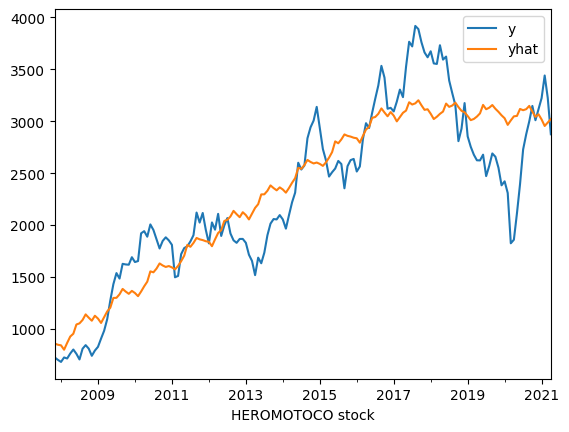

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/bk6ou0fy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/2vee1oha.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92678', 'data', 'file=/tmp/tmpo7zomkn1/bk6ou0fy.json', 'init=/tmp/tmpo7zomkn1/2vee1oha.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelr64qk5y2/prophet_model-20230722232111.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 296.2413206155052
RMSE: 365.50944586363113
R-Squared: 0.8038658173900206


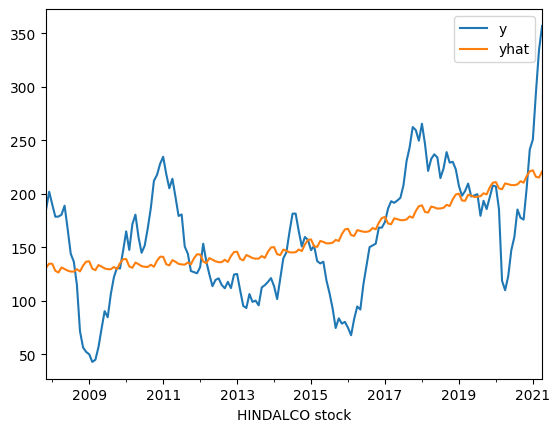

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/_e16_tsj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/4hvki88v.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69389', 'data', 'file=/tmp/tmpo7zomkn1/_e16_tsj.json', 'init=/tmp/tmpo7zomkn1/4hvki88v.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model2v5kq2p6/prophet_model-20230722232111.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 38.19516137169546
RMSE: 47.700153727553456
R-Squared: 0.2934886536259935


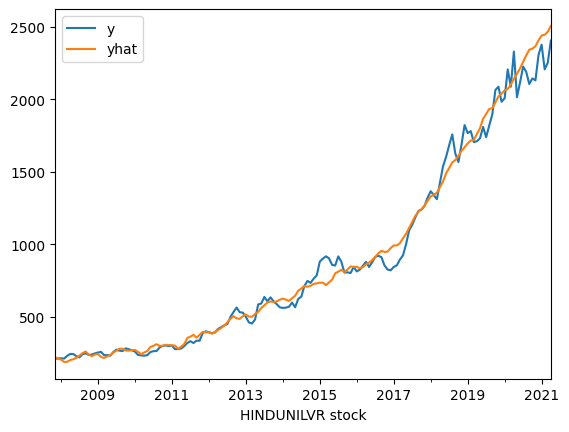

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/jj2uukfi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/tiujvz2s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52870', 'data', 'file=/tmp/tmpo7zomkn1/jj2uukfi.json', 'init=/tmp/tmpo7zomkn1/tiujvz2s.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modeljhhsjf1c/prophet_model-20230722232112.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 51.138964725377114
RMSE: 75.88135586730652
R-Squared: 0.9864616704246423


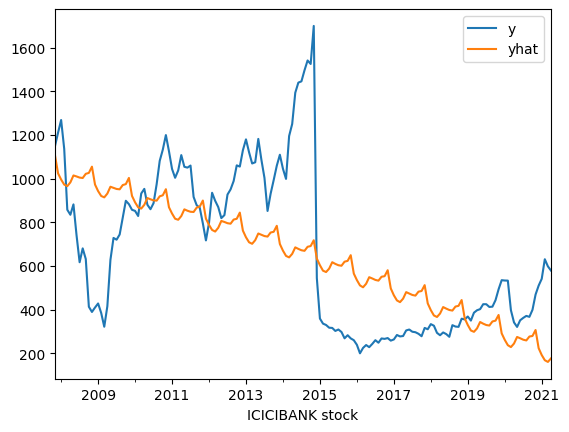

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/wcivzhqr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/21dqps2a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37822', 'data', 'file=/tmp/tmpo7zomkn1/wcivzhqr.json', 'init=/tmp/tmpo7zomkn1/21dqps2a.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model8ice82g5/prophet_model-20230722232112.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 240.30303359865385
RMSE: 304.6755821266695
R-Squared: 0.3110167265779792


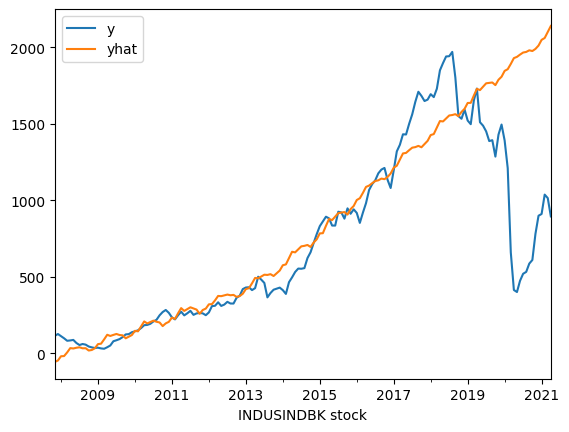

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/hgff5qzz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/dygxggv5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21414', 'data', 'file=/tmp/tmpo7zomkn1/hgff5qzz.json', 'init=/tmp/tmpo7zomkn1/dygxggv5.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model1jbhnbq_/prophet_model-20230722232113.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 206.7887261901094
RMSE: 414.77598252217376
R-Squared: 0.4593537737076201


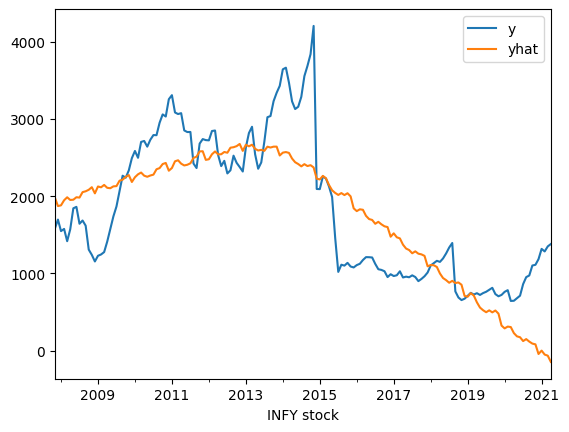

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/wghz3mb3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/zlhumllu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42422', 'data', 'file=/tmp/tmpo7zomkn1/wghz3mb3.json', 'init=/tmp/tmpo7zomkn1/zlhumllu.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelu9h9kp5l/prophet_model-20230722232113.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 473.21283556831935
RMSE: 592.7601781555508
R-Squared: 0.5839121599242023


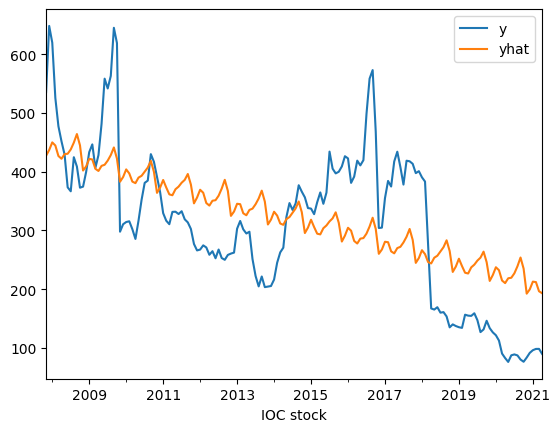

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/z_flgbe9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/y4ttnjmn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=85232', 'data', 'file=/tmp/tmpo7zomkn1/z_flgbe9.json', 'init=/tmp/tmpo7zomkn1/y4ttnjmn.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model4dhofhsa/prophet_model-20230722232114.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 89.27354295707696
RMSE: 102.18965585428381
R-Squared: 0.40373442988024244


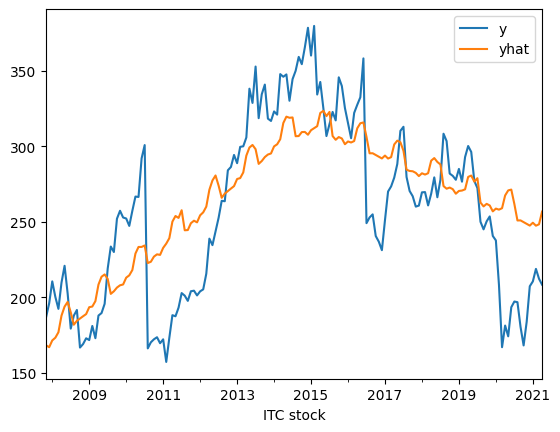

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/674xkbzj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/z_enntme.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78224', 'data', 'file=/tmp/tmpo7zomkn1/674xkbzj.json', 'init=/tmp/tmpo7zomkn1/z_enntme.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelngh_l62d/prophet_model-20230722232114.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 32.40014933145319
RMSE: 38.503608812177355
R-Squared: 0.5703367263182477


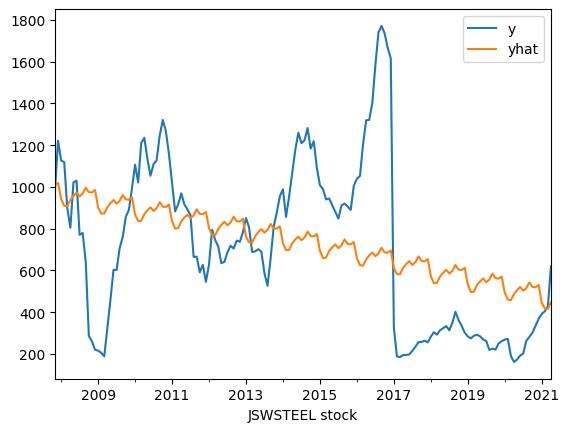

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/6_ybtvbi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/4riqk0u5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53038', 'data', 'file=/tmp/tmpo7zomkn1/6_ybtvbi.json', 'init=/tmp/tmpo7zomkn1/4riqk0u5.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modell9el2p95/prophet_model-20230722232115.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 291.6581775254388
RMSE: 360.77264765291585
R-Squared: 0.18979765941892857


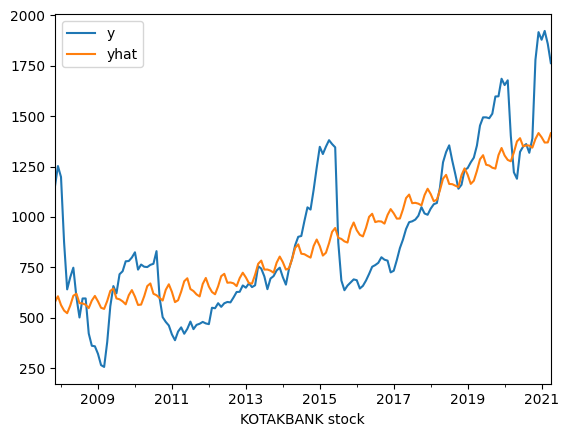

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/04tv_m54.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/b_scampv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82558', 'data', 'file=/tmp/tmpo7zomkn1/04tv_m54.json', 'init=/tmp/tmpo7zomkn1/b_scampv.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modeld9_x9fjg/prophet_model-20230722232115.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 174.85670767159732
RMSE: 224.34384979496986
R-Squared: 0.6599858412426646


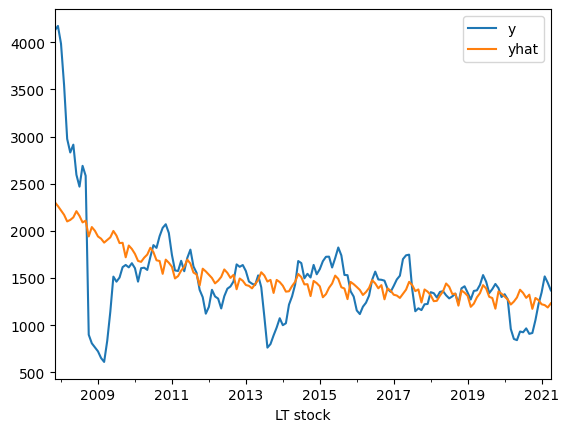

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/oi_7m71z.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/1lqmaqgb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37908', 'data', 'file=/tmp/tmpo7zomkn1/oi_7m71z.json', 'init=/tmp/tmpo7zomkn1/1lqmaqgb.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model7prkf5kh/prophet_model-20230722232116.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 285.9107154272752
RMSE: 452.1501675420796
R-Squared: 0.33157666335606517


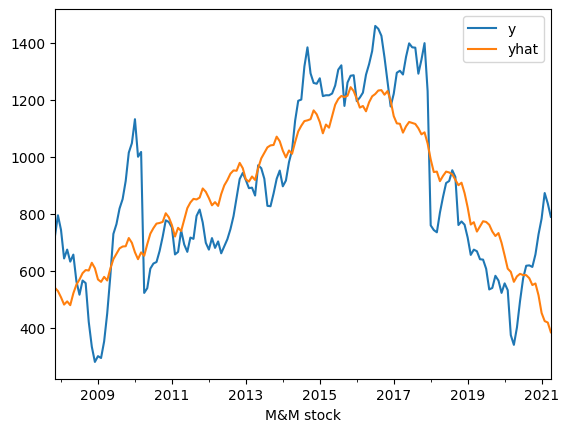

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/oo5qj_kk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/60hhln1x.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59773', 'data', 'file=/tmp/tmpo7zomkn1/oo5qj_kk.json', 'init=/tmp/tmpo7zomkn1/60hhln1x.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model42ky5gb6/prophet_model-20230722232116.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 140.76212228700584
RMSE: 170.17541260887725
R-Squared: 0.672884078904975


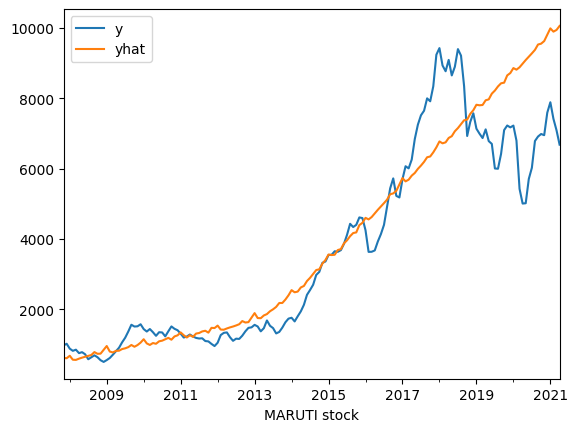

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/zm8vg4h6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/ft666sq0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47183', 'data', 'file=/tmp/tmpo7zomkn1/zm8vg4h6.json', 'init=/tmp/tmpo7zomkn1/ft666sq0.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelnzggxdct/prophet_model-20230722232117.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 798.3030794918986
RMSE: 1217.1211110498748
R-Squared: 0.804604319264995


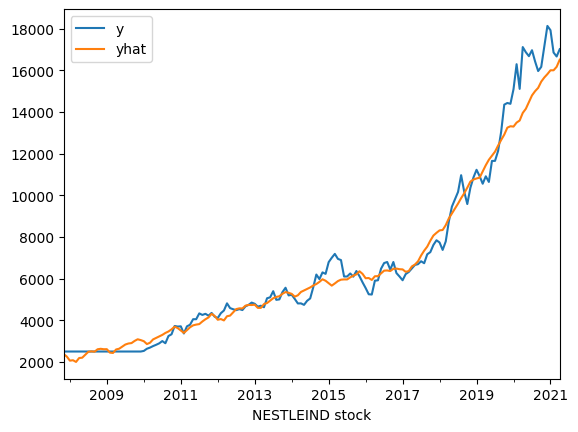

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/_ebvlcqk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/jsniozt1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72037', 'data', 'file=/tmp/tmpo7zomkn1/_ebvlcqk.json', 'init=/tmp/tmpo7zomkn1/jsniozt1.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelan7b11_i/prophet_model-20230722232117.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 469.2639979010341
RMSE: 727.5203121981779
R-Squared: 0.9706669837479833


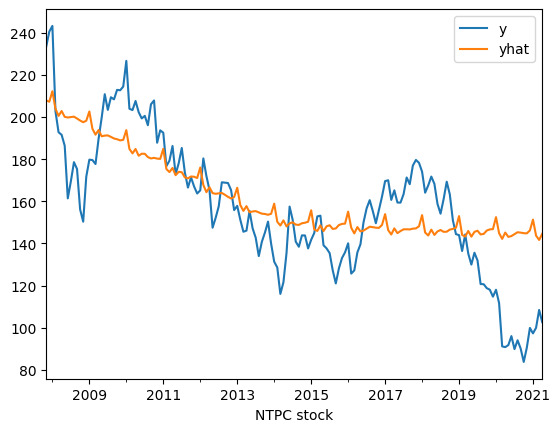

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/j95hgajx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/91gcgl5b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43740', 'data', 'file=/tmp/tmpo7zomkn1/j95hgajx.json', 'init=/tmp/tmpo7zomkn1/91gcgl5b.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelyva36ydw/prophet_model-20230722232118.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 18.245567923136477
RMSE: 22.74049880790317
R-Squared: 0.5165791376059543


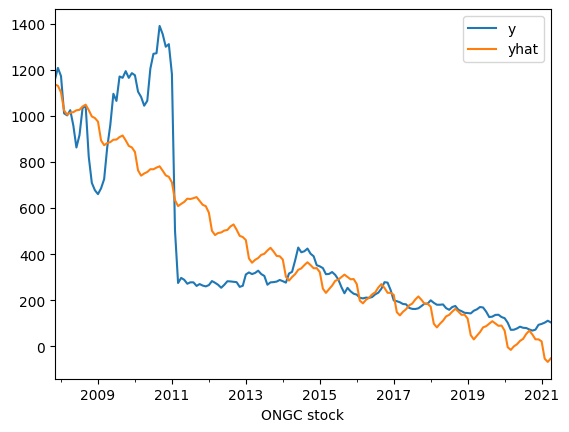

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/90v5moto.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/r8m2ilvl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2648', 'data', 'file=/tmp/tmpo7zomkn1/90v5moto.json', 'init=/tmp/tmpo7zomkn1/r8m2ilvl.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelbhvlpbke/prophet_model-20230722232118.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 134.43740725578834
RMSE: 194.67798647850742
R-Squared: 0.7315713932527034


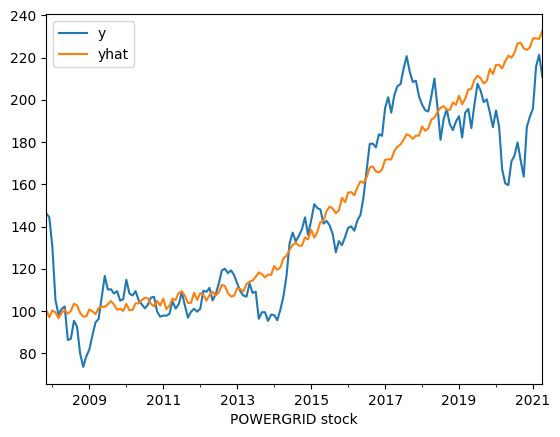

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/yp_ki_o2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/ix1z5b_y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=44209', 'data', 'file=/tmp/tmpo7zomkn1/yp_ki_o2.json', 'init=/tmp/tmpo7zomkn1/ix1z5b_y.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model5ucpgz_p/prophet_model-20230722232119.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 14.065117799627396
RMSE: 19.1738326471937
R-Squared: 0.7901044964002943


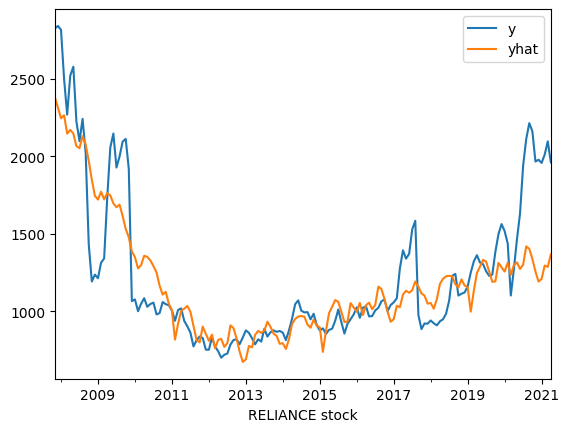

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/5rqo0hdj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/4dfl2ltk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62525', 'data', 'file=/tmp/tmpo7zomkn1/5rqo0hdj.json', 'init=/tmp/tmpo7zomkn1/4dfl2ltk.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modeli4a2g8so/prophet_model-20230722232120.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 188.53545309550907
RMSE: 274.252245456151
R-Squared: 0.6932193833159053


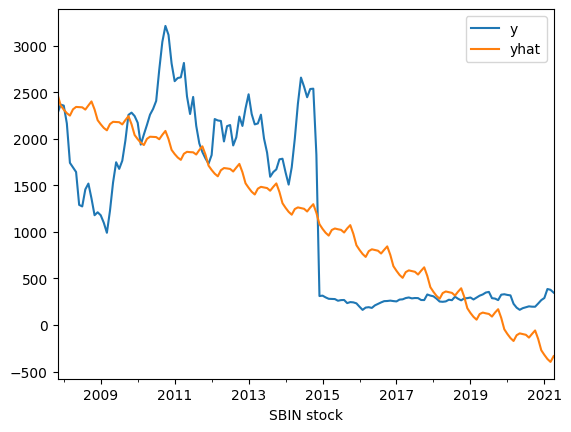

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/o7erlkjj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/g3qj2454.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=13499', 'data', 'file=/tmp/tmpo7zomkn1/o7erlkjj.json', 'init=/tmp/tmpo7zomkn1/g3qj2454.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelfi2m7ibu/prophet_model-20230722232120.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 489.67399208636647
RMSE: 592.4748093270555
R-Squared: 0.6121295183609082


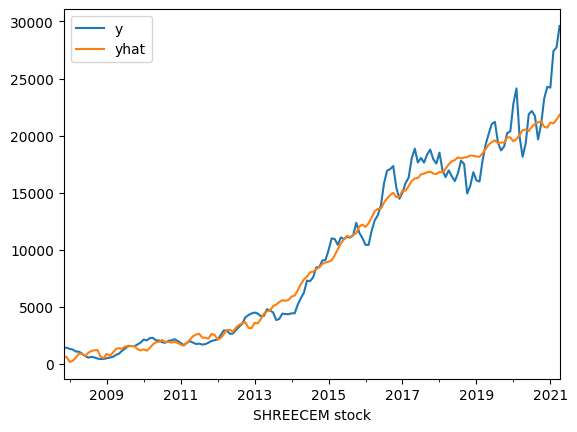

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/9j29y_x7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/45i4ir4n.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=24392', 'data', 'file=/tmp/tmpo7zomkn1/9j29y_x7.json', 'init=/tmp/tmpo7zomkn1/45i4ir4n.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelze_mn4c_/prophet_model-20230722232121.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 963.0140865954454
RMSE: 1492.4442015098343
R-Squared: 0.9643365447324436


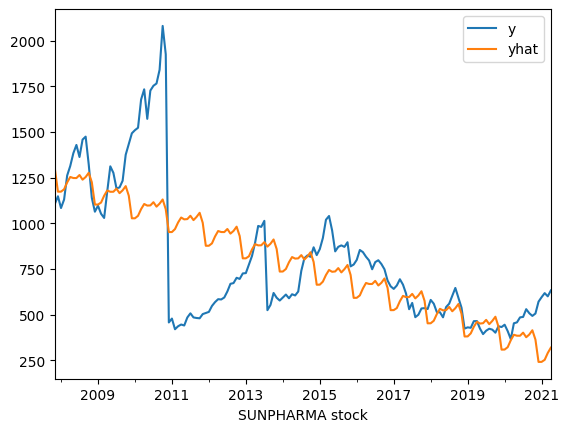

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/e1pceegb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/1hcwx3l6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69944', 'data', 'file=/tmp/tmpo7zomkn1/e1pceegb.json', 'init=/tmp/tmpo7zomkn1/1hcwx3l6.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model72v4h40k/prophet_model-20230722232121.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 200.42393732479314
RMSE: 278.44200771698223
R-Squared: 0.45447787655466054


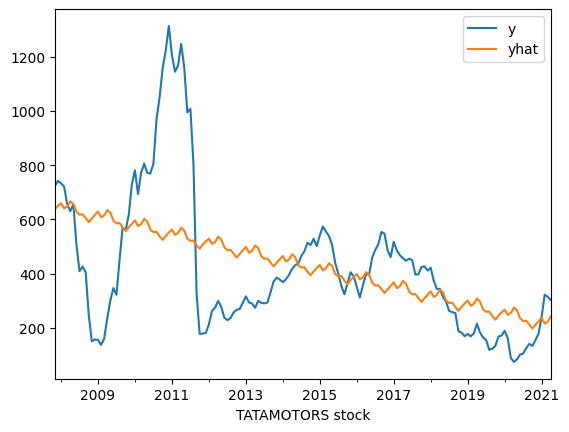

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/0ts8084p.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/q9hp84md.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=34517', 'data', 'file=/tmp/tmpo7zomkn1/0ts8084p.json', 'init=/tmp/tmpo7zomkn1/q9hp84md.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model2n2vy5yv/prophet_model-20230722232122.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 168.88746025545194
RMSE: 231.1746251063461
R-Squared: 0.25131431856800046


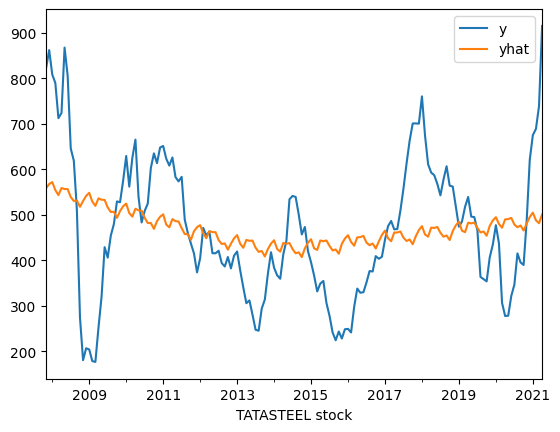

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/ivpmo7x7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/5jxky9r9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15430', 'data', 'file=/tmp/tmpo7zomkn1/ivpmo7x7.json', 'init=/tmp/tmpo7zomkn1/5jxky9r9.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_model1qlqvtmn/prophet_model-20230722232122.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 113.60885911725946
RMSE: 143.5638926594706
R-Squared: 0.14176190102092934


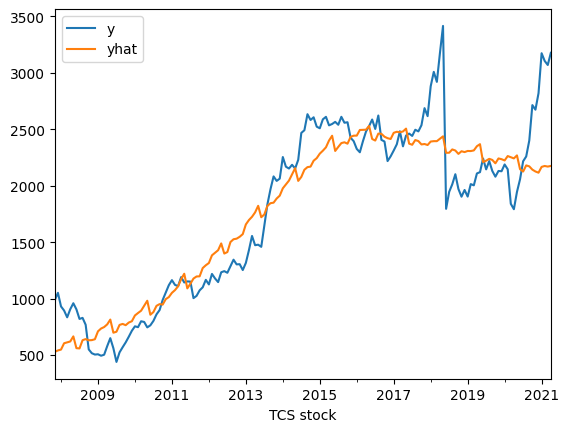

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/2stjkdr0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/9fe_10vi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8500', 'data', 'file=/tmp/tmpo7zomkn1/2stjkdr0.json', 'init=/tmp/tmpo7zomkn1/9fe_10vi.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelzoiu_klv/prophet_model-20230722232122.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 227.1281947074313
RMSE: 297.84509158681334
R-Squared: 0.8491313991857119


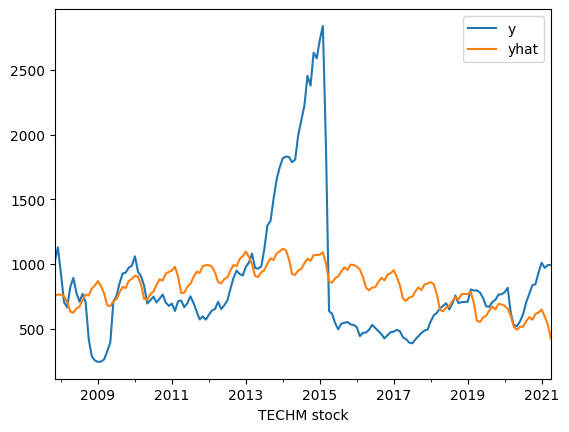

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/9fhnp0yr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/_fmcrvsh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59039', 'data', 'file=/tmp/tmpo7zomkn1/9fhnp0yr.json', 'init=/tmp/tmpo7zomkn1/_fmcrvsh.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelzzkwijz8/prophet_model-20230722232123.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 314.1973605430719
RMSE: 457.5373599861334
R-Squared: 0.1722630834476191


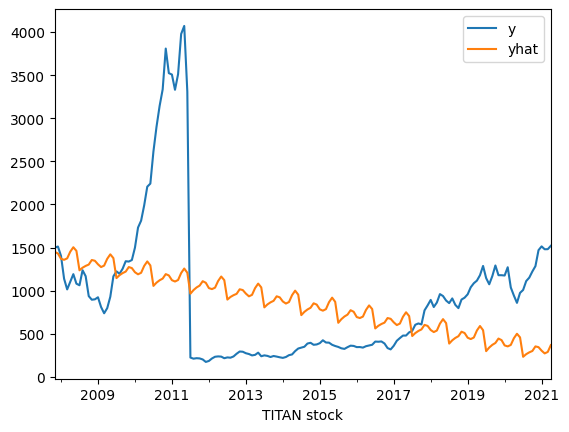

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/ytkdlfk7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/8ytptgk0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93398', 'data', 'file=/tmp/tmpo7zomkn1/ytkdlfk7.json', 'init=/tmp/tmpo7zomkn1/8ytptgk0.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelwbb52jlr/prophet_model-20230722232123.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 642.5035244436808
RMSE: 840.0059875916786
R-Squared: 0.013422607236748707


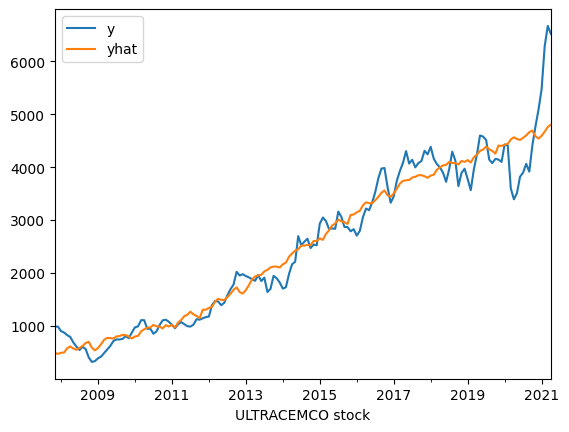

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/yf3qeybi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/ro8144gm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26227', 'data', 'file=/tmp/tmpo7zomkn1/yf3qeybi.json', 'init=/tmp/tmpo7zomkn1/ro8144gm.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelmio2hsz4/prophet_model-20230722232124.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 250.8612562930138
RMSE: 380.89511533963946
R-Squared: 0.9331436206427837


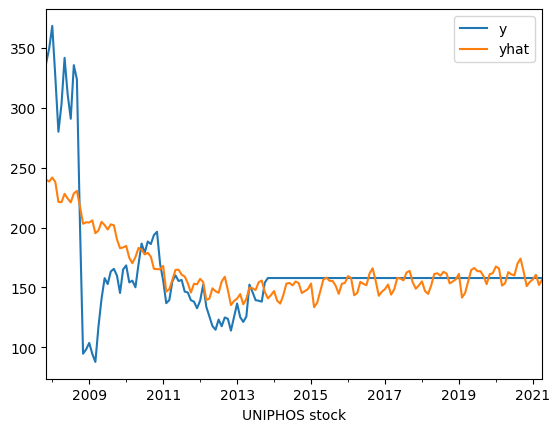

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/gz749kzp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/v5wul66b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=32349', 'data', 'file=/tmp/tmpo7zomkn1/gz749kzp.json', 'init=/tmp/tmpo7zomkn1/v5wul66b.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelg2dwrz3i/prophet_model-20230722232124.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 20.18150577264639
RMSE: 35.074675236929615
R-Squared: 0.44154028291686087


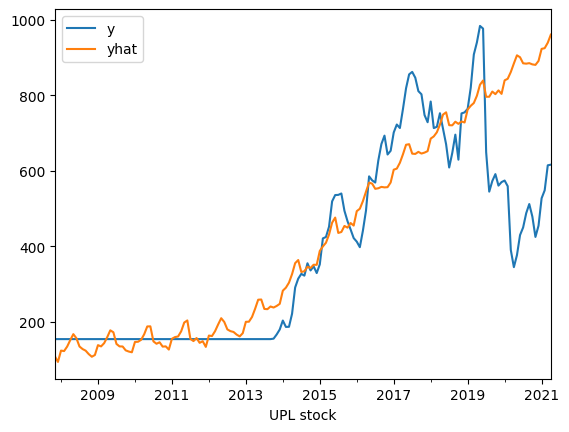

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/1czbw4ur.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/cxmv3bw7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84376', 'data', 'file=/tmp/tmpo7zomkn1/1czbw4ur.json', 'init=/tmp/tmpo7zomkn1/cxmv3bw7.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelllunbuwk/prophet_model-20230722232125.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 92.0858306216811
RMSE: 151.1218866368707
R-Squared: 0.6302481732792689


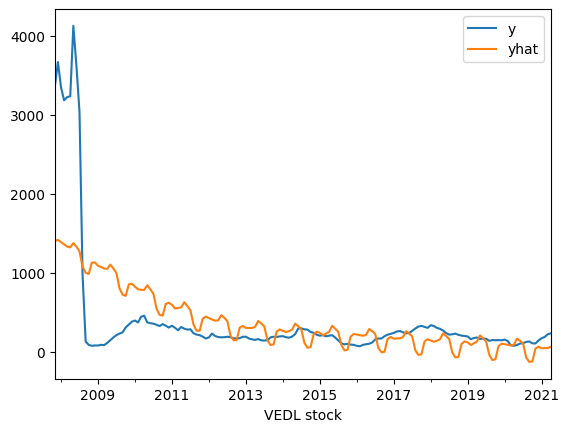

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/kbzjz8f4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/a9cu4lcz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7686', 'data', 'file=/tmp/tmpo7zomkn1/kbzjz8f4.json', 'init=/tmp/tmpo7zomkn1/a9cu4lcz.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modeljz5csxil/prophet_model-20230722232125.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 316.2628093087885
RMSE: 580.6235807236334
R-Squared: 0.39311952527209115


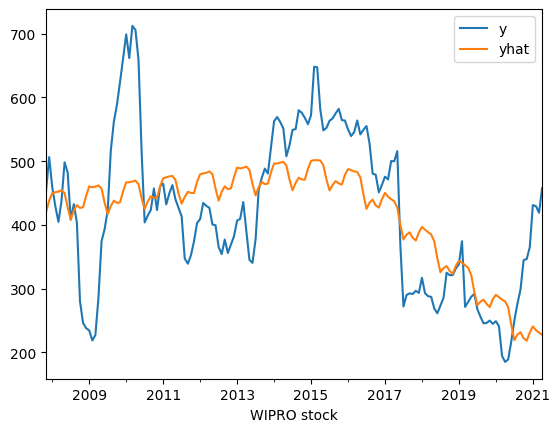

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/9yf8ul98.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpo7zomkn1/9w91okaq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70919', 'data', 'file=/tmp/tmpo7zomkn1/9yf8ul98.json', 'init=/tmp/tmpo7zomkn1/9w91okaq.json', 'output', 'file=/tmp/tmpo7zomkn1/prophet_modelrwqcp75j/prophet_model-20230722232126.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:21:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Results of sklearn.metrics:
MAE: 78.05281356263608
RMSE: 97.32290084660858
R-Squared: 0.3726879548089206


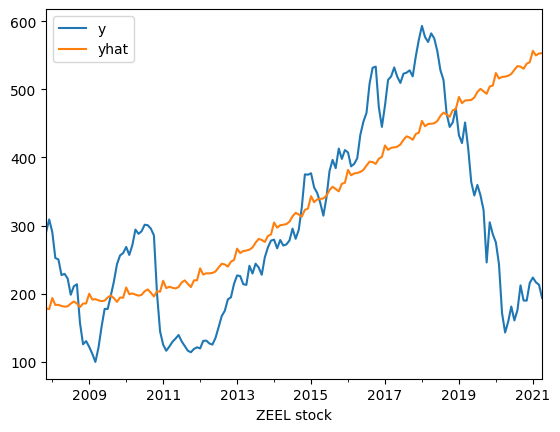

Results of sklearn.metrics:
MAE: 94.90254791324311
RMSE: 131.49743835476625
R-Squared: 0.0636551357306796


In [ ]:
!pip uninstall prophet -y
!pip install prophet
import sklearn.metrics as metrics
import matplotlib.pyplot as plt

for i in df.columns:
    df1=df.reset_index()[['Date',i]].rename({'Date':'ds',i:'y'},  axis='columns')
    train = df1[( df1['ds'] >='2007-11-30' ) &(df1['ds'] <='2019-12-31' )]
    test = df1[(df1['ds'] >'2019-12-31' )]
    m = Prophet(interval_width=0.95,yearly_seasonality=True)
    m.fit(train)
    future = m.make_future_dataframe(periods=16,freq='M')
    forecast = m.predict(future)
    pd.concat([df1.set_index('ds')['y'],forecast.set_index('ds')['yhat']],axis=1).plot()
    mae = metrics.mean_absolute_error(df1.set_index('ds')['y'],forecast.set_index('ds')['yhat'])
    mse = metrics.mean_squared_error(df1.set_index('ds')['y'],forecast.set_index('ds')['yhat'])
    rmse = np.sqrt(mse) #mse**(0.5)
    r2 = metrics.r2_score(df1.set_index('ds')['y'],forecast.set_index('ds')['yhat'])
    plt.plot(df1.set_index('ds')['y'])
    plt.plot(forecast.set_index('ds')['yhat'])
    plt.xlabel(i+' stock')
    plt.show()
    print("Results of sklearn.metrics:")
    print("MAE:",mae)
    print("RMSE:", rmse)
    print("R-Squared:", r2)
